In [6]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '3'
import cv2
import numpy as np
import matplotlib.pyplot as plt

import tensorflow as tf

from tensorflow.python import keras


import keras.backend as K
from keras.datasets import cifar100
from keras.models import Sequential
from keras.layers import Dense, Dropout, BatchNormalization, Flatten, GlobalMaxPooling2D, GlobalAveragePooling2D
from tensorflow.compat.v1.keras.optimizers import Adam, SGD
from tensorflow.compat.v1.keras.utils import Sequence
# from tensorflow.python.keras.utils.data_utils import Sequence
from keras.callbacks import EarlyStopping, ReduceLROnPlateau
from keras.preprocessing.image import ImageDataGenerator
from tensorflow.compat.v1.keras.utils import to_categorical

import albumentations as albu
from sklearn.model_selection import train_test_split, StratifiedShuffleSplit
from sklearn.metrics import accuracy_score
import torch
from data.datasets import input_dataset

2022-01-08 16:15:32.573610: I tensorflow/core/platform/cpu_feature_guard.cc:151] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-01-08 16:15:39.293060: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1525] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 9649 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 2080 Ti, pci bus id: 0000:1e:00.0, compute capability: 7.5
2022-01-08 16:15:39.295181: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1525] Created device /job:localhost/replica:0/task:0/device:GPU:1 with 9649 MB memory:  -> device: 1, name: NVIDIA GeForce RTX 2080 Ti, pci bus id: 0000:1f:00.0, compute capability: 7.5
2022-01-08 16:15:39.297417: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1525] Created device /job:localhost/repli

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout (Dropout)           (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)
2022-01-08 16:15:47.803354: I tensorflow/stream_executor/cuda/cuda_dnn.cc:366] Loaded cuDNN version 8204


25/25 [==============================] - 10s 129ms/step - loss: 2.7324 - acc: 0.5962 - val_loss: 2.0818 - val_acc: 0.6300
Epoch 2/32
25/25 [==============================] - 1s 54ms/step - loss: 2.3519 - acc: 0.6463 - val_loss: 2.1141 - val_acc: 0.6250
Epoch 3/32
25/25 [==============================] - 1s 53ms/step - loss: 2.2686 - acc: 0.6575 - val_loss: 1.4761 - val_acc: 0.6800
Epoch 4/32
25/25 [==============================] - 1s 52ms/step - loss: 2.1454 - acc: 0.6625 - val_loss: 1.7120 - val_acc: 0.6950
Epoch 5/32
25/25 [==============================] - 1s 55ms/step - loss: 2.2231 - acc: 0.6725 - val_loss: 2.1174 - val_acc: 0.6900
Epoch 6/32
25/25 [==============================] - 1s 52ms/step - loss: 2.0623 - acc: 0.6837 - val_loss: 2.1383 - val_acc: 0.7300
Epoch 7/32
25/25 [==============================] - 1s 51ms/step - loss: 2.0693 - acc: 0.7025 - val_loss: 2.2847 - val_acc: 0.6700
Epoch 8/32
25/25 [==============================] - 1s 54ms/step - loss: 1.8965 - acc: 0.733

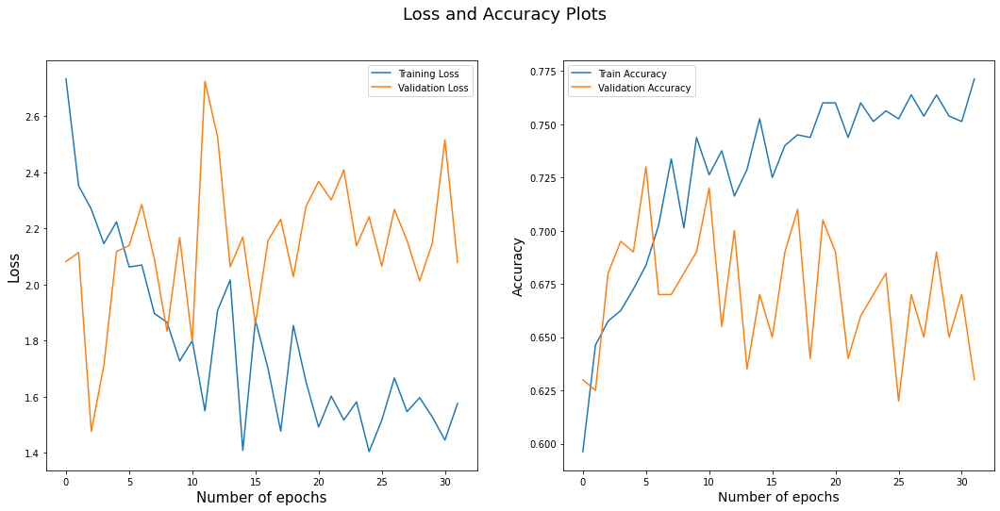

7/7 [==============================] - 2s 39ms/step
0.805


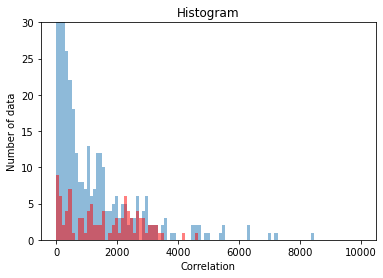

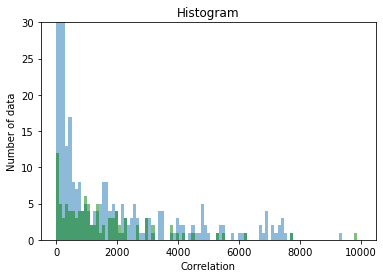

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_1 (Dropout)         (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


19/19 [==============================] - 8s 163ms/step - loss: 2.5116 - acc: 0.6037 - val_loss: 1.6870 - val_acc: 0.7200
Epoch 2/32
19/19 [==============================] - 1s 59ms/step - loss: 1.7688 - acc: 0.7007 - val_loss: 1.2709 - val_acc: 0.7467
Epoch 3/32
19/19 [==============================] - 1s 54ms/step - loss: 1.6452 - acc: 0.7274 - val_loss: 1.3804 - val_acc: 0.7400
Epoch 4/32
19/19 [==============================] - 1s 56ms/step - loss: 1.4132 - acc: 0.7676 - val_loss: 1.2909 - val_acc: 0.7267
Epoch 5/32
19/19 [==============================] - 1s 59ms/step - loss: 1.3286 - acc: 0.7625 - val_loss: 1.4367 - val_acc: 0.7400
Epoch 6/32
19/19 [==============================] - 1s 57ms/step - loss: 1.3864 - acc: 0.7659 - val_loss: 1.4048 - val_acc: 0.7133
Epoch 7/32
19/19 [==============================] - 1s 54ms/step - loss: 1.2260 - acc: 0.7776 - val_loss: 1.7085 - val_acc: 0.7867
Epoch 8/32
19/19 [==============================] - 1s 55ms/step - loss: 1.3384 - acc: 0.7860

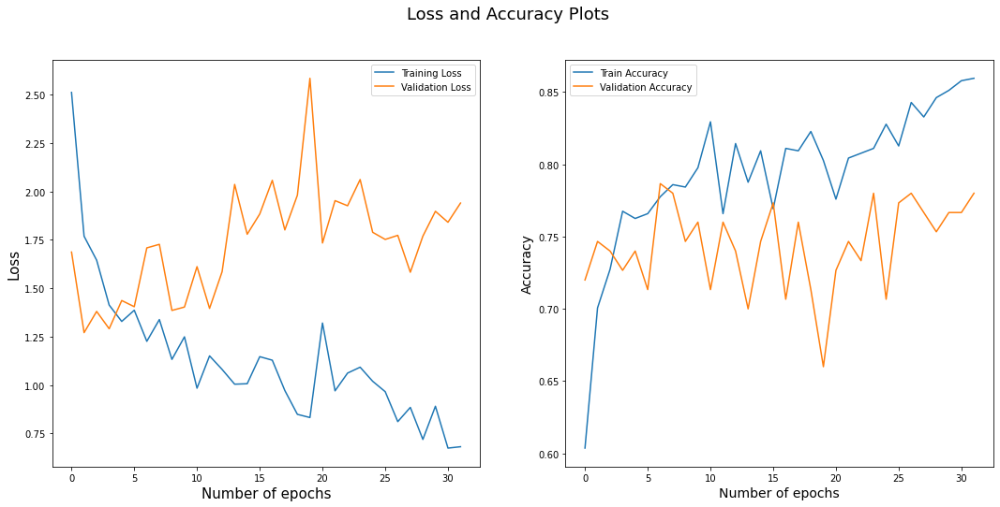

32/32 [==============================] - 1s 34ms/step
Round:  0
Test Accuracy:  0.82
Label Accuracy:  0.841
Number of catagory 1:  495.0
Number of catagory 2:  505.0
Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_2 (Dropout)         (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoc

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 134ms/step - loss: 2.0814 - acc: 0.6975 - val_loss: 0.9751 - val_acc: 0.7950
Epoch 2/32
25/25 [==============================] - 1s 54ms/step - loss: 1.3607 - acc: 0.7575 - val_loss: 0.9425 - val_acc: 0.8050
Epoch 3/32
25/25 [==============================] - 1s 55ms/step - loss: 1.4632 - acc: 0.7738 - val_loss: 1.0127 - val_acc: 0.8250
Epoch 4/32
25/25 [==============================] - 1s 54ms/step - loss: 1.3436 - acc: 0.7837 - val_loss: 0.7544 - val_acc: 0.8350
Epoch 5/32
25/25 [==============================] - 1s 55ms/step - loss: 1.1256 - acc: 0.8087 - val_loss: 0.5523 - val_acc: 0.8550
Epoch 6/32
25/25 [==============================] - 1s 55ms/step - loss: 1.1737 - acc: 0.8000 - val_loss: 0.7524 - val_acc: 0.8500
Epoch 7/32
25/25 [==============================] - 1s 55ms/step - loss: 0.9978 - acc: 0.8163 - val_loss: 0.7163 - val_acc: 0.8500
Epoch 8/32
25/25 [==============================] - 1s 53ms/step - loss: 0.8674 - acc: 0.8275

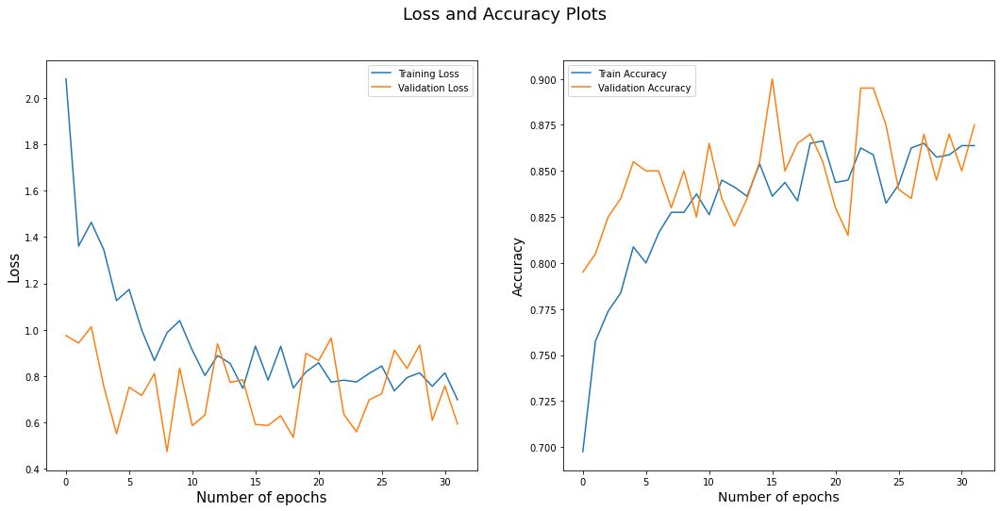

7/7 [==============================] - 2s 36ms/step
0.845


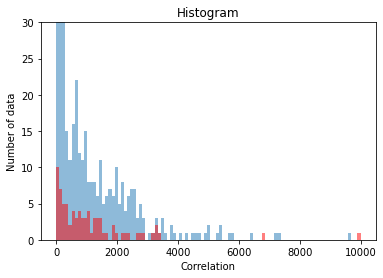

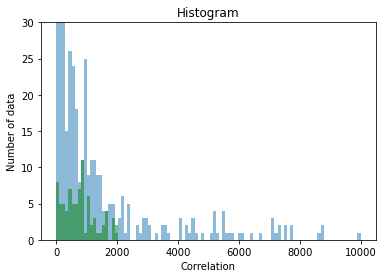

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_3 (Dropout)         (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


22/22 [==============================] - 9s 152ms/step - loss: 2.0849 - acc: 0.6600 - val_loss: 1.7232 - val_acc: 0.7200
Epoch 2/32
22/22 [==============================] - 1s 56ms/step - loss: 1.3952 - acc: 0.7633 - val_loss: 1.5295 - val_acc: 0.7200
Epoch 3/32
22/22 [==============================] - 1s 58ms/step - loss: 1.4325 - acc: 0.7547 - val_loss: 0.9182 - val_acc: 0.8229
Epoch 4/32
22/22 [==============================] - 1s 55ms/step - loss: 1.4457 - acc: 0.7719 - val_loss: 1.0420 - val_acc: 0.8057
Epoch 5/32
22/22 [==============================] - 1s 57ms/step - loss: 1.1388 - acc: 0.7891 - val_loss: 0.6745 - val_acc: 0.8286
Epoch 6/32
22/22 [==============================] - 1s 55ms/step - loss: 1.2540 - acc: 0.7963 - val_loss: 0.7748 - val_acc: 0.8171
Epoch 7/32
22/22 [==============================] - 1s 54ms/step - loss: 1.0228 - acc: 0.8207 - val_loss: 0.7026 - val_acc: 0.8514
Epoch 8/32
22/22 [==============================] - 1s 57ms/step - loss: 1.1666 - acc: 0.8192

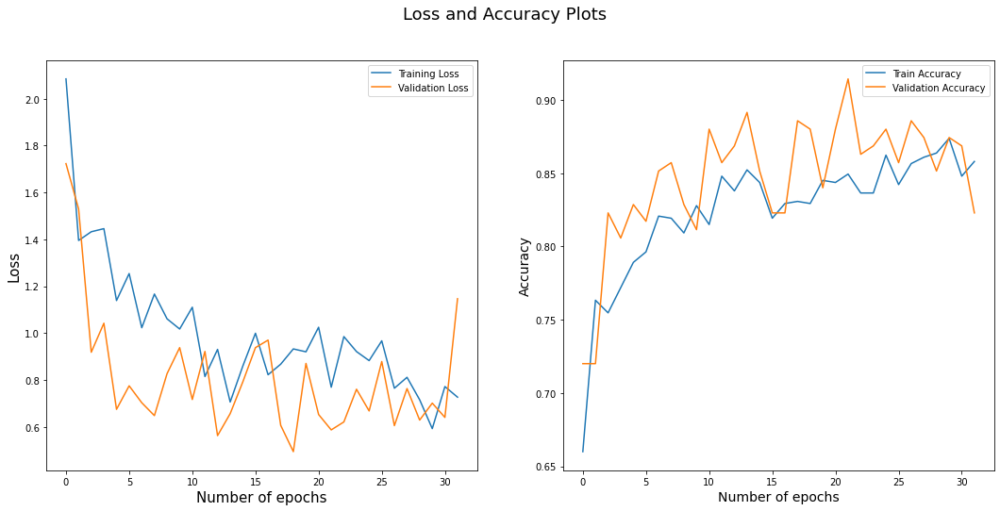

32/32 [==============================] - 1s 34ms/step
Round:  1
Test Accuracy:  0.78
Label Accuracy:  0.838
Number of catagory 1:  462.0
Number of catagory 2:  538.0
Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_4 (Dropout)         (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoc

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 124ms/step - loss: 2.1014 - acc: 0.7163 - val_loss: 0.7405 - val_acc: 0.8350
Epoch 2/32
25/25 [==============================] - 1s 51ms/step - loss: 1.3469 - acc: 0.7713 - val_loss: 0.4959 - val_acc: 0.8550
Epoch 3/32
25/25 [==============================] - 1s 54ms/step - loss: 1.4221 - acc: 0.7925 - val_loss: 0.5207 - val_acc: 0.8600
Epoch 4/32
25/25 [==============================] - 1s 56ms/step - loss: 1.0734 - acc: 0.8163 - val_loss: 0.5094 - val_acc: 0.9050
Epoch 5/32
25/25 [==============================] - 1s 54ms/step - loss: 1.1394 - acc: 0.8025 - val_loss: 0.4432 - val_acc: 0.9000
Epoch 6/32
25/25 [==============================] - 1s 56ms/step - loss: 0.9856 - acc: 0.8363 - val_loss: 0.5450 - val_acc: 0.8800
Epoch 7/32
25/25 [==============================] - 1s 53ms/step - loss: 0.9598 - acc: 0.8338 - val_loss: 0.4792 - val_acc: 0.9050
Epoch 8/32
25/25 [==============================] - 1s 58ms/step - loss: 0.9453 - acc: 0.8413

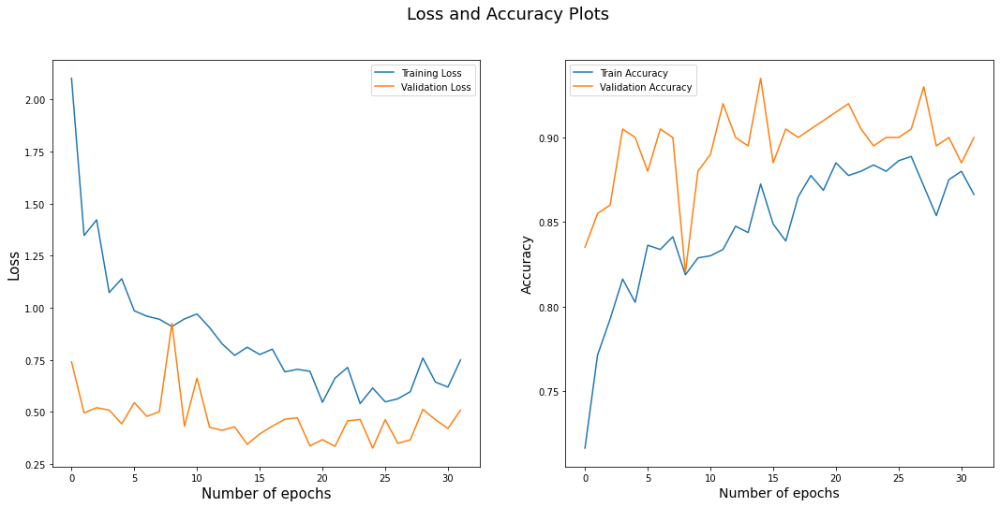

7/7 [==============================] - 2s 35ms/step
0.895


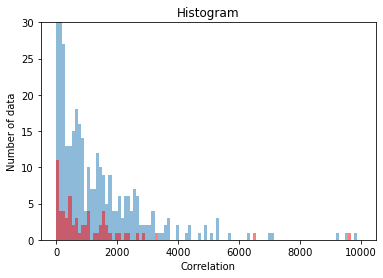

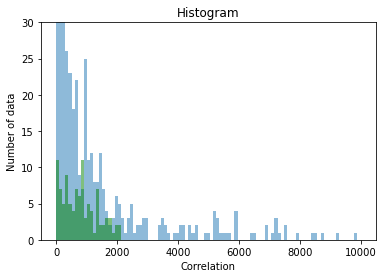

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_5 (Dropout)         (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


24/24 [==============================] - 9s 148ms/step - loss: 1.9913 - acc: 0.7072 - val_loss: 0.7258 - val_acc: 0.8449
Epoch 2/32
24/24 [==============================] - 1s 54ms/step - loss: 1.5040 - acc: 0.7527 - val_loss: 0.6753 - val_acc: 0.8556
Epoch 3/32
24/24 [==============================] - 1s 52ms/step - loss: 1.5115 - acc: 0.7647 - val_loss: 0.5840 - val_acc: 0.8396
Epoch 4/32
24/24 [==============================] - 1s 55ms/step - loss: 1.2300 - acc: 0.7928 - val_loss: 0.7056 - val_acc: 0.8663
Epoch 5/32
24/24 [==============================] - 1s 55ms/step - loss: 1.1596 - acc: 0.8075 - val_loss: 0.6009 - val_acc: 0.8930
Epoch 6/32
24/24 [==============================] - 1s 53ms/step - loss: 1.0891 - acc: 0.8008 - val_loss: 0.4579 - val_acc: 0.8877
Epoch 7/32
24/24 [==============================] - 1s 52ms/step - loss: 1.0646 - acc: 0.8088 - val_loss: 0.5030 - val_acc: 0.9198
Epoch 8/32
24/24 [==============================] - 1s 52ms/step - loss: 1.0707 - acc: 0.8222

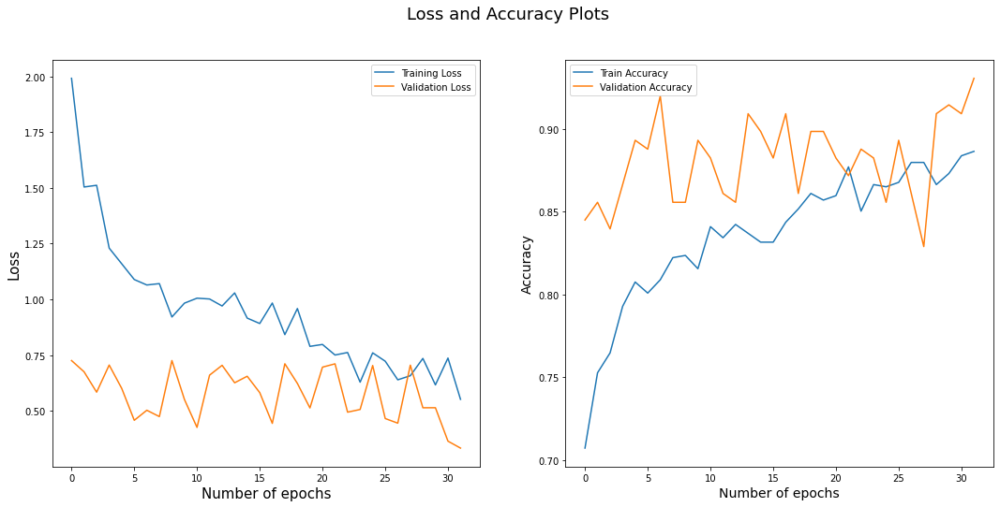

32/32 [==============================] - 1s 38ms/step
Round:  2
Test Accuracy:  0.875
Label Accuracy:  0.839
Number of catagory 1:  469.0
Number of catagory 2:  531.0
Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_6 (Dropout)         (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epo

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 141ms/step - loss: 1.7451 - acc: 0.7225 - val_loss: 0.4032 - val_acc: 0.8950
Epoch 2/32
25/25 [==============================] - 1s 56ms/step - loss: 1.3010 - acc: 0.7763 - val_loss: 0.2399 - val_acc: 0.9200
Epoch 3/32
25/25 [==============================] - 1s 57ms/step - loss: 1.2189 - acc: 0.7937 - val_loss: 0.2980 - val_acc: 0.8950
Epoch 4/32
25/25 [==============================] - 1s 54ms/step - loss: 1.1100 - acc: 0.8025 - val_loss: 0.3406 - val_acc: 0.9000
Epoch 5/32
25/25 [==============================] - 1s 58ms/step - loss: 1.0472 - acc: 0.8037 - val_loss: 0.3411 - val_acc: 0.9100
Epoch 6/32
25/25 [==============================] - 1s 58ms/step - loss: 0.9963 - acc: 0.8225 - val_loss: 0.2485 - val_acc: 0.9300
Epoch 7/32
25/25 [==============================] - 1s 55ms/step - loss: 0.8415 - acc: 0.8487 - val_loss: 0.2849 - val_acc: 0.9050
Epoch 8/32
25/25 [==============================] - 1s 55ms/step - loss: 0.8536 - acc: 0.8400

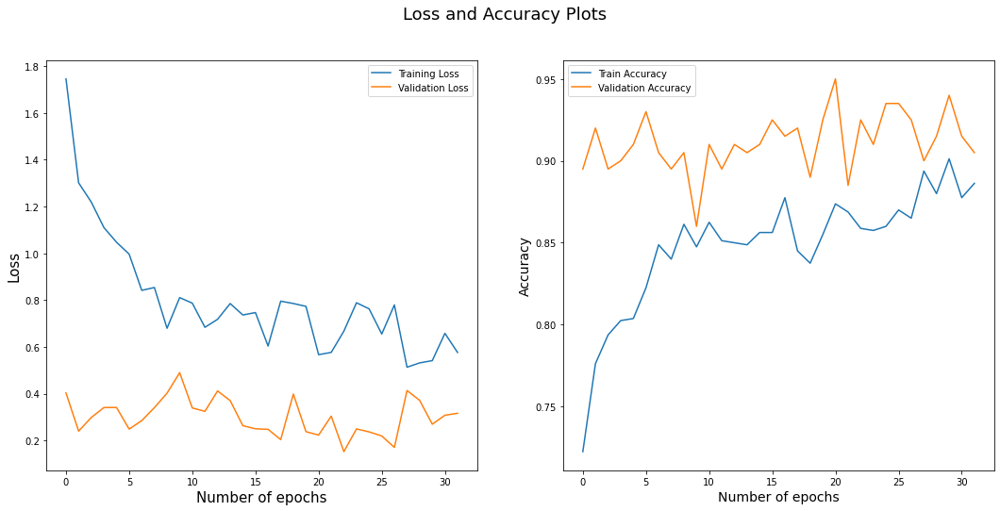

7/7 [==============================] - 2s 39ms/step
0.875


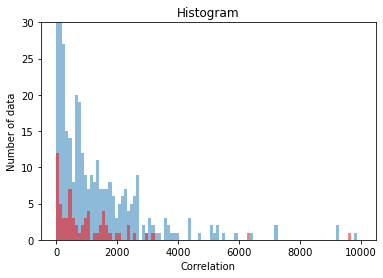

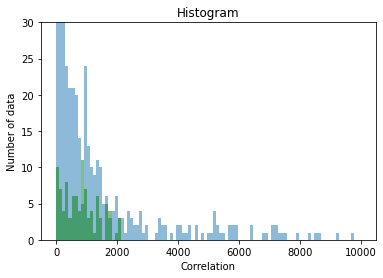

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_7 (Dropout)         (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 147ms/step - loss: 2.0780 - acc: 0.6865 - val_loss: 0.4816 - val_acc: 0.8660
Epoch 2/32
25/25 [==============================] - 1s 58ms/step - loss: 1.3956 - acc: 0.7837 - val_loss: 0.7825 - val_acc: 0.8505
Epoch 3/32
25/25 [==============================] - 1s 57ms/step - loss: 1.5943 - acc: 0.7824 - val_loss: 0.3262 - val_acc: 0.9021
Epoch 4/32
25/25 [==============================] - 1s 56ms/step - loss: 1.3166 - acc: 0.8148 - val_loss: 0.4674 - val_acc: 0.8763
Epoch 5/32
25/25 [==============================] - 1s 55ms/step - loss: 1.1989 - acc: 0.8044 - val_loss: 0.5571 - val_acc: 0.8454
Epoch 6/32
25/25 [==============================] - 1s 54ms/step - loss: 1.2680 - acc: 0.7992 - val_loss: 0.8241 - val_acc: 0.8402
Epoch 7/32
25/25 [==============================] - 1s 56ms/step - loss: 1.1083 - acc: 0.8277 - val_loss: 0.3666 - val_acc: 0.8866
Epoch 8/32
25/25 [==============================] - 1s 52ms/step - loss: 1.0605 - acc: 0.8368

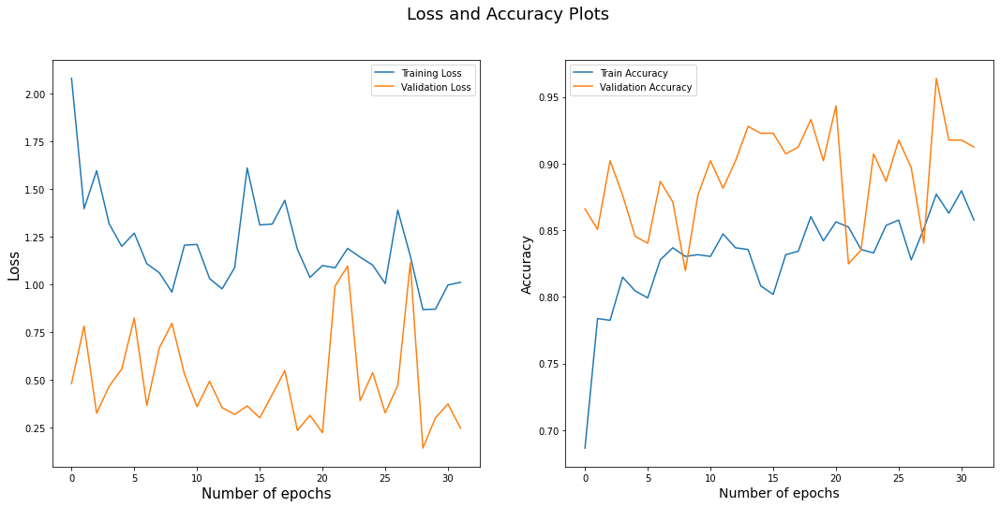

32/32 [==============================] - 1s 39ms/step
Round:  3
Test Accuracy:  0.835
Label Accuracy:  0.844
Number of catagory 1:  470.0
Number of catagory 2:  530.0
Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_8 (Dropout)         (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epo

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 128ms/step - loss: 2.4210 - acc: 0.7000 - val_loss: 0.4940 - val_acc: 0.8400
Epoch 2/32
25/25 [==============================] - 1s 55ms/step - loss: 1.3899 - acc: 0.7713 - val_loss: 0.5324 - val_acc: 0.8800
Epoch 3/32
25/25 [==============================] - 1s 53ms/step - loss: 1.4046 - acc: 0.7887 - val_loss: 0.3436 - val_acc: 0.8950
Epoch 4/32
25/25 [==============================] - 1s 53ms/step - loss: 1.0396 - acc: 0.8125 - val_loss: 0.2931 - val_acc: 0.9050
Epoch 5/32
25/25 [==============================] - 1s 53ms/step - loss: 0.8071 - acc: 0.8450 - val_loss: 0.4904 - val_acc: 0.8650
Epoch 6/32
25/25 [==============================] - 1s 53ms/step - loss: 0.9169 - acc: 0.8075 - val_loss: 0.2155 - val_acc: 0.9400
Epoch 7/32
25/25 [==============================] - 1s 54ms/step - loss: 0.7424 - acc: 0.8413 - val_loss: 0.2299 - val_acc: 0.9250
Epoch 8/32
25/25 [==============================] - 1s 51ms/step - loss: 0.7167 - acc: 0.8475

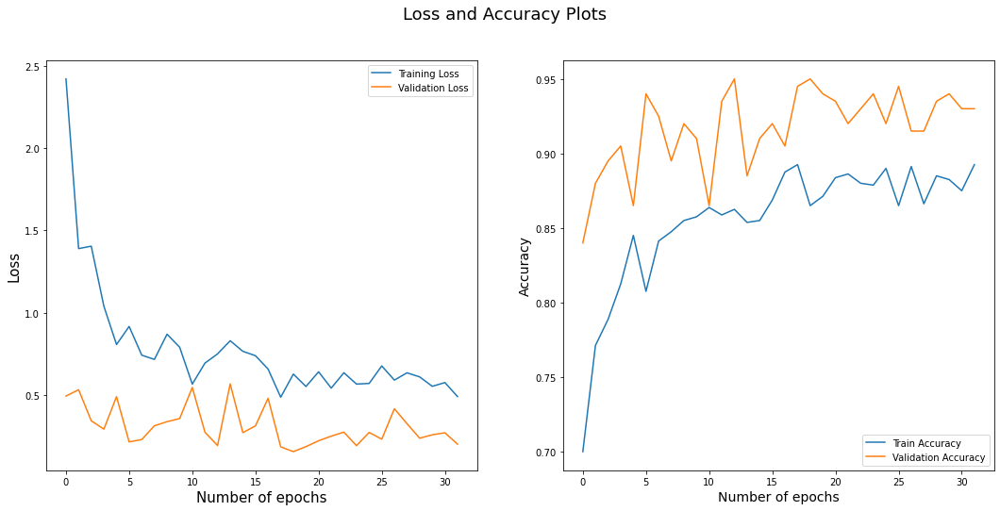

7/7 [==============================] - 2s 37ms/step
0.88


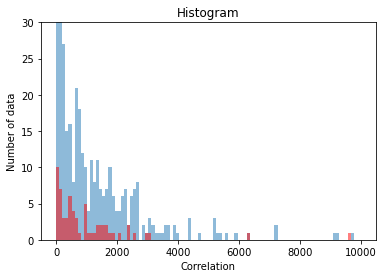

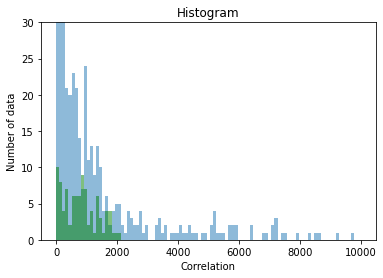

Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_9 (Dropout)         (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 145ms/step - loss: 1.9755 - acc: 0.7003 - val_loss: 1.2167 - val_acc: 0.7766
Epoch 2/32
25/25 [==============================] - 1s 56ms/step - loss: 1.4157 - acc: 0.7742 - val_loss: 0.4282 - val_acc: 0.8883
Epoch 3/32
25/25 [==============================] - 1s 56ms/step - loss: 1.2390 - acc: 0.7997 - val_loss: 0.5998 - val_acc: 0.8629
Epoch 4/32
25/25 [==============================] - 1s 55ms/step - loss: 1.1906 - acc: 0.7934 - val_loss: 0.6247 - val_acc: 0.8782
Epoch 5/32
25/25 [==============================] - 1s 53ms/step - loss: 1.1640 - acc: 0.8253 - val_loss: 0.4971 - val_acc: 0.9086
Epoch 6/32
25/25 [==============================] - 1s 56ms/step - loss: 1.0906 - acc: 0.8023 - val_loss: 0.5948 - val_acc: 0.8629
Epoch 7/32
25/25 [==============================] - 1s 52ms/step - loss: 0.9861 - acc: 0.8227 - val_loss: 0.2922 - val_acc: 0.9340
Epoch 8/32
25/25 [==============================] - 1s 52ms/step - loss: 0.9527 - acc: 0.8444

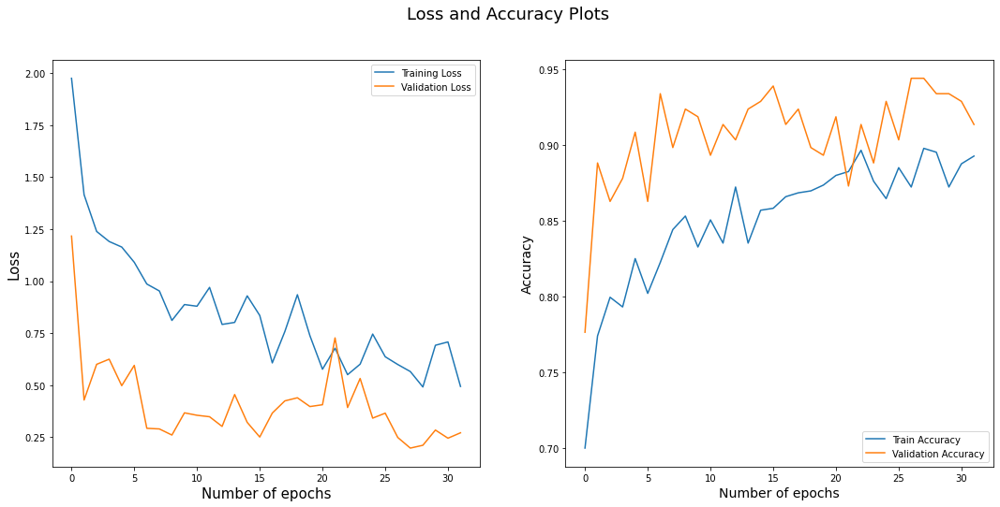

32/32 [==============================] - 1s 40ms/step
Round:  4
Test Accuracy:  0.795
Label Accuracy:  0.841
Number of catagory 1:  465.0
Number of catagory 2:  535.0
Model: "sequential_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_10 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Ep

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 10s 148ms/step - loss: 1.9413 - acc: 0.7312 - val_loss: 0.7832 - val_acc: 0.7950
Epoch 2/32
25/25 [==============================] - 1s 58ms/step - loss: 1.2848 - acc: 0.7700 - val_loss: 0.4344 - val_acc: 0.8950
Epoch 3/32
25/25 [==============================] - 1s 59ms/step - loss: 1.2202 - acc: 0.8112 - val_loss: 0.3816 - val_acc: 0.9150
Epoch 4/32
25/25 [==============================] - 1s 55ms/step - loss: 1.0103 - acc: 0.8200 - val_loss: 0.3152 - val_acc: 0.9200
Epoch 5/32
25/25 [==============================] - 1s 53ms/step - loss: 0.9258 - acc: 0.8263 - val_loss: 0.2167 - val_acc: 0.9500
Epoch 6/32
25/25 [==============================] - 1s 59ms/step - loss: 1.0468 - acc: 0.8037 - val_loss: 0.2906 - val_acc: 0.9200
Epoch 7/32
25/25 [==============================] - 1s 55ms/step - loss: 0.8478 - acc: 0.8425 - val_loss: 0.2442 - val_acc: 0.9150
Epoch 8/32
25/25 [==============================] - 1s 56ms/step - loss: 0.7258 - acc: 0.861

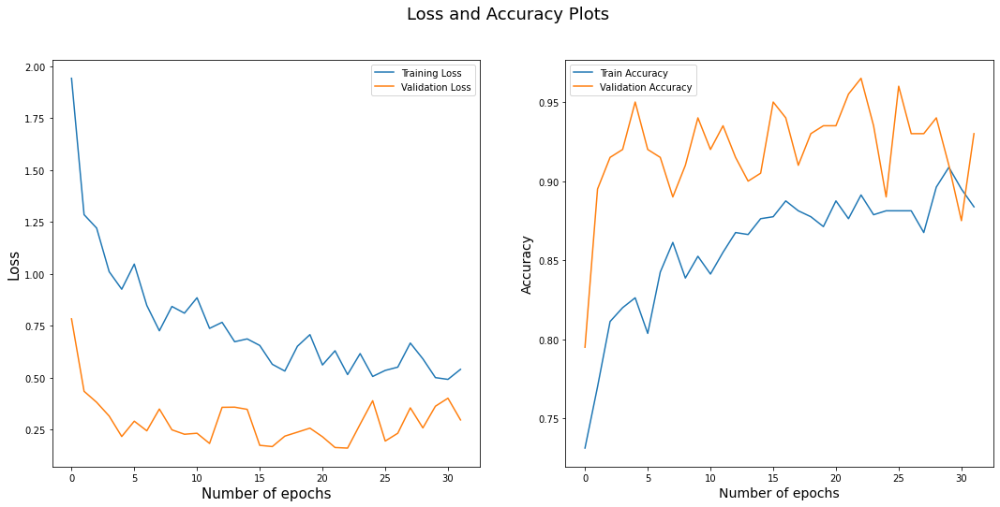

7/7 [==============================] - 2s 35ms/step
0.895


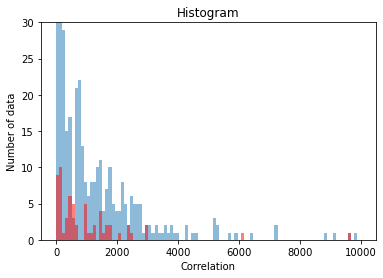

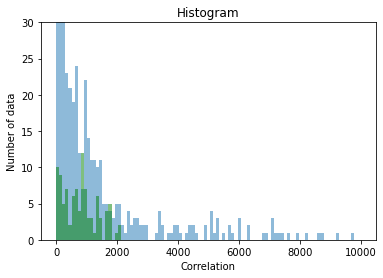

Model: "sequential_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_11 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 10s 156ms/step - loss: 1.8993 - acc: 0.7231 - val_loss: 0.2213 - val_acc: 0.9343
Epoch 2/32
25/25 [==============================] - 1s 53ms/step - loss: 1.1796 - acc: 0.7788 - val_loss: 0.2423 - val_acc: 0.9040
Epoch 3/32
25/25 [==============================] - 1s 52ms/step - loss: 1.2647 - acc: 0.7965 - val_loss: 0.3474 - val_acc: 0.9141
Epoch 4/32
25/25 [==============================] - 1s 52ms/step - loss: 1.0819 - acc: 0.8028 - val_loss: 0.1380 - val_acc: 0.9545
Epoch 5/32
25/25 [==============================] - 1s 55ms/step - loss: 1.0409 - acc: 0.8243 - val_loss: 0.1645 - val_acc: 0.9495
Epoch 6/32
25/25 [==============================] - 1s 58ms/step - loss: 0.8769 - acc: 0.8432 - val_loss: 0.2895 - val_acc: 0.9242
Epoch 7/32
25/25 [==============================] - 1s 58ms/step - loss: 0.9378 - acc: 0.8369 - val_loss: 0.2715 - val_acc: 0.9242
Epoch 8/32
25/25 [==============================] - 1s 57ms/step - loss: 0.9745 - acc: 0.844

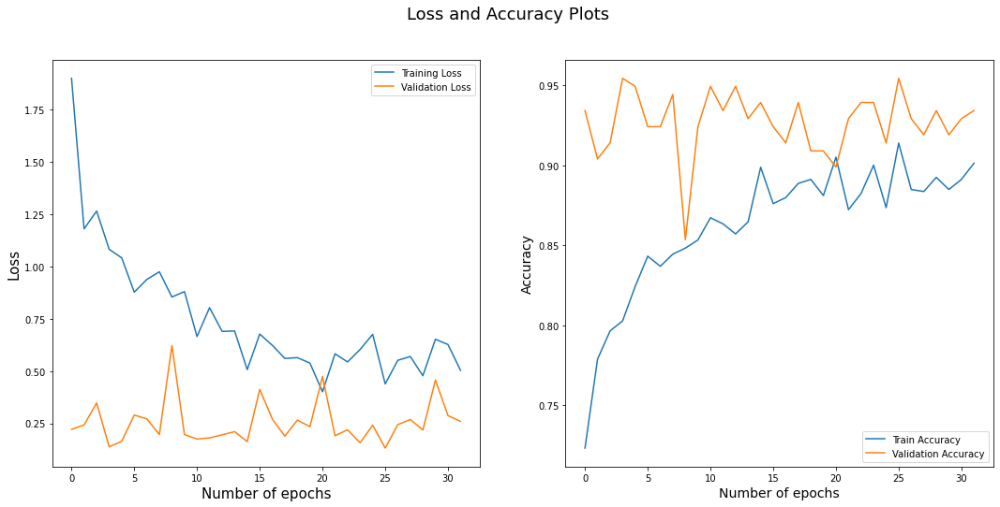

32/32 [==============================] - 1s 37ms/step
Round:  5
Test Accuracy:  0.865
Label Accuracy:  0.843
Number of catagory 1:  473.0
Number of catagory 2:  527.0
Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_12 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Ep

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 134ms/step - loss: 1.9372 - acc: 0.7437 - val_loss: 0.5316 - val_acc: 0.8500
Epoch 2/32
25/25 [==============================] - 1s 55ms/step - loss: 1.2571 - acc: 0.7750 - val_loss: 0.3776 - val_acc: 0.8750
Epoch 3/32
25/25 [==============================] - 1s 57ms/step - loss: 1.1458 - acc: 0.8175 - val_loss: 0.4177 - val_acc: 0.9100
Epoch 4/32
25/25 [==============================] - 1s 51ms/step - loss: 0.9404 - acc: 0.8200 - val_loss: 0.4374 - val_acc: 0.9000
Epoch 5/32
25/25 [==============================] - 1s 57ms/step - loss: 0.8702 - acc: 0.8388 - val_loss: 0.3647 - val_acc: 0.9300
Epoch 6/32
25/25 [==============================] - 1s 56ms/step - loss: 0.7286 - acc: 0.8550 - val_loss: 0.3384 - val_acc: 0.9300
Epoch 7/32
25/25 [==============================] - 1s 54ms/step - loss: 0.8619 - acc: 0.8350 - val_loss: 0.2760 - val_acc: 0.9300
Epoch 8/32
25/25 [==============================] - 1s 57ms/step - loss: 0.6664 - acc: 0.8475

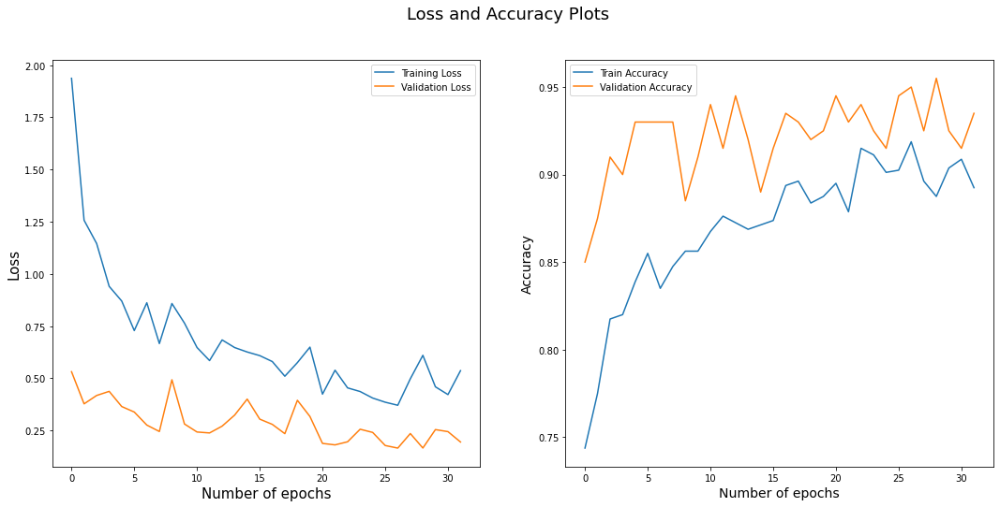

7/7 [==============================] - 2s 37ms/step
0.87


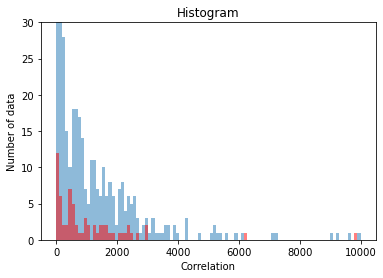

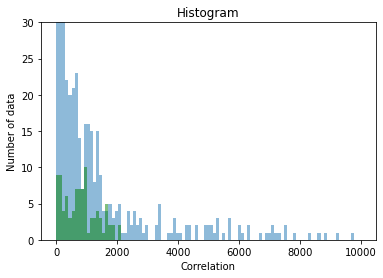

Model: "sequential_13"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_13 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 153ms/step - loss: 1.5774 - acc: 0.7481 - val_loss: 0.5462 - val_acc: 0.8844
Epoch 2/32
25/25 [==============================] - 1s 56ms/step - loss: 1.2525 - acc: 0.7947 - val_loss: 0.9019 - val_acc: 0.8141
Epoch 3/32
25/25 [==============================] - 1s 59ms/step - loss: 1.0400 - acc: 0.8111 - val_loss: 0.3727 - val_acc: 0.9146
Epoch 4/32
25/25 [==============================] - 1s 57ms/step - loss: 0.9801 - acc: 0.8161 - val_loss: 0.3059 - val_acc: 0.9146
Epoch 5/32
25/25 [==============================] - 1s 56ms/step - loss: 1.0182 - acc: 0.8375 - val_loss: 0.4068 - val_acc: 0.8844
Epoch 6/32
25/25 [==============================] - 1s 59ms/step - loss: 0.7105 - acc: 0.8552 - val_loss: 0.4071 - val_acc: 0.8794
Epoch 7/32
25/25 [==============================] - 1s 58ms/step - loss: 0.5678 - acc: 0.8829 - val_loss: 0.3637 - val_acc: 0.9146
Epoch 8/32
25/25 [==============================] - 1s 54ms/step - loss: 0.7453 - acc: 0.8715

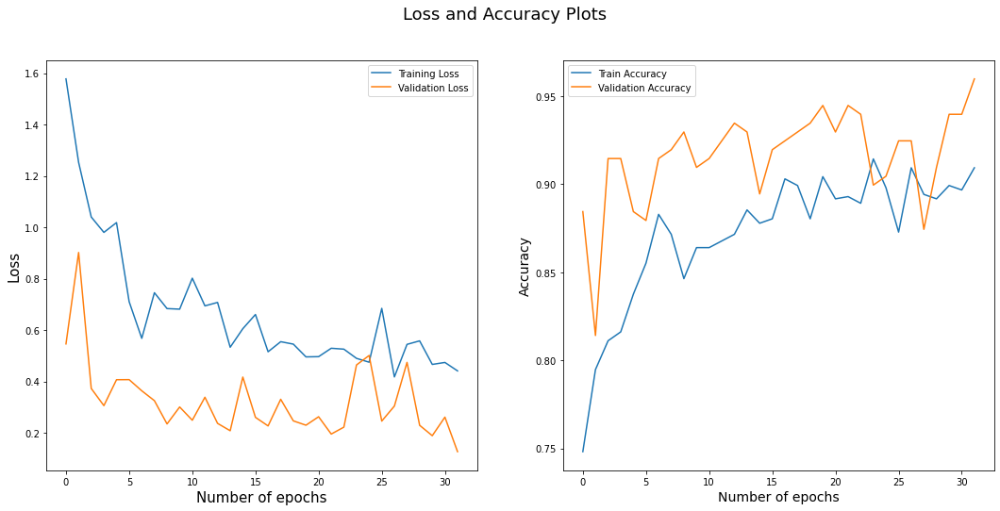

32/32 [==============================] - 1s 40ms/step
Round:  6
Test Accuracy:  0.85
Label Accuracy:  0.843
Number of catagory 1:  471.0
Number of catagory 2:  529.0
Model: "sequential_14"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_14 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epo

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 11s 152ms/step - loss: 1.5901 - acc: 0.7400 - val_loss: 0.6207 - val_acc: 0.8750
Epoch 2/32
25/25 [==============================] - 2s 61ms/step - loss: 1.1491 - acc: 0.7825 - val_loss: 0.3796 - val_acc: 0.8950
Epoch 3/32
25/25 [==============================] - 1s 57ms/step - loss: 1.0397 - acc: 0.8163 - val_loss: 0.2060 - val_acc: 0.9500
Epoch 4/32
25/25 [==============================] - 1s 58ms/step - loss: 1.0100 - acc: 0.8250 - val_loss: 0.2095 - val_acc: 0.9250
Epoch 5/32
25/25 [==============================] - 1s 57ms/step - loss: 0.8962 - acc: 0.8400 - val_loss: 0.3416 - val_acc: 0.9050
Epoch 6/32
25/25 [==============================] - 1s 53ms/step - loss: 0.8271 - acc: 0.8587 - val_loss: 0.3257 - val_acc: 0.9000
Epoch 7/32
25/25 [==============================] - 1s 59ms/step - loss: 0.8863 - acc: 0.8288 - val_loss: 0.3991 - val_acc: 0.9000
Epoch 8/32
25/25 [==============================] - 1s 55ms/step - loss: 0.7718 - acc: 0.860

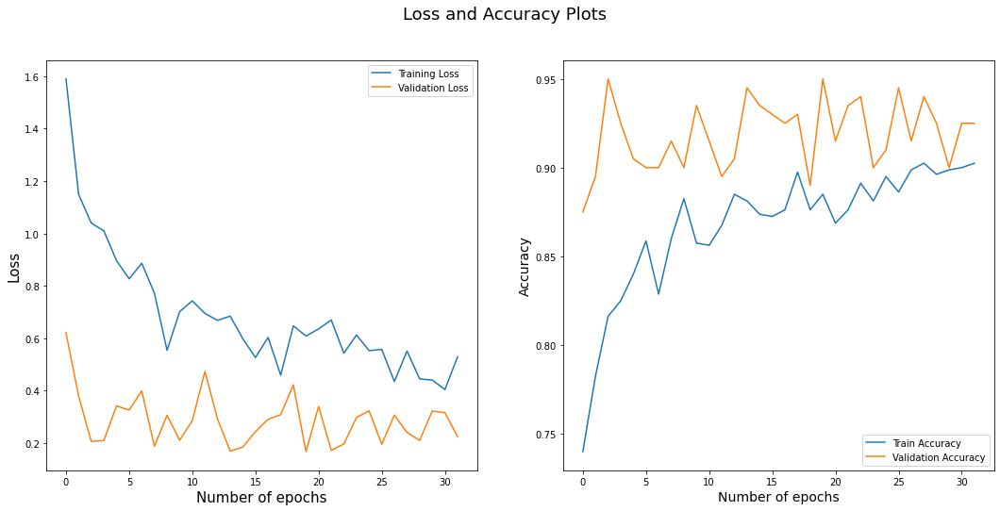

7/7 [==============================] - 2s 39ms/step
0.82


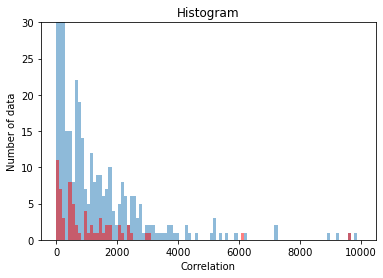

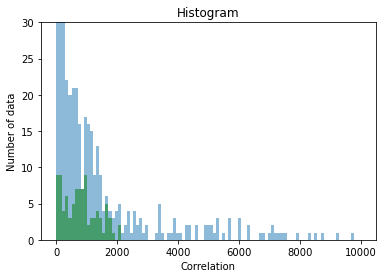

Model: "sequential_15"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_15 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 10s 144ms/step - loss: 1.8952 - acc: 0.7525 - val_loss: 0.5560 - val_acc: 0.8794
Epoch 2/32
25/25 [==============================] - 1s 58ms/step - loss: 1.1032 - acc: 0.8015 - val_loss: 0.4792 - val_acc: 0.8744
Epoch 3/32
25/25 [==============================] - 1s 55ms/step - loss: 1.0641 - acc: 0.8417 - val_loss: 0.4629 - val_acc: 0.8894
Epoch 4/32
25/25 [==============================] - 1s 58ms/step - loss: 1.0446 - acc: 0.8291 - val_loss: 0.4597 - val_acc: 0.8794
Epoch 5/32
25/25 [==============================] - 1s 56ms/step - loss: 0.7525 - acc: 0.8442 - val_loss: 0.3221 - val_acc: 0.9246
Epoch 6/32
25/25 [==============================] - 1s 55ms/step - loss: 0.9277 - acc: 0.8455 - val_loss: 0.3473 - val_acc: 0.8995
Epoch 7/32
25/25 [==============================] - 1s 57ms/step - loss: 0.8424 - acc: 0.8580 - val_loss: 0.2663 - val_acc: 0.9246
Epoch 8/32
25/25 [==============================] - 1s 55ms/step - loss: 0.7129 - acc: 0.853

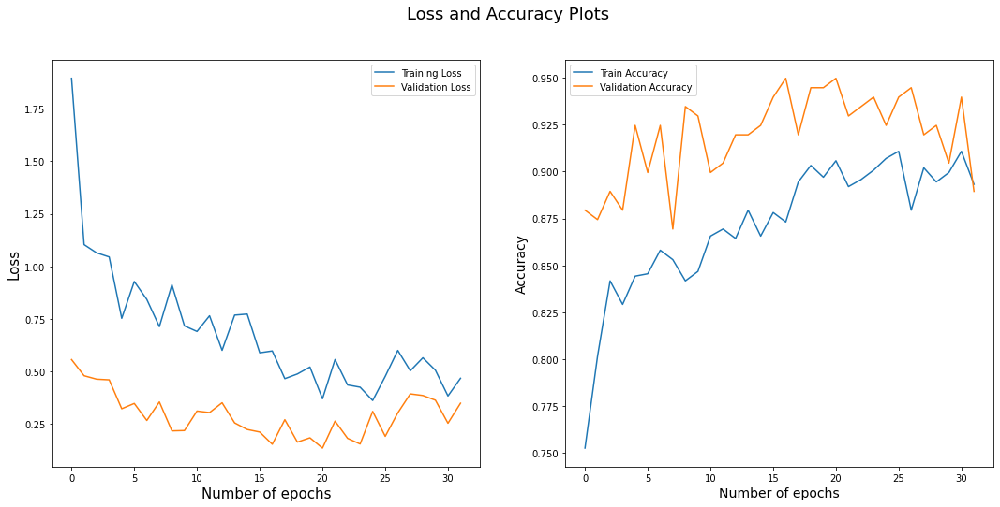

32/32 [==============================] - 1s 38ms/step
Round:  7
Test Accuracy:  0.85
Label Accuracy:  0.848
Number of catagory 1:  480.0
Number of catagory 2:  520.0
Model: "sequential_16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_16 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epo

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 127ms/step - loss: 1.5513 - acc: 0.7250 - val_loss: 0.6233 - val_acc: 0.8500
Epoch 2/32
25/25 [==============================] - 1s 56ms/step - loss: 1.1909 - acc: 0.8000 - val_loss: 0.5426 - val_acc: 0.8600
Epoch 3/32
25/25 [==============================] - 1s 53ms/step - loss: 0.9730 - acc: 0.8163 - val_loss: 0.5517 - val_acc: 0.8850
Epoch 4/32
25/25 [==============================] - 1s 55ms/step - loss: 0.9818 - acc: 0.8425 - val_loss: 0.3584 - val_acc: 0.9100
Epoch 5/32
25/25 [==============================] - 1s 53ms/step - loss: 0.8192 - acc: 0.8388 - val_loss: 0.5460 - val_acc: 0.8850
Epoch 6/32
25/25 [==============================] - 1s 52ms/step - loss: 0.8555 - acc: 0.8612 - val_loss: 0.3531 - val_acc: 0.9350
Epoch 7/32
25/25 [==============================] - 1s 52ms/step - loss: 0.8003 - acc: 0.8562 - val_loss: 0.5724 - val_acc: 0.8750
Epoch 8/32
25/25 [==============================] - 1s 55ms/step - loss: 0.7047 - acc: 0.8575

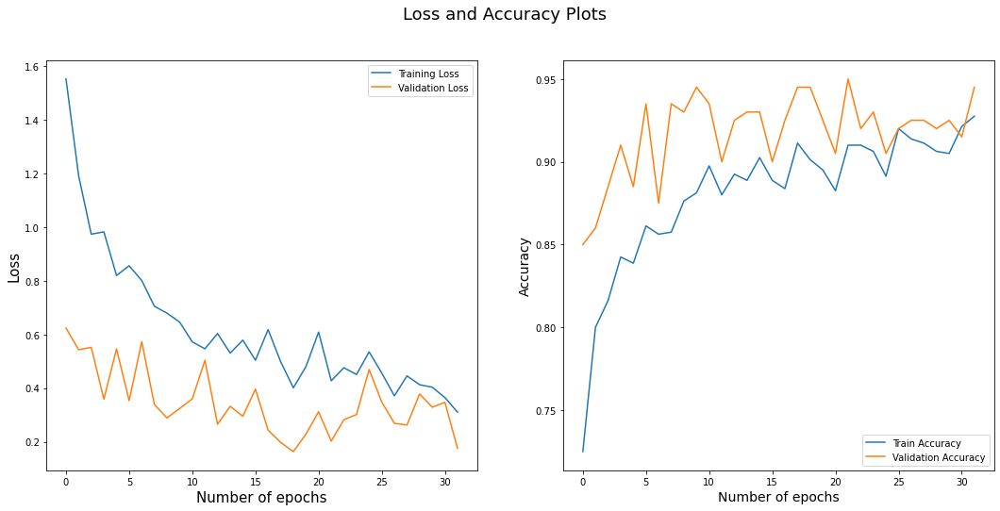

7/7 [==============================] - 2s 36ms/step
0.87


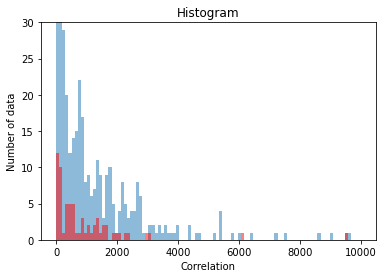

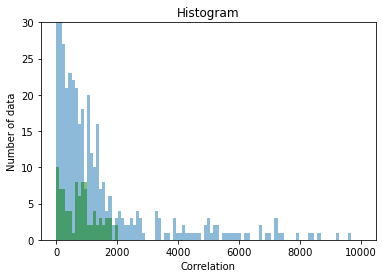

Model: "sequential_17"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_17 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 141ms/step - loss: 1.5959 - acc: 0.7425 - val_loss: 0.5885 - val_acc: 0.8850
Epoch 2/32
25/25 [==============================] - 1s 58ms/step - loss: 1.3623 - acc: 0.8065 - val_loss: 0.5300 - val_acc: 0.8900
Epoch 3/32
25/25 [==============================] - 1s 50ms/step - loss: 1.1545 - acc: 0.8153 - val_loss: 0.5084 - val_acc: 0.8700
Epoch 4/32
25/25 [==============================] - 1s 54ms/step - loss: 0.9107 - acc: 0.8317 - val_loss: 0.4518 - val_acc: 0.9100
Epoch 5/32
25/25 [==============================] - 1s 53ms/step - loss: 0.7760 - acc: 0.8606 - val_loss: 0.3570 - val_acc: 0.9050
Epoch 6/32
25/25 [==============================] - 1s 55ms/step - loss: 0.8013 - acc: 0.8417 - val_loss: 0.3925 - val_acc: 0.9250
Epoch 7/32
25/25 [==============================] - 1s 60ms/step - loss: 0.7966 - acc: 0.8555 - val_loss: 0.3909 - val_acc: 0.9150
Epoch 8/32
25/25 [==============================] - 1s 60ms/step - loss: 0.8091 - acc: 0.8706

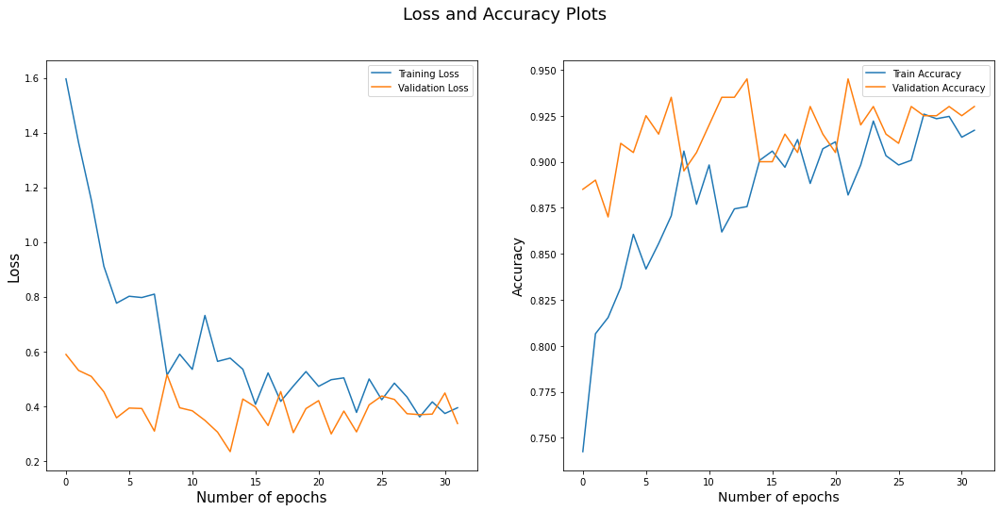

32/32 [==============================] - 1s 40ms/step
Round:  8
Test Accuracy:  0.87
Label Accuracy:  0.852
Number of catagory 1:  480.0
Number of catagory 2:  520.0
Model: "sequential_18"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_18 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epo

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 11s 150ms/step - loss: 1.8681 - acc: 0.7462 - val_loss: 0.3361 - val_acc: 0.9000
Epoch 2/32
25/25 [==============================] - 1s 60ms/step - loss: 1.1083 - acc: 0.8012 - val_loss: 0.1963 - val_acc: 0.9200
Epoch 3/32
25/25 [==============================] - 1s 56ms/step - loss: 1.0369 - acc: 0.8238 - val_loss: 0.2416 - val_acc: 0.9300
Epoch 4/32
25/25 [==============================] - 1s 55ms/step - loss: 0.8706 - acc: 0.8512 - val_loss: 0.2661 - val_acc: 0.9150
Epoch 5/32
25/25 [==============================] - 1s 55ms/step - loss: 0.7569 - acc: 0.8425 - val_loss: 0.2894 - val_acc: 0.9100
Epoch 6/32
25/25 [==============================] - 1s 57ms/step - loss: 0.7405 - acc: 0.8637 - val_loss: 0.3130 - val_acc: 0.9200
Epoch 7/32
25/25 [==============================] - 1s 57ms/step - loss: 0.7184 - acc: 0.8562 - val_loss: 0.3355 - val_acc: 0.8900
Epoch 8/32
25/25 [==============================] - 1s 57ms/step - loss: 0.6930 - acc: 0.860

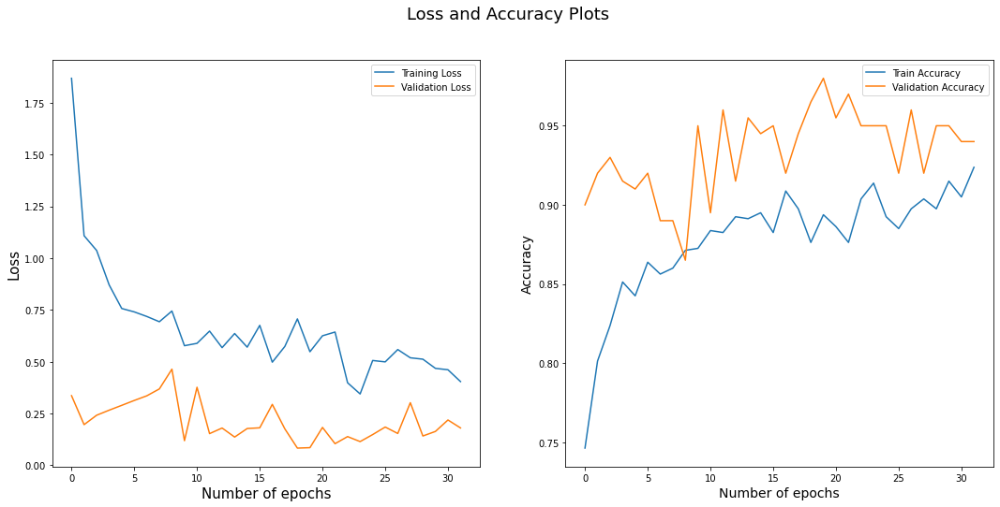

7/7 [==============================] - 3s 41ms/step
0.875


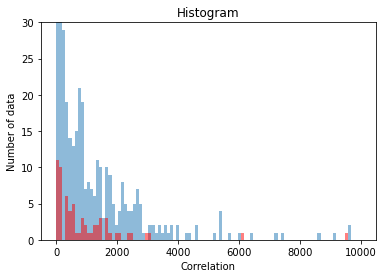

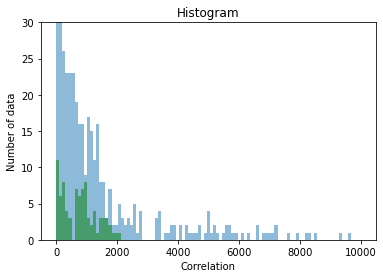

Model: "sequential_19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_19 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 10s 140ms/step - loss: 1.6499 - acc: 0.7349 - val_loss: 0.3898 - val_acc: 0.9050
Epoch 2/32
25/25 [==============================] - 1s 56ms/step - loss: 1.3052 - acc: 0.7789 - val_loss: 0.3727 - val_acc: 0.9050
Epoch 3/32
25/25 [==============================] - 1s 54ms/step - loss: 1.0736 - acc: 0.8204 - val_loss: 0.2207 - val_acc: 0.9200
Epoch 4/32
25/25 [==============================] - 1s 56ms/step - loss: 0.7960 - acc: 0.8480 - val_loss: 0.2931 - val_acc: 0.9150
Epoch 5/32
25/25 [==============================] - 1s 58ms/step - loss: 0.8106 - acc: 0.8455 - val_loss: 0.5189 - val_acc: 0.8850
Epoch 6/32
25/25 [==============================] - 1s 59ms/step - loss: 0.6522 - acc: 0.8693 - val_loss: 0.3143 - val_acc: 0.9400
Epoch 7/32
25/25 [==============================] - 1s 57ms/step - loss: 0.7842 - acc: 0.8606 - val_loss: 0.3163 - val_acc: 0.9050
Epoch 8/32
25/25 [==============================] - 1s 56ms/step - loss: 0.6893 - acc: 0.874

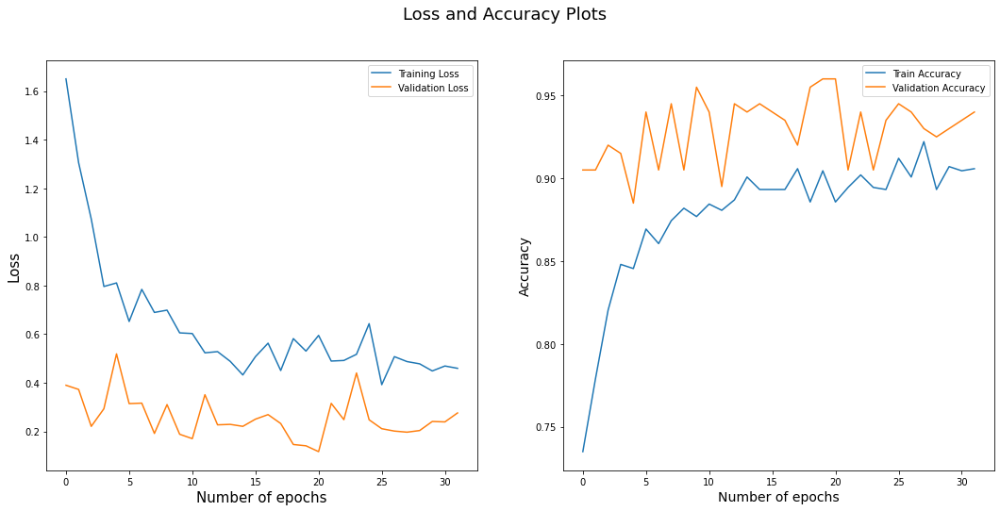

32/32 [==============================] - 1s 37ms/step
Round:  9
Test Accuracy:  0.865
Label Accuracy:  0.851
Number of catagory 1:  489.0
Number of catagory 2:  511.0
Model: "sequential_20"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_20 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Ep

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 10s 134ms/step - loss: 2.1352 - acc: 0.7350 - val_loss: 0.3384 - val_acc: 0.9100
Epoch 2/32
25/25 [==============================] - 1s 56ms/step - loss: 1.1275 - acc: 0.8250 - val_loss: 0.5079 - val_acc: 0.8550
Epoch 3/32
25/25 [==============================] - 1s 57ms/step - loss: 0.9720 - acc: 0.8363 - val_loss: 0.2289 - val_acc: 0.9100
Epoch 4/32
25/25 [==============================] - 1s 50ms/step - loss: 0.9721 - acc: 0.8250 - val_loss: 0.1914 - val_acc: 0.9200
Epoch 5/32
25/25 [==============================] - 1s 57ms/step - loss: 0.9838 - acc: 0.8475 - val_loss: 0.1578 - val_acc: 0.9450
Epoch 6/32
25/25 [==============================] - 1s 53ms/step - loss: 0.8217 - acc: 0.8413 - val_loss: 0.2091 - val_acc: 0.9400
Epoch 7/32
25/25 [==============================] - 1s 55ms/step - loss: 0.6700 - acc: 0.8875 - val_loss: 0.2657 - val_acc: 0.9250
Epoch 8/32
25/25 [==============================] - 1s 54ms/step - loss: 0.4906 - acc: 0.896

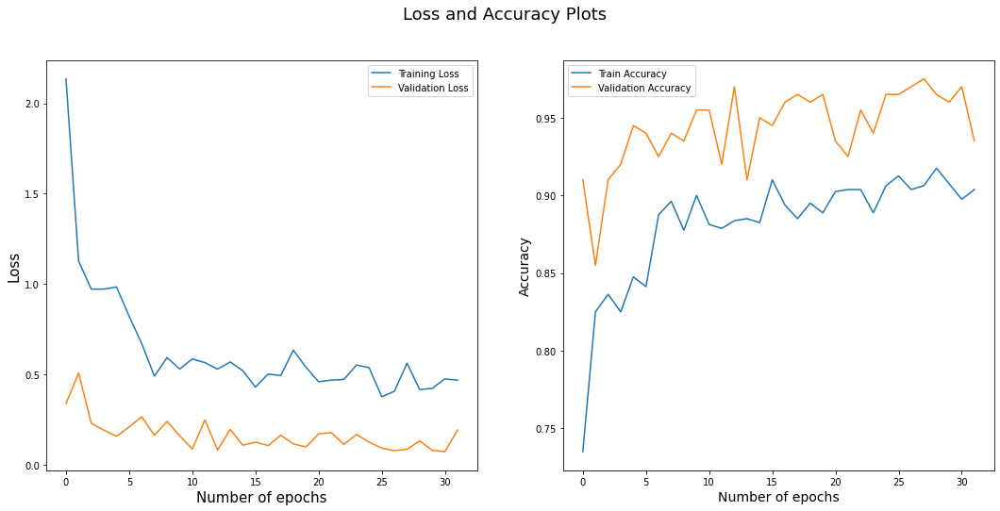

7/7 [==============================] - 2s 39ms/step
0.83


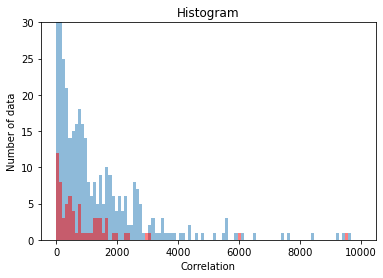

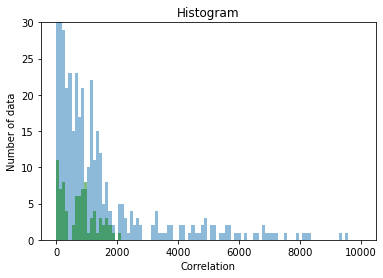

Model: "sequential_21"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_21 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 10s 152ms/step - loss: 1.5869 - acc: 0.7563 - val_loss: 0.4123 - val_acc: 0.9000
Epoch 2/32
25/25 [==============================] - 1s 54ms/step - loss: 1.3193 - acc: 0.8065 - val_loss: 0.5880 - val_acc: 0.8700
Epoch 3/32
25/25 [==============================] - 1s 57ms/step - loss: 0.9581 - acc: 0.8279 - val_loss: 0.3329 - val_acc: 0.8850
Epoch 4/32
25/25 [==============================] - 2s 62ms/step - loss: 0.9068 - acc: 0.8329 - val_loss: 0.2275 - val_acc: 0.9400
Epoch 5/32
25/25 [==============================] - 1s 59ms/step - loss: 0.7534 - acc: 0.8631 - val_loss: 0.3488 - val_acc: 0.9050
Epoch 6/32
25/25 [==============================] - 1s 55ms/step - loss: 0.7158 - acc: 0.8794 - val_loss: 0.1994 - val_acc: 0.9250
Epoch 7/32
25/25 [==============================] - 1s 56ms/step - loss: 0.7078 - acc: 0.8593 - val_loss: 0.3549 - val_acc: 0.9100
Epoch 8/32
25/25 [==============================] - 1s 58ms/step - loss: 0.6516 - acc: 0.856

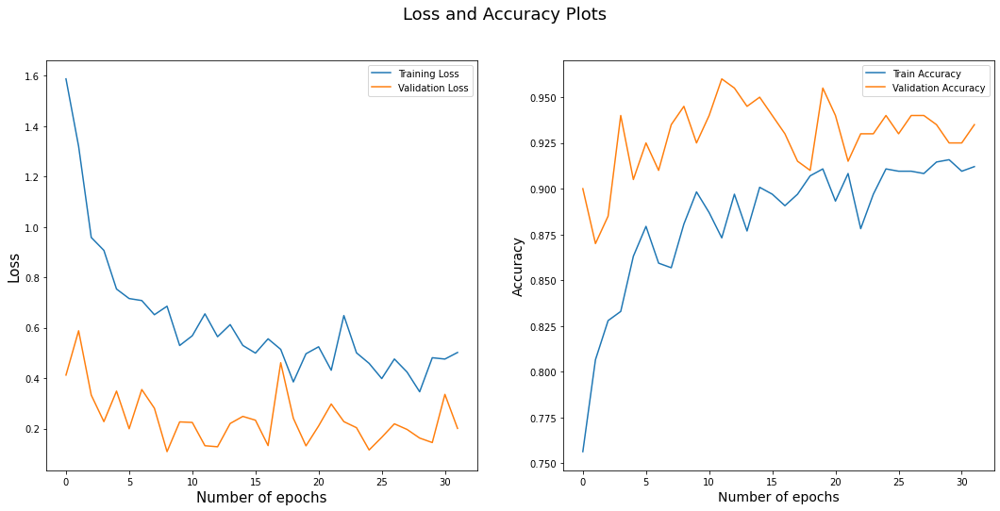

32/32 [==============================] - 1s 35ms/step
Round:  10
Test Accuracy:  0.9
Label Accuracy:  0.849
Number of catagory 1:  491.0
Number of catagory 2:  509.0
Model: "sequential_22"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_22 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epo

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 206ms/step - loss: 1.8529 - acc: 0.7312 - val_loss: 0.4244 - val_acc: 0.8650
Epoch 2/32
25/25 [==============================] - 1s 59ms/step - loss: 1.4263 - acc: 0.8012 - val_loss: 0.3067 - val_acc: 0.9000
Epoch 3/32
25/25 [==============================] - 1s 57ms/step - loss: 1.0185 - acc: 0.8288 - val_loss: 0.4599 - val_acc: 0.8800
Epoch 4/32
25/25 [==============================] - 1s 55ms/step - loss: 0.8872 - acc: 0.8413 - val_loss: 0.5003 - val_acc: 0.8800
Epoch 5/32
25/25 [==============================] - 1s 58ms/step - loss: 0.8730 - acc: 0.8413 - val_loss: 0.1612 - val_acc: 0.9550
Epoch 6/32
25/25 [==============================] - 1s 54ms/step - loss: 0.6989 - acc: 0.8438 - val_loss: 0.2098 - val_acc: 0.9300
Epoch 7/32
25/25 [==============================] - 1s 55ms/step - loss: 0.8107 - acc: 0.8587 - val_loss: 0.1950 - val_acc: 0.9350
Epoch 8/32
25/25 [==============================] - 1s 55ms/step - loss: 0.7318 - acc: 0.8650

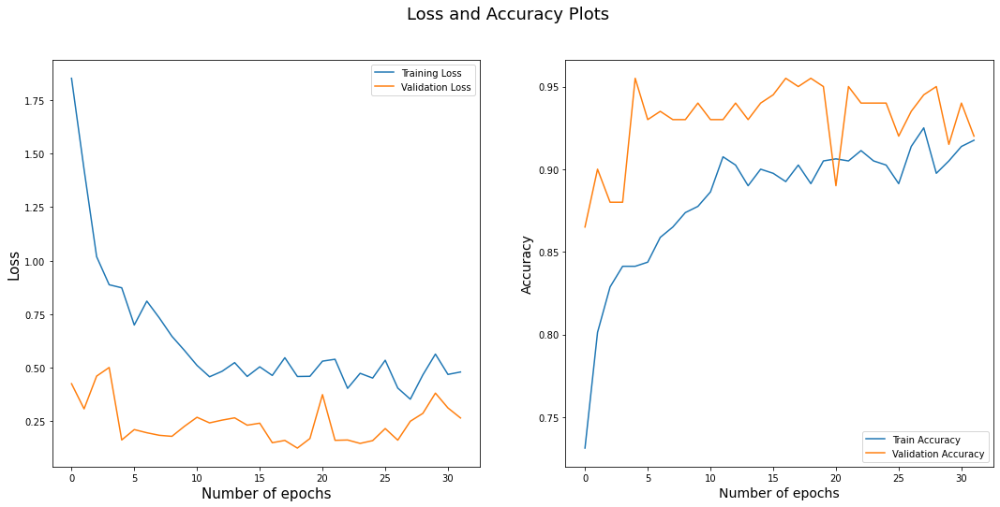

7/7 [==============================] - 2s 37ms/step
0.915


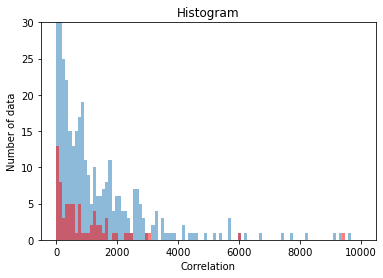

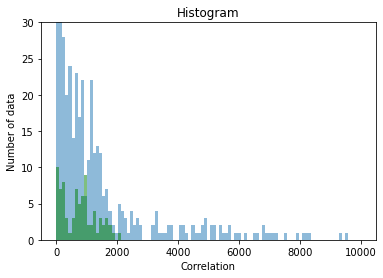

Model: "sequential_23"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_23 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 10s 152ms/step - loss: 1.7998 - acc: 0.7349 - val_loss: 0.4757 - val_acc: 0.8650
Epoch 2/32
25/25 [==============================] - 1s 56ms/step - loss: 1.1325 - acc: 0.8153 - val_loss: 0.2715 - val_acc: 0.9150
Epoch 3/32
25/25 [==============================] - 1s 58ms/step - loss: 0.8196 - acc: 0.8618 - val_loss: 0.2751 - val_acc: 0.9250
Epoch 4/32
25/25 [==============================] - 1s 58ms/step - loss: 0.9219 - acc: 0.8417 - val_loss: 0.2616 - val_acc: 0.9300
Epoch 5/32
25/25 [==============================] - 1s 57ms/step - loss: 0.7994 - acc: 0.8555 - val_loss: 0.2754 - val_acc: 0.9200
Epoch 6/32
25/25 [==============================] - 1s 57ms/step - loss: 0.6041 - acc: 0.8719 - val_loss: 0.2369 - val_acc: 0.9200
Epoch 7/32
25/25 [==============================] - 1s 59ms/step - loss: 0.6344 - acc: 0.8832 - val_loss: 0.1816 - val_acc: 0.9550
Epoch 8/32
25/25 [==============================] - 1s 59ms/step - loss: 0.6503 - acc: 0.876

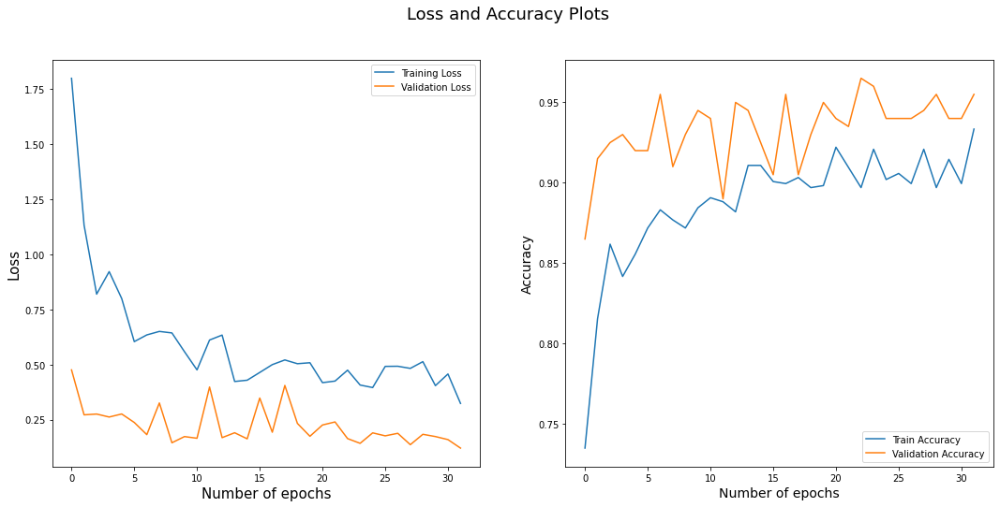

32/32 [==============================] - 1s 37ms/step
Round:  11
Test Accuracy:  0.885
Label Accuracy:  0.851
Number of catagory 1:  493.0
Number of catagory 2:  507.0
Model: "sequential_24"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_24 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
E

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 10s 138ms/step - loss: 2.1624 - acc: 0.7287 - val_loss: 0.3609 - val_acc: 0.9000
Epoch 2/32
25/25 [==============================] - 1s 57ms/step - loss: 1.2067 - acc: 0.8225 - val_loss: 0.2740 - val_acc: 0.9250
Epoch 3/32
25/25 [==============================] - 1s 57ms/step - loss: 0.9441 - acc: 0.8300 - val_loss: 0.2425 - val_acc: 0.9200
Epoch 4/32
25/25 [==============================] - 1s 58ms/step - loss: 1.0164 - acc: 0.8363 - val_loss: 0.2494 - val_acc: 0.9250
Epoch 5/32
25/25 [==============================] - 1s 57ms/step - loss: 0.8419 - acc: 0.8512 - val_loss: 0.2329 - val_acc: 0.9350
Epoch 6/32
25/25 [==============================] - 1s 55ms/step - loss: 0.7999 - acc: 0.8775 - val_loss: 0.2550 - val_acc: 0.9350
Epoch 7/32
25/25 [==============================] - 1s 56ms/step - loss: 0.6595 - acc: 0.8788 - val_loss: 0.1587 - val_acc: 0.9500
Epoch 8/32
25/25 [==============================] - 1s 55ms/step - loss: 0.6923 - acc: 0.866

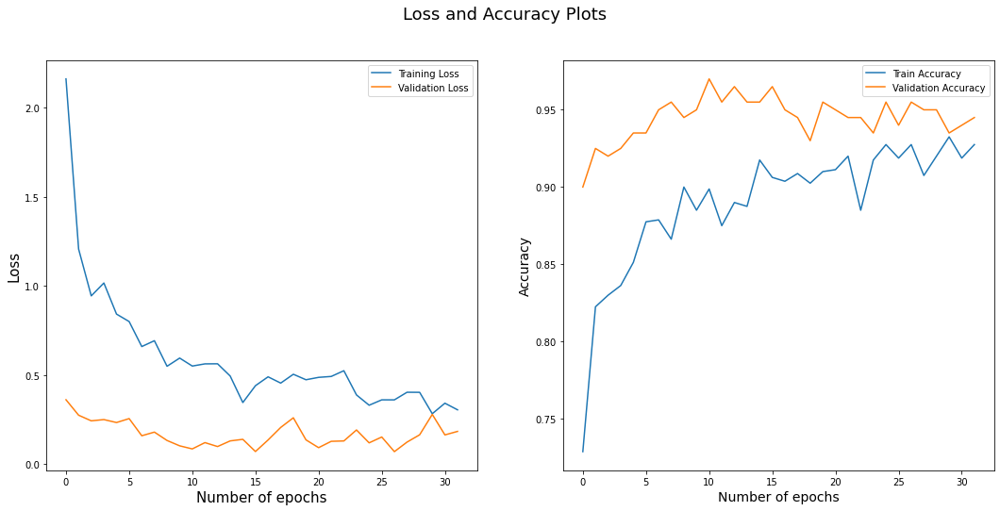

7/7 [==============================] - 2s 40ms/step
0.875


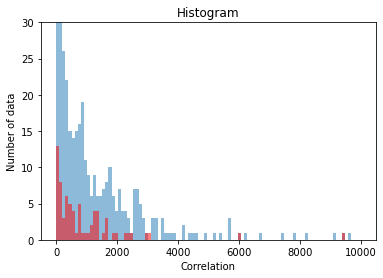

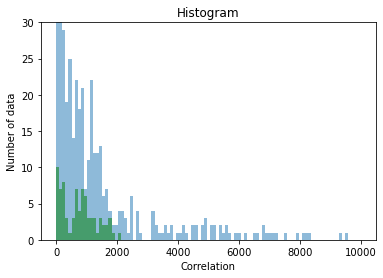

Model: "sequential_25"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_25 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 154ms/step - loss: 1.6637 - acc: 0.7626 - val_loss: 0.3559 - val_acc: 0.8950
Epoch 2/32
25/25 [==============================] - 1s 56ms/step - loss: 1.1413 - acc: 0.8153 - val_loss: 0.5312 - val_acc: 0.8850
Epoch 3/32
25/25 [==============================] - 1s 54ms/step - loss: 0.9401 - acc: 0.8417 - val_loss: 0.1977 - val_acc: 0.9300
Epoch 4/32
25/25 [==============================] - 1s 57ms/step - loss: 0.8353 - acc: 0.8417 - val_loss: 0.2200 - val_acc: 0.9200
Epoch 5/32
25/25 [==============================] - 1s 56ms/step - loss: 0.5584 - acc: 0.8832 - val_loss: 0.1818 - val_acc: 0.9550
Epoch 6/32
25/25 [==============================] - 1s 58ms/step - loss: 0.7910 - acc: 0.8543 - val_loss: 0.2082 - val_acc: 0.9250
Epoch 7/32
25/25 [==============================] - 1s 54ms/step - loss: 0.7667 - acc: 0.8580 - val_loss: 0.2495 - val_acc: 0.9400
Epoch 8/32
25/25 [==============================] - 1s 52ms/step - loss: 0.5897 - acc: 0.8794

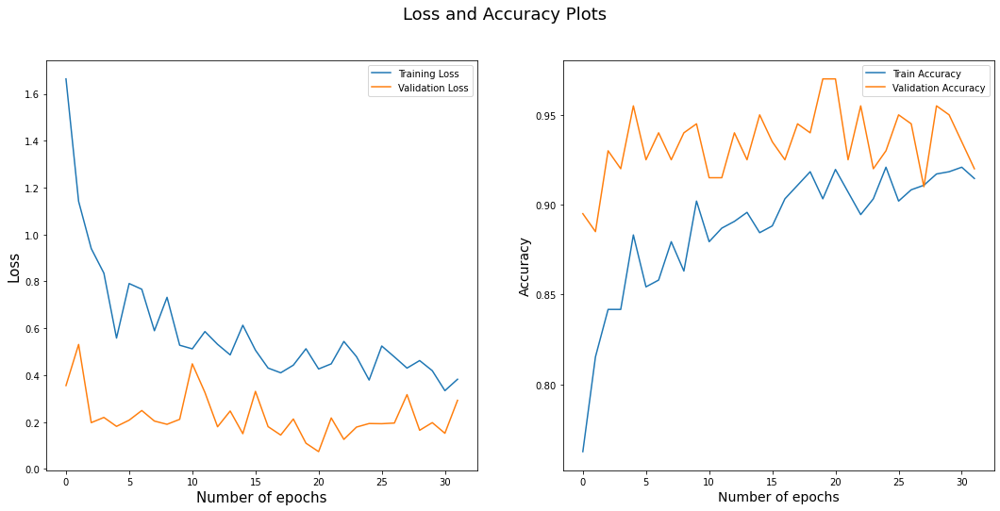

32/32 [==============================] - 1s 41ms/step
Round:  12
Test Accuracy:  0.855
Label Accuracy:  0.849
Number of catagory 1:  489.0
Number of catagory 2:  511.0
Model: "sequential_26"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_26 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
E

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 7s 125ms/step - loss: 1.5557 - acc: 0.7588 - val_loss: 1.1876 - val_acc: 0.7500
Epoch 2/32
25/25 [==============================] - 1s 55ms/step - loss: 1.1950 - acc: 0.8225 - val_loss: 0.2941 - val_acc: 0.9150
Epoch 3/32
25/25 [==============================] - 1s 52ms/step - loss: 1.1002 - acc: 0.8238 - val_loss: 0.3752 - val_acc: 0.8950
Epoch 4/32
25/25 [==============================] - 1s 54ms/step - loss: 0.7882 - acc: 0.8662 - val_loss: 0.3368 - val_acc: 0.9000
Epoch 5/32
25/25 [==============================] - 1s 52ms/step - loss: 0.9386 - acc: 0.8475 - val_loss: 0.1904 - val_acc: 0.9400
Epoch 6/32
25/25 [==============================] - 1s 56ms/step - loss: 0.6312 - acc: 0.8650 - val_loss: 0.2080 - val_acc: 0.9250
Epoch 7/32
25/25 [==============================] - 1s 54ms/step - loss: 0.6188 - acc: 0.8788 - val_loss: 0.3528 - val_acc: 0.9300
Epoch 8/32
25/25 [==============================] - 1s 52ms/step - loss: 0.6962 - acc: 0.8800

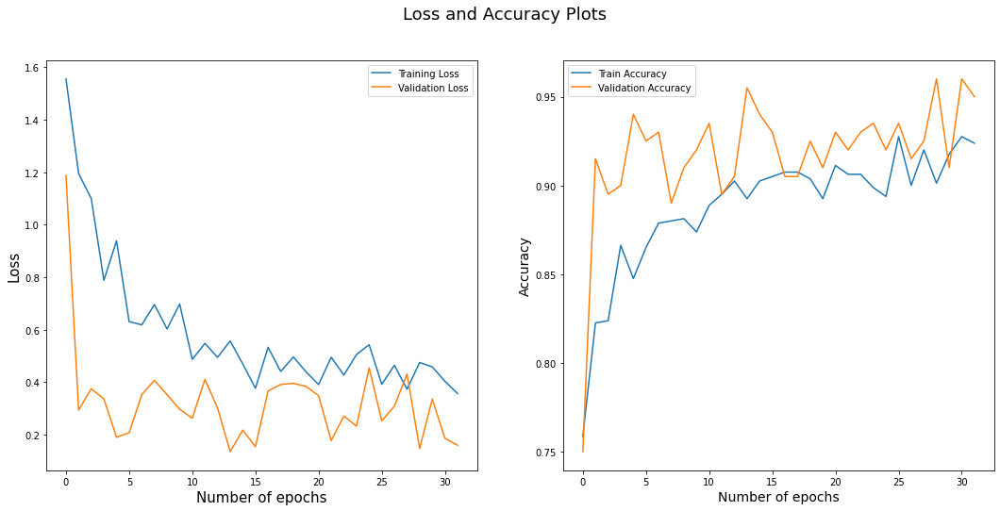

7/7 [==============================] - 4s 42ms/step
0.83


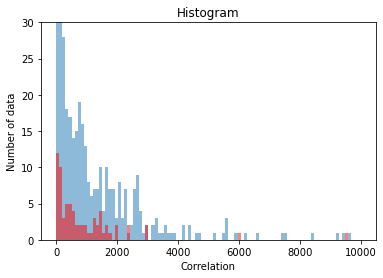

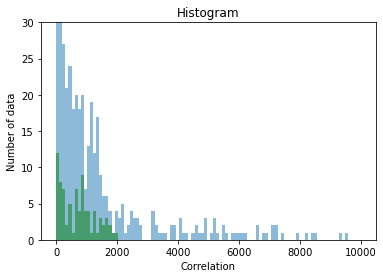

Model: "sequential_27"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_27 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


Epoch 1/32
25/25 [==============================] - 9s 135ms/step - loss: 1.8281 - acc: 0.7362 - val_loss: 0.5609 - val_acc: 0.8900
Epoch 2/32
25/25 [==============================] - 1s 56ms/step - loss: 1.3413 - acc: 0.8090 - val_loss: 0.4060 - val_acc: 0.8800
Epoch 3/32
25/25 [==============================] - 1s 57ms/step - loss: 0.9009 - acc: 0.8379 - val_loss: 0.4099 - val_acc: 0.9100
Epoch 4/32
25/25 [==============================] - 1s 56ms/step - loss: 0.7837 - acc: 0.8492 - val_loss: 0.3403 - val_acc: 0.9000
Epoch 5/32
25/25 [==============================] - 1s 55ms/step - loss: 0.7410 - acc: 0.8555 - val_loss: 0.2584 - val_acc: 0.9400
Epoch 6/32
25/25 [==============================] - 1s 55ms/step - loss: 0.7673 - acc: 0.8631 - val_loss: 0.2985 - val_acc: 0.9100
Epoch 7/32
25/25 [==============================] - 1s 57ms/step - loss: 0.6759 - acc: 0.8794 - val_loss: 0.3204 - val_acc: 0.9150
Epoch 8/32
25/25 [==============================] - 1s 54ms/step - loss: 0.5959 - 

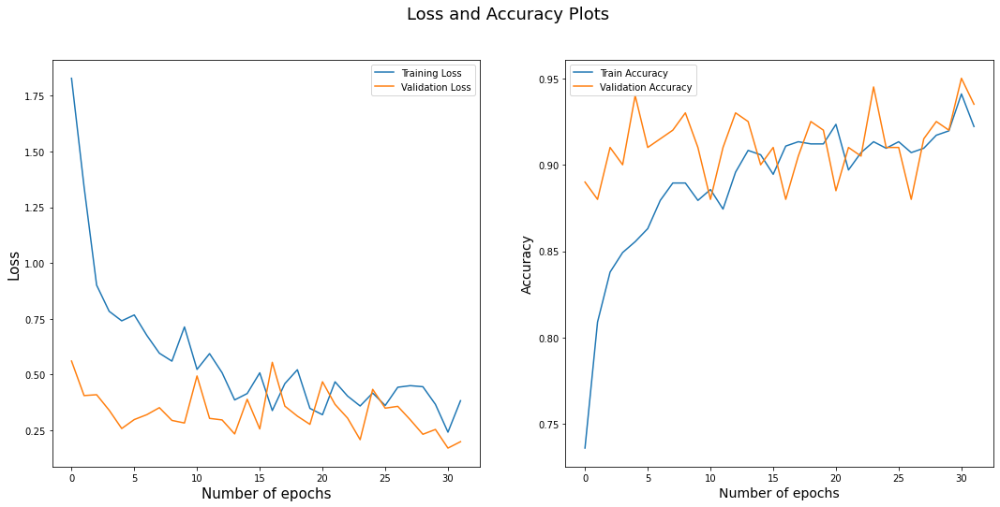

32/32 [==============================] - 1s 36ms/step
Round:  13
Test Accuracy:  0.86
Label Accuracy:  0.853
Number of catagory 1:  491.0
Number of catagory 2:  509.0
Model: "sequential_28"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_28 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Ep

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 123ms/step - loss: 1.8845 - acc: 0.7487 - val_loss: 0.4376 - val_acc: 0.9250
Epoch 2/32
25/25 [==============================] - 1s 49ms/step - loss: 1.3078 - acc: 0.8075 - val_loss: 0.3545 - val_acc: 0.9100
Epoch 3/32
25/25 [==============================] - 1s 52ms/step - loss: 1.0531 - acc: 0.8388 - val_loss: 0.2387 - val_acc: 0.9400
Epoch 4/32
25/25 [==============================] - 1s 55ms/step - loss: 0.9751 - acc: 0.8487 - val_loss: 0.2272 - val_acc: 0.9300
Epoch 5/32
25/25 [==============================] - 1s 52ms/step - loss: 0.6540 - acc: 0.8625 - val_loss: 0.2245 - val_acc: 0.9400
Epoch 6/32
25/25 [==============================] - 1s 55ms/step - loss: 0.7455 - acc: 0.8587 - val_loss: 0.1910 - val_acc: 0.9300
Epoch 7/32
25/25 [==============================] - 1s 48ms/step - loss: 0.6546 - acc: 0.8700 - val_loss: 0.2192 - val_acc: 0.9300
Epoch 8/32
25/25 [==============================] - 1s 52ms/step - loss: 0.6990 - acc: 0.8825

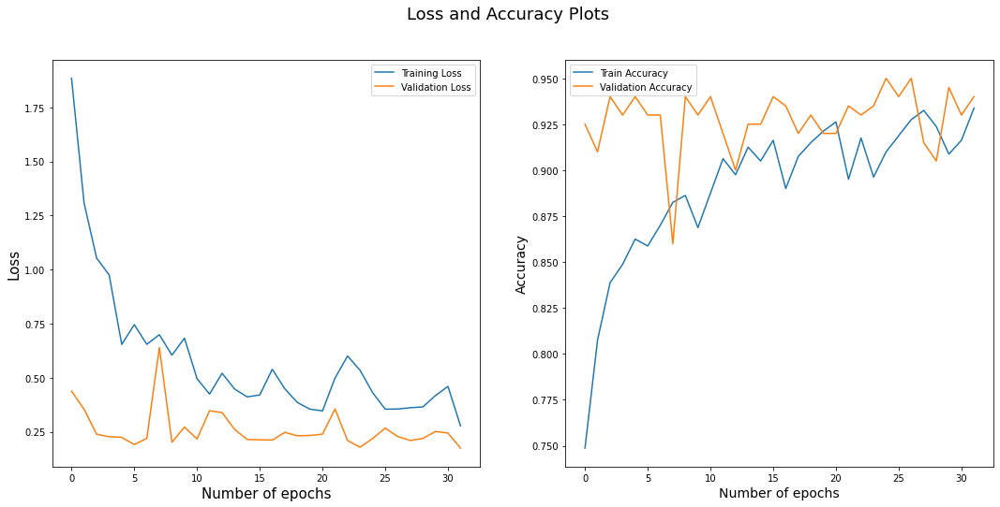

7/7 [==============================] - 2s 36ms/step
0.87


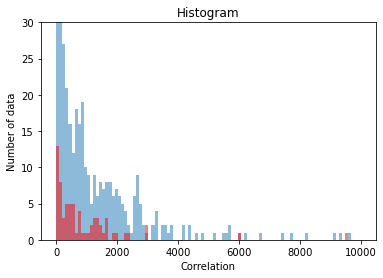

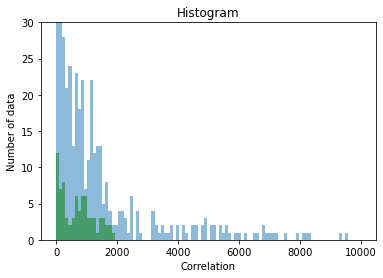

Model: "sequential_29"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_29 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 7s 125ms/step - loss: 1.7743 - acc: 0.7286 - val_loss: 0.4824 - val_acc: 0.8850
Epoch 2/32
25/25 [==============================] - 1s 55ms/step - loss: 1.2606 - acc: 0.8166 - val_loss: 0.3450 - val_acc: 0.9000
Epoch 3/32
25/25 [==============================] - 1s 55ms/step - loss: 0.8239 - acc: 0.8492 - val_loss: 0.2261 - val_acc: 0.9350
Epoch 4/32
25/25 [==============================] - 1s 55ms/step - loss: 0.8494 - acc: 0.8681 - val_loss: 0.3196 - val_acc: 0.9050
Epoch 5/32
25/25 [==============================] - 1s 55ms/step - loss: 0.7406 - acc: 0.8505 - val_loss: 0.2651 - val_acc: 0.9350
Epoch 6/32
25/25 [==============================] - 1s 56ms/step - loss: 0.7424 - acc: 0.8631 - val_loss: 0.2370 - val_acc: 0.9100
Epoch 7/32
25/25 [==============================] - 1s 53ms/step - loss: 0.5566 - acc: 0.8807 - val_loss: 0.4229 - val_acc: 0.8950
Epoch 8/32
25/25 [==============================] - 1s 54ms/step - loss: 0.5221 - acc: 0.8907

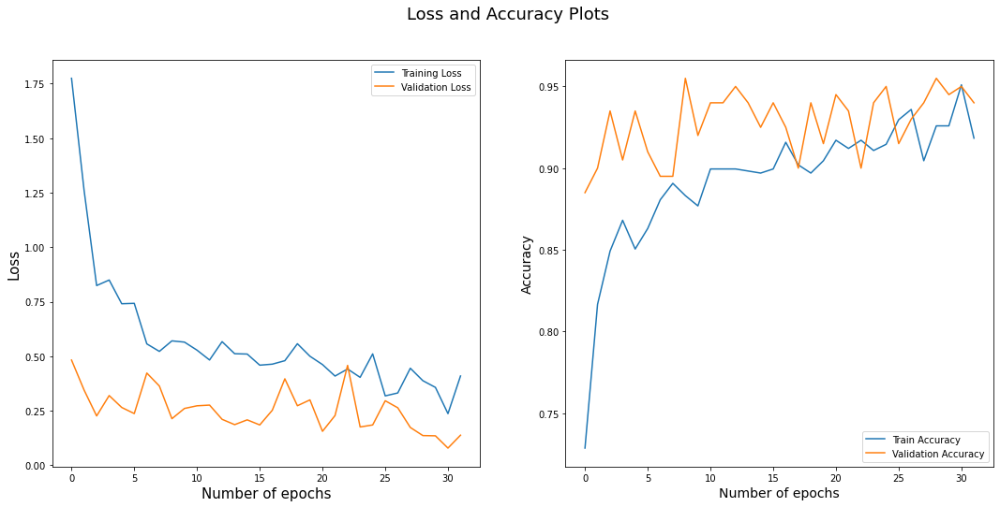

32/32 [==============================] - 1s 37ms/step
Round:  14
Test Accuracy:  0.88
Label Accuracy:  0.853
Number of catagory 1:  491.0
Number of catagory 2:  509.0
Model: "sequential_30"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_30 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Ep

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 7s 121ms/step - loss: 1.5650 - acc: 0.7487 - val_loss: 0.6296 - val_acc: 0.8700
Epoch 2/32
25/25 [==============================] - 1s 51ms/step - loss: 1.2431 - acc: 0.8163 - val_loss: 0.5989 - val_acc: 0.8800
Epoch 3/32
25/25 [==============================] - 1s 52ms/step - loss: 0.7924 - acc: 0.8438 - val_loss: 0.3512 - val_acc: 0.8950
Epoch 4/32
25/25 [==============================] - 1s 57ms/step - loss: 0.8301 - acc: 0.8375 - val_loss: 0.6728 - val_acc: 0.8650
Epoch 5/32
25/25 [==============================] - 1s 53ms/step - loss: 0.8206 - acc: 0.8700 - val_loss: 0.3747 - val_acc: 0.8950
Epoch 6/32
25/25 [==============================] - 1s 52ms/step - loss: 0.7230 - acc: 0.8650 - val_loss: 0.2567 - val_acc: 0.9200
Epoch 7/32
25/25 [==============================] - 1s 59ms/step - loss: 0.6234 - acc: 0.8763 - val_loss: 0.2551 - val_acc: 0.9400
Epoch 8/32
25/25 [==============================] - 1s 52ms/step - loss: 0.5594 - acc: 0.8888

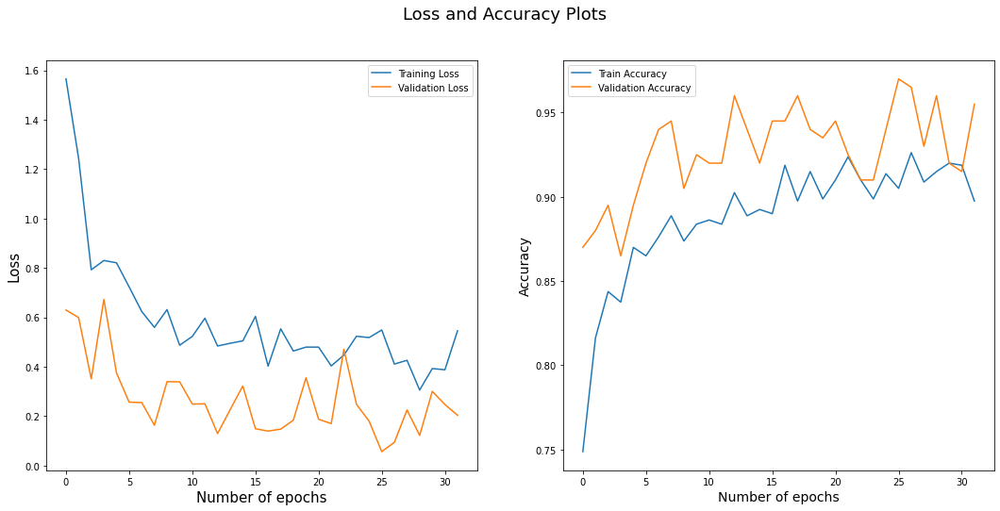

7/7 [==============================] - 2s 38ms/step
0.86


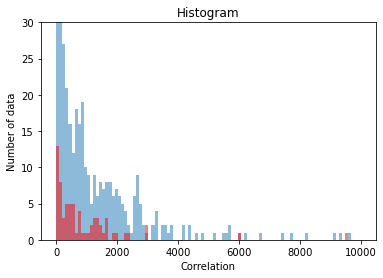

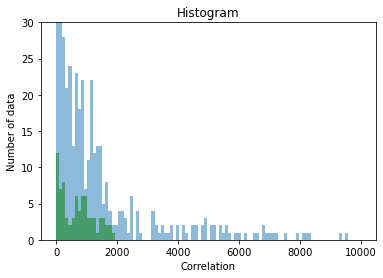

Model: "sequential_31"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_31 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 124ms/step - loss: 1.5103 - acc: 0.7575 - val_loss: 0.4535 - val_acc: 0.9000
Epoch 2/32
25/25 [==============================] - 1s 54ms/step - loss: 1.2228 - acc: 0.8103 - val_loss: 0.3450 - val_acc: 0.8800
Epoch 3/32
25/25 [==============================] - 1s 55ms/step - loss: 1.0114 - acc: 0.8266 - val_loss: 0.4171 - val_acc: 0.9050
Epoch 4/32
25/25 [==============================] - 1s 55ms/step - loss: 0.7783 - acc: 0.8580 - val_loss: 0.3653 - val_acc: 0.9100
Epoch 5/32
25/25 [==============================] - 1s 57ms/step - loss: 0.6544 - acc: 0.8668 - val_loss: 0.2095 - val_acc: 0.9350
Epoch 6/32
25/25 [==============================] - 1s 54ms/step - loss: 0.7279 - acc: 0.8681 - val_loss: 0.2789 - val_acc: 0.9200
Epoch 7/32
25/25 [==============================] - 1s 56ms/step - loss: 0.5817 - acc: 0.8894 - val_loss: 0.2415 - val_acc: 0.9300
Epoch 8/32
25/25 [==============================] - 1s 53ms/step - loss: 0.4498 - acc: 0.8995

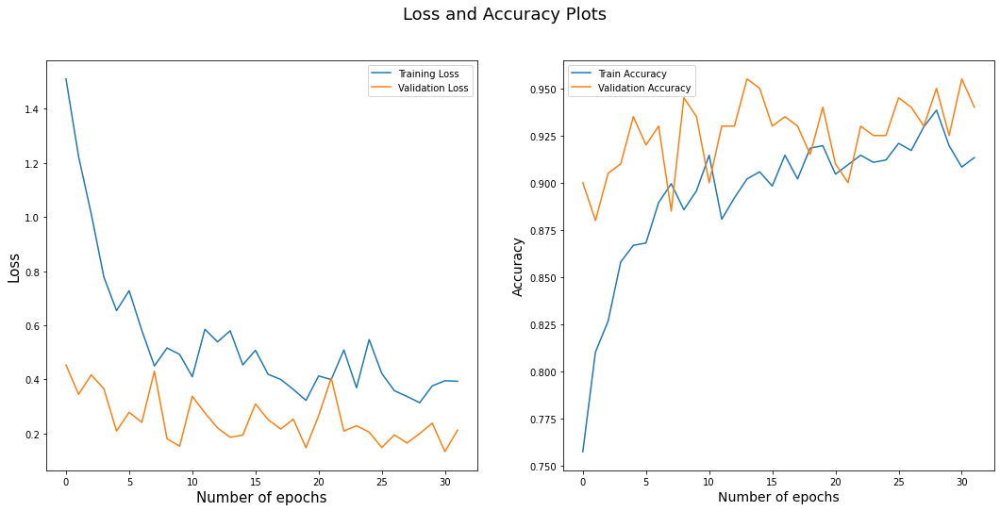

32/32 [==============================] - 1s 37ms/step
Round:  15
Test Accuracy:  0.875
Label Accuracy:  0.855
Number of catagory 1:  493.0
Number of catagory 2:  507.0
Model: "sequential_32"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_32 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
E

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 130ms/step - loss: 1.6005 - acc: 0.7650 - val_loss: 0.3682 - val_acc: 0.9200
Epoch 2/32
25/25 [==============================] - 1s 53ms/step - loss: 0.9699 - acc: 0.8250 - val_loss: 0.4985 - val_acc: 0.8650
Epoch 3/32
25/25 [==============================] - 1s 54ms/step - loss: 1.0148 - acc: 0.8275 - val_loss: 0.3876 - val_acc: 0.9000
Epoch 4/32
25/25 [==============================] - 1s 58ms/step - loss: 0.8351 - acc: 0.8512 - val_loss: 0.4678 - val_acc: 0.8850
Epoch 5/32
25/25 [==============================] - 1s 55ms/step - loss: 0.7904 - acc: 0.8637 - val_loss: 0.7307 - val_acc: 0.8400
Epoch 6/32
25/25 [==============================] - 1s 54ms/step - loss: 0.8095 - acc: 0.8537 - val_loss: 0.1885 - val_acc: 0.9250
Epoch 7/32
25/25 [==============================] - 1s 54ms/step - loss: 0.7875 - acc: 0.8662 - val_loss: 0.3072 - val_acc: 0.9150
Epoch 8/32
25/25 [==============================] - 1s 54ms/step - loss: 0.5415 - acc: 0.8888

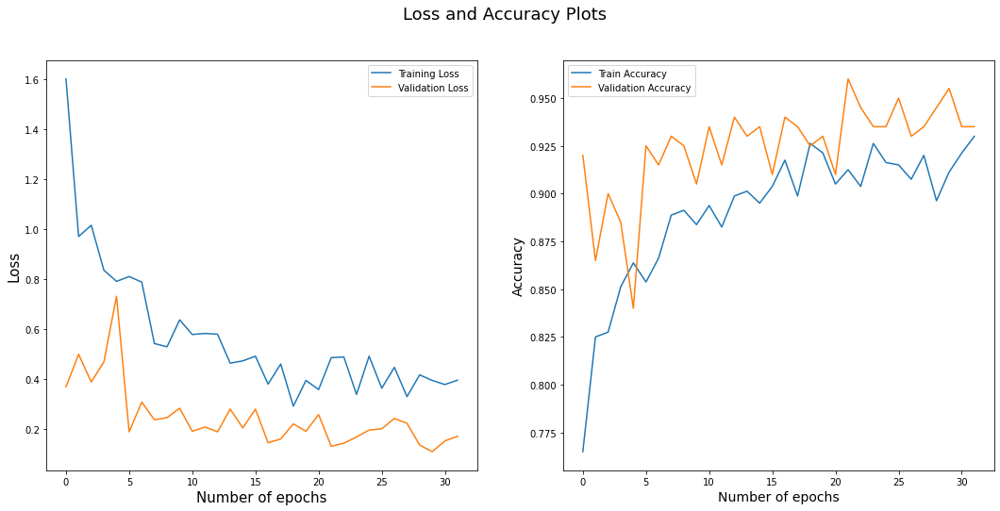

7/7 [==============================] - 2s 39ms/step
0.875


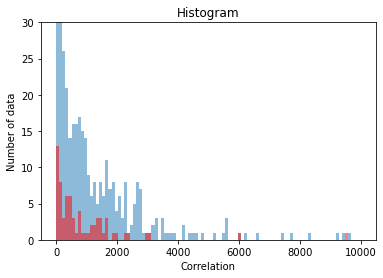

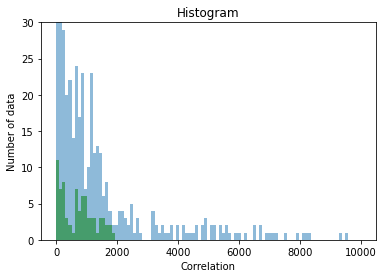

Model: "sequential_33"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_33 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 147ms/step - loss: 1.6113 - acc: 0.7613 - val_loss: 0.7459 - val_acc: 0.8300
Epoch 2/32
25/25 [==============================] - 1s 55ms/step - loss: 1.2421 - acc: 0.8078 - val_loss: 0.6042 - val_acc: 0.8650
Epoch 3/32
25/25 [==============================] - 1s 54ms/step - loss: 1.0795 - acc: 0.8166 - val_loss: 0.3411 - val_acc: 0.8950
Epoch 4/32
25/25 [==============================] - 1s 54ms/step - loss: 0.8411 - acc: 0.8505 - val_loss: 0.3421 - val_acc: 0.9000
Epoch 5/32
25/25 [==============================] - 1s 54ms/step - loss: 0.7256 - acc: 0.8643 - val_loss: 0.2555 - val_acc: 0.9200
Epoch 6/32
25/25 [==============================] - 1s 51ms/step - loss: 0.5719 - acc: 0.8882 - val_loss: 0.3095 - val_acc: 0.9200
Epoch 7/32
25/25 [==============================] - 1s 53ms/step - loss: 0.5346 - acc: 0.9020 - val_loss: 0.2121 - val_acc: 0.9400
Epoch 8/32
25/25 [==============================] - 1s 53ms/step - loss: 0.5318 - acc: 0.8832

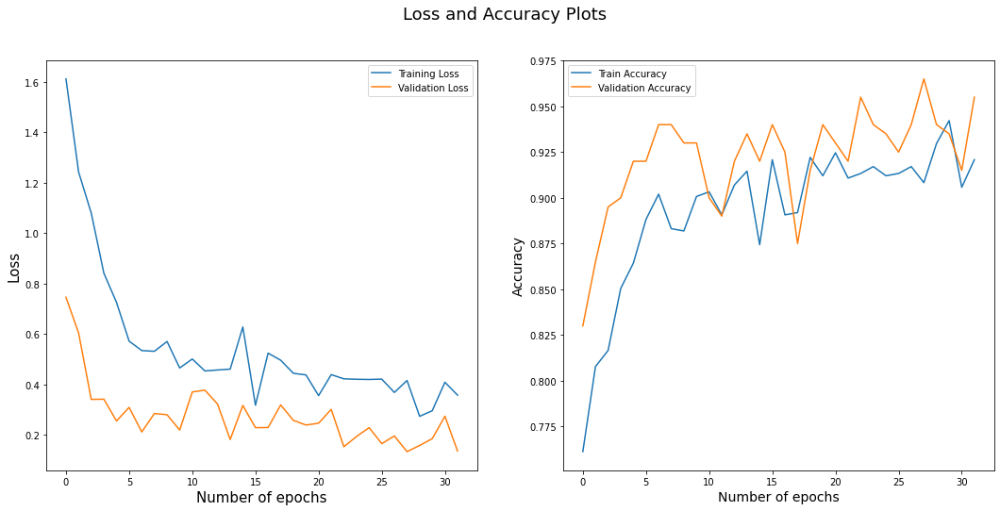

32/32 [==============================] - 1s 37ms/step
Round:  16
Test Accuracy:  0.895
Label Accuracy:  0.855
Number of catagory 1:  495.0
Number of catagory 2:  505.0
Model: "sequential_34"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_34 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
E

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 7s 126ms/step - loss: 1.6104 - acc: 0.7437 - val_loss: 0.2817 - val_acc: 0.9100
Epoch 2/32
25/25 [==============================] - 1s 52ms/step - loss: 0.9966 - acc: 0.8250 - val_loss: 0.1994 - val_acc: 0.9250
Epoch 3/32
25/25 [==============================] - 1s 53ms/step - loss: 0.9312 - acc: 0.8425 - val_loss: 0.3847 - val_acc: 0.9050
Epoch 4/32
25/25 [==============================] - 1s 54ms/step - loss: 0.7659 - acc: 0.8475 - val_loss: 0.2634 - val_acc: 0.9050
Epoch 5/32
25/25 [==============================] - 1s 57ms/step - loss: 0.6954 - acc: 0.8763 - val_loss: 0.2947 - val_acc: 0.9350
Epoch 6/32
25/25 [==============================] - 1s 56ms/step - loss: 0.6496 - acc: 0.8637 - val_loss: 0.2486 - val_acc: 0.9200
Epoch 7/32
25/25 [==============================] - 1s 57ms/step - loss: 0.6464 - acc: 0.8775 - val_loss: 0.2412 - val_acc: 0.9400
Epoch 8/32
25/25 [==============================] - 1s 51ms/step - loss: 0.5330 - acc: 0.8775

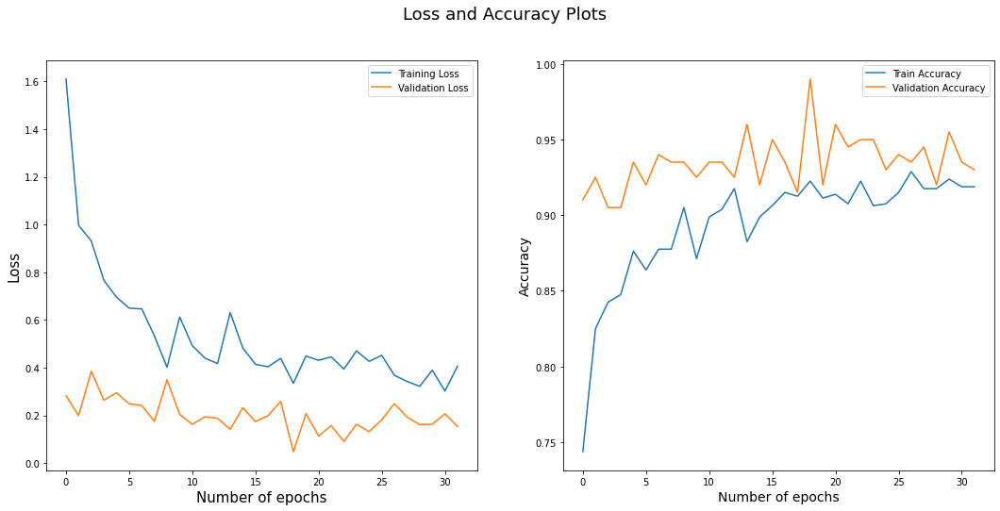

7/7 [==============================] - 2s 37ms/step
0.9


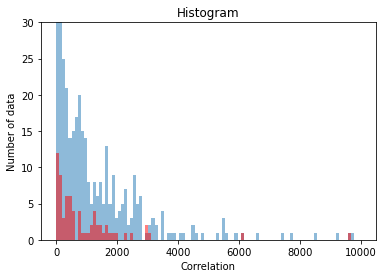

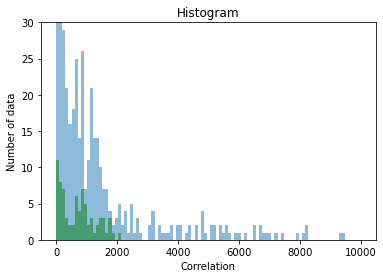

Model: "sequential_35"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_35 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 126ms/step - loss: 1.8301 - acc: 0.7462 - val_loss: 0.6520 - val_acc: 0.8500
Epoch 2/32
25/25 [==============================] - 1s 54ms/step - loss: 1.2075 - acc: 0.8354 - val_loss: 0.2688 - val_acc: 0.9100
Epoch 3/32
25/25 [==============================] - 1s 56ms/step - loss: 0.8694 - acc: 0.8543 - val_loss: 0.3646 - val_acc: 0.9050
Epoch 4/32
25/25 [==============================] - 1s 52ms/step - loss: 0.7584 - acc: 0.8467 - val_loss: 0.2727 - val_acc: 0.9300
Epoch 5/32
25/25 [==============================] - 1s 50ms/step - loss: 0.7710 - acc: 0.8719 - val_loss: 0.3913 - val_acc: 0.8950
Epoch 6/32
25/25 [==============================] - 1s 54ms/step - loss: 0.7740 - acc: 0.8643 - val_loss: 0.2110 - val_acc: 0.9350
Epoch 7/32
25/25 [==============================] - 1s 53ms/step - loss: 0.5747 - acc: 0.8857 - val_loss: 0.2178 - val_acc: 0.9300
Epoch 8/32
25/25 [==============================] - 1s 53ms/step - loss: 0.4998 - acc: 0.9020

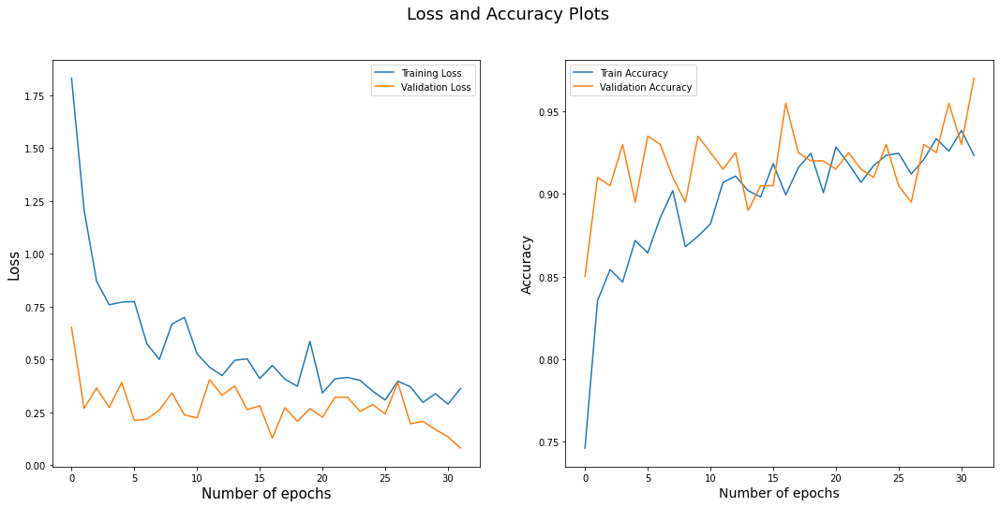

32/32 [==============================] - 1s 32ms/step
Round:  17
Test Accuracy:  0.865
Label Accuracy:  0.856
Number of catagory 1:  494.0
Number of catagory 2:  506.0
Model: "sequential_36"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_36 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
E

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 116ms/step - loss: 1.5082 - acc: 0.7700 - val_loss: 0.4549 - val_acc: 0.8950
Epoch 2/32
25/25 [==============================] - 1s 53ms/step - loss: 1.0498 - acc: 0.8263 - val_loss: 0.4420 - val_acc: 0.8750
Epoch 3/32
25/25 [==============================] - 1s 51ms/step - loss: 0.8696 - acc: 0.8438 - val_loss: 0.3532 - val_acc: 0.9200
Epoch 4/32
25/25 [==============================] - 1s 51ms/step - loss: 0.8458 - acc: 0.8525 - val_loss: 0.2963 - val_acc: 0.9100
Epoch 5/32
25/25 [==============================] - 1s 49ms/step - loss: 0.7351 - acc: 0.8650 - val_loss: 0.4067 - val_acc: 0.8950
Epoch 6/32
25/25 [==============================] - 1s 56ms/step - loss: 0.6037 - acc: 0.8875 - val_loss: 0.2702 - val_acc: 0.9250
Epoch 7/32
25/25 [==============================] - 1s 51ms/step - loss: 0.5744 - acc: 0.8988 - val_loss: 0.1965 - val_acc: 0.9300
Epoch 8/32
25/25 [==============================] - 1s 51ms/step - loss: 0.5976 - acc: 0.8850

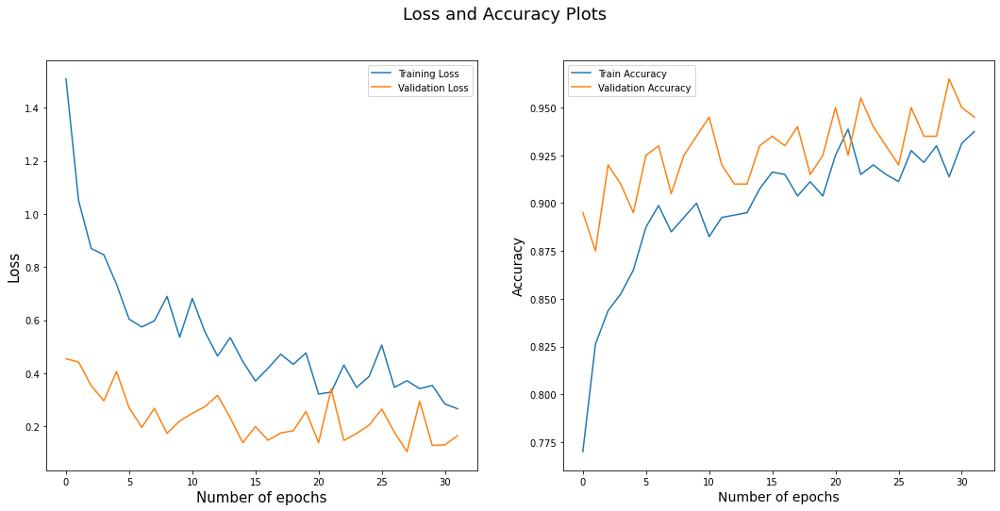

7/7 [==============================] - 2s 36ms/step
0.905


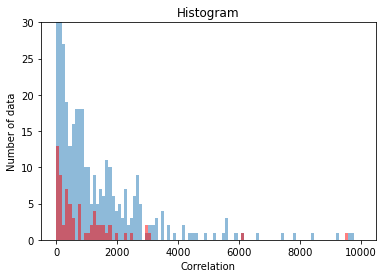

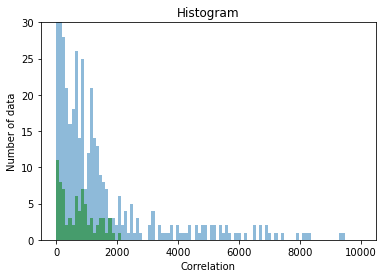

Model: "sequential_37"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_37 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 138ms/step - loss: 1.4902 - acc: 0.7575 - val_loss: 0.3059 - val_acc: 0.9050
Epoch 2/32
25/25 [==============================] - 1s 52ms/step - loss: 0.8900 - acc: 0.8405 - val_loss: 0.6010 - val_acc: 0.8450
Epoch 3/32
25/25 [==============================] - 1s 57ms/step - loss: 0.7112 - acc: 0.8555 - val_loss: 0.2629 - val_acc: 0.9200
Epoch 4/32
25/25 [==============================] - 1s 56ms/step - loss: 0.7623 - acc: 0.8756 - val_loss: 0.2911 - val_acc: 0.9200
Epoch 5/32
25/25 [==============================] - 1s 57ms/step - loss: 0.7615 - acc: 0.8543 - val_loss: 0.2154 - val_acc: 0.9400
Epoch 6/32
25/25 [==============================] - 1s 51ms/step - loss: 0.7193 - acc: 0.8631 - val_loss: 0.2723 - val_acc: 0.9250
Epoch 7/32
25/25 [==============================] - 1s 50ms/step - loss: 0.7040 - acc: 0.8719 - val_loss: 0.2381 - val_acc: 0.9150
Epoch 8/32
25/25 [==============================] - 1s 50ms/step - loss: 0.6716 - acc: 0.8693

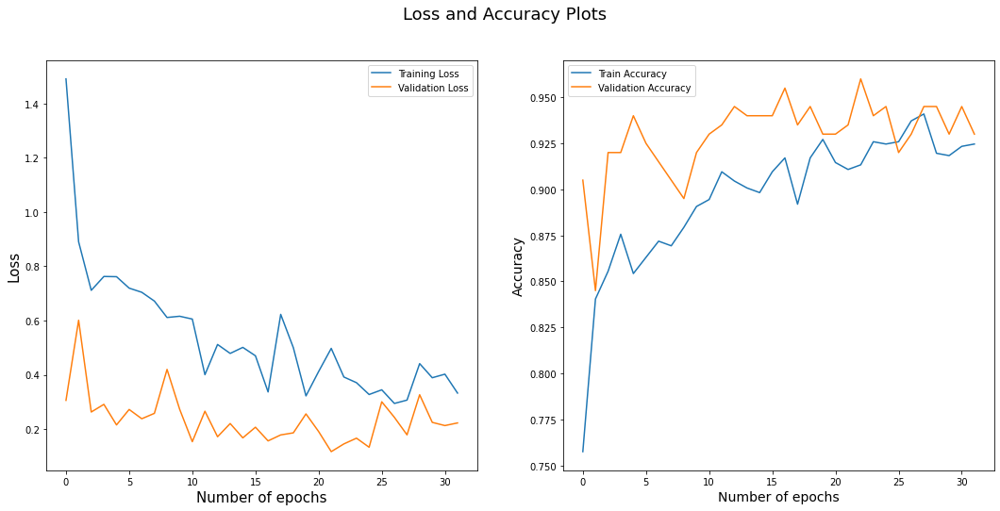

32/32 [==============================] - 1s 37ms/step
Round:  18
Test Accuracy:  0.86
Label Accuracy:  0.854
Number of catagory 1:  492.0
Number of catagory 2:  508.0
Model: "sequential_38"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_38 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Ep

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 7s 123ms/step - loss: 1.6911 - acc: 0.7462 - val_loss: 0.5286 - val_acc: 0.8900
Epoch 2/32
25/25 [==============================] - 1s 51ms/step - loss: 1.1683 - acc: 0.8200 - val_loss: 0.4519 - val_acc: 0.8900
Epoch 3/32
25/25 [==============================] - 1s 52ms/step - loss: 1.0392 - acc: 0.8462 - val_loss: 0.3383 - val_acc: 0.9100
Epoch 4/32
25/25 [==============================] - 1s 48ms/step - loss: 0.9888 - acc: 0.8363 - val_loss: 0.3661 - val_acc: 0.9050
Epoch 5/32
25/25 [==============================] - 1s 49ms/step - loss: 0.7464 - acc: 0.8725 - val_loss: 0.3208 - val_acc: 0.8900
Epoch 6/32
25/25 [==============================] - 1s 53ms/step - loss: 0.6082 - acc: 0.8750 - val_loss: 0.2360 - val_acc: 0.9500
Epoch 7/32
25/25 [==============================] - 1s 54ms/step - loss: 0.7548 - acc: 0.8687 - val_loss: 0.2724 - val_acc: 0.9200
Epoch 8/32
25/25 [==============================] - 1s 52ms/step - loss: 0.7955 - acc: 0.8650

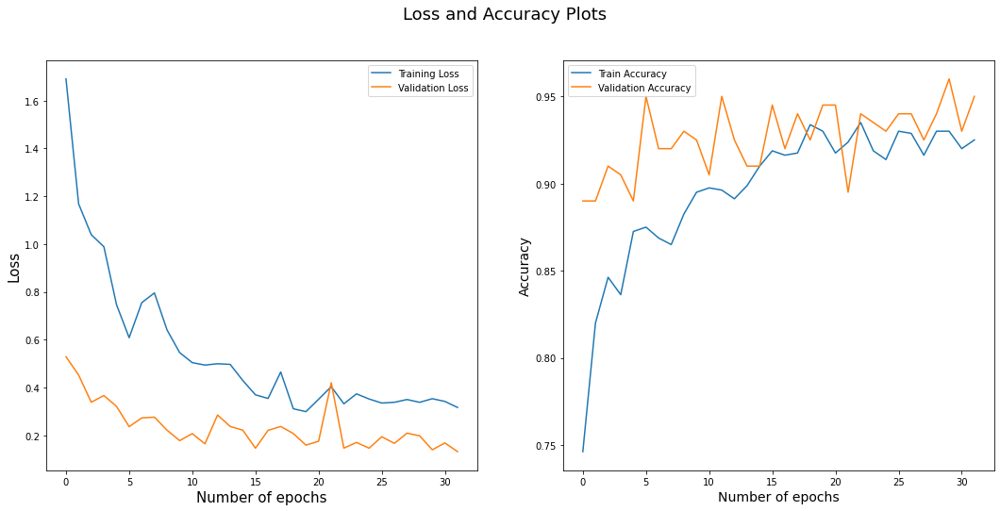

7/7 [==============================] - 2s 37ms/step
0.895


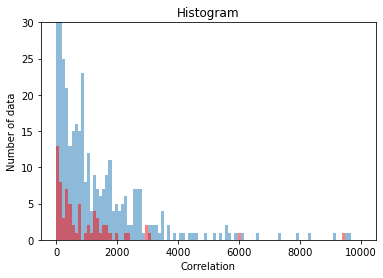

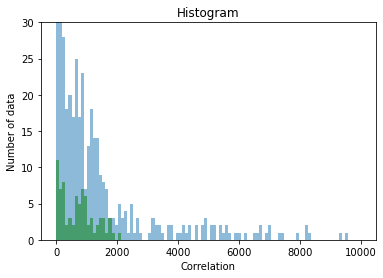

Model: "sequential_39"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_39 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 134ms/step - loss: 1.9557 - acc: 0.7513 - val_loss: 0.5574 - val_acc: 0.8750
Epoch 2/32
25/25 [==============================] - 1s 56ms/step - loss: 1.1440 - acc: 0.8166 - val_loss: 0.3505 - val_acc: 0.8950
Epoch 3/32
25/25 [==============================] - 1s 55ms/step - loss: 1.0386 - acc: 0.8405 - val_loss: 0.2496 - val_acc: 0.9150
Epoch 4/32
25/25 [==============================] - 1s 55ms/step - loss: 0.6875 - acc: 0.8606 - val_loss: 0.1811 - val_acc: 0.9400
Epoch 5/32
25/25 [==============================] - 1s 55ms/step - loss: 0.5249 - acc: 0.8781 - val_loss: 0.3967 - val_acc: 0.8950
Epoch 6/32
25/25 [==============================] - 1s 55ms/step - loss: 0.7653 - acc: 0.8744 - val_loss: 0.2668 - val_acc: 0.9250
Epoch 7/32
25/25 [==============================] - 1s 55ms/step - loss: 0.5119 - acc: 0.9045 - val_loss: 0.2438 - val_acc: 0.9300
Epoch 8/32
25/25 [==============================] - 1s 55ms/step - loss: 0.5013 - acc: 0.8869

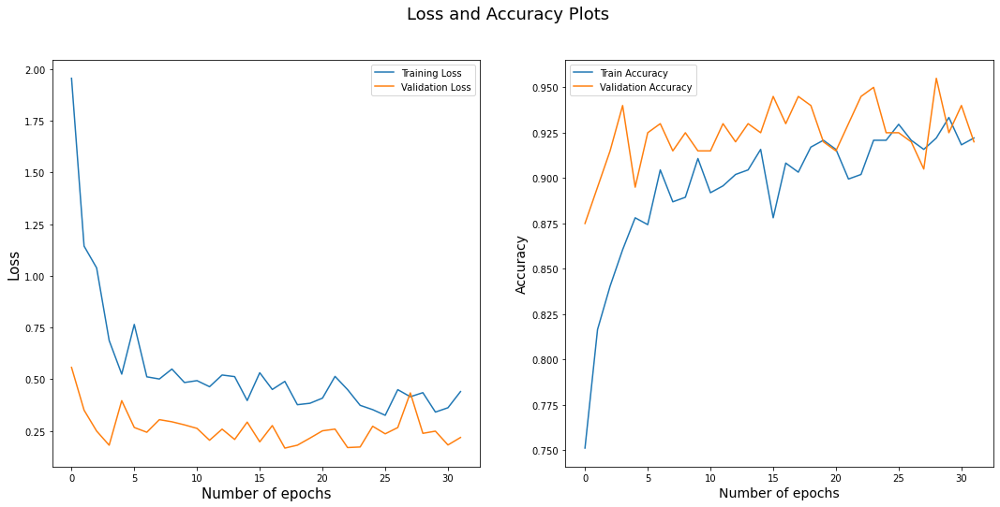

32/32 [==============================] - 1s 40ms/step
Round:  19
Test Accuracy:  0.86
Label Accuracy:  0.854
Number of catagory 1:  490.0
Number of catagory 2:  510.0
Model: "sequential_40"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_40 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Ep

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 123ms/step - loss: 1.6019 - acc: 0.7638 - val_loss: 0.6194 - val_acc: 0.8500
Epoch 2/32
25/25 [==============================] - 1s 52ms/step - loss: 1.1587 - acc: 0.8225 - val_loss: 0.2789 - val_acc: 0.9100
Epoch 3/32
25/25 [==============================] - 1s 56ms/step - loss: 0.9194 - acc: 0.8375 - val_loss: 0.2190 - val_acc: 0.9000
Epoch 4/32
25/25 [==============================] - 1s 55ms/step - loss: 0.6799 - acc: 0.8725 - val_loss: 0.4633 - val_acc: 0.8900
Epoch 5/32
25/25 [==============================] - 1s 54ms/step - loss: 0.6582 - acc: 0.8700 - val_loss: 0.2466 - val_acc: 0.9250
Epoch 6/32
25/25 [==============================] - 1s 56ms/step - loss: 0.6556 - acc: 0.8550 - val_loss: 0.2072 - val_acc: 0.9100
Epoch 7/32
25/25 [==============================] - 1s 55ms/step - loss: 0.4833 - acc: 0.8938 - val_loss: 0.3395 - val_acc: 0.9300
Epoch 8/32
25/25 [==============================] - 1s 53ms/step - loss: 0.5674 - acc: 0.8737

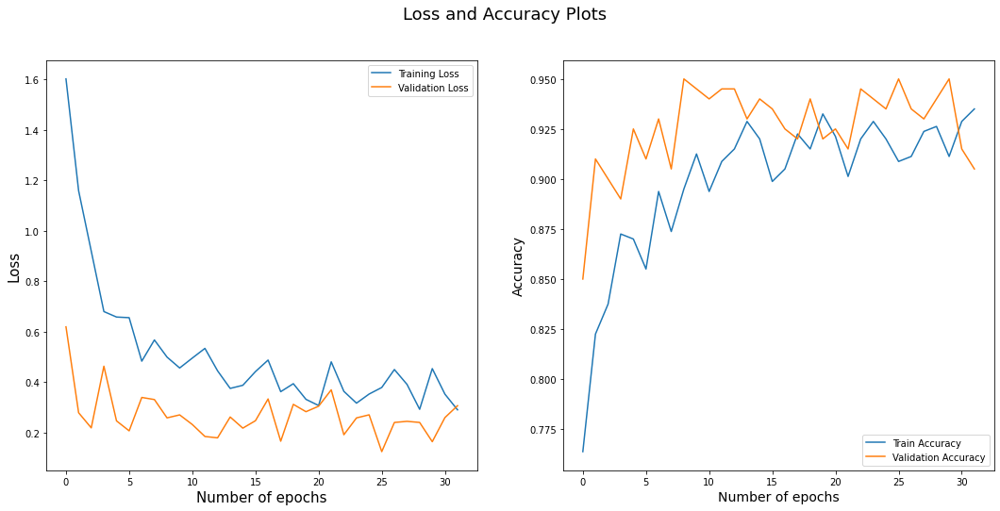

7/7 [==============================] - 2s 39ms/step
0.875


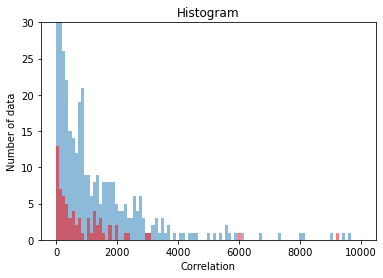

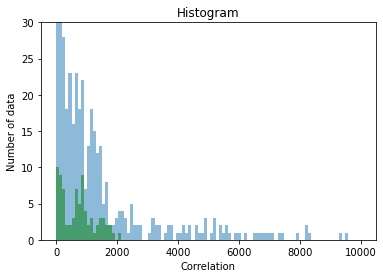

Model: "sequential_41"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_41 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 147ms/step - loss: 1.5997 - acc: 0.7638 - val_loss: 0.4433 - val_acc: 0.9150
Epoch 2/32
25/25 [==============================] - 1s 57ms/step - loss: 1.3908 - acc: 0.8128 - val_loss: 0.2575 - val_acc: 0.9300
Epoch 3/32
25/25 [==============================] - 1s 56ms/step - loss: 0.7750 - acc: 0.8643 - val_loss: 0.3030 - val_acc: 0.9250
Epoch 4/32
25/25 [==============================] - 2s 61ms/step - loss: 0.8275 - acc: 0.8505 - val_loss: 0.4026 - val_acc: 0.8950
Epoch 5/32
25/25 [==============================] - 1s 60ms/step - loss: 0.6648 - acc: 0.8643 - val_loss: 0.5114 - val_acc: 0.8950
Epoch 6/32
25/25 [==============================] - 1s 58ms/step - loss: 0.7519 - acc: 0.8693 - val_loss: 0.2795 - val_acc: 0.9300
Epoch 7/32
25/25 [==============================] - 1s 59ms/step - loss: 0.6152 - acc: 0.8857 - val_loss: 0.1538 - val_acc: 0.9500
Epoch 8/32
25/25 [==============================] - 1s 59ms/step - loss: 0.4566 - acc: 0.8920

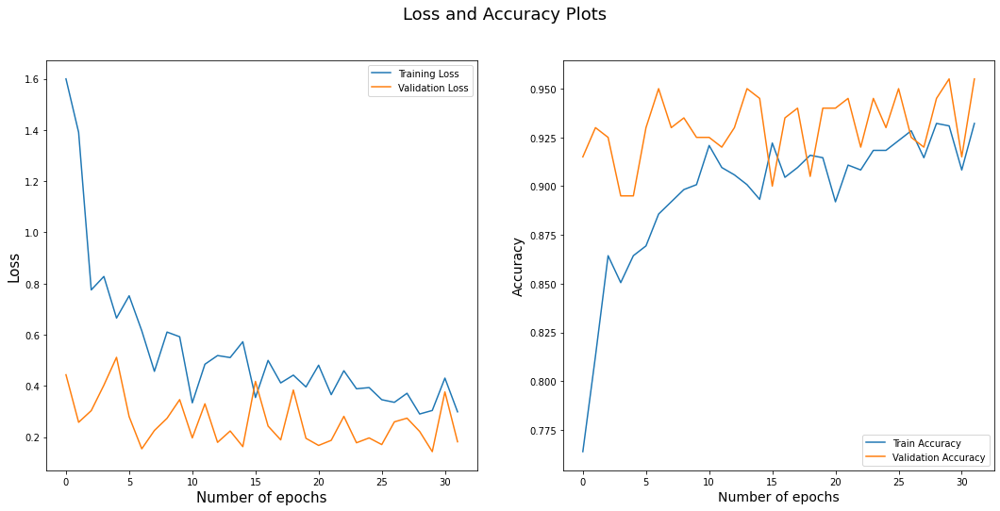

32/32 [==============================] - 1s 36ms/step
Round:  20
Test Accuracy:  0.88
Label Accuracy:  0.861
Number of catagory 1:  483.0
Number of catagory 2:  517.0
Model: "sequential_42"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_42 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Ep

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 7s 115ms/step - loss: 1.6802 - acc: 0.7538 - val_loss: 0.4567 - val_acc: 0.8950
Epoch 2/32
25/25 [==============================] - 1s 51ms/step - loss: 0.9881 - acc: 0.8400 - val_loss: 0.3684 - val_acc: 0.9050
Epoch 3/32
25/25 [==============================] - 1s 54ms/step - loss: 0.8826 - acc: 0.8612 - val_loss: 0.2021 - val_acc: 0.9450
Epoch 4/32
25/25 [==============================] - 1s 51ms/step - loss: 0.7367 - acc: 0.8625 - val_loss: 0.2426 - val_acc: 0.9150
Epoch 5/32
25/25 [==============================] - 1s 56ms/step - loss: 0.6226 - acc: 0.8825 - val_loss: 0.1042 - val_acc: 0.9650
Epoch 6/32
25/25 [==============================] - 1s 57ms/step - loss: 0.6047 - acc: 0.8712 - val_loss: 0.6981 - val_acc: 0.8750
Epoch 7/32
25/25 [==============================] - 1s 55ms/step - loss: 0.6053 - acc: 0.8925 - val_loss: 0.2072 - val_acc: 0.9350
Epoch 8/32
25/25 [==============================] - 1s 51ms/step - loss: 0.5944 - acc: 0.8725

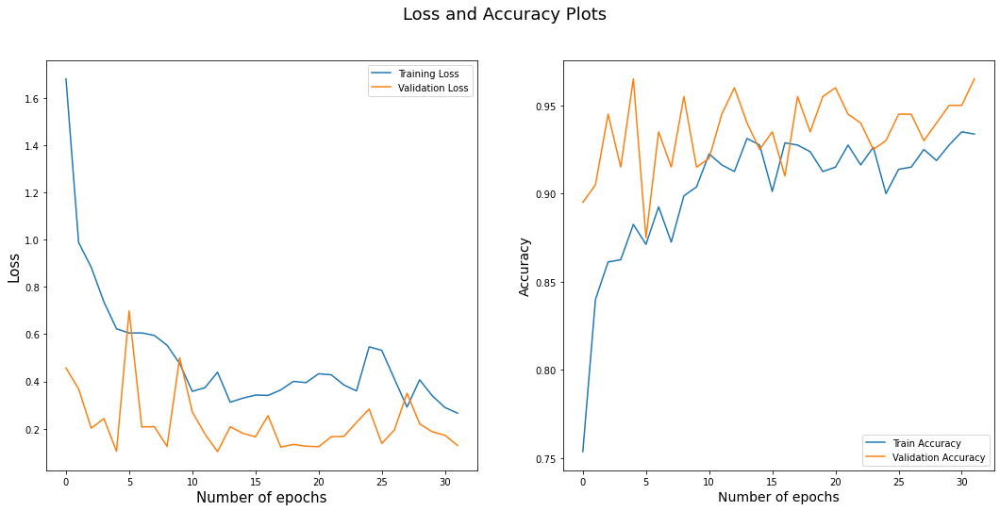

7/7 [==============================] - 2s 42ms/step
0.89


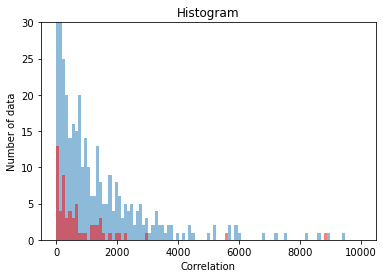

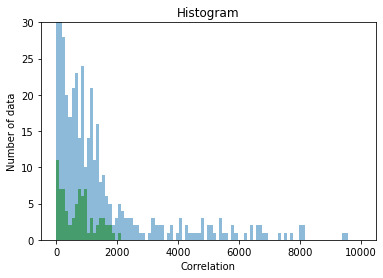

Model: "sequential_43"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_43 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 126ms/step - loss: 1.8396 - acc: 0.7475 - val_loss: 0.6745 - val_acc: 0.8300
Epoch 2/32
25/25 [==============================] - 1s 53ms/step - loss: 1.1628 - acc: 0.8317 - val_loss: 0.1889 - val_acc: 0.9250
Epoch 3/32
25/25 [==============================] - 1s 54ms/step - loss: 0.9132 - acc: 0.8379 - val_loss: 0.2591 - val_acc: 0.9000
Epoch 4/32
25/25 [==============================] - 1s 57ms/step - loss: 0.8151 - acc: 0.8480 - val_loss: 0.3681 - val_acc: 0.8850
Epoch 5/32
25/25 [==============================] - 1s 53ms/step - loss: 0.6591 - acc: 0.8794 - val_loss: 0.3289 - val_acc: 0.8850
Epoch 6/32
25/25 [==============================] - 1s 54ms/step - loss: 0.5659 - acc: 0.8894 - val_loss: 0.1768 - val_acc: 0.9500
Epoch 7/32
25/25 [==============================] - 1s 55ms/step - loss: 0.7046 - acc: 0.8769 - val_loss: 0.1922 - val_acc: 0.9400
Epoch 8/32
25/25 [==============================] - 1s 54ms/step - loss: 0.5207 - acc: 0.9108

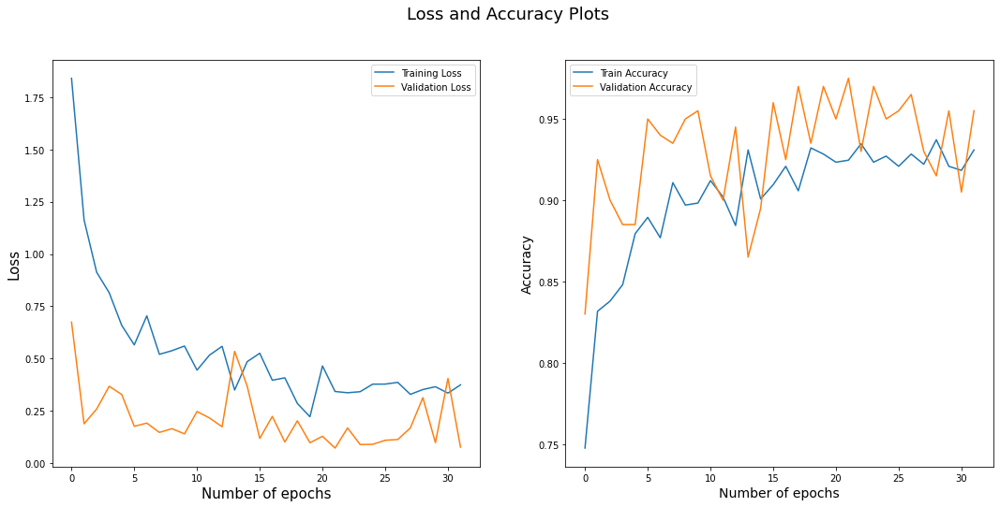

32/32 [==============================] - 1s 39ms/step
Round:  21
Test Accuracy:  0.875
Label Accuracy:  0.861
Number of catagory 1:  483.0
Number of catagory 2:  517.0
Model: "sequential_44"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_44 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


Epoch 1/32
25/25 [==============================] - 8s 124ms/step - loss: 1.5882 - acc: 0.7650 - val_loss: 0.4377 - val_acc: 0.8750
Epoch 2/32
25/25 [==============================] - 1s 54ms/step - loss: 1.1779 - acc: 0.8363 - val_loss: 0.1956 - val_acc: 0.9300
Epoch 3/32
25/25 [==============================] - 1s 54ms/step - loss: 0.8145 - acc: 0.8637 - val_loss: 0.1795 - val_acc: 0.9450
Epoch 4/32
25/25 [==============================] - 1s 52ms/step - loss: 0.8800 - acc: 0.8462 - val_loss: 0.2135 - val_acc: 0.9250
Epoch 5/32
25/25 [==============================] - 1s 54ms/step - loss: 0.6434 - acc: 0.8737 - val_loss: 0.1587 - val_acc: 0.9500
Epoch 6/32
25/25 [==============================] - 1s 54ms/step - loss: 0.6149 - acc: 0.8712 - val_loss: 0.2269 - val_acc: 0.9150
Epoch 7/32
25/25 [==============================] - 1s 53ms/step - loss: 0.6385 - acc: 0.8775 - val_loss: 0.2095 - val_acc: 0.9350
Epoch 8/32
25/25 [==============================] - 1s 50ms/step - loss: 0.6593 - 

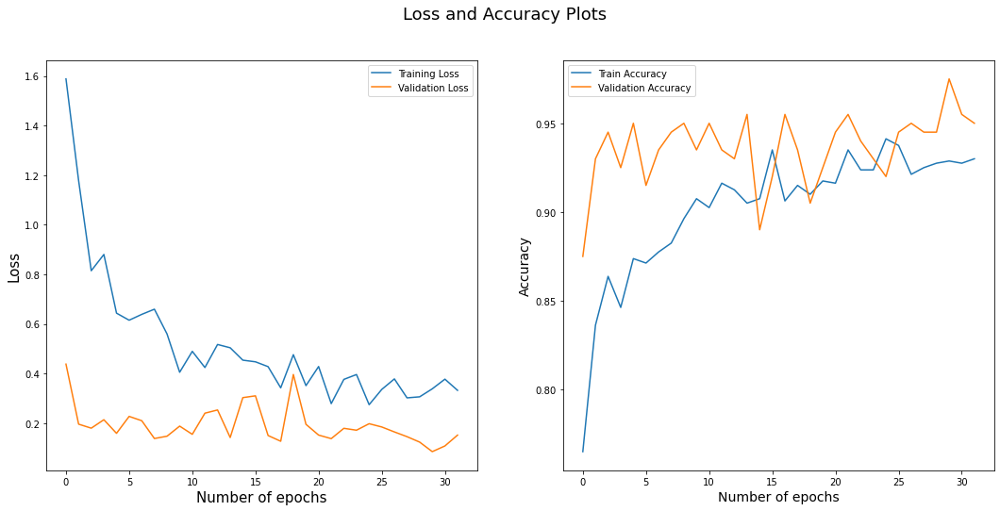

7/7 [==============================] - 2s 40ms/step
0.875


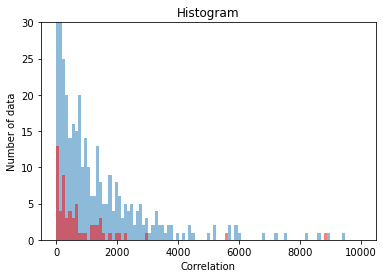

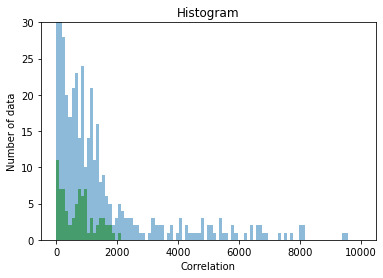

Model: "sequential_45"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_45 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 147ms/step - loss: 1.5011 - acc: 0.7889 - val_loss: 0.3801 - val_acc: 0.9050
Epoch 2/32
25/25 [==============================] - 1s 58ms/step - loss: 1.0755 - acc: 0.8530 - val_loss: 0.4481 - val_acc: 0.8900
Epoch 3/32
25/25 [==============================] - 1s 53ms/step - loss: 1.0501 - acc: 0.8317 - val_loss: 0.1918 - val_acc: 0.9400
Epoch 4/32
25/25 [==============================] - 1s 55ms/step - loss: 0.9400 - acc: 0.8543 - val_loss: 0.3077 - val_acc: 0.9200
Epoch 5/32
25/25 [==============================] - 1s 51ms/step - loss: 0.7566 - acc: 0.8618 - val_loss: 0.2702 - val_acc: 0.9200
Epoch 6/32
25/25 [==============================] - 1s 54ms/step - loss: 0.6645 - acc: 0.8719 - val_loss: 0.1490 - val_acc: 0.9450
Epoch 7/32
25/25 [==============================] - 1s 52ms/step - loss: 0.5138 - acc: 0.8970 - val_loss: 0.2650 - val_acc: 0.9300
Epoch 8/32
25/25 [==============================] - 1s 53ms/step - loss: 0.6065 - acc: 0.8781

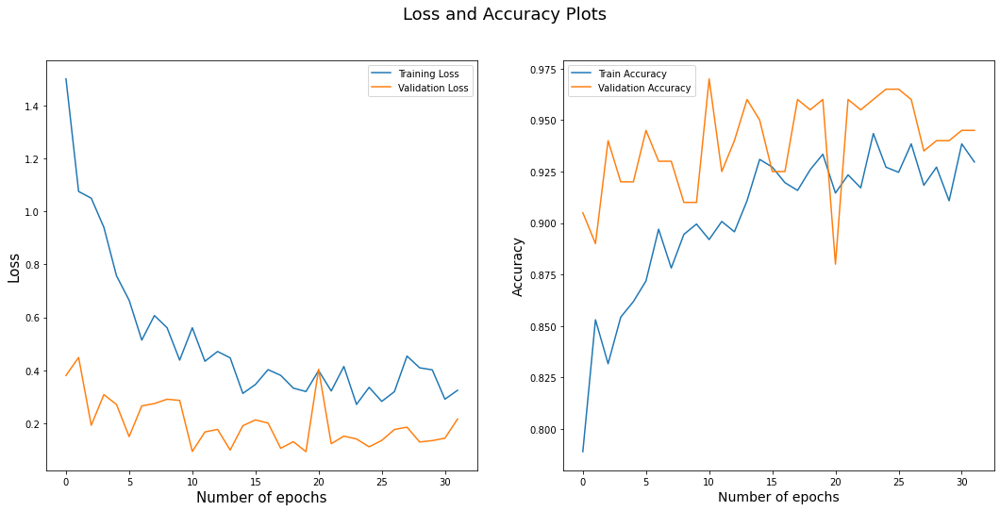

32/32 [==============================] - 1s 36ms/step
Round:  22
Test Accuracy:  0.88
Label Accuracy:  0.865
Number of catagory 1:  489.0
Number of catagory 2:  511.0
Model: "sequential_46"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_46 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Ep

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 7s 128ms/step - loss: 1.6909 - acc: 0.7900 - val_loss: 0.4892 - val_acc: 0.8950
Epoch 2/32
25/25 [==============================] - 1s 54ms/step - loss: 1.0792 - acc: 0.8400 - val_loss: 0.2685 - val_acc: 0.9300
Epoch 3/32
25/25 [==============================] - 1s 52ms/step - loss: 0.8149 - acc: 0.8788 - val_loss: 0.1482 - val_acc: 0.9500
Epoch 4/32
25/25 [==============================] - 1s 49ms/step - loss: 0.7576 - acc: 0.8725 - val_loss: 0.1611 - val_acc: 0.9450
Epoch 5/32
25/25 [==============================] - 1s 55ms/step - loss: 0.5941 - acc: 0.8788 - val_loss: 0.3265 - val_acc: 0.9250
Epoch 6/32
25/25 [==============================] - 1s 53ms/step - loss: 0.7690 - acc: 0.8775 - val_loss: 0.2722 - val_acc: 0.9200
Epoch 7/32
25/25 [==============================] - 1s 56ms/step - loss: 0.5926 - acc: 0.9000 - val_loss: 0.2457 - val_acc: 0.9250
Epoch 8/32
25/25 [==============================] - 1s 55ms/step - loss: 0.4805 - acc: 0.8913

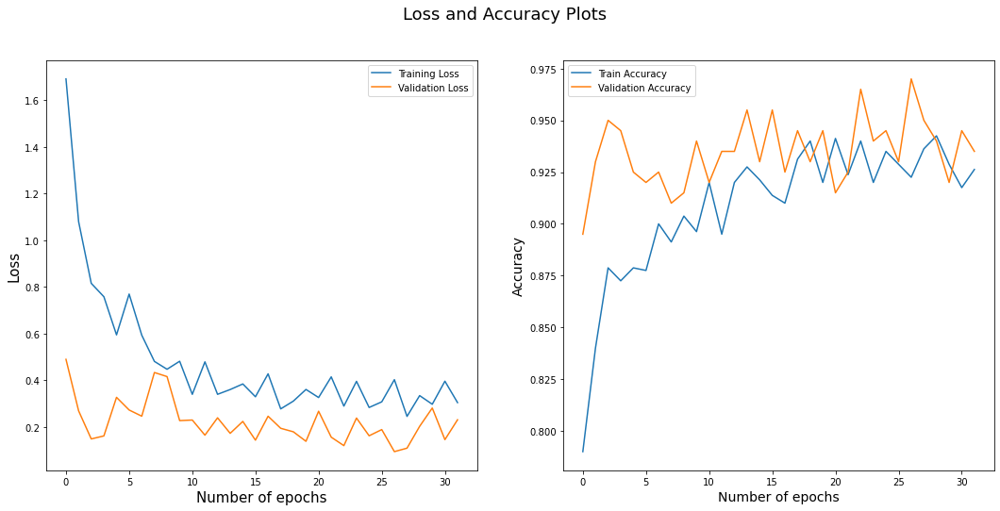

7/7 [==============================] - 2s 37ms/step
0.87


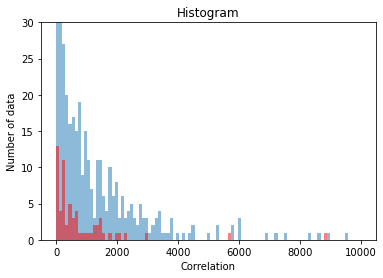

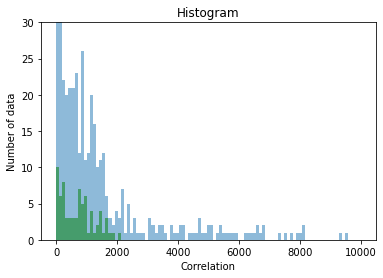

Model: "sequential_47"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_47 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 135ms/step - loss: 1.8476 - acc: 0.7500 - val_loss: 0.4013 - val_acc: 0.8850
Epoch 2/32
25/25 [==============================] - 1s 57ms/step - loss: 0.9571 - acc: 0.8342 - val_loss: 0.3364 - val_acc: 0.9100
Epoch 3/32
25/25 [==============================] - 1s 57ms/step - loss: 0.9167 - acc: 0.8593 - val_loss: 0.2819 - val_acc: 0.9300
Epoch 4/32
25/25 [==============================] - 2s 62ms/step - loss: 0.8493 - acc: 0.8530 - val_loss: 0.1986 - val_acc: 0.9200
Epoch 5/32
25/25 [==============================] - 1s 58ms/step - loss: 0.6846 - acc: 0.8744 - val_loss: 0.3230 - val_acc: 0.9100
Epoch 6/32
25/25 [==============================] - 2s 63ms/step - loss: 0.5710 - acc: 0.8945 - val_loss: 0.1823 - val_acc: 0.9550
Epoch 7/32
25/25 [==============================] - 2s 62ms/step - loss: 0.6383 - acc: 0.8819 - val_loss: 0.1953 - val_acc: 0.9350
Epoch 8/32
25/25 [==============================] - 1s 58ms/step - loss: 0.4488 - acc: 0.9008

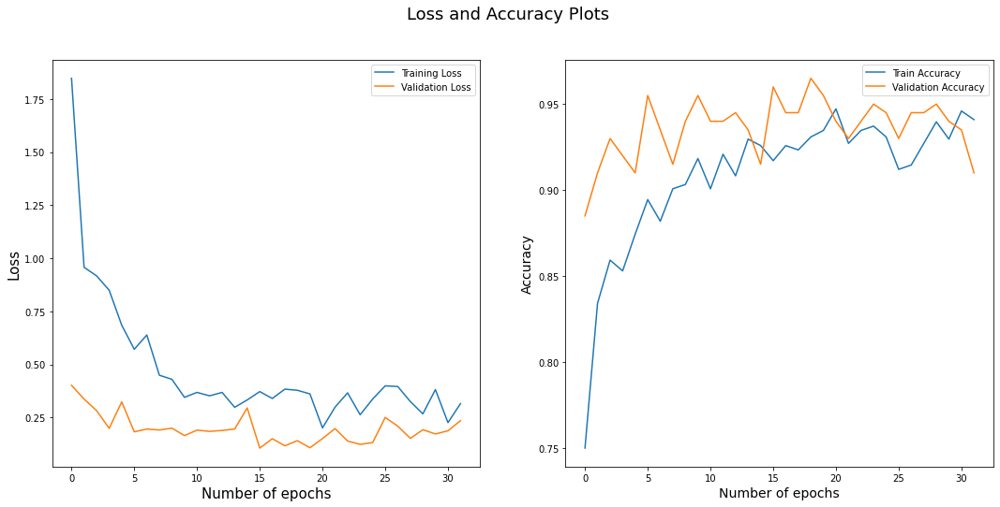

32/32 [==============================] - 1s 38ms/step
Round:  23
Test Accuracy:  0.86
Label Accuracy:  0.863
Number of catagory 1:  487.0
Number of catagory 2:  513.0
Model: "sequential_48"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_48 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Ep

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 131ms/step - loss: 1.4686 - acc: 0.7563 - val_loss: 0.4652 - val_acc: 0.9050
Epoch 2/32
25/25 [==============================] - 1s 49ms/step - loss: 0.9123 - acc: 0.8475 - val_loss: 0.6930 - val_acc: 0.8650
Epoch 3/32
25/25 [==============================] - 1s 55ms/step - loss: 0.9188 - acc: 0.8450 - val_loss: 0.3178 - val_acc: 0.8950
Epoch 4/32
25/25 [==============================] - 1s 54ms/step - loss: 0.8691 - acc: 0.8612 - val_loss: 0.2557 - val_acc: 0.9350
Epoch 5/32
25/25 [==============================] - 1s 53ms/step - loss: 0.6922 - acc: 0.8675 - val_loss: 0.2982 - val_acc: 0.9250
Epoch 6/32
25/25 [==============================] - 1s 50ms/step - loss: 0.5868 - acc: 0.9000 - val_loss: 0.2832 - val_acc: 0.9300
Epoch 7/32
25/25 [==============================] - 1s 57ms/step - loss: 0.4967 - acc: 0.8938 - val_loss: 0.2380 - val_acc: 0.9400
Epoch 8/32
25/25 [==============================] - 1s 55ms/step - loss: 0.5438 - acc: 0.8900

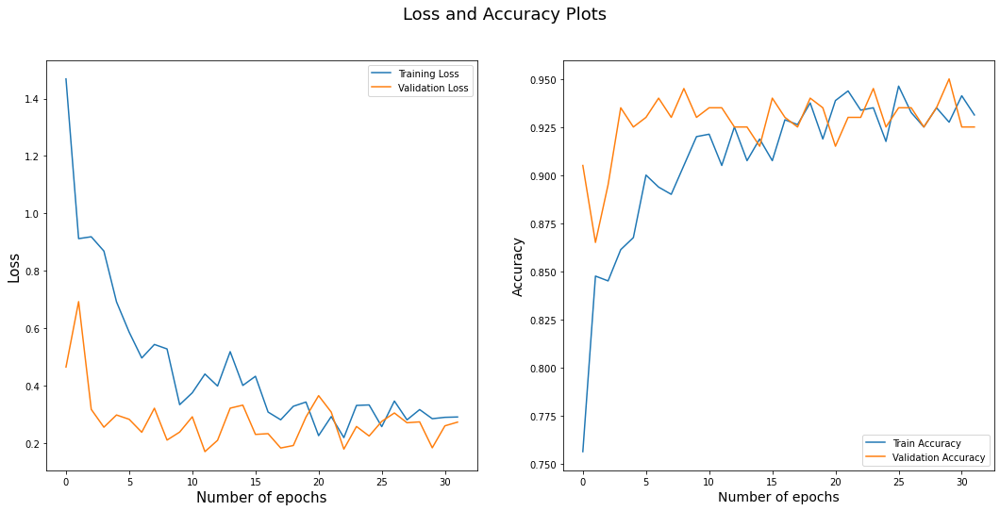

7/7 [==============================] - 2s 36ms/step
0.85


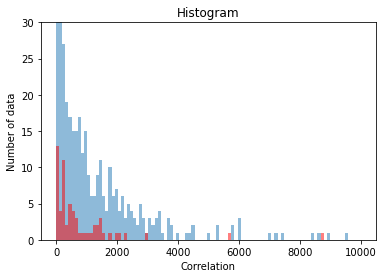

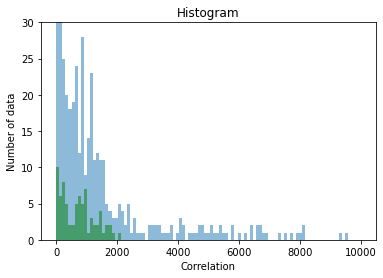

Model: "sequential_49"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_49 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 168ms/step - loss: 1.6189 - acc: 0.7563 - val_loss: 0.4910 - val_acc: 0.8900
Epoch 2/32
25/25 [==============================] - 1s 52ms/step - loss: 1.0147 - acc: 0.8442 - val_loss: 0.2851 - val_acc: 0.9350
Epoch 3/32
25/25 [==============================] - 1s 55ms/step - loss: 0.7752 - acc: 0.8656 - val_loss: 0.2945 - val_acc: 0.9400
Epoch 4/32
25/25 [==============================] - 1s 54ms/step - loss: 0.8504 - acc: 0.8618 - val_loss: 0.2077 - val_acc: 0.9250
Epoch 5/32
25/25 [==============================] - 1s 53ms/step - loss: 0.4883 - acc: 0.8932 - val_loss: 0.2602 - val_acc: 0.9300
Epoch 6/32
25/25 [==============================] - 1s 56ms/step - loss: 0.5661 - acc: 0.8756 - val_loss: 0.2204 - val_acc: 0.9300
Epoch 7/32
25/25 [==============================] - 1s 54ms/step - loss: 0.6362 - acc: 0.8807 - val_loss: 0.2483 - val_acc: 0.9050
Epoch 8/32
25/25 [==============================] - 1s 53ms/step - loss: 0.5198 - acc: 0.8932

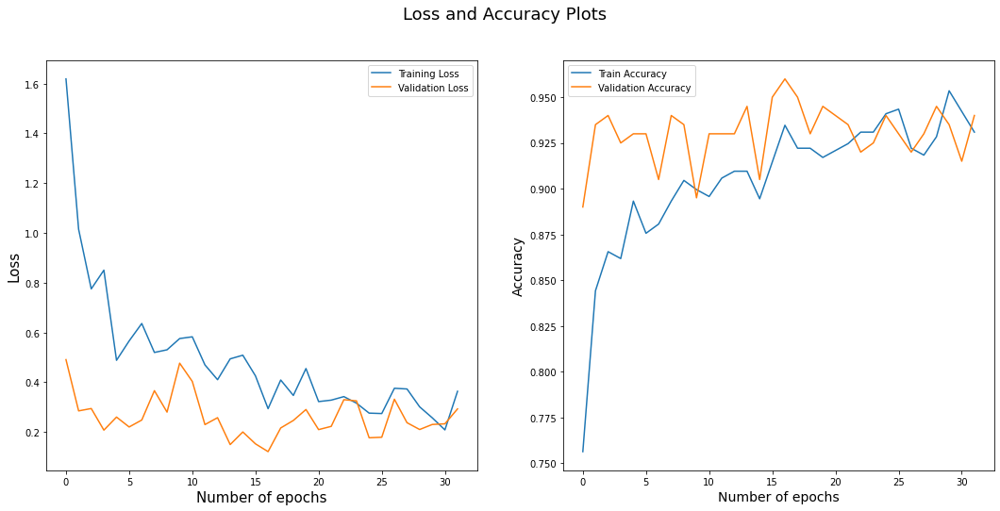

32/32 [==============================] - 1s 36ms/step
Round:  24
Test Accuracy:  0.885
Label Accuracy:  0.867
Number of catagory 1:  491.0
Number of catagory 2:  509.0
Model: "sequential_50"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_50 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
E

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 132ms/step - loss: 1.6399 - acc: 0.7763 - val_loss: 0.2416 - val_acc: 0.9200
Epoch 2/32
25/25 [==============================] - 1s 55ms/step - loss: 1.0761 - acc: 0.8537 - val_loss: 0.2888 - val_acc: 0.9050
Epoch 3/32
25/25 [==============================] - 1s 54ms/step - loss: 0.9387 - acc: 0.8487 - val_loss: 0.1896 - val_acc: 0.9450
Epoch 4/32
25/25 [==============================] - 1s 48ms/step - loss: 0.7971 - acc: 0.8675 - val_loss: 0.2136 - val_acc: 0.9350
Epoch 5/32
25/25 [==============================] - 1s 51ms/step - loss: 0.5555 - acc: 0.8750 - val_loss: 0.3458 - val_acc: 0.9100
Epoch 6/32
25/25 [==============================] - 1s 52ms/step - loss: 0.6492 - acc: 0.8775 - val_loss: 0.1920 - val_acc: 0.9550
Epoch 7/32
25/25 [==============================] - 1s 53ms/step - loss: 0.5336 - acc: 0.8863 - val_loss: 0.2827 - val_acc: 0.9350
Epoch 8/32
25/25 [==============================] - 1s 51ms/step - loss: 0.5785 - acc: 0.8863

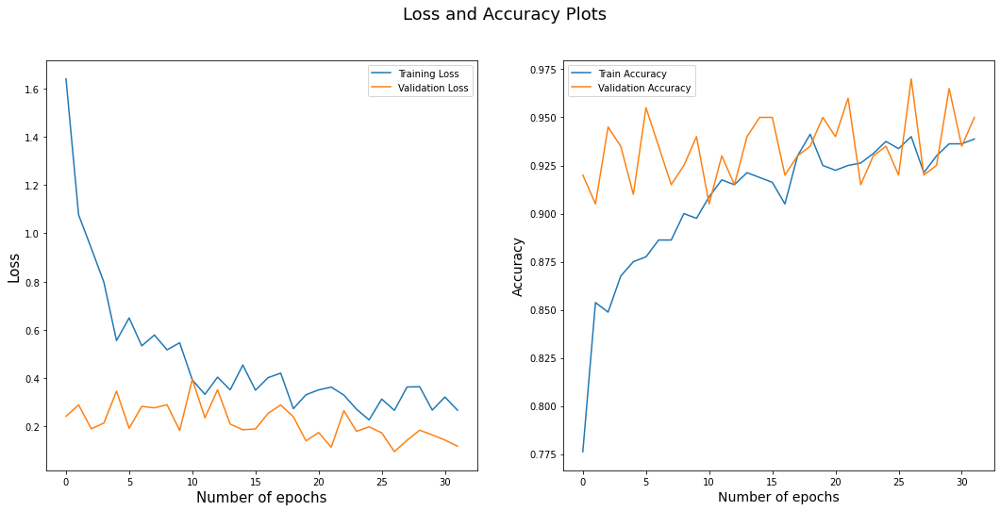

7/7 [==============================] - 2s 36ms/step
0.875


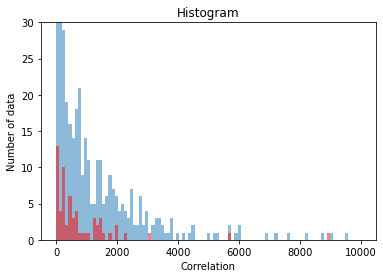

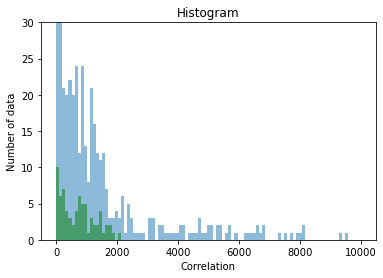

Model: "sequential_51"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_51 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 134ms/step - loss: 1.3726 - acc: 0.7676 - val_loss: 0.3869 - val_acc: 0.8900
Epoch 2/32
25/25 [==============================] - 1s 58ms/step - loss: 1.1514 - acc: 0.8266 - val_loss: 0.2373 - val_acc: 0.9250
Epoch 3/32
25/25 [==============================] - 1s 55ms/step - loss: 0.8109 - acc: 0.8631 - val_loss: 0.2776 - val_acc: 0.9200
Epoch 4/32
25/25 [==============================] - 1s 56ms/step - loss: 0.6076 - acc: 0.8844 - val_loss: 0.1558 - val_acc: 0.9350
Epoch 5/32
25/25 [==============================] - 1s 55ms/step - loss: 0.7359 - acc: 0.8643 - val_loss: 0.3209 - val_acc: 0.9050
Epoch 6/32
25/25 [==============================] - 1s 57ms/step - loss: 0.5513 - acc: 0.8794 - val_loss: 0.2574 - val_acc: 0.9000
Epoch 7/32
25/25 [==============================] - 1s 54ms/step - loss: 0.5393 - acc: 0.8907 - val_loss: 0.2514 - val_acc: 0.9250
Epoch 8/32
25/25 [==============================] - 1s 54ms/step - loss: 0.4850 - acc: 0.9058

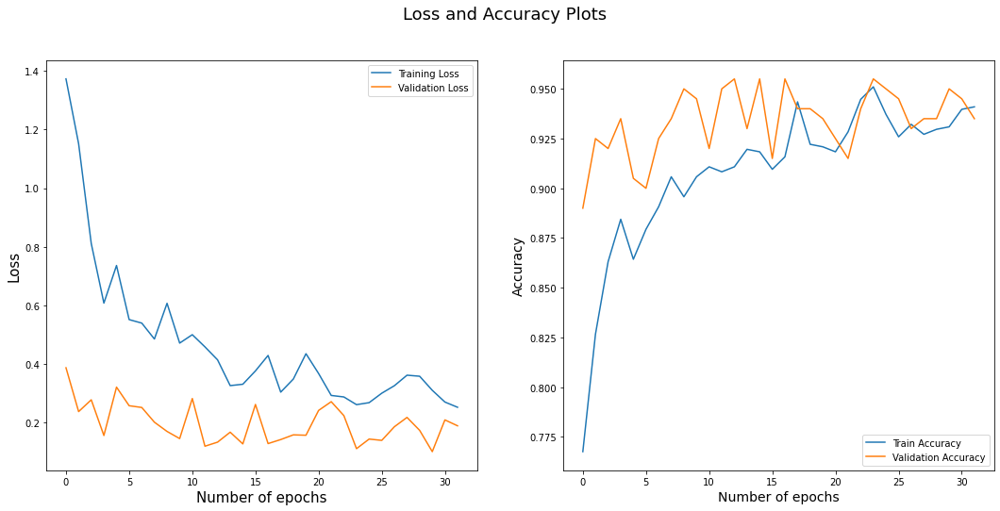

32/32 [==============================] - 1s 39ms/step
Round:  25
Test Accuracy:  0.865
Label Accuracy:  0.866
Number of catagory 1:  488.0
Number of catagory 2:  512.0
Model: "sequential_52"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_52 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
E

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 133ms/step - loss: 1.4490 - acc: 0.7812 - val_loss: 0.3377 - val_acc: 0.9150
Epoch 2/32
25/25 [==============================] - 1s 54ms/step - loss: 1.0469 - acc: 0.8163 - val_loss: 0.3533 - val_acc: 0.9000
Epoch 3/32
25/25 [==============================] - 1s 53ms/step - loss: 0.6636 - acc: 0.8800 - val_loss: 0.3721 - val_acc: 0.9000
Epoch 4/32
25/25 [==============================] - 1s 52ms/step - loss: 0.6788 - acc: 0.8737 - val_loss: 0.2853 - val_acc: 0.9100
Epoch 5/32
25/25 [==============================] - 1s 53ms/step - loss: 0.6881 - acc: 0.8725 - val_loss: 0.6276 - val_acc: 0.8650
Epoch 6/32
25/25 [==============================] - 1s 51ms/step - loss: 0.6708 - acc: 0.8775 - val_loss: 0.2606 - val_acc: 0.9100
Epoch 7/32
25/25 [==============================] - 1s 54ms/step - loss: 0.4827 - acc: 0.8950 - val_loss: 0.2249 - val_acc: 0.9250
Epoch 8/32
25/25 [==============================] - 1s 52ms/step - loss: 0.5661 - acc: 0.9087

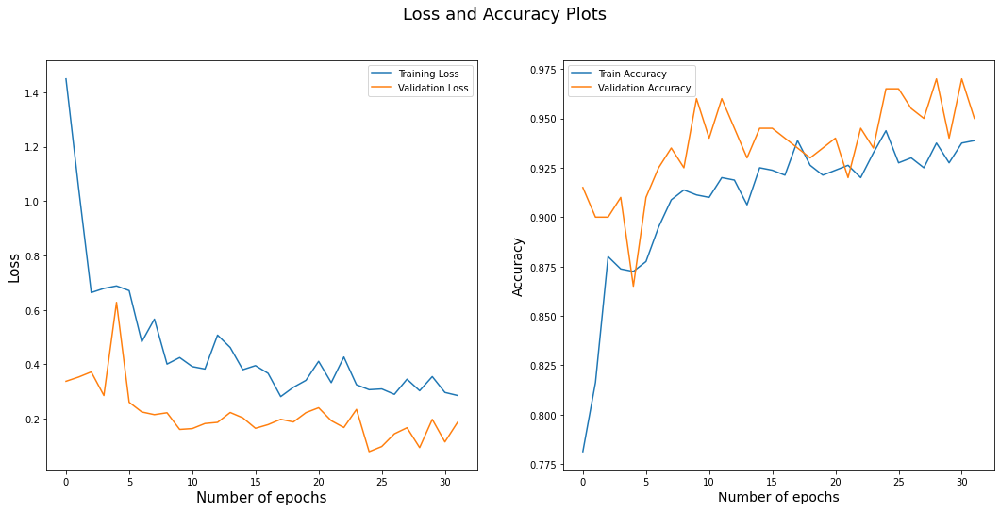

7/7 [==============================] - 2s 36ms/step
0.88


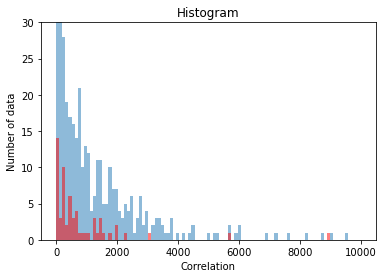

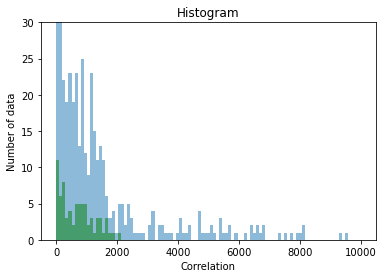

Model: "sequential_53"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_53 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 159ms/step - loss: 1.7793 - acc: 0.7776 - val_loss: 0.2666 - val_acc: 0.9200
Epoch 2/32
25/25 [==============================] - 1s 56ms/step - loss: 1.0535 - acc: 0.8405 - val_loss: 0.6860 - val_acc: 0.8800
Epoch 3/32
25/25 [==============================] - 1s 57ms/step - loss: 0.8836 - acc: 0.8668 - val_loss: 0.2003 - val_acc: 0.9450
Epoch 4/32
25/25 [==============================] - 1s 55ms/step - loss: 0.6231 - acc: 0.8819 - val_loss: 0.3903 - val_acc: 0.9000
Epoch 5/32
25/25 [==============================] - 1s 56ms/step - loss: 0.7339 - acc: 0.8807 - val_loss: 0.3241 - val_acc: 0.9150
Epoch 6/32
25/25 [==============================] - 1s 54ms/step - loss: 0.6906 - acc: 0.8832 - val_loss: 0.3428 - val_acc: 0.9150
Epoch 7/32
25/25 [==============================] - 1s 57ms/step - loss: 0.7002 - acc: 0.8857 - val_loss: 0.1849 - val_acc: 0.9400
Epoch 8/32
25/25 [==============================] - 1s 57ms/step - loss: 0.5270 - acc: 0.8844

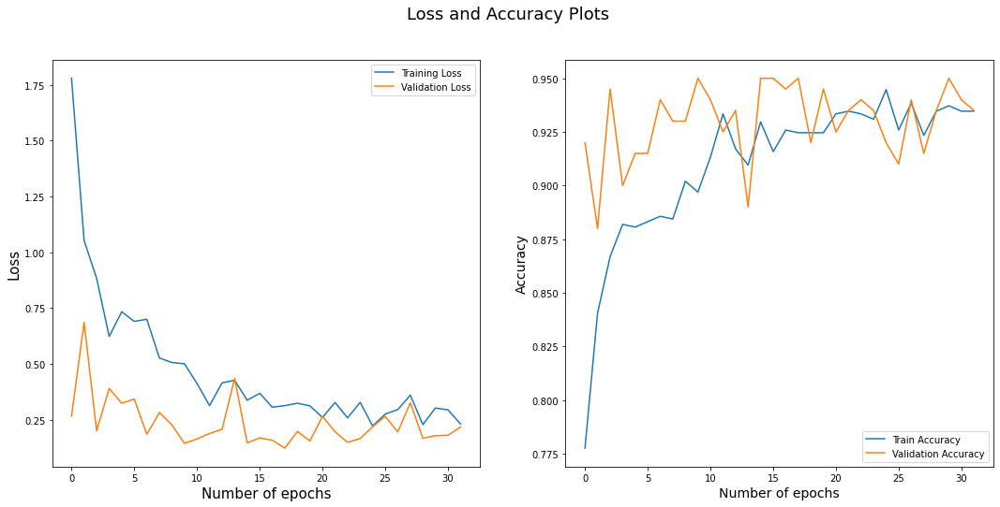

32/32 [==============================] - 1s 37ms/step
Round:  26
Test Accuracy:  0.87
Label Accuracy:  0.864
Number of catagory 1:  486.0
Number of catagory 2:  514.0
Model: "sequential_54"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_54 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Ep

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 129ms/step - loss: 1.3997 - acc: 0.7937 - val_loss: 0.2317 - val_acc: 0.9350
Epoch 2/32
25/25 [==============================] - 1s 55ms/step - loss: 0.9784 - acc: 0.8462 - val_loss: 0.2201 - val_acc: 0.9150
Epoch 3/32
25/25 [==============================] - 1s 55ms/step - loss: 0.7923 - acc: 0.8625 - val_loss: 0.2678 - val_acc: 0.9250
Epoch 4/32
25/25 [==============================] - 1s 47ms/step - loss: 0.7922 - acc: 0.8512 - val_loss: 0.2466 - val_acc: 0.9250
Epoch 5/32
25/25 [==============================] - 1s 53ms/step - loss: 0.6477 - acc: 0.8687 - val_loss: 0.2265 - val_acc: 0.9300
Epoch 6/32
25/25 [==============================] - 1s 55ms/step - loss: 0.5488 - acc: 0.9000 - val_loss: 0.3104 - val_acc: 0.9100
Epoch 7/32
25/25 [==============================] - 1s 58ms/step - loss: 0.5991 - acc: 0.8800 - val_loss: 0.1548 - val_acc: 0.9550
Epoch 8/32
25/25 [==============================] - 1s 54ms/step - loss: 0.5069 - acc: 0.8913

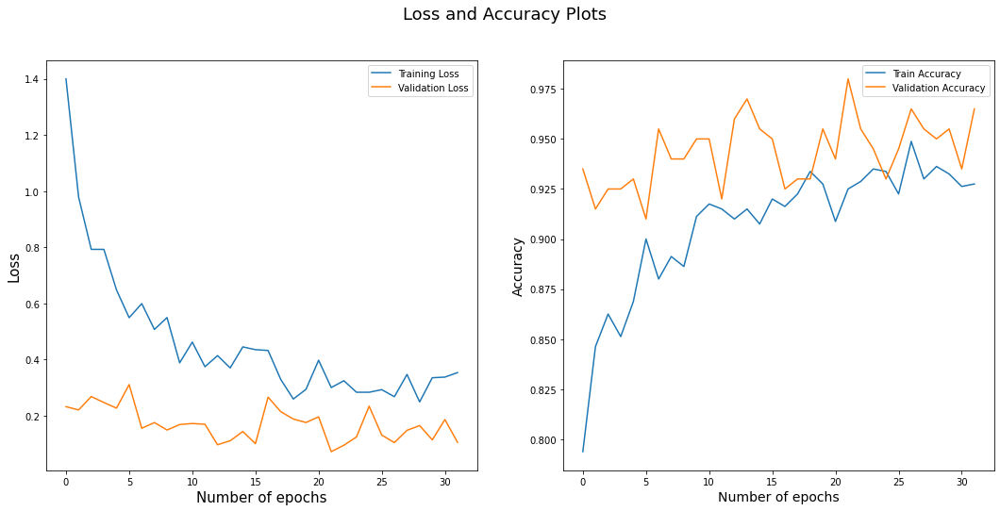

7/7 [==============================] - 4s 41ms/step
0.89


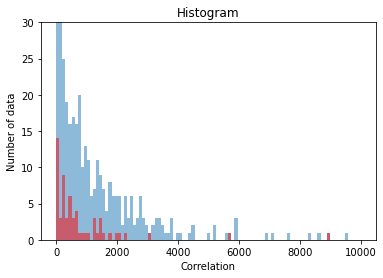

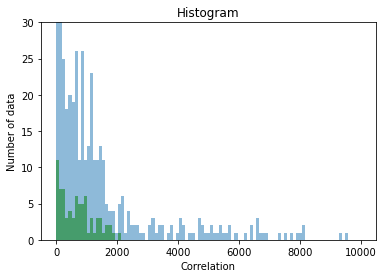

Model: "sequential_55"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_55 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 135ms/step - loss: 1.5019 - acc: 0.7462 - val_loss: 0.3729 - val_acc: 0.8800
Epoch 2/32
25/25 [==============================] - 1s 54ms/step - loss: 1.1347 - acc: 0.8505 - val_loss: 0.2299 - val_acc: 0.9350
Epoch 3/32
25/25 [==============================] - 1s 54ms/step - loss: 0.7674 - acc: 0.8593 - val_loss: 0.2894 - val_acc: 0.9100
Epoch 4/32
25/25 [==============================] - 1s 57ms/step - loss: 0.6759 - acc: 0.8580 - val_loss: 0.2075 - val_acc: 0.9350
Epoch 5/32
25/25 [==============================] - 1s 61ms/step - loss: 0.6120 - acc: 0.8794 - val_loss: 0.2000 - val_acc: 0.9250
Epoch 6/32
25/25 [==============================] - 1s 55ms/step - loss: 0.6673 - acc: 0.8807 - val_loss: 0.2695 - val_acc: 0.9200
Epoch 7/32
25/25 [==============================] - 1s 57ms/step - loss: 0.5781 - acc: 0.9033 - val_loss: 0.3075 - val_acc: 0.9150
Epoch 8/32
25/25 [==============================] - 1s 56ms/step - loss: 0.5608 - acc: 0.8970

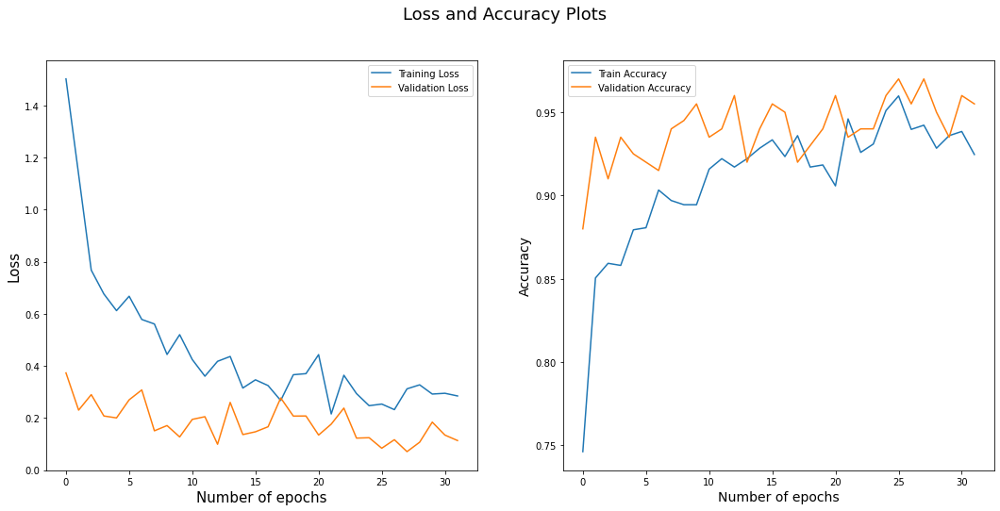

32/32 [==============================] - 1s 38ms/step
Round:  27
Test Accuracy:  0.87
Label Accuracy:  0.865
Number of catagory 1:  487.0
Number of catagory 2:  513.0
Model: "sequential_56"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_56 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Ep

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 127ms/step - loss: 1.6526 - acc: 0.7575 - val_loss: 0.5244 - val_acc: 0.9000
Epoch 2/32
25/25 [==============================] - 1s 55ms/step - loss: 0.9078 - acc: 0.8637 - val_loss: 0.3036 - val_acc: 0.9350
Epoch 3/32
25/25 [==============================] - 1s 54ms/step - loss: 0.6985 - acc: 0.8725 - val_loss: 0.2430 - val_acc: 0.9300
Epoch 4/32
25/25 [==============================] - 1s 53ms/step - loss: 0.6489 - acc: 0.8888 - val_loss: 0.3606 - val_acc: 0.9200
Epoch 5/32
25/25 [==============================] - 1s 56ms/step - loss: 0.6084 - acc: 0.8825 - val_loss: 0.2708 - val_acc: 0.9250
Epoch 6/32
25/25 [==============================] - 1s 54ms/step - loss: 0.6559 - acc: 0.8700 - val_loss: 0.4430 - val_acc: 0.9200
Epoch 7/32
25/25 [==============================] - 1s 53ms/step - loss: 0.6213 - acc: 0.8863 - val_loss: 0.1451 - val_acc: 0.9400
Epoch 8/32
25/25 [==============================] - 1s 52ms/step - loss: 0.5542 - acc: 0.8938

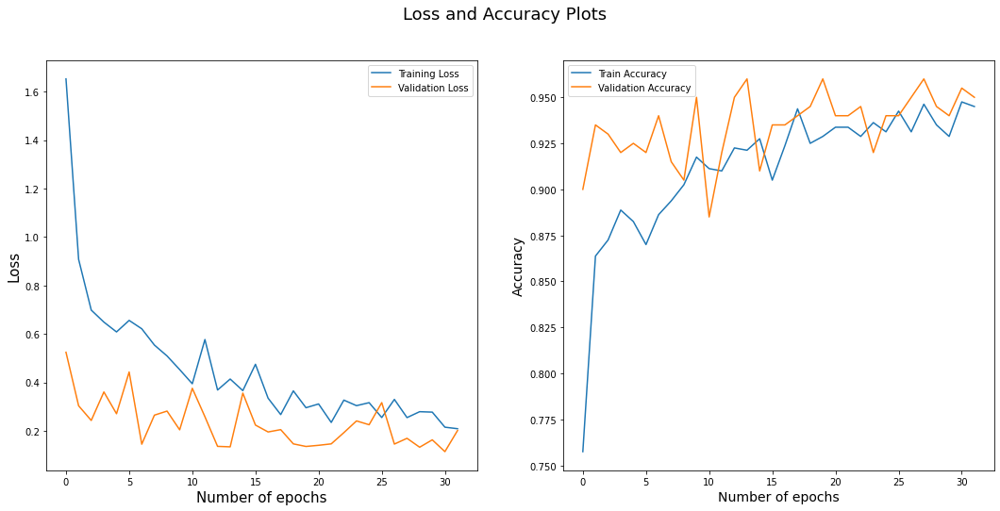

7/7 [==============================] - 2s 32ms/step
0.865


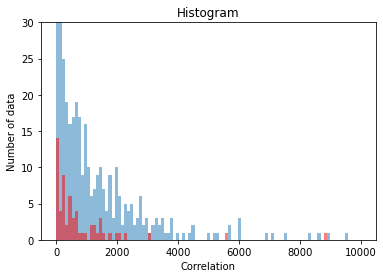

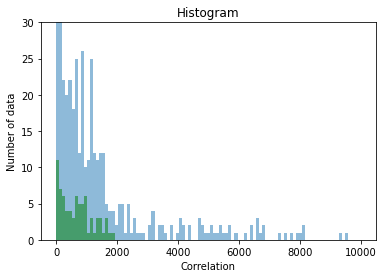

Model: "sequential_57"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_57 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 130ms/step - loss: 1.4353 - acc: 0.7940 - val_loss: 0.3069 - val_acc: 0.9000
Epoch 2/32
25/25 [==============================] - 1s 54ms/step - loss: 1.0100 - acc: 0.8492 - val_loss: 0.5866 - val_acc: 0.8650
Epoch 3/32
25/25 [==============================] - 1s 57ms/step - loss: 0.9101 - acc: 0.8455 - val_loss: 0.2453 - val_acc: 0.9350
Epoch 4/32
25/25 [==============================] - 1s 56ms/step - loss: 0.7553 - acc: 0.8693 - val_loss: 0.4591 - val_acc: 0.8750
Epoch 5/32
25/25 [==============================] - 1s 58ms/step - loss: 0.7018 - acc: 0.8744 - val_loss: 0.2952 - val_acc: 0.9050
Epoch 6/32
25/25 [==============================] - 1s 54ms/step - loss: 0.6338 - acc: 0.8781 - val_loss: 0.3327 - val_acc: 0.8900
Epoch 7/32
25/25 [==============================] - 1s 55ms/step - loss: 0.6049 - acc: 0.8894 - val_loss: 0.2300 - val_acc: 0.9250
Epoch 8/32
25/25 [==============================] - 1s 58ms/step - loss: 0.4661 - acc: 0.8982

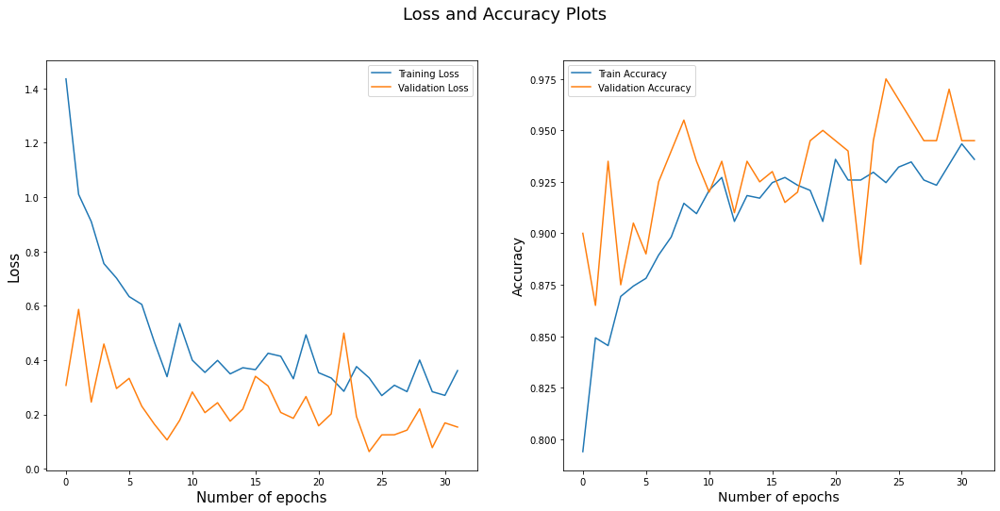

32/32 [==============================] - 1s 40ms/step
Round:  28
Test Accuracy:  0.865
Label Accuracy:  0.866
Number of catagory 1:  488.0
Number of catagory 2:  512.0
Model: "sequential_58"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_58 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
E

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 129ms/step - loss: 1.2372 - acc: 0.7800 - val_loss: 0.3430 - val_acc: 0.9100
Epoch 2/32
25/25 [==============================] - 1s 52ms/step - loss: 0.9161 - acc: 0.8562 - val_loss: 0.2047 - val_acc: 0.9350
Epoch 3/32
25/25 [==============================] - 1s 53ms/step - loss: 0.8624 - acc: 0.8550 - val_loss: 0.2768 - val_acc: 0.9100
Epoch 4/32
25/25 [==============================] - 1s 50ms/step - loss: 0.6632 - acc: 0.8750 - val_loss: 0.2187 - val_acc: 0.9150
Epoch 5/32
25/25 [==============================] - 1s 54ms/step - loss: 0.5857 - acc: 0.8888 - val_loss: 0.3418 - val_acc: 0.9100
Epoch 6/32
25/25 [==============================] - 1s 59ms/step - loss: 0.5107 - acc: 0.8988 - val_loss: 0.2379 - val_acc: 0.9200
Epoch 7/32
25/25 [==============================] - 1s 54ms/step - loss: 0.4592 - acc: 0.9050 - val_loss: 0.1929 - val_acc: 0.9150
Epoch 8/32
25/25 [==============================] - 1s 52ms/step - loss: 0.5356 - acc: 0.9038

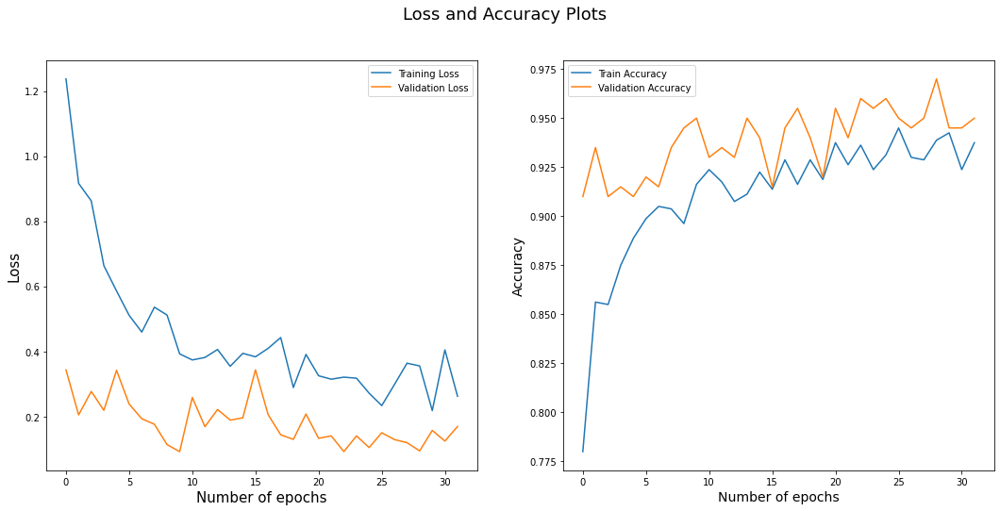

7/7 [==============================] - 2s 37ms/step
0.89


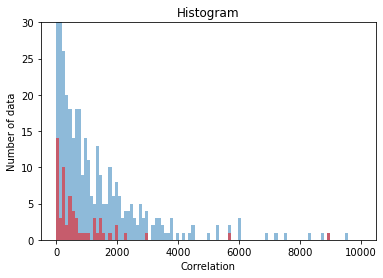

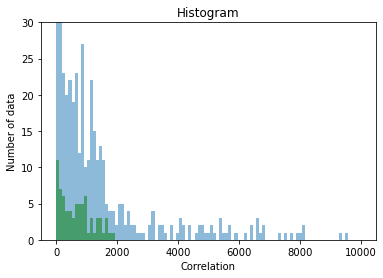

Model: "sequential_59"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_59 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 117ms/step - loss: 1.3523 - acc: 0.7764 - val_loss: 0.5047 - val_acc: 0.8850
Epoch 2/32
25/25 [==============================] - 1s 53ms/step - loss: 1.0810 - acc: 0.8216 - val_loss: 0.1918 - val_acc: 0.9400
Epoch 3/32
25/25 [==============================] - 1s 54ms/step - loss: 0.8606 - acc: 0.8631 - val_loss: 0.2055 - val_acc: 0.9350
Epoch 4/32
25/25 [==============================] - 1s 53ms/step - loss: 0.7849 - acc: 0.8530 - val_loss: 0.1147 - val_acc: 0.9450
Epoch 5/32
25/25 [==============================] - 1s 51ms/step - loss: 0.6710 - acc: 0.8781 - val_loss: 0.4175 - val_acc: 0.8900
Epoch 6/32
25/25 [==============================] - 1s 53ms/step - loss: 0.5555 - acc: 0.8945 - val_loss: 0.2056 - val_acc: 0.9350
Epoch 7/32
25/25 [==============================] - 1s 53ms/step - loss: 0.5516 - acc: 0.9020 - val_loss: 0.1907 - val_acc: 0.9550
Epoch 8/32
25/25 [==============================] - 1s 52ms/step - loss: 0.5545 - acc: 0.9058

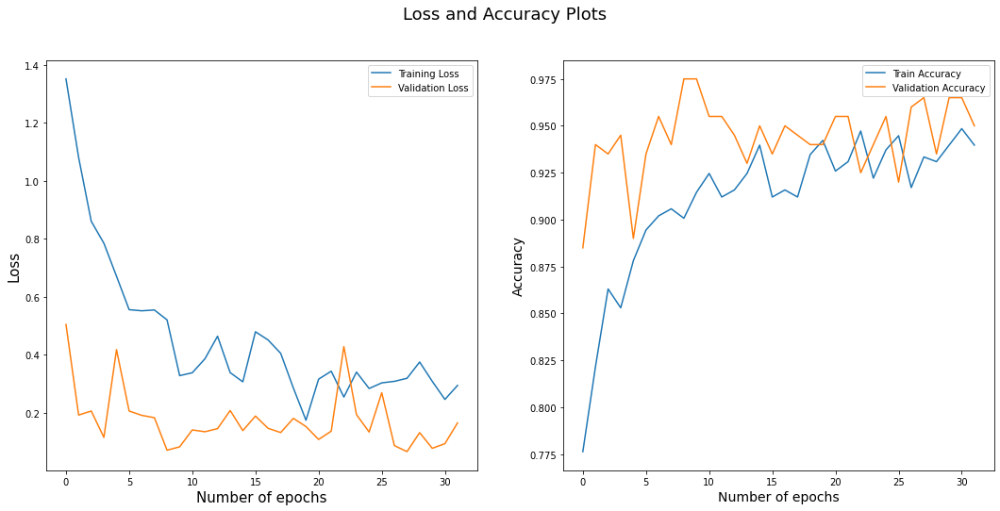

32/32 [==============================] - 1s 38ms/step
Round:  29
Test Accuracy:  0.865
Label Accuracy:  0.869
Number of catagory 1:  485.0
Number of catagory 2:  515.0
Model: "sequential_60"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_60 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
E

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 120ms/step - loss: 1.5639 - acc: 0.7713 - val_loss: 0.4375 - val_acc: 0.9000
Epoch 2/32
25/25 [==============================] - 1s 47ms/step - loss: 0.9329 - acc: 0.8487 - val_loss: 0.3075 - val_acc: 0.9200
Epoch 3/32
25/25 [==============================] - 1s 51ms/step - loss: 0.6933 - acc: 0.8612 - val_loss: 0.2555 - val_acc: 0.9100
Epoch 4/32
25/25 [==============================] - 1s 51ms/step - loss: 0.8557 - acc: 0.8625 - val_loss: 0.1650 - val_acc: 0.9500
Epoch 5/32
25/25 [==============================] - 1s 56ms/step - loss: 0.5853 - acc: 0.8788 - val_loss: 0.1634 - val_acc: 0.9450
Epoch 6/32
25/25 [==============================] - 1s 50ms/step - loss: 0.7110 - acc: 0.8737 - val_loss: 0.2451 - val_acc: 0.9350
Epoch 7/32
25/25 [==============================] - 1s 51ms/step - loss: 0.5319 - acc: 0.8888 - val_loss: 0.1140 - val_acc: 0.9550
Epoch 8/32
25/25 [==============================] - 1s 58ms/step - loss: 0.5739 - acc: 0.8988

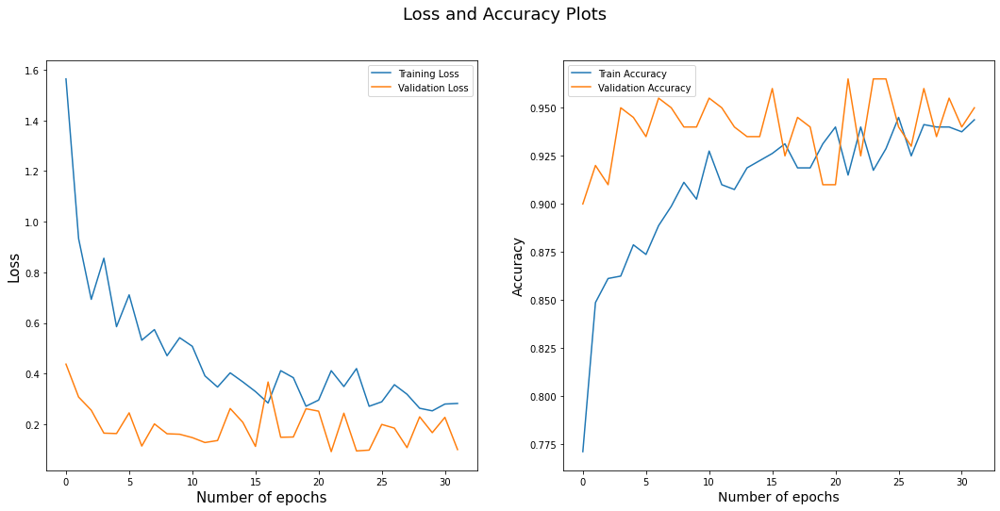

7/7 [==============================] - 2s 37ms/step
0.87


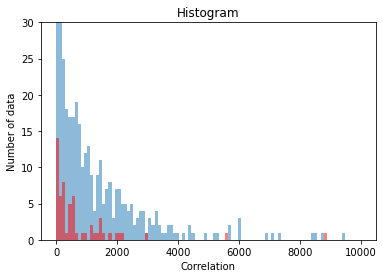

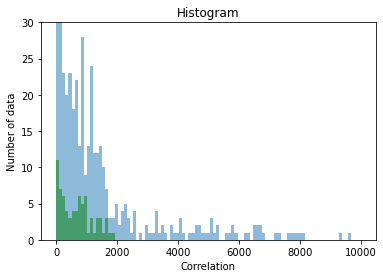

Model: "sequential_61"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_61 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 168ms/step - loss: 1.7567 - acc: 0.7563 - val_loss: 0.6183 - val_acc: 0.8750
Epoch 2/32
25/25 [==============================] - 1s 54ms/step - loss: 1.2628 - acc: 0.8266 - val_loss: 0.2763 - val_acc: 0.9300
Epoch 3/32
25/25 [==============================] - 1s 51ms/step - loss: 0.7456 - acc: 0.8731 - val_loss: 0.3346 - val_acc: 0.9100
Epoch 4/32
25/25 [==============================] - 1s 51ms/step - loss: 0.8561 - acc: 0.8731 - val_loss: 0.2612 - val_acc: 0.9200
Epoch 5/32
25/25 [==============================] - 1s 53ms/step - loss: 0.7688 - acc: 0.8819 - val_loss: 0.2425 - val_acc: 0.9150
Epoch 6/32
25/25 [==============================] - 1s 52ms/step - loss: 0.6299 - acc: 0.8731 - val_loss: 0.1624 - val_acc: 0.9350
Epoch 7/32
25/25 [==============================] - 1s 58ms/step - loss: 0.5112 - acc: 0.9008 - val_loss: 0.1457 - val_acc: 0.9450
Epoch 8/32
25/25 [==============================] - 1s 55ms/step - loss: 0.5439 - acc: 0.9008

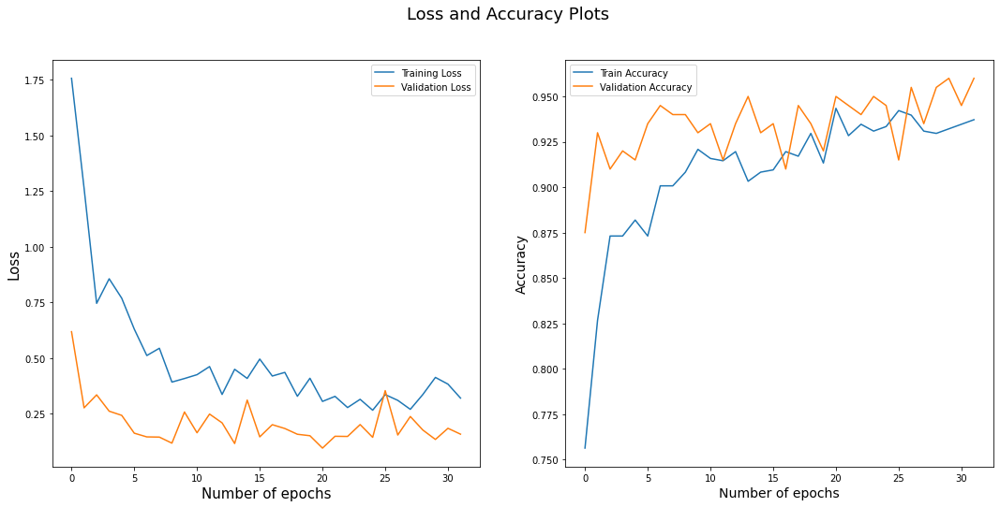

32/32 [==============================] - 1s 39ms/step
Round:  30
Test Accuracy:  0.885
Label Accuracy:  0.87
Number of catagory 1:  488.0
Number of catagory 2:  512.0
Model: "sequential_62"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_62 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Ep

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 126ms/step - loss: 1.6877 - acc: 0.7663 - val_loss: 0.2823 - val_acc: 0.9200
Epoch 2/32
25/25 [==============================] - 1s 54ms/step - loss: 0.8912 - acc: 0.8537 - val_loss: 0.3485 - val_acc: 0.9100
Epoch 3/32
25/25 [==============================] - 1s 57ms/step - loss: 0.9680 - acc: 0.8325 - val_loss: 0.3672 - val_acc: 0.9000
Epoch 4/32
25/25 [==============================] - 1s 58ms/step - loss: 0.6023 - acc: 0.8950 - val_loss: 0.2206 - val_acc: 0.9100
Epoch 5/32
25/25 [==============================] - 1s 53ms/step - loss: 0.5926 - acc: 0.8900 - val_loss: 0.1934 - val_acc: 0.9350
Epoch 6/32
25/25 [==============================] - 1s 56ms/step - loss: 0.5178 - acc: 0.8888 - val_loss: 0.3249 - val_acc: 0.9300
Epoch 7/32
25/25 [==============================] - 1s 57ms/step - loss: 0.4529 - acc: 0.9100 - val_loss: 0.1767 - val_acc: 0.9250
Epoch 8/32
25/25 [==============================] - 1s 56ms/step - loss: 0.4308 - acc: 0.9075

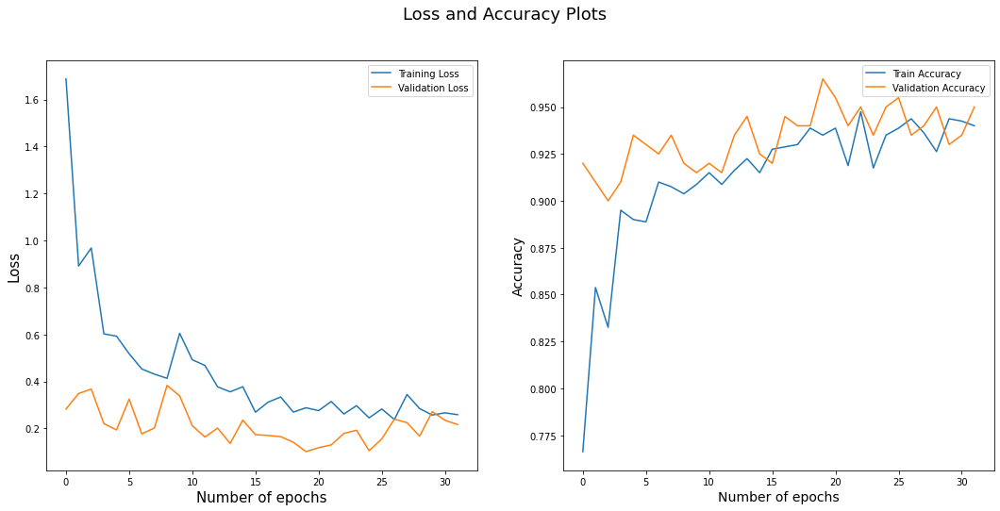

7/7 [==============================] - 3s 37ms/step
0.875


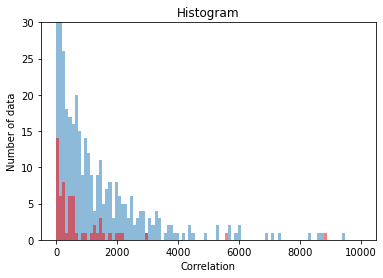

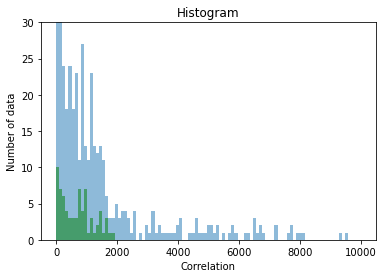

Model: "sequential_63"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_63 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 122ms/step - loss: 1.5060 - acc: 0.7701 - val_loss: 0.3742 - val_acc: 0.9250
Epoch 2/32
25/25 [==============================] - 1s 55ms/step - loss: 1.1048 - acc: 0.8317 - val_loss: 0.3360 - val_acc: 0.9150
Epoch 3/32
25/25 [==============================] - 1s 57ms/step - loss: 0.9331 - acc: 0.8455 - val_loss: 0.2715 - val_acc: 0.9350
Epoch 4/32
25/25 [==============================] - 1s 53ms/step - loss: 0.6292 - acc: 0.8832 - val_loss: 0.1795 - val_acc: 0.9350
Epoch 5/32
25/25 [==============================] - 1s 53ms/step - loss: 0.6300 - acc: 0.8894 - val_loss: 0.2283 - val_acc: 0.9350
Epoch 6/32
25/25 [==============================] - 1s 54ms/step - loss: 0.5302 - acc: 0.9020 - val_loss: 0.2745 - val_acc: 0.9250
Epoch 7/32
25/25 [==============================] - 1s 56ms/step - loss: 0.4815 - acc: 0.9133 - val_loss: 0.1678 - val_acc: 0.9300
Epoch 8/32
25/25 [==============================] - 1s 58ms/step - loss: 0.5364 - acc: 0.8970

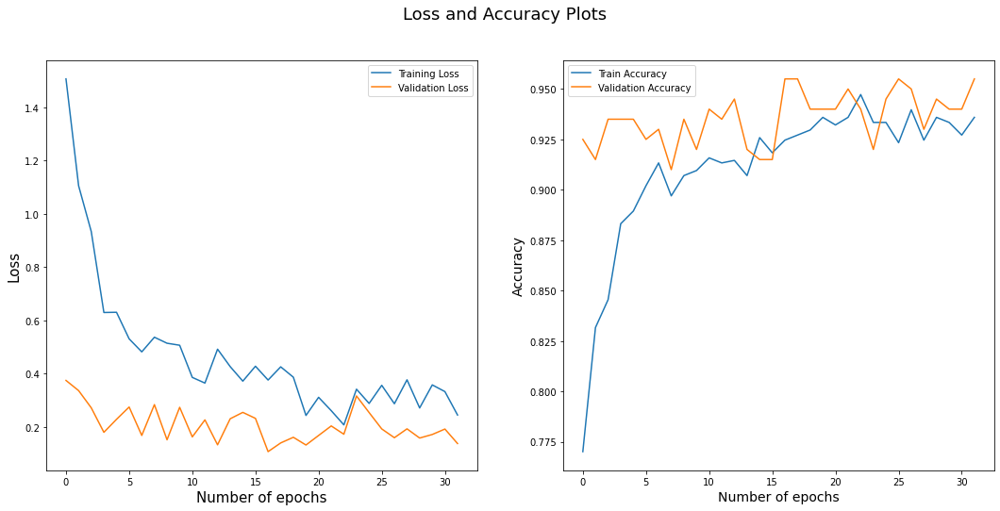

32/32 [==============================] - 1s 41ms/step
Round:  31
Test Accuracy:  0.9
Label Accuracy:  0.868
Number of catagory 1:  488.0
Number of catagory 2:  512.0
Model: "sequential_64"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_64 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epo

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 136ms/step - loss: 1.5811 - acc: 0.7788 - val_loss: 0.2859 - val_acc: 0.9350
Epoch 2/32
25/25 [==============================] - 1s 54ms/step - loss: 0.9218 - acc: 0.8550 - val_loss: 0.2677 - val_acc: 0.9300
Epoch 3/32
25/25 [==============================] - 1s 53ms/step - loss: 0.8428 - acc: 0.8625 - val_loss: 0.2236 - val_acc: 0.9300
Epoch 4/32
25/25 [==============================] - 1s 55ms/step - loss: 0.7235 - acc: 0.8712 - val_loss: 0.2031 - val_acc: 0.9500
Epoch 5/32
25/25 [==============================] - 1s 54ms/step - loss: 0.8614 - acc: 0.8712 - val_loss: 0.2939 - val_acc: 0.9100
Epoch 6/32
25/25 [==============================] - 1s 58ms/step - loss: 0.5905 - acc: 0.8925 - val_loss: 0.1358 - val_acc: 0.9550
Epoch 7/32
25/25 [==============================] - 1s 56ms/step - loss: 0.4522 - acc: 0.9075 - val_loss: 0.1627 - val_acc: 0.9400
Epoch 8/32
25/25 [==============================] - 1s 56ms/step - loss: 0.5070 - acc: 0.8875

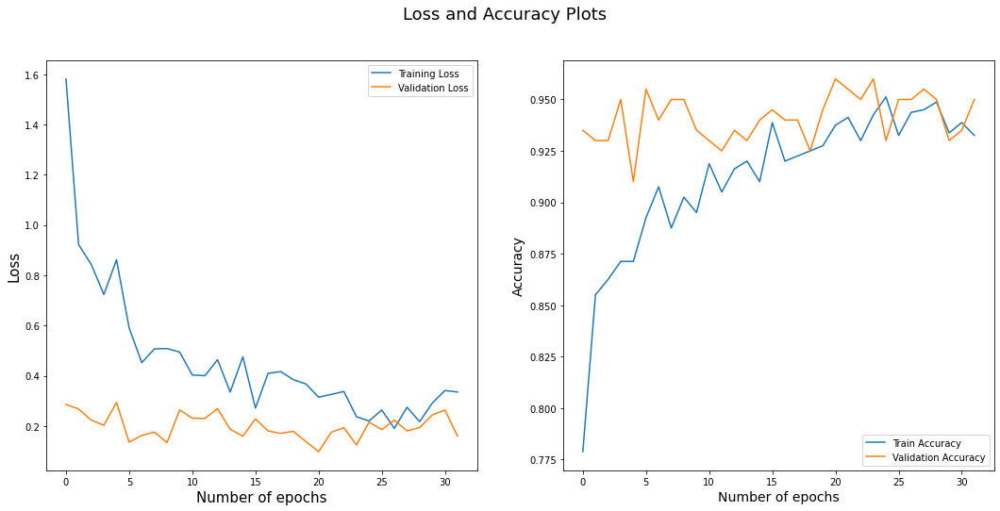

7/7 [==============================] - 2s 41ms/step
0.885


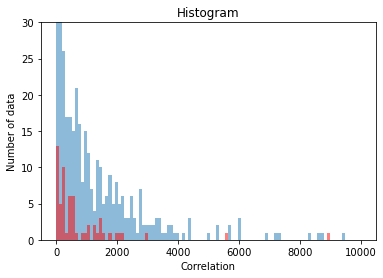

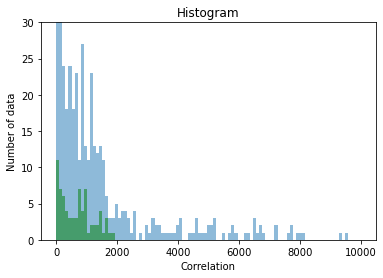

Model: "sequential_65"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_65 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 127ms/step - loss: 1.6965 - acc: 0.7626 - val_loss: 0.3682 - val_acc: 0.8950
Epoch 2/32
25/25 [==============================] - 1s 54ms/step - loss: 1.0767 - acc: 0.8405 - val_loss: 0.2225 - val_acc: 0.9400
Epoch 3/32
25/25 [==============================] - 1s 55ms/step - loss: 0.7134 - acc: 0.8643 - val_loss: 0.2506 - val_acc: 0.9350
Epoch 4/32
25/25 [==============================] - 1s 57ms/step - loss: 0.6653 - acc: 0.8668 - val_loss: 0.6332 - val_acc: 0.8850
Epoch 5/32
25/25 [==============================] - 1s 52ms/step - loss: 0.6290 - acc: 0.8643 - val_loss: 0.1202 - val_acc: 0.9650
Epoch 6/32
25/25 [==============================] - 1s 56ms/step - loss: 0.7324 - acc: 0.8781 - val_loss: 0.2359 - val_acc: 0.9350
Epoch 7/32
25/25 [==============================] - 1s 54ms/step - loss: 0.5461 - acc: 0.9020 - val_loss: 0.1132 - val_acc: 0.9600
Epoch 8/32
25/25 [==============================] - 1s 57ms/step - loss: 0.4332 - acc: 0.9058

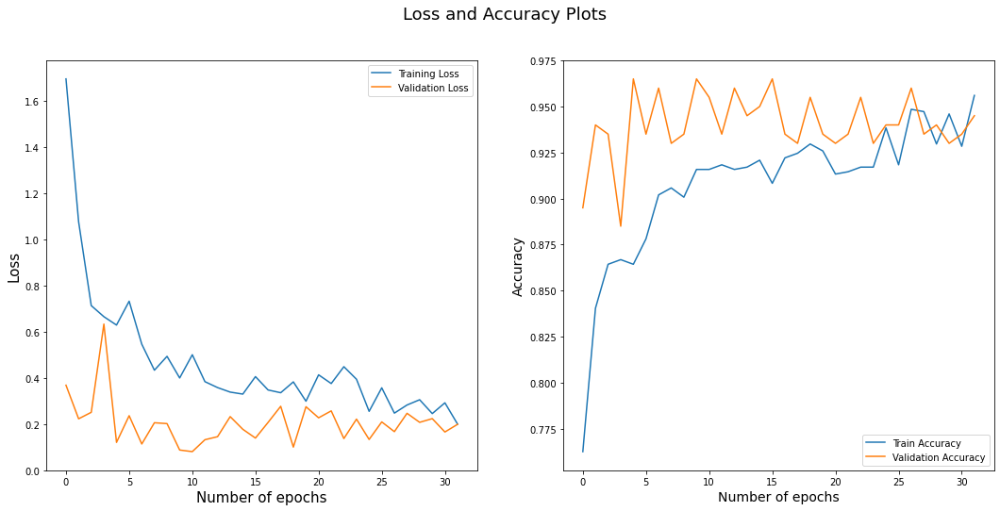

32/32 [==============================] - 1s 36ms/step
Round:  32
Test Accuracy:  0.88
Label Accuracy:  0.87
Number of catagory 1:  486.0
Number of catagory 2:  514.0
Model: "sequential_66"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_66 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epo

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 138ms/step - loss: 1.5144 - acc: 0.7800 - val_loss: 0.4709 - val_acc: 0.8750
Epoch 2/32
25/25 [==============================] - 1s 54ms/step - loss: 0.9378 - acc: 0.8425 - val_loss: 0.2138 - val_acc: 0.9200
Epoch 3/32
25/25 [==============================] - 1s 53ms/step - loss: 0.9939 - acc: 0.8487 - val_loss: 0.5012 - val_acc: 0.8850
Epoch 4/32
25/25 [==============================] - 1s 54ms/step - loss: 0.5872 - acc: 0.8925 - val_loss: 0.1674 - val_acc: 0.9400
Epoch 5/32
25/25 [==============================] - 1s 50ms/step - loss: 0.6920 - acc: 0.8775 - val_loss: 0.3979 - val_acc: 0.9100
Epoch 6/32
25/25 [==============================] - 1s 51ms/step - loss: 0.6628 - acc: 0.8838 - val_loss: 0.1121 - val_acc: 0.9500
Epoch 7/32
25/25 [==============================] - 1s 53ms/step - loss: 0.6019 - acc: 0.8950 - val_loss: 0.1548 - val_acc: 0.9500
Epoch 8/32
25/25 [==============================] - 1s 54ms/step - loss: 0.5865 - acc: 0.8838

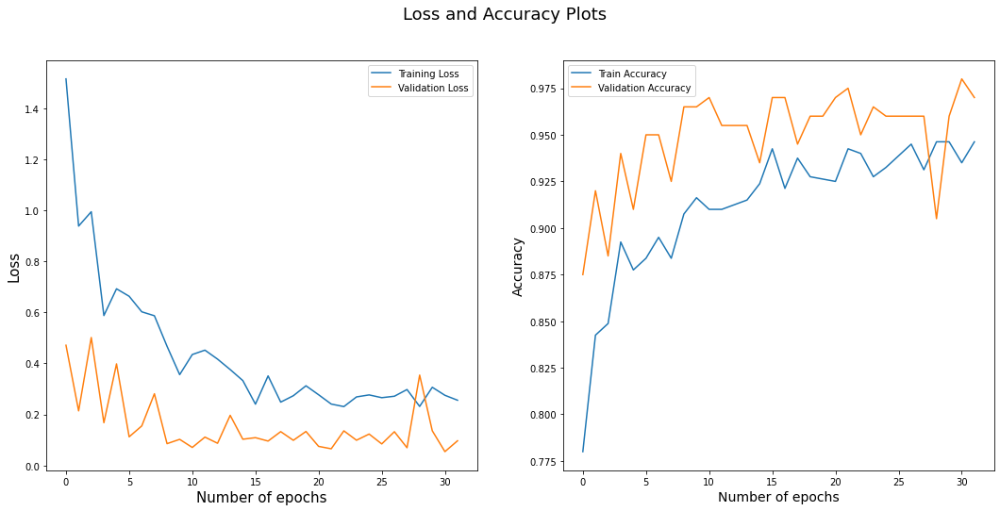

7/7 [==============================] - 2s 42ms/step
0.88


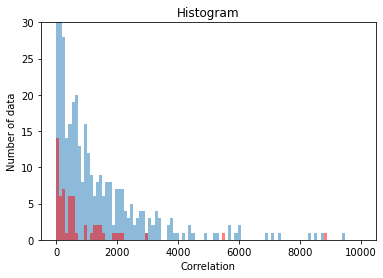

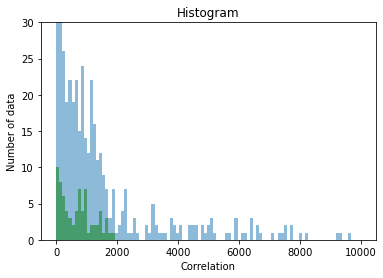

Model: "sequential_67"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_67 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 124ms/step - loss: 1.2517 - acc: 0.7626 - val_loss: 0.3855 - val_acc: 0.9000
Epoch 2/32
25/25 [==============================] - 1s 53ms/step - loss: 0.9619 - acc: 0.8291 - val_loss: 0.2616 - val_acc: 0.9150
Epoch 3/32
25/25 [==============================] - 1s 50ms/step - loss: 0.8281 - acc: 0.8467 - val_loss: 0.2423 - val_acc: 0.9100
Epoch 4/32
25/25 [==============================] - 1s 54ms/step - loss: 0.7687 - acc: 0.8832 - val_loss: 0.1864 - val_acc: 0.9250
Epoch 5/32
25/25 [==============================] - 1s 53ms/step - loss: 0.5943 - acc: 0.8807 - val_loss: 0.1191 - val_acc: 0.9500
Epoch 6/32
25/25 [==============================] - 1s 53ms/step - loss: 0.5380 - acc: 0.8894 - val_loss: 0.1494 - val_acc: 0.9400
Epoch 7/32
25/25 [==============================] - 1s 53ms/step - loss: 0.4507 - acc: 0.9020 - val_loss: 0.2778 - val_acc: 0.9250
Epoch 8/32
25/25 [==============================] - 1s 52ms/step - loss: 0.4872 - acc: 0.9033

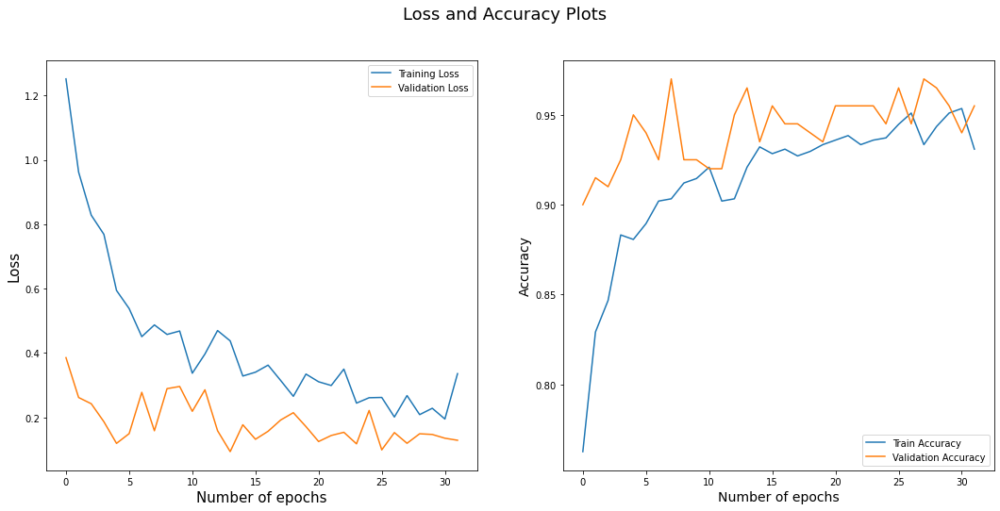

32/32 [==============================] - 1s 36ms/step
Round:  33
Test Accuracy:  0.89
Label Accuracy:  0.87
Number of catagory 1:  488.0
Number of catagory 2:  512.0
Model: "sequential_68"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_68 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epo

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 135ms/step - loss: 1.2555 - acc: 0.8062 - val_loss: 0.3148 - val_acc: 0.9150
Epoch 2/32
25/25 [==============================] - 1s 53ms/step - loss: 1.0456 - acc: 0.8487 - val_loss: 0.3944 - val_acc: 0.9050
Epoch 3/32
25/25 [==============================] - 1s 55ms/step - loss: 0.8074 - acc: 0.8562 - val_loss: 0.3090 - val_acc: 0.9100
Epoch 4/32
25/25 [==============================] - 1s 59ms/step - loss: 0.6694 - acc: 0.8788 - val_loss: 0.2320 - val_acc: 0.9350
Epoch 5/32
25/25 [==============================] - 1s 60ms/step - loss: 0.7157 - acc: 0.8825 - val_loss: 0.2605 - val_acc: 0.9400
Epoch 6/32
25/25 [==============================] - 2s 61ms/step - loss: 0.5582 - acc: 0.8975 - val_loss: 0.2065 - val_acc: 0.9500
Epoch 7/32
25/25 [==============================] - 1s 60ms/step - loss: 0.4719 - acc: 0.8963 - val_loss: 0.2107 - val_acc: 0.9300
Epoch 8/32
25/25 [==============================] - 1s 55ms/step - loss: 0.4162 - acc: 0.9062

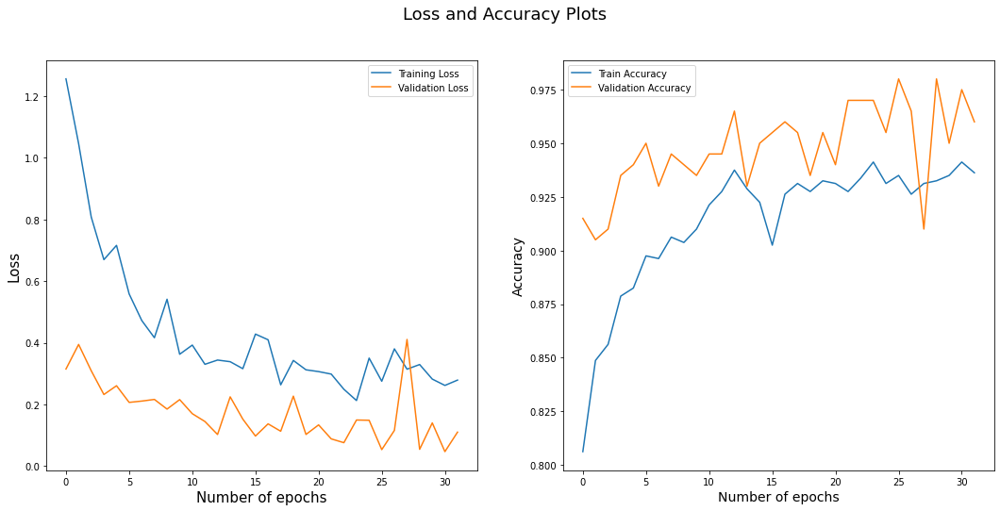

7/7 [==============================] - 2s 38ms/step
0.905


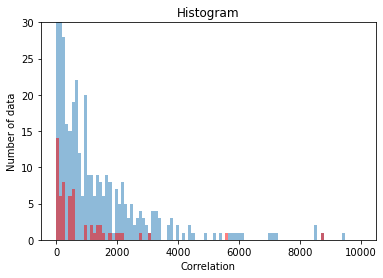

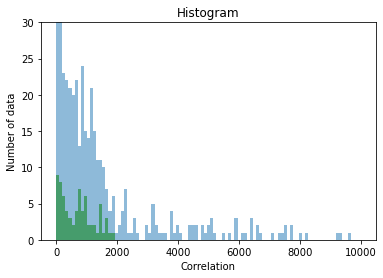

Model: "sequential_69"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_69 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 126ms/step - loss: 1.7687 - acc: 0.7764 - val_loss: 0.5616 - val_acc: 0.8950
Epoch 2/32
25/25 [==============================] - 1s 54ms/step - loss: 1.1141 - acc: 0.8379 - val_loss: 0.2579 - val_acc: 0.9150
Epoch 3/32
25/25 [==============================] - 1s 57ms/step - loss: 0.8646 - acc: 0.8656 - val_loss: 0.4862 - val_acc: 0.8600
Epoch 4/32
25/25 [==============================] - 1s 54ms/step - loss: 0.7285 - acc: 0.8618 - val_loss: 0.3041 - val_acc: 0.9100
Epoch 5/32
25/25 [==============================] - 1s 56ms/step - loss: 0.7089 - acc: 0.8769 - val_loss: 0.2416 - val_acc: 0.9300
Epoch 6/32
25/25 [==============================] - 1s 54ms/step - loss: 0.7237 - acc: 0.8618 - val_loss: 0.3238 - val_acc: 0.9150
Epoch 7/32
25/25 [==============================] - 1s 57ms/step - loss: 0.5458 - acc: 0.8844 - val_loss: 0.2297 - val_acc: 0.9250
Epoch 8/32
25/25 [==============================] - 1s 57ms/step - loss: 0.3409 - acc: 0.9322

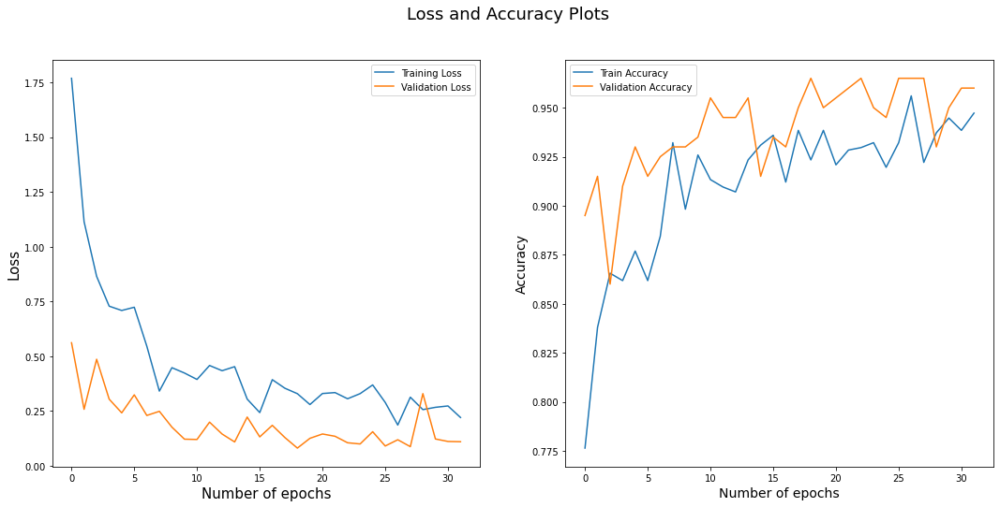

32/32 [==============================] - 1s 38ms/step
Round:  34
Test Accuracy:  0.87
Label Accuracy:  0.871
Number of catagory 1:  489.0
Number of catagory 2:  511.0
Model: "sequential_70"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_70 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Ep

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 125ms/step - loss: 1.4633 - acc: 0.7738 - val_loss: 0.4211 - val_acc: 0.8950
Epoch 2/32
25/25 [==============================] - 1s 53ms/step - loss: 0.9693 - acc: 0.8275 - val_loss: 0.2312 - val_acc: 0.9400
Epoch 3/32
25/25 [==============================] - 1s 50ms/step - loss: 0.5908 - acc: 0.8975 - val_loss: 0.3919 - val_acc: 0.9100
Epoch 4/32
25/25 [==============================] - 1s 52ms/step - loss: 0.6573 - acc: 0.8675 - val_loss: 0.2012 - val_acc: 0.9450
Epoch 5/32
25/25 [==============================] - 1s 56ms/step - loss: 0.6207 - acc: 0.8825 - val_loss: 0.1944 - val_acc: 0.9350
Epoch 6/32
25/25 [==============================] - 1s 53ms/step - loss: 0.4576 - acc: 0.9038 - val_loss: 0.1575 - val_acc: 0.9350
Epoch 7/32
25/25 [==============================] - 1s 52ms/step - loss: 0.4297 - acc: 0.9112 - val_loss: 0.1627 - val_acc: 0.9500
Epoch 8/32
25/25 [==============================] - 1s 52ms/step - loss: 0.4187 - acc: 0.9125

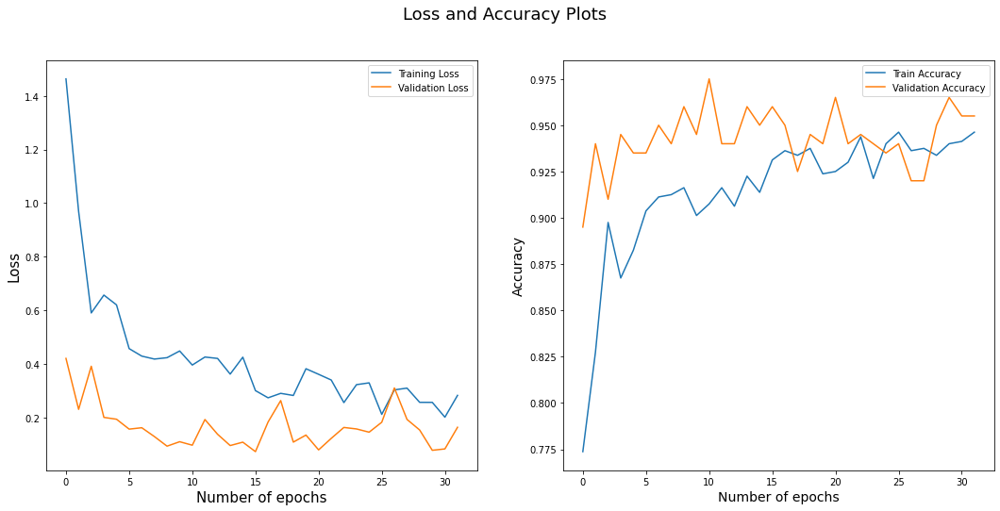

7/7 [==============================] - 2s 37ms/step
0.87


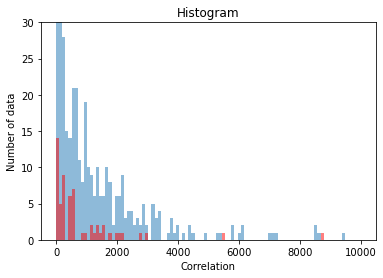

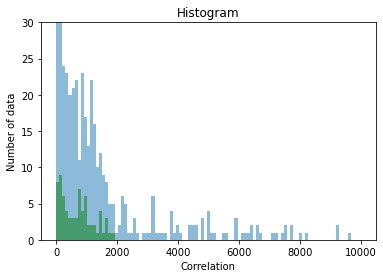

Model: "sequential_71"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_71 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 127ms/step - loss: 1.6554 - acc: 0.7688 - val_loss: 0.3278 - val_acc: 0.9350
Epoch 2/32
25/25 [==============================] - 1s 57ms/step - loss: 1.0889 - acc: 0.8354 - val_loss: 0.4188 - val_acc: 0.9050
Epoch 3/32
25/25 [==============================] - 1s 56ms/step - loss: 0.7453 - acc: 0.8555 - val_loss: 0.1462 - val_acc: 0.9500
Epoch 4/32
25/25 [==============================] - 1s 54ms/step - loss: 0.7128 - acc: 0.8807 - val_loss: 0.1810 - val_acc: 0.9450
Epoch 5/32
25/25 [==============================] - 1s 53ms/step - loss: 0.5023 - acc: 0.9045 - val_loss: 0.2492 - val_acc: 0.9450
Epoch 6/32
25/25 [==============================] - 1s 54ms/step - loss: 0.5369 - acc: 0.8982 - val_loss: 0.1797 - val_acc: 0.9400
Epoch 7/32
25/25 [==============================] - 1s 57ms/step - loss: 0.3950 - acc: 0.9108 - val_loss: 0.1550 - val_acc: 0.9600
Epoch 8/32
25/25 [==============================] - 1s 55ms/step - loss: 0.4486 - acc: 0.9108

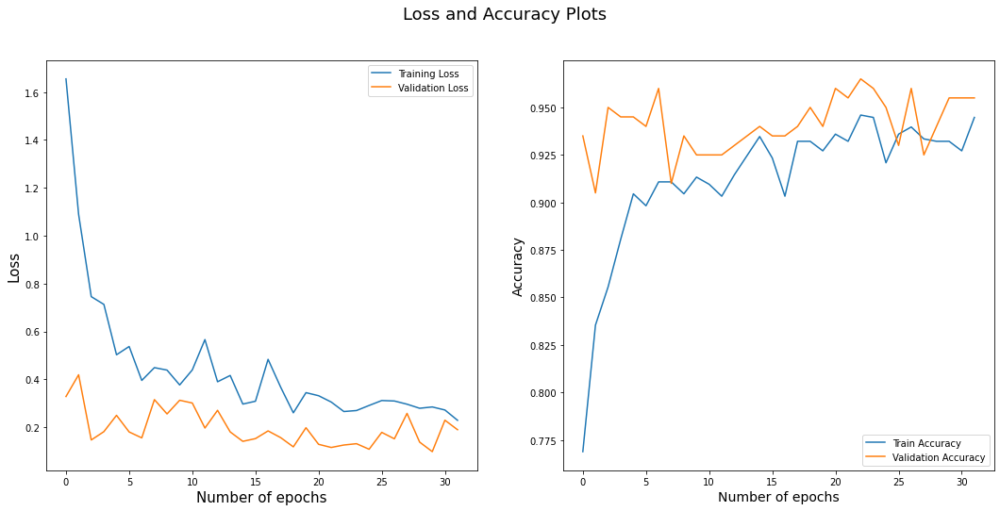

32/32 [==============================] - 1s 39ms/step
Round:  35
Test Accuracy:  0.87
Label Accuracy:  0.869
Number of catagory 1:  485.0
Number of catagory 2:  515.0
Model: "sequential_72"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_72 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Ep

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 167ms/step - loss: 1.2687 - acc: 0.7925 - val_loss: 0.2375 - val_acc: 0.9250
Epoch 2/32
25/25 [==============================] - 1s 56ms/step - loss: 0.7815 - acc: 0.8500 - val_loss: 0.3555 - val_acc: 0.9050
Epoch 3/32
25/25 [==============================] - 1s 53ms/step - loss: 0.7763 - acc: 0.8687 - val_loss: 0.1967 - val_acc: 0.9350
Epoch 4/32
25/25 [==============================] - 1s 58ms/step - loss: 0.5768 - acc: 0.8863 - val_loss: 0.2491 - val_acc: 0.9300
Epoch 5/32
25/25 [==============================] - 1s 60ms/step - loss: 0.5946 - acc: 0.8938 - val_loss: 0.1374 - val_acc: 0.9500
Epoch 6/32
25/25 [==============================] - 1s 55ms/step - loss: 0.5012 - acc: 0.8988 - val_loss: 0.2173 - val_acc: 0.9400
Epoch 7/32
25/25 [==============================] - 1s 55ms/step - loss: 0.5659 - acc: 0.8825 - val_loss: 0.1235 - val_acc: 0.9400
Epoch 8/32
25/25 [==============================] - 1s 56ms/step - loss: 0.3956 - acc: 0.9125

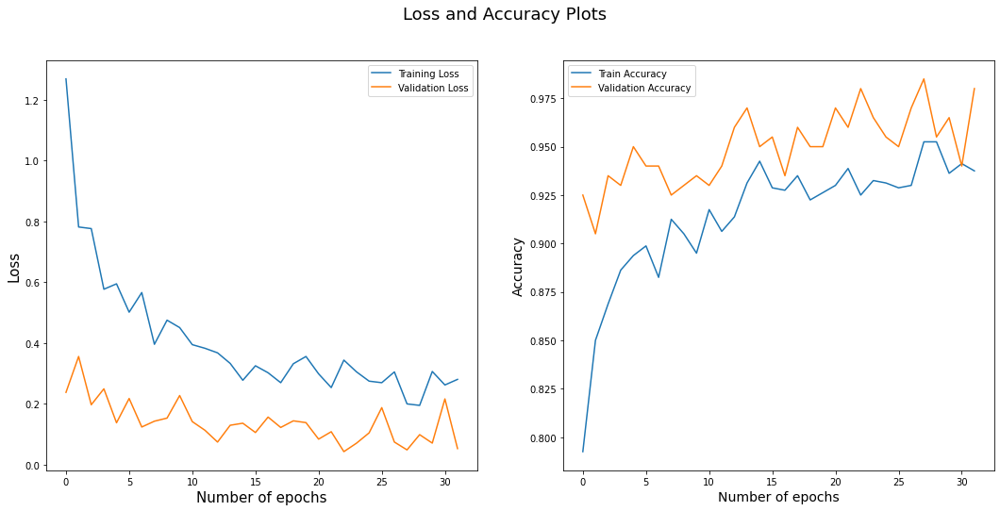

7/7 [==============================] - 2s 41ms/step
0.87


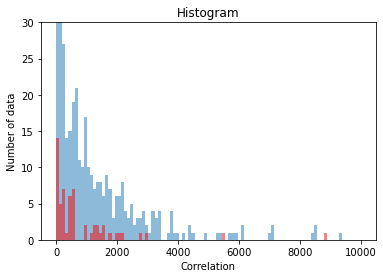

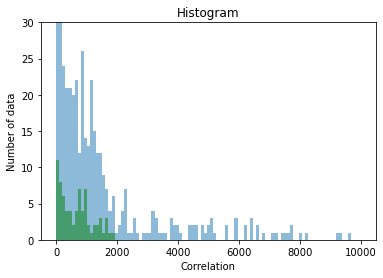

Model: "sequential_73"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_73 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 132ms/step - loss: 1.7030 - acc: 0.7714 - val_loss: 0.5368 - val_acc: 0.8650
Epoch 2/32
25/25 [==============================] - 1s 58ms/step - loss: 1.0055 - acc: 0.8518 - val_loss: 0.6272 - val_acc: 0.8700
Epoch 3/32
25/25 [==============================] - 1s 59ms/step - loss: 0.8387 - acc: 0.8606 - val_loss: 0.3275 - val_acc: 0.9000
Epoch 4/32
25/25 [==============================] - 1s 56ms/step - loss: 0.7620 - acc: 0.8555 - val_loss: 0.4750 - val_acc: 0.9150
Epoch 5/32
25/25 [==============================] - 1s 58ms/step - loss: 0.5935 - acc: 0.8844 - val_loss: 0.2697 - val_acc: 0.9150
Epoch 6/32
25/25 [==============================] - 1s 54ms/step - loss: 0.4979 - acc: 0.9033 - val_loss: 0.2930 - val_acc: 0.9200
Epoch 7/32
25/25 [==============================] - 1s 56ms/step - loss: 0.5333 - acc: 0.8844 - val_loss: 0.3885 - val_acc: 0.8950
Epoch 8/32
25/25 [==============================] - 1s 52ms/step - loss: 0.4945 - acc: 0.9058

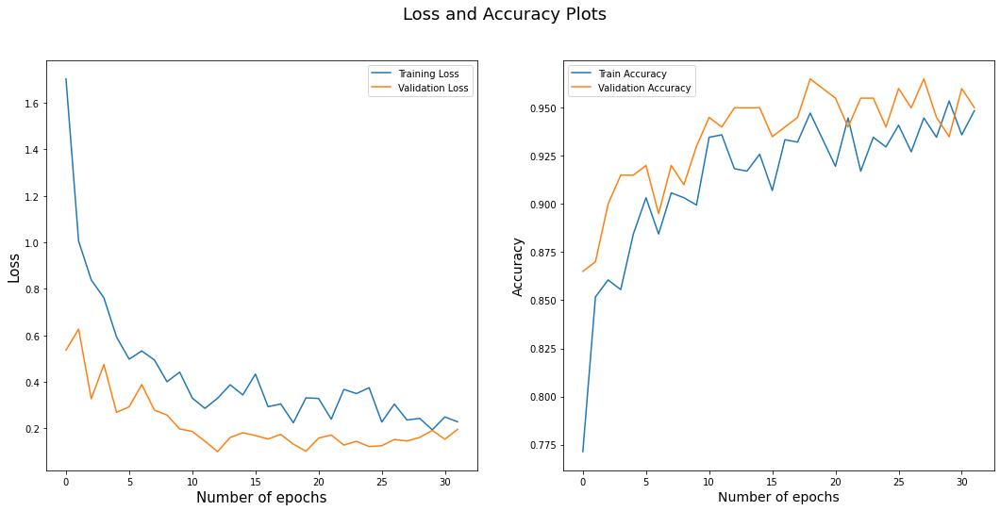

32/32 [==============================] - 1s 30ms/step
Round:  36
Test Accuracy:  0.865
Label Accuracy:  0.872
Number of catagory 1:  490.0
Number of catagory 2:  510.0
Model: "sequential_74"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_74 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
E

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 127ms/step - loss: 1.4083 - acc: 0.7812 - val_loss: 0.2462 - val_acc: 0.9200
Epoch 2/32
25/25 [==============================] - 1s 54ms/step - loss: 0.9420 - acc: 0.8425 - val_loss: 0.1609 - val_acc: 0.9500
Epoch 3/32
25/25 [==============================] - 1s 53ms/step - loss: 0.7779 - acc: 0.8737 - val_loss: 0.4151 - val_acc: 0.9250
Epoch 4/32
25/25 [==============================] - 1s 52ms/step - loss: 0.6949 - acc: 0.8925 - val_loss: 0.3068 - val_acc: 0.9350
Epoch 5/32
25/25 [==============================] - 1s 52ms/step - loss: 0.6096 - acc: 0.8950 - val_loss: 0.1657 - val_acc: 0.9450
Epoch 6/32
25/25 [==============================] - 1s 50ms/step - loss: 0.4352 - acc: 0.9125 - val_loss: 0.1935 - val_acc: 0.9450
Epoch 7/32
25/25 [==============================] - 1s 52ms/step - loss: 0.4208 - acc: 0.9125 - val_loss: 0.5061 - val_acc: 0.8950
Epoch 8/32
25/25 [==============================] - 1s 50ms/step - loss: 0.4024 - acc: 0.9125

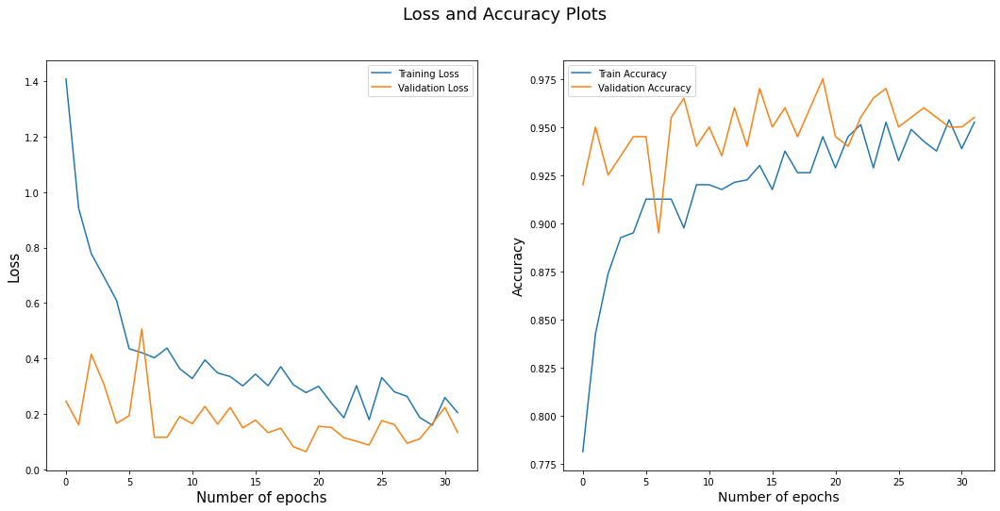

7/7 [==============================] - 2s 40ms/step
0.845


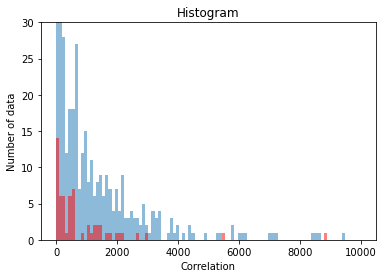

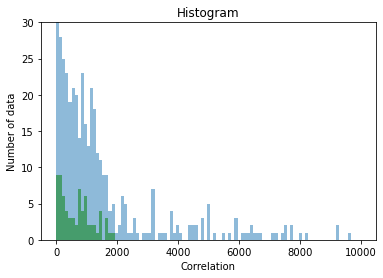

Model: "sequential_75"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_75 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 138ms/step - loss: 1.6741 - acc: 0.7714 - val_loss: 0.5317 - val_acc: 0.9100
Epoch 2/32
25/25 [==============================] - 1s 56ms/step - loss: 1.0082 - acc: 0.8379 - val_loss: 0.2004 - val_acc: 0.9350
Epoch 3/32
25/25 [==============================] - 1s 57ms/step - loss: 0.7890 - acc: 0.8580 - val_loss: 0.4263 - val_acc: 0.9100
Epoch 4/32
25/25 [==============================] - 1s 54ms/step - loss: 0.7069 - acc: 0.8744 - val_loss: 0.1996 - val_acc: 0.9150
Epoch 5/32
25/25 [==============================] - 1s 58ms/step - loss: 0.5282 - acc: 0.8882 - val_loss: 0.1997 - val_acc: 0.9300
Epoch 6/32
25/25 [==============================] - 1s 53ms/step - loss: 0.4693 - acc: 0.8957 - val_loss: 0.1111 - val_acc: 0.9600
Epoch 7/32
25/25 [==============================] - 1s 55ms/step - loss: 0.5038 - acc: 0.9045 - val_loss: 0.1076 - val_acc: 0.9500
Epoch 8/32
25/25 [==============================] - 1s 59ms/step - loss: 0.4326 - acc: 0.9196

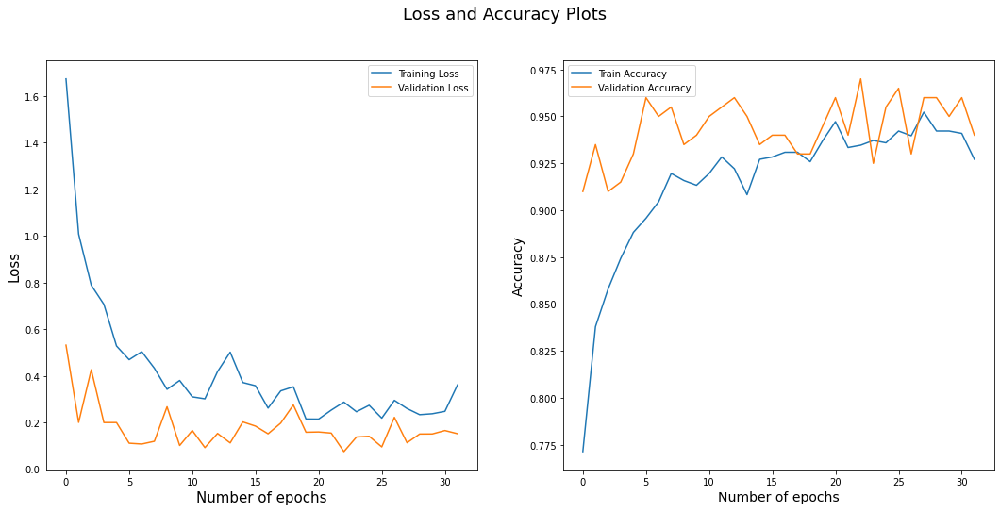

32/32 [==============================] - 1s 38ms/step
Round:  37
Test Accuracy:  0.86
Label Accuracy:  0.87
Number of catagory 1:  494.0
Number of catagory 2:  506.0
Model: "sequential_76"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_76 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epo

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 127ms/step - loss: 1.2683 - acc: 0.8025 - val_loss: 0.4904 - val_acc: 0.8950
Epoch 2/32
25/25 [==============================] - 1s 56ms/step - loss: 0.9905 - acc: 0.8537 - val_loss: 0.3195 - val_acc: 0.9200
Epoch 3/32
25/25 [==============================] - 1s 58ms/step - loss: 0.7437 - acc: 0.8637 - val_loss: 0.2737 - val_acc: 0.9300
Epoch 4/32
25/25 [==============================] - 1s 58ms/step - loss: 0.5894 - acc: 0.8875 - val_loss: 0.4496 - val_acc: 0.9100
Epoch 5/32
25/25 [==============================] - 1s 57ms/step - loss: 0.4820 - acc: 0.9013 - val_loss: 0.2939 - val_acc: 0.9300
Epoch 6/32
25/25 [==============================] - 1s 57ms/step - loss: 0.4876 - acc: 0.9062 - val_loss: 0.2992 - val_acc: 0.9300
Epoch 7/32
25/25 [==============================] - 1s 57ms/step - loss: 0.5414 - acc: 0.8775 - val_loss: 0.2284 - val_acc: 0.9350
Epoch 8/32
25/25 [==============================] - 1s 57ms/step - loss: 0.4559 - acc: 0.9087

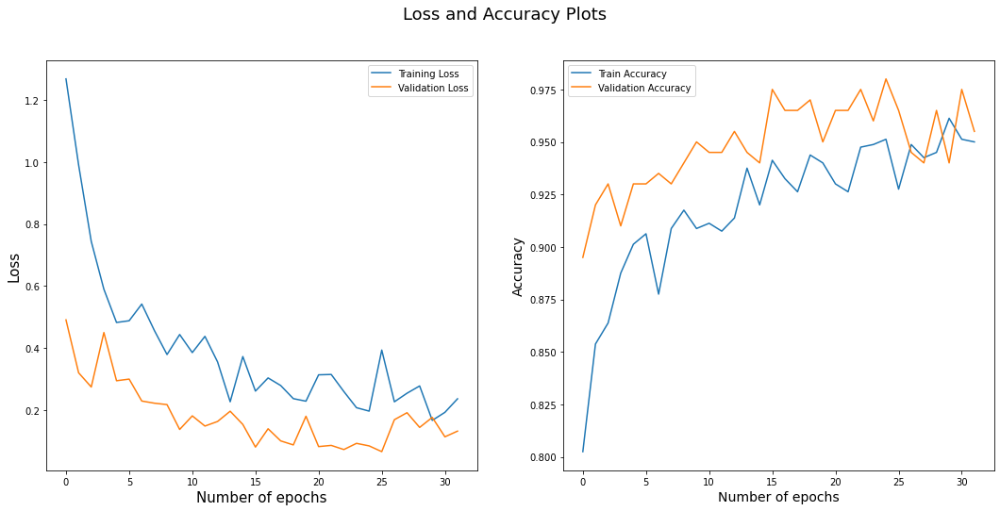

7/7 [==============================] - 2s 40ms/step
0.875


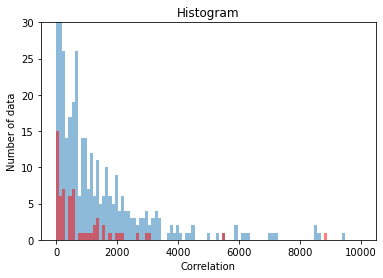

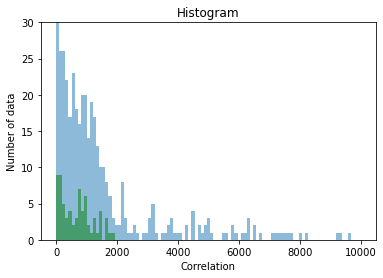

Model: "sequential_77"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_77 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 124ms/step - loss: 1.2212 - acc: 0.7952 - val_loss: 0.3763 - val_acc: 0.9300
Epoch 2/32
25/25 [==============================] - 1s 54ms/step - loss: 1.0931 - acc: 0.8455 - val_loss: 0.4250 - val_acc: 0.9100
Epoch 3/32
25/25 [==============================] - 1s 53ms/step - loss: 0.7960 - acc: 0.8756 - val_loss: 0.2944 - val_acc: 0.9250
Epoch 4/32
25/25 [==============================] - 1s 58ms/step - loss: 0.7533 - acc: 0.8668 - val_loss: 0.2497 - val_acc: 0.9250
Epoch 5/32
25/25 [==============================] - 1s 56ms/step - loss: 0.6080 - acc: 0.8957 - val_loss: 0.4318 - val_acc: 0.8850
Epoch 6/32
25/25 [==============================] - 1s 55ms/step - loss: 0.4248 - acc: 0.9045 - val_loss: 0.4888 - val_acc: 0.8950
Epoch 7/32
25/25 [==============================] - 1s 57ms/step - loss: 0.5052 - acc: 0.8970 - val_loss: 0.1444 - val_acc: 0.9500
Epoch 8/32
25/25 [==============================] - 1s 55ms/step - loss: 0.3740 - acc: 0.9296

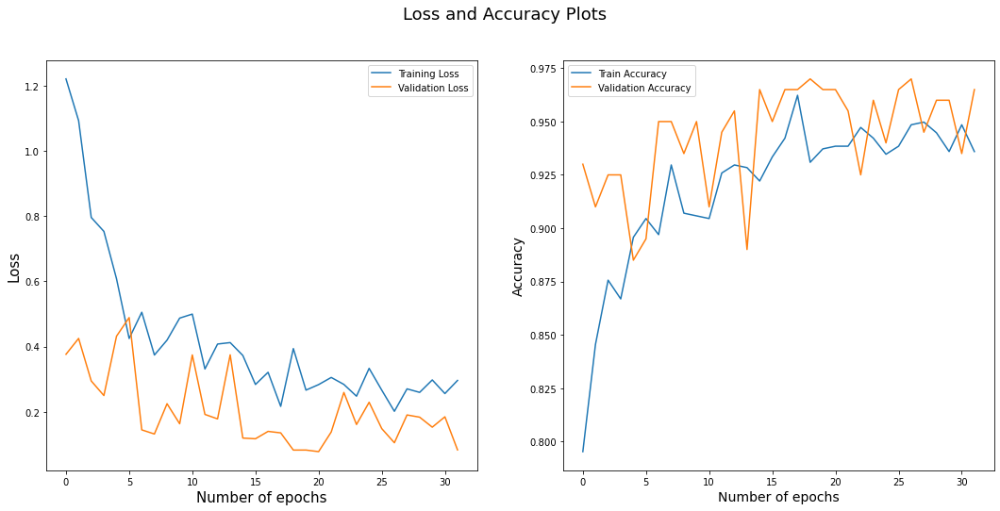

32/32 [==============================] - 1s 37ms/step
Round:  38
Test Accuracy:  0.88
Label Accuracy:  0.87
Number of catagory 1:  494.0
Number of catagory 2:  506.0
Model: "sequential_78"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_78 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epo

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 141ms/step - loss: 1.3658 - acc: 0.7975 - val_loss: 0.4544 - val_acc: 0.8950
Epoch 2/32
25/25 [==============================] - 1s 57ms/step - loss: 1.1599 - acc: 0.8450 - val_loss: 0.2374 - val_acc: 0.9200
Epoch 3/32
25/25 [==============================] - 1s 54ms/step - loss: 0.6616 - acc: 0.8763 - val_loss: 0.1994 - val_acc: 0.9450
Epoch 4/32
25/25 [==============================] - 1s 56ms/step - loss: 0.8891 - acc: 0.8687 - val_loss: 0.1373 - val_acc: 0.9450
Epoch 5/32
25/25 [==============================] - 1s 55ms/step - loss: 0.6073 - acc: 0.8875 - val_loss: 0.2386 - val_acc: 0.9250
Epoch 6/32
25/25 [==============================] - 1s 54ms/step - loss: 0.4393 - acc: 0.9000 - val_loss: 0.1355 - val_acc: 0.9650
Epoch 7/32
25/25 [==============================] - 1s 53ms/step - loss: 0.4665 - acc: 0.9038 - val_loss: 0.3408 - val_acc: 0.8850
Epoch 8/32
25/25 [==============================] - 1s 54ms/step - loss: 0.4687 - acc: 0.9050

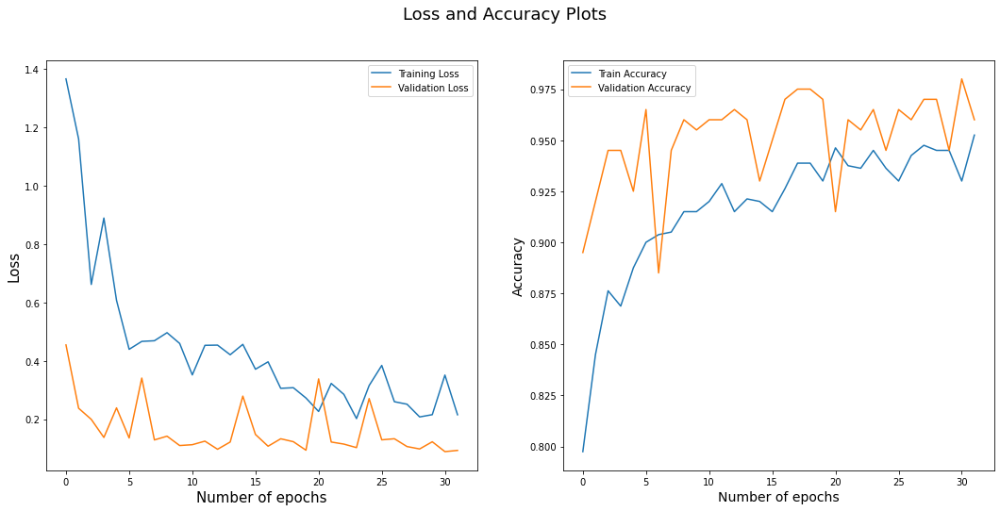

7/7 [==============================] - 2s 38ms/step
0.875


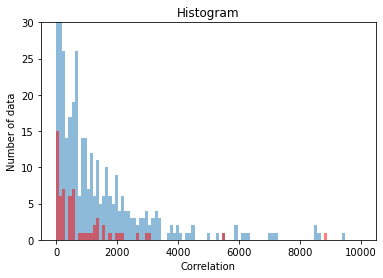

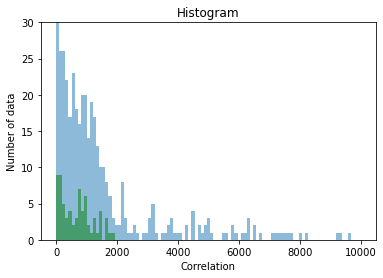

Model: "sequential_79"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_79 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 134ms/step - loss: 1.5256 - acc: 0.7889 - val_loss: 0.5321 - val_acc: 0.8800
Epoch 2/32
25/25 [==============================] - 1s 55ms/step - loss: 0.8499 - acc: 0.8505 - val_loss: 0.2434 - val_acc: 0.9300
Epoch 3/32
25/25 [==============================] - 1s 56ms/step - loss: 0.8192 - acc: 0.8505 - val_loss: 0.2649 - val_acc: 0.9150
Epoch 4/32
25/25 [==============================] - 1s 56ms/step - loss: 0.7125 - acc: 0.8882 - val_loss: 0.2319 - val_acc: 0.9300
Epoch 5/32
25/25 [==============================] - 1s 57ms/step - loss: 0.4717 - acc: 0.8832 - val_loss: 0.2555 - val_acc: 0.9000
Epoch 6/32
25/25 [==============================] - 1s 55ms/step - loss: 0.6123 - acc: 0.8945 - val_loss: 0.1170 - val_acc: 0.9450
Epoch 7/32
25/25 [==============================] - 1s 59ms/step - loss: 0.3576 - acc: 0.9309 - val_loss: 0.1528 - val_acc: 0.9350
Epoch 8/32
25/25 [==============================] - 1s 59ms/step - loss: 0.4051 - acc: 0.9158

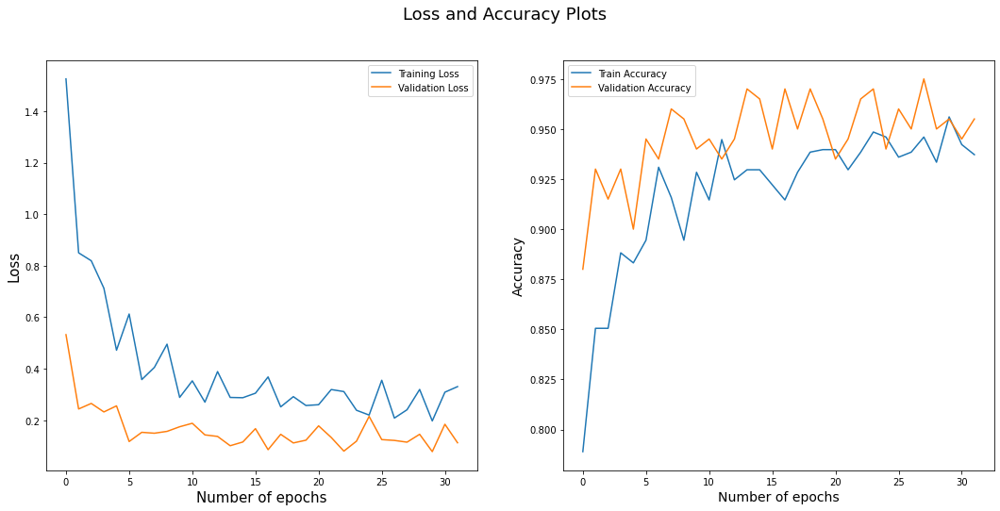

32/32 [==============================] - 1s 41ms/step
Round:  39
Test Accuracy:  0.865
Label Accuracy:  0.869
Number of catagory 1:  495.0
Number of catagory 2:  505.0
Model: "sequential_80"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_80 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
E

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 135ms/step - loss: 1.3437 - acc: 0.7663 - val_loss: 0.4843 - val_acc: 0.8750
Epoch 2/32
25/25 [==============================] - 1s 54ms/step - loss: 0.8928 - acc: 0.8537 - val_loss: 0.4663 - val_acc: 0.9050
Epoch 3/32
25/25 [==============================] - 1s 51ms/step - loss: 0.7304 - acc: 0.8725 - val_loss: 0.3696 - val_acc: 0.9250
Epoch 4/32
25/25 [==============================] - 1s 56ms/step - loss: 0.5715 - acc: 0.8712 - val_loss: 0.2024 - val_acc: 0.9350
Epoch 5/32
25/25 [==============================] - 1s 56ms/step - loss: 0.6709 - acc: 0.8838 - val_loss: 0.5214 - val_acc: 0.8800
Epoch 6/32
25/25 [==============================] - 1s 56ms/step - loss: 0.5877 - acc: 0.8838 - val_loss: 0.1591 - val_acc: 0.9400
Epoch 7/32
25/25 [==============================] - 1s 52ms/step - loss: 0.4264 - acc: 0.9212 - val_loss: 0.2089 - val_acc: 0.9500
Epoch 8/32
25/25 [==============================] - 1s 53ms/step - loss: 0.4037 - acc: 0.9287

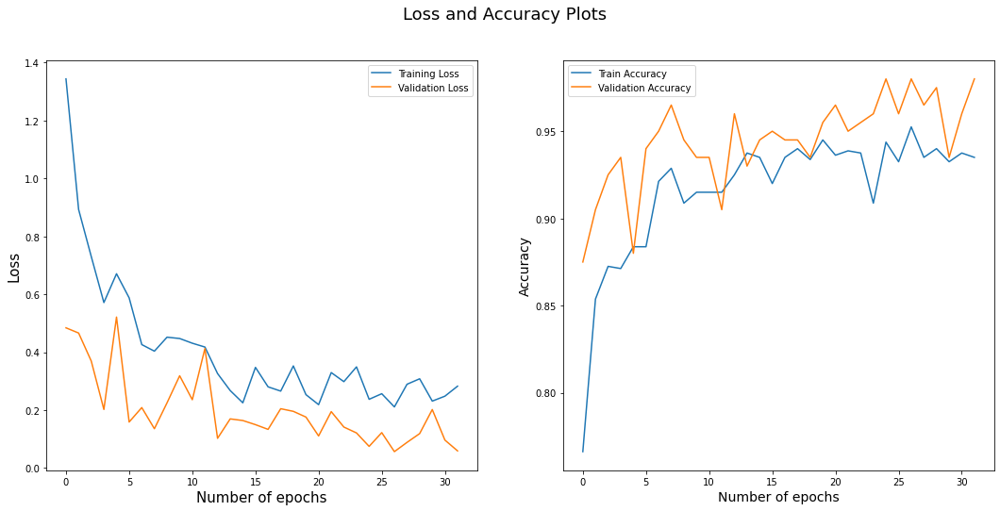

7/7 [==============================] - 2s 40ms/step
0.865


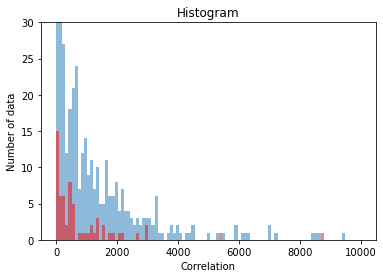

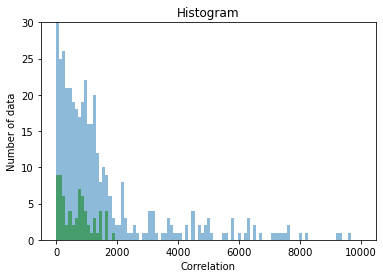

Model: "sequential_81"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_81 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 123ms/step - loss: 1.5506 - acc: 0.7764 - val_loss: 0.5784 - val_acc: 0.9050
Epoch 2/32
25/25 [==============================] - 1s 54ms/step - loss: 1.0335 - acc: 0.8455 - val_loss: 0.5316 - val_acc: 0.8850
Epoch 3/32
25/25 [==============================] - 1s 53ms/step - loss: 0.8978 - acc: 0.8681 - val_loss: 0.3694 - val_acc: 0.8900
Epoch 4/32
25/25 [==============================] - 1s 55ms/step - loss: 0.4888 - acc: 0.9033 - val_loss: 0.2563 - val_acc: 0.9300
Epoch 5/32
25/25 [==============================] - 1s 55ms/step - loss: 0.7784 - acc: 0.8769 - val_loss: 0.1526 - val_acc: 0.9500
Epoch 6/32
25/25 [==============================] - 1s 56ms/step - loss: 0.6281 - acc: 0.8832 - val_loss: 0.2623 - val_acc: 0.9300
Epoch 7/32
25/25 [==============================] - 1s 54ms/step - loss: 0.5915 - acc: 0.8982 - val_loss: 0.2577 - val_acc: 0.8950
Epoch 8/32
25/25 [==============================] - 1s 53ms/step - loss: 0.4572 - acc: 0.9121

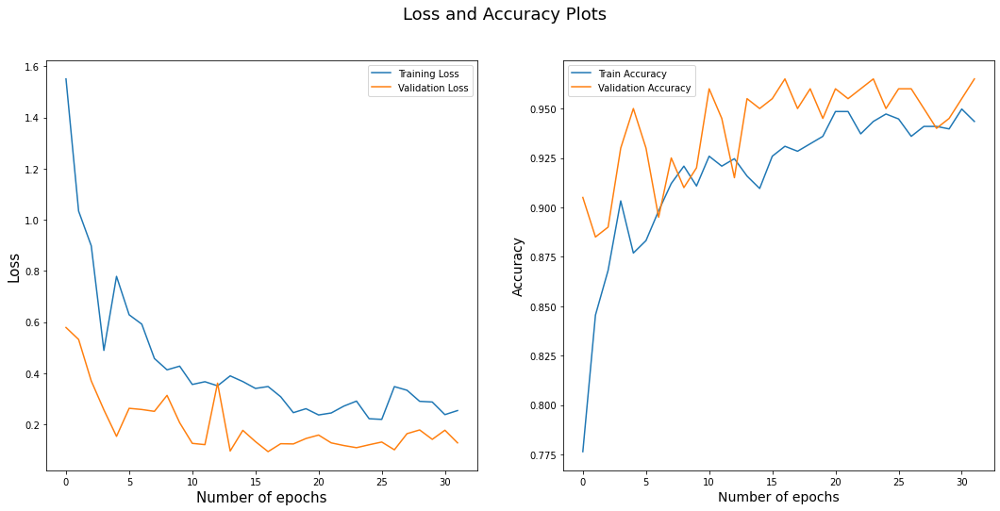

32/32 [==============================] - 1s 36ms/step
Round:  40
Test Accuracy:  0.87
Label Accuracy:  0.87
Number of catagory 1:  496.0
Number of catagory 2:  504.0
Model: "sequential_82"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_82 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epo

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 127ms/step - loss: 1.6255 - acc: 0.7837 - val_loss: 0.3747 - val_acc: 0.9450
Epoch 2/32
25/25 [==============================] - 1s 56ms/step - loss: 0.8757 - acc: 0.8650 - val_loss: 0.3816 - val_acc: 0.9100
Epoch 3/32
25/25 [==============================] - 1s 58ms/step - loss: 0.8420 - acc: 0.8650 - val_loss: 0.2351 - val_acc: 0.9300
Epoch 4/32
25/25 [==============================] - 1s 55ms/step - loss: 0.7190 - acc: 0.8863 - val_loss: 0.1425 - val_acc: 0.9600
Epoch 5/32
25/25 [==============================] - 1s 57ms/step - loss: 0.5682 - acc: 0.8838 - val_loss: 0.0946 - val_acc: 0.9450
Epoch 6/32
25/25 [==============================] - 1s 56ms/step - loss: 0.4697 - acc: 0.9038 - val_loss: 0.1530 - val_acc: 0.9500
Epoch 7/32
25/25 [==============================] - 1s 55ms/step - loss: 0.3975 - acc: 0.9200 - val_loss: 0.1353 - val_acc: 0.9350
Epoch 8/32
25/25 [==============================] - 1s 57ms/step - loss: 0.4512 - acc: 0.9050

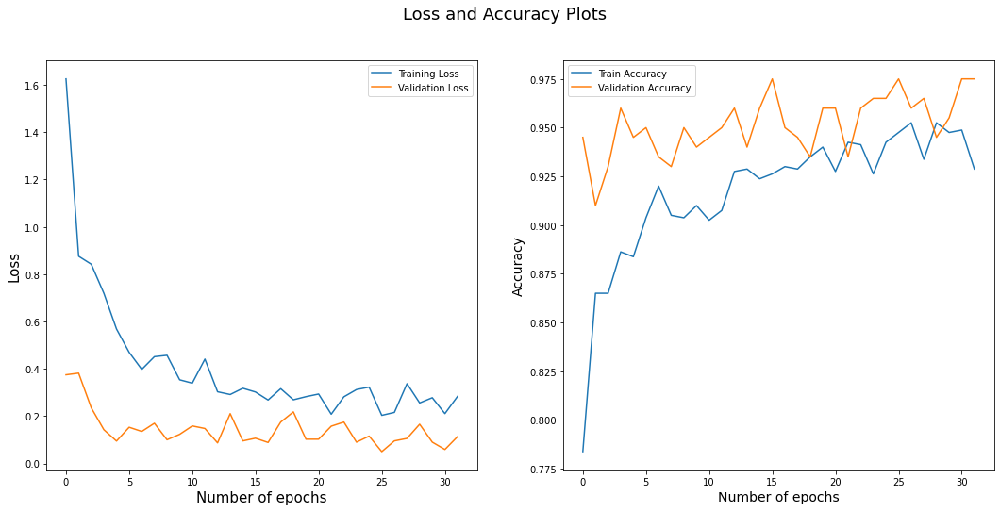

7/7 [==============================] - 2s 41ms/step
0.885


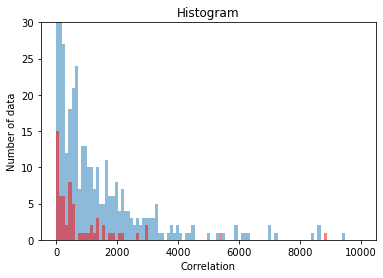

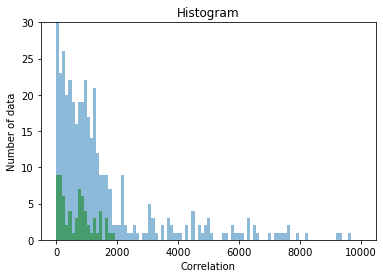

Model: "sequential_83"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_83 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 128ms/step - loss: 1.3619 - acc: 0.7852 - val_loss: 0.2323 - val_acc: 0.9300
Epoch 2/32
25/25 [==============================] - 1s 55ms/step - loss: 1.0039 - acc: 0.8430 - val_loss: 0.2622 - val_acc: 0.9100
Epoch 3/32
25/25 [==============================] - 1s 56ms/step - loss: 0.6593 - acc: 0.8668 - val_loss: 0.2125 - val_acc: 0.9350
Epoch 4/32
25/25 [==============================] - 1s 54ms/step - loss: 0.5424 - acc: 0.8832 - val_loss: 0.2847 - val_acc: 0.9050
Epoch 5/32
25/25 [==============================] - 1s 56ms/step - loss: 0.6153 - acc: 0.8995 - val_loss: 0.2896 - val_acc: 0.9300
Epoch 6/32
25/25 [==============================] - 1s 54ms/step - loss: 0.5643 - acc: 0.8907 - val_loss: 0.2696 - val_acc: 0.9250
Epoch 7/32
25/25 [==============================] - 1s 57ms/step - loss: 0.5384 - acc: 0.8982 - val_loss: 0.3205 - val_acc: 0.9250
Epoch 8/32
25/25 [==============================] - 1s 54ms/step - loss: 0.4665 - acc: 0.9095

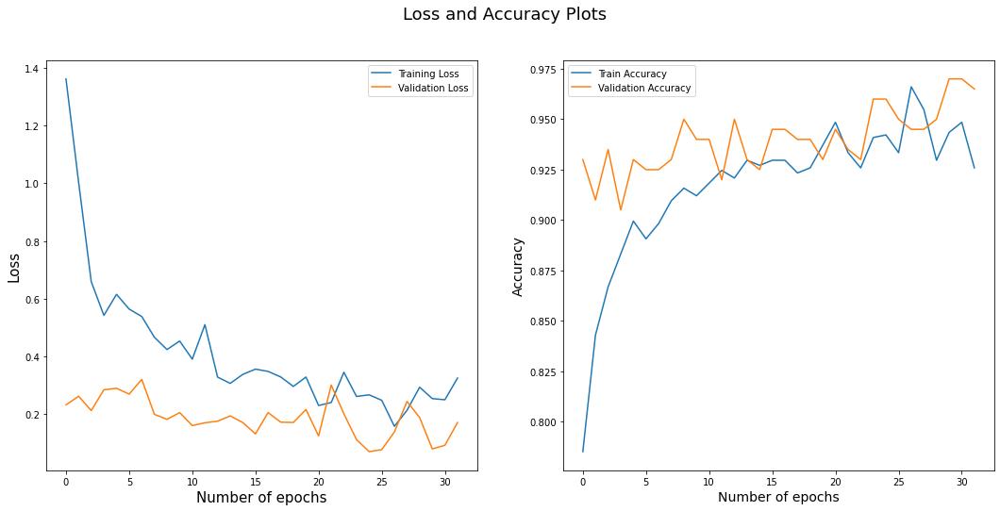

32/32 [==============================] - 1s 39ms/step
Round:  41
Test Accuracy:  0.855
Label Accuracy:  0.869
Number of catagory 1:  493.0
Number of catagory 2:  507.0
Model: "sequential_84"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_84 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
E

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 7s 134ms/step - loss: 1.4667 - acc: 0.7775 - val_loss: 0.3434 - val_acc: 0.8950
Epoch 2/32
25/25 [==============================] - 1s 56ms/step - loss: 0.9029 - acc: 0.8512 - val_loss: 0.1662 - val_acc: 0.9250
Epoch 3/32
25/25 [==============================] - 1s 52ms/step - loss: 0.7252 - acc: 0.8925 - val_loss: 0.2597 - val_acc: 0.9250
Epoch 4/32
25/25 [==============================] - 1s 53ms/step - loss: 0.6633 - acc: 0.8650 - val_loss: 0.2789 - val_acc: 0.9350
Epoch 5/32
25/25 [==============================] - 1s 55ms/step - loss: 0.6295 - acc: 0.8800 - val_loss: 0.2356 - val_acc: 0.9100
Epoch 6/32
25/25 [==============================] - 1s 53ms/step - loss: 0.4573 - acc: 0.9112 - val_loss: 0.2659 - val_acc: 0.9200
Epoch 7/32
25/25 [==============================] - 1s 54ms/step - loss: 0.5463 - acc: 0.9025 - val_loss: 0.2801 - val_acc: 0.9000
Epoch 8/32
25/25 [==============================] - 1s 55ms/step - loss: 0.5734 - acc: 0.9112

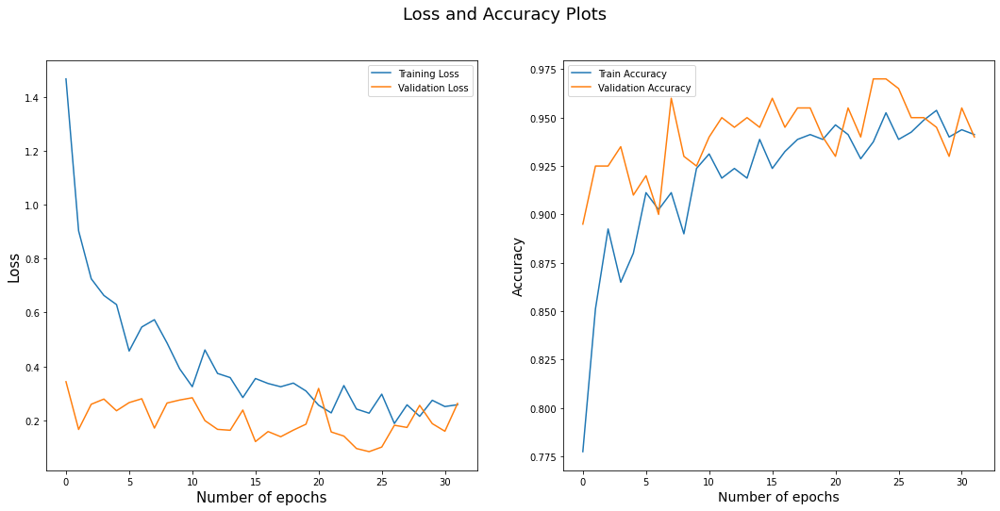

7/7 [==============================] - 2s 37ms/step
0.89


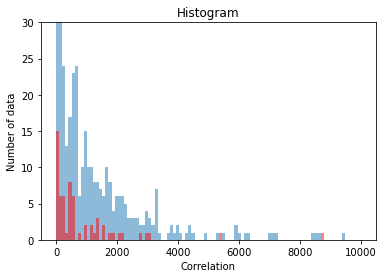

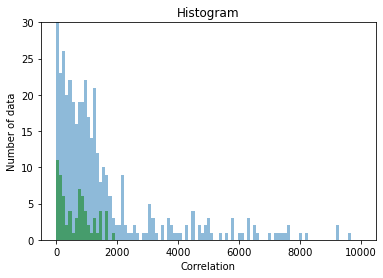

Model: "sequential_85"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_85 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 126ms/step - loss: 1.5501 - acc: 0.7751 - val_loss: 0.4622 - val_acc: 0.9100
Epoch 2/32
25/25 [==============================] - 1s 50ms/step - loss: 0.9054 - acc: 0.8631 - val_loss: 0.2248 - val_acc: 0.9250
Epoch 3/32
25/25 [==============================] - 1s 54ms/step - loss: 0.7663 - acc: 0.8756 - val_loss: 0.2190 - val_acc: 0.9100
Epoch 4/32
25/25 [==============================] - 1s 53ms/step - loss: 0.6250 - acc: 0.8706 - val_loss: 0.3796 - val_acc: 0.9000
Epoch 5/32
25/25 [==============================] - 1s 55ms/step - loss: 0.5244 - acc: 0.8970 - val_loss: 0.1813 - val_acc: 0.9300
Epoch 6/32
25/25 [==============================] - 1s 55ms/step - loss: 0.5489 - acc: 0.9020 - val_loss: 0.1979 - val_acc: 0.9550
Epoch 7/32
25/25 [==============================] - 1s 56ms/step - loss: 0.4735 - acc: 0.9020 - val_loss: 0.2381 - val_acc: 0.9350
Epoch 8/32
25/25 [==============================] - 1s 56ms/step - loss: 0.5826 - acc: 0.8882

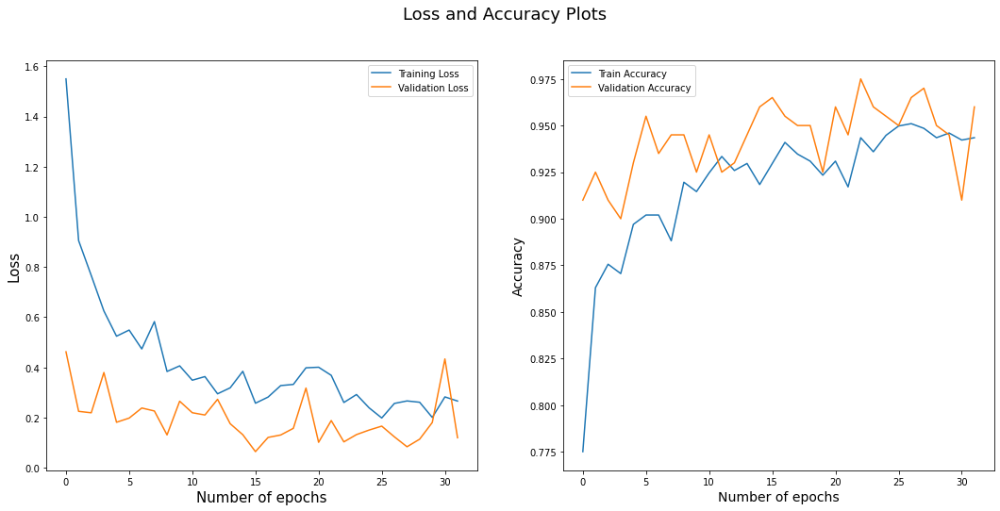

32/32 [==============================] - 1s 38ms/step
Round:  42
Test Accuracy:  0.87
Label Accuracy:  0.87
Number of catagory 1:  494.0
Number of catagory 2:  506.0
Model: "sequential_86"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_86 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epo

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 126ms/step - loss: 1.2595 - acc: 0.8175 - val_loss: 0.2298 - val_acc: 0.9200
Epoch 2/32
25/25 [==============================] - 1s 54ms/step - loss: 0.8091 - acc: 0.8500 - val_loss: 0.2276 - val_acc: 0.9000
Epoch 3/32
25/25 [==============================] - 1s 55ms/step - loss: 0.5474 - acc: 0.8950 - val_loss: 0.2500 - val_acc: 0.9250
Epoch 4/32
25/25 [==============================] - 1s 59ms/step - loss: 0.6663 - acc: 0.8712 - val_loss: 0.2884 - val_acc: 0.9100
Epoch 5/32
25/25 [==============================] - 1s 58ms/step - loss: 0.5415 - acc: 0.8938 - val_loss: 0.2636 - val_acc: 0.9200
Epoch 6/32
25/25 [==============================] - 1s 56ms/step - loss: 0.5890 - acc: 0.8863 - val_loss: 0.2181 - val_acc: 0.9450
Epoch 7/32
25/25 [==============================] - 1s 58ms/step - loss: 0.5253 - acc: 0.8975 - val_loss: 0.1896 - val_acc: 0.9250
Epoch 8/32
25/25 [==============================] - 1s 57ms/step - loss: 0.4933 - acc: 0.9000

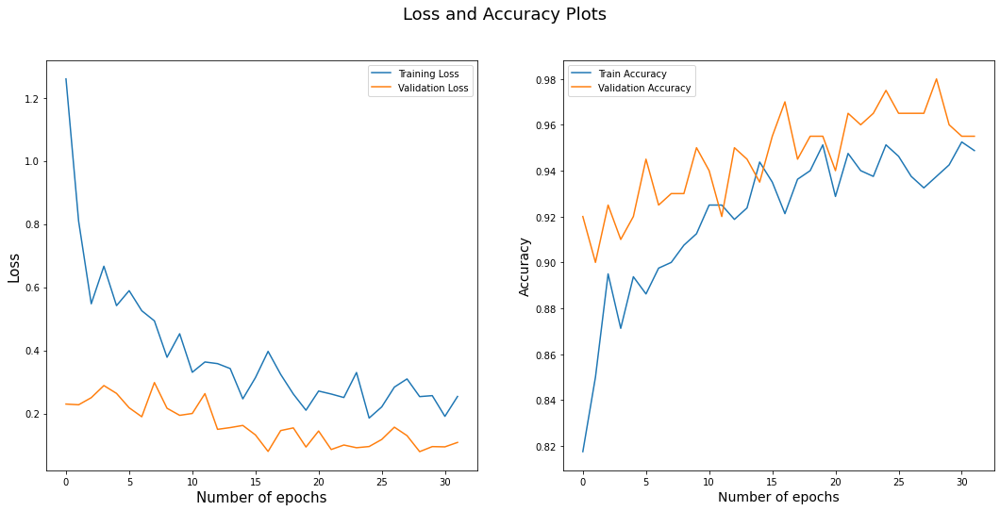

7/7 [==============================] - 2s 39ms/step
0.85


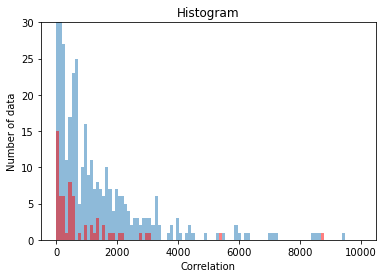

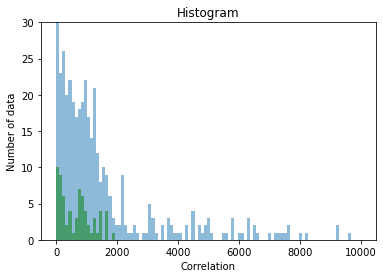

Model: "sequential_87"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_87 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 138ms/step - loss: 1.7499 - acc: 0.7802 - val_loss: 0.2901 - val_acc: 0.9250
Epoch 2/32
25/25 [==============================] - 2s 61ms/step - loss: 0.8115 - acc: 0.8668 - val_loss: 0.3372 - val_acc: 0.9050
Epoch 3/32
25/25 [==============================] - 1s 58ms/step - loss: 0.6481 - acc: 0.8857 - val_loss: 0.3859 - val_acc: 0.9000
Epoch 4/32
25/25 [==============================] - 2s 61ms/step - loss: 0.5349 - acc: 0.8932 - val_loss: 0.2317 - val_acc: 0.9200
Epoch 5/32
25/25 [==============================] - 1s 60ms/step - loss: 0.5520 - acc: 0.8882 - val_loss: 0.1130 - val_acc: 0.9500
Epoch 6/32
25/25 [==============================] - 1s 59ms/step - loss: 0.5720 - acc: 0.8869 - val_loss: 0.0582 - val_acc: 0.9750
Epoch 7/32
25/25 [==============================] - 1s 55ms/step - loss: 0.4381 - acc: 0.8957 - val_loss: 0.0688 - val_acc: 0.9800
Epoch 8/32
25/25 [==============================] - 1s 56ms/step - loss: 0.4236 - acc: 0.9095

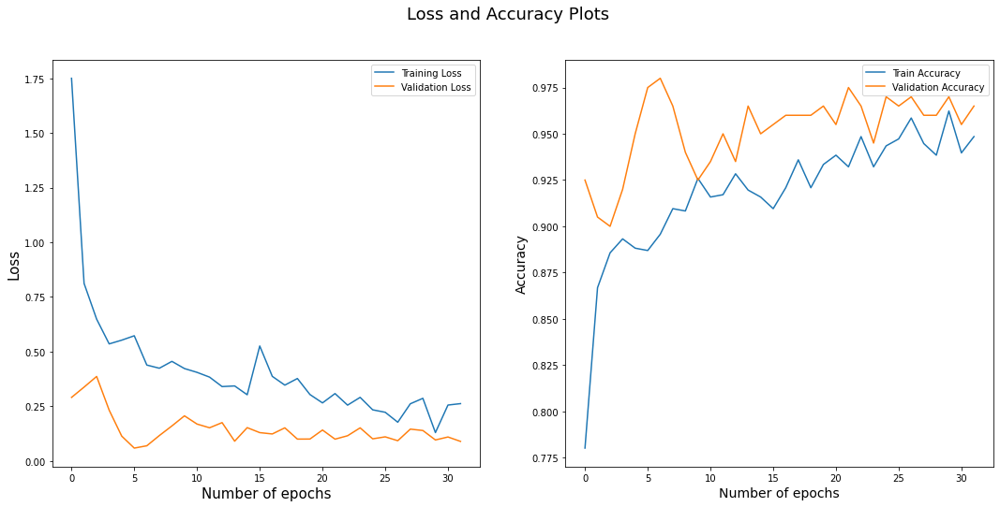

32/32 [==============================] - 1s 39ms/step
Round:  43
Test Accuracy:  0.87
Label Accuracy:  0.87
Number of catagory 1:  494.0
Number of catagory 2:  506.0
Model: "sequential_88"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_88 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epo

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 7s 122ms/step - loss: 1.3133 - acc: 0.7800 - val_loss: 0.2546 - val_acc: 0.9450
Epoch 2/32
25/25 [==============================] - 1s 52ms/step - loss: 0.8946 - acc: 0.8512 - val_loss: 0.2605 - val_acc: 0.9450
Epoch 3/32
25/25 [==============================] - 1s 50ms/step - loss: 0.6549 - acc: 0.8763 - val_loss: 0.2688 - val_acc: 0.9200
Epoch 4/32
25/25 [==============================] - 1s 46ms/step - loss: 0.7179 - acc: 0.8875 - val_loss: 0.1333 - val_acc: 0.9600
Epoch 5/32
25/25 [==============================] - 1s 50ms/step - loss: 0.5785 - acc: 0.8825 - val_loss: 0.2504 - val_acc: 0.9300
Epoch 6/32
25/25 [==============================] - 1s 50ms/step - loss: 0.5005 - acc: 0.8900 - val_loss: 0.2443 - val_acc: 0.9400
Epoch 7/32
25/25 [==============================] - 1s 49ms/step - loss: 0.5348 - acc: 0.9025 - val_loss: 0.1977 - val_acc: 0.9450
Epoch 8/32
25/25 [==============================] - 1s 53ms/step - loss: 0.3684 - acc: 0.9100

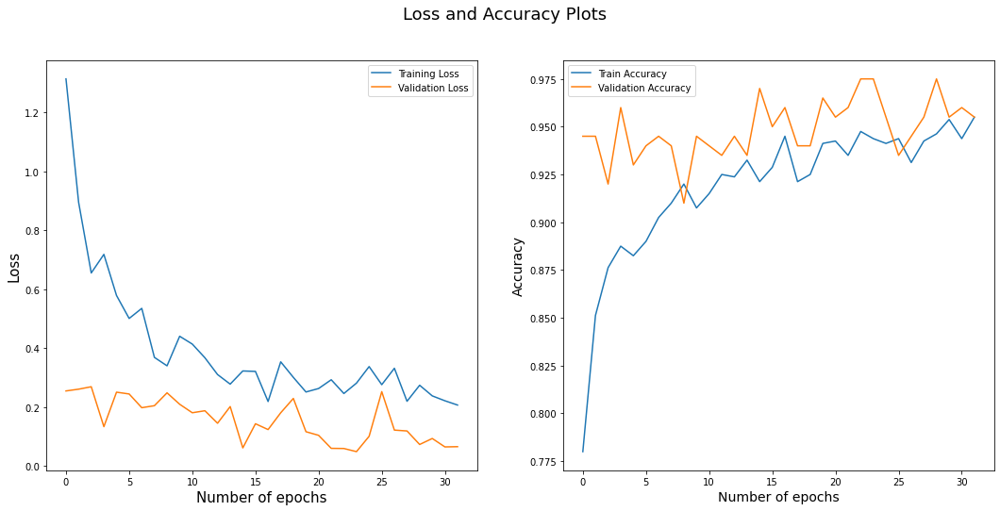

7/7 [==============================] - 3s 43ms/step
0.87


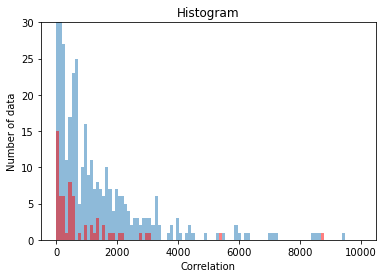

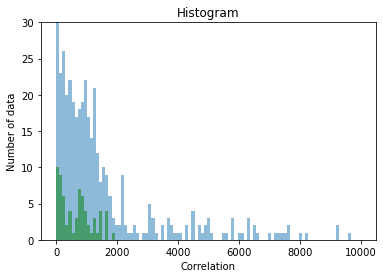

Model: "sequential_89"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_89 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 132ms/step - loss: 1.2494 - acc: 0.7802 - val_loss: 0.2874 - val_acc: 0.9300
Epoch 2/32
25/25 [==============================] - 1s 55ms/step - loss: 0.8487 - acc: 0.8618 - val_loss: 0.2193 - val_acc: 0.9150
Epoch 3/32
25/25 [==============================] - 1s 55ms/step - loss: 0.5895 - acc: 0.8744 - val_loss: 0.1855 - val_acc: 0.9400
Epoch 4/32
25/25 [==============================] - 1s 53ms/step - loss: 0.4789 - acc: 0.9033 - val_loss: 0.2464 - val_acc: 0.9350
Epoch 5/32
25/25 [==============================] - 1s 60ms/step - loss: 0.6590 - acc: 0.8945 - val_loss: 0.2407 - val_acc: 0.9200
Epoch 6/32
25/25 [==============================] - 1s 57ms/step - loss: 0.5032 - acc: 0.9008 - val_loss: 0.1123 - val_acc: 0.9550
Epoch 7/32
25/25 [==============================] - 1s 54ms/step - loss: 0.5111 - acc: 0.9033 - val_loss: 0.1050 - val_acc: 0.9450
Epoch 8/32
25/25 [==============================] - 1s 56ms/step - loss: 0.5016 - acc: 0.8957

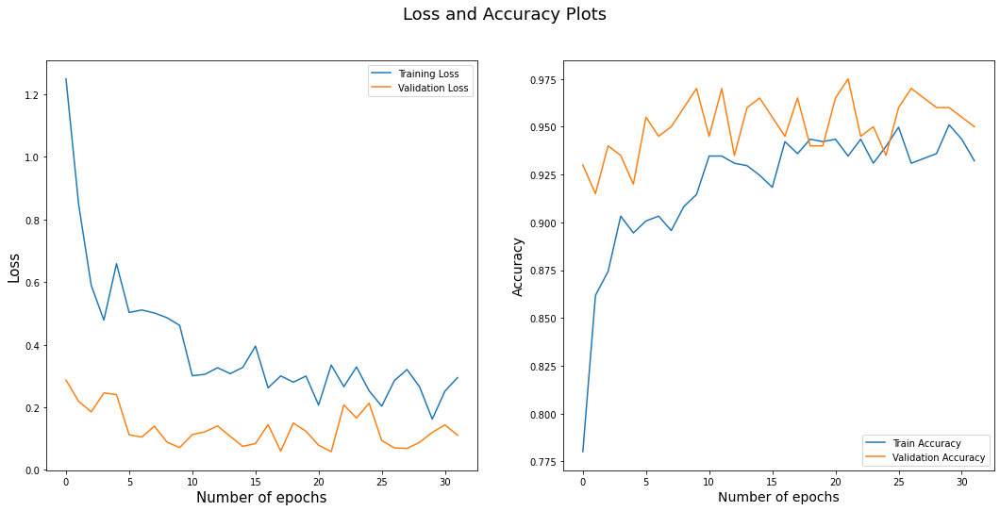

32/32 [==============================] - 1s 37ms/step
Round:  44
Test Accuracy:  0.865
Label Accuracy:  0.87
Number of catagory 1:  494.0
Number of catagory 2:  506.0
Model: "sequential_90"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_90 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Ep

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 10s 141ms/step - loss: 1.3311 - acc: 0.7962 - val_loss: 0.2408 - val_acc: 0.9250
Epoch 2/32
25/25 [==============================] - 1s 52ms/step - loss: 0.9490 - acc: 0.8537 - val_loss: 0.3172 - val_acc: 0.9300
Epoch 3/32
25/25 [==============================] - 1s 54ms/step - loss: 0.6346 - acc: 0.8800 - val_loss: 0.1490 - val_acc: 0.9500
Epoch 4/32
25/25 [==============================] - 1s 58ms/step - loss: 0.6533 - acc: 0.8800 - val_loss: 0.1555 - val_acc: 0.9350
Epoch 5/32
25/25 [==============================] - 1s 52ms/step - loss: 0.4726 - acc: 0.8963 - val_loss: 0.1072 - val_acc: 0.9700
Epoch 6/32
25/25 [==============================] - 1s 58ms/step - loss: 0.5304 - acc: 0.9000 - val_loss: 0.1005 - val_acc: 0.9600
Epoch 7/32
25/25 [==============================] - 1s 55ms/step - loss: 0.5107 - acc: 0.9112 - val_loss: 0.1596 - val_acc: 0.9450
Epoch 8/32
25/25 [==============================] - 1s 55ms/step - loss: 0.4998 - acc: 0.897

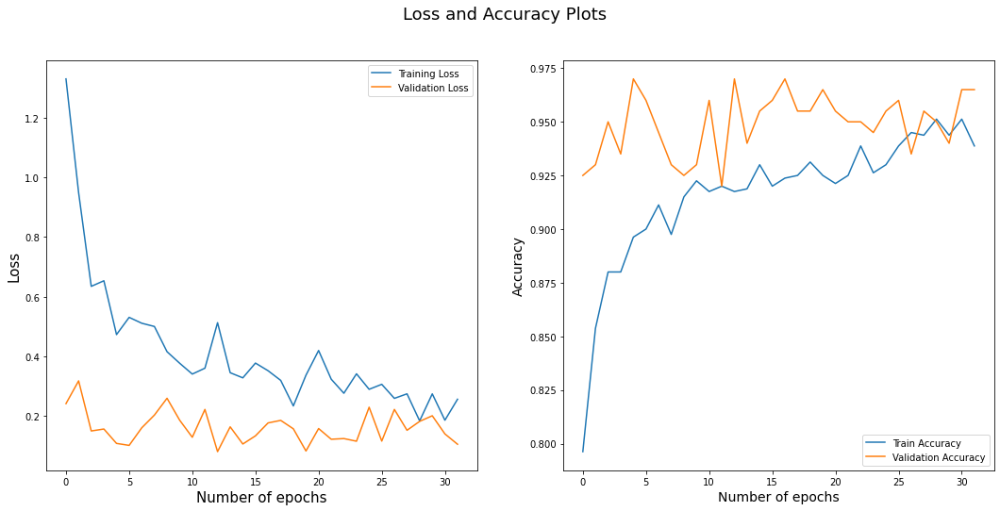

7/7 [==============================] - 2s 42ms/step
0.875


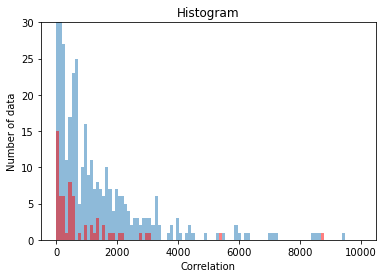

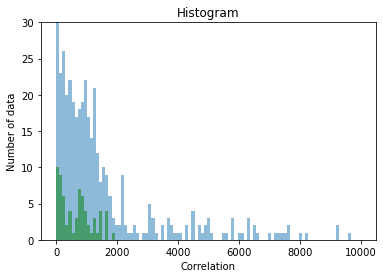

Model: "sequential_91"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_91 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 134ms/step - loss: 1.7344 - acc: 0.7776 - val_loss: 0.2174 - val_acc: 0.9450
Epoch 2/32
25/25 [==============================] - 1s 56ms/step - loss: 1.0713 - acc: 0.8329 - val_loss: 0.2056 - val_acc: 0.9400
Epoch 3/32
25/25 [==============================] - 1s 60ms/step - loss: 0.6993 - acc: 0.8756 - val_loss: 0.1191 - val_acc: 0.9450
Epoch 4/32
25/25 [==============================] - 1s 55ms/step - loss: 0.7669 - acc: 0.8807 - val_loss: 0.1145 - val_acc: 0.9500
Epoch 5/32
25/25 [==============================] - 1s 52ms/step - loss: 0.6033 - acc: 0.8844 - val_loss: 0.1060 - val_acc: 0.9700
Epoch 6/32
25/25 [==============================] - 1s 57ms/step - loss: 0.4093 - acc: 0.8995 - val_loss: 0.1640 - val_acc: 0.9450
Epoch 7/32
25/25 [==============================] - 1s 57ms/step - loss: 0.4644 - acc: 0.9045 - val_loss: 0.0840 - val_acc: 0.9500
Epoch 8/32
25/25 [==============================] - 1s 55ms/step - loss: 0.5632 - acc: 0.9020

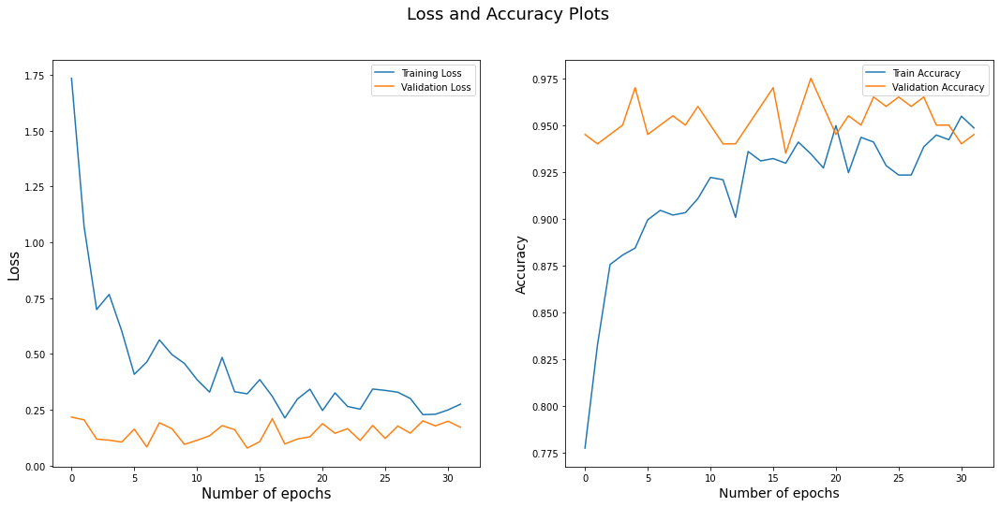

32/32 [==============================] - 1s 37ms/step
Round:  45
Test Accuracy:  0.87
Label Accuracy:  0.871
Number of catagory 1:  495.0
Number of catagory 2:  505.0
Model: "sequential_92"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_92 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Ep

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 138ms/step - loss: 1.5167 - acc: 0.8075 - val_loss: 0.2984 - val_acc: 0.9350
Epoch 2/32
25/25 [==============================] - 1s 56ms/step - loss: 0.8727 - acc: 0.8512 - val_loss: 0.2760 - val_acc: 0.9250
Epoch 3/32
25/25 [==============================] - 1s 56ms/step - loss: 0.6830 - acc: 0.8650 - val_loss: 0.1629 - val_acc: 0.9500
Epoch 4/32
25/25 [==============================] - 1s 51ms/step - loss: 0.7048 - acc: 0.8763 - val_loss: 0.1466 - val_acc: 0.9550
Epoch 5/32
25/25 [==============================] - 1s 57ms/step - loss: 0.5328 - acc: 0.9050 - val_loss: 0.1067 - val_acc: 0.9500
Epoch 6/32
25/25 [==============================] - 1s 52ms/step - loss: 0.4583 - acc: 0.9000 - val_loss: 0.1661 - val_acc: 0.9350
Epoch 7/32
25/25 [==============================] - 1s 57ms/step - loss: 0.4256 - acc: 0.9137 - val_loss: 0.2260 - val_acc: 0.9250
Epoch 8/32
25/25 [==============================] - 1s 53ms/step - loss: 0.4152 - acc: 0.9162

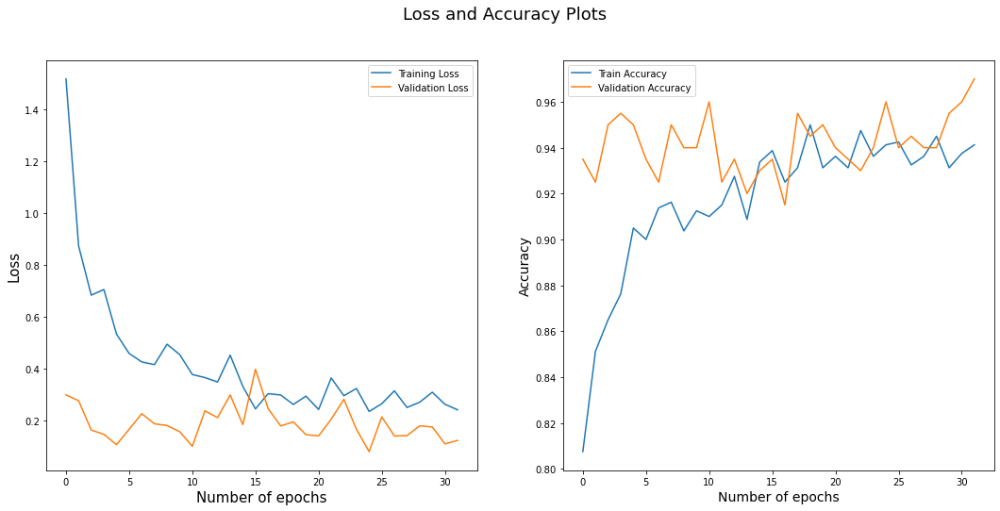

7/7 [==============================] - 2s 40ms/step
0.885


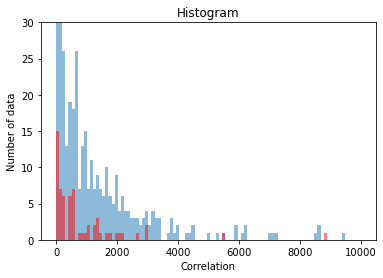

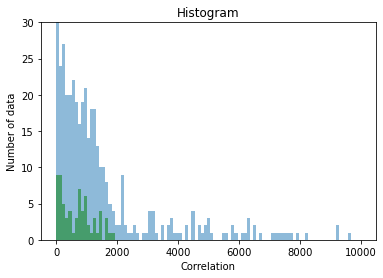

Model: "sequential_93"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_93 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 135ms/step - loss: 1.3841 - acc: 0.7814 - val_loss: 0.4356 - val_acc: 0.9250
Epoch 2/32
25/25 [==============================] - 1s 55ms/step - loss: 0.8536 - acc: 0.8530 - val_loss: 0.1515 - val_acc: 0.9500
Epoch 3/32
25/25 [==============================] - 1s 54ms/step - loss: 0.5493 - acc: 0.8807 - val_loss: 0.1945 - val_acc: 0.9400
Epoch 4/32
25/25 [==============================] - 1s 58ms/step - loss: 0.6638 - acc: 0.8819 - val_loss: 0.1165 - val_acc: 0.9600
Epoch 5/32
25/25 [==============================] - 1s 57ms/step - loss: 0.5577 - acc: 0.9020 - val_loss: 0.1050 - val_acc: 0.9550
Epoch 6/32
25/25 [==============================] - 1s 56ms/step - loss: 0.5887 - acc: 0.9020 - val_loss: 0.1210 - val_acc: 0.9450
Epoch 7/32
25/25 [==============================] - 1s 58ms/step - loss: 0.4460 - acc: 0.9045 - val_loss: 0.2761 - val_acc: 0.9300
Epoch 8/32
25/25 [==============================] - 1s 58ms/step - loss: 0.4327 - acc: 0.9008

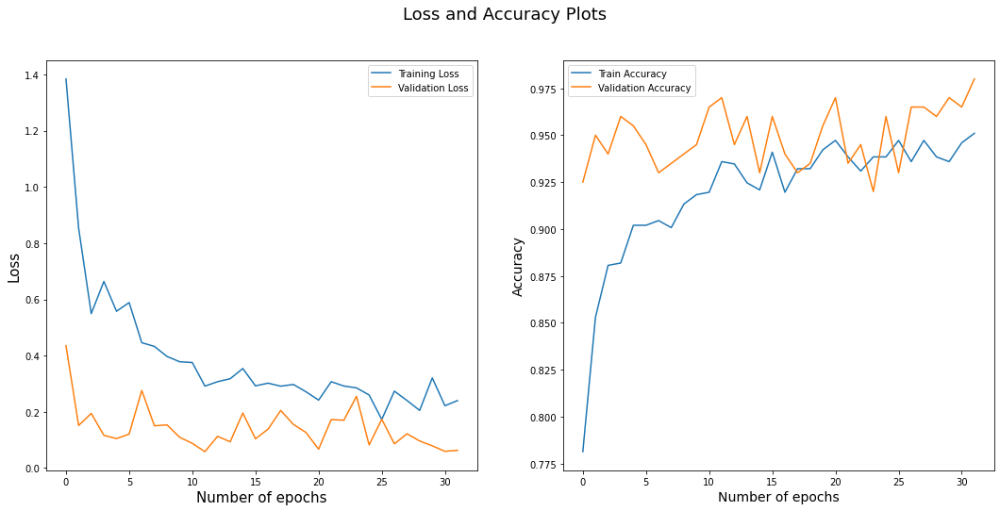

32/32 [==============================] - 1s 37ms/step
Round:  46
Test Accuracy:  0.87
Label Accuracy:  0.871
Number of catagory 1:  495.0
Number of catagory 2:  505.0
Model: "sequential_94"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_94 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Ep

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 134ms/step - loss: 1.3592 - acc: 0.7875 - val_loss: 0.1734 - val_acc: 0.9550
Epoch 2/32
25/25 [==============================] - 1s 55ms/step - loss: 1.0753 - acc: 0.8562 - val_loss: 0.4177 - val_acc: 0.9050
Epoch 3/32
25/25 [==============================] - 1s 54ms/step - loss: 0.7430 - acc: 0.8788 - val_loss: 0.1079 - val_acc: 0.9500
Epoch 4/32
25/25 [==============================] - 1s 54ms/step - loss: 0.6007 - acc: 0.8850 - val_loss: 0.2452 - val_acc: 0.9200
Epoch 5/32
25/25 [==============================] - 1s 55ms/step - loss: 0.5185 - acc: 0.9025 - val_loss: 0.1478 - val_acc: 0.9450
Epoch 6/32
25/25 [==============================] - 1s 58ms/step - loss: 0.5242 - acc: 0.9100 - val_loss: 0.0946 - val_acc: 0.9700
Epoch 7/32
25/25 [==============================] - 1s 55ms/step - loss: 0.5912 - acc: 0.8938 - val_loss: 0.1260 - val_acc: 0.9550
Epoch 8/32
25/25 [==============================] - 1s 55ms/step - loss: 0.4180 - acc: 0.9162

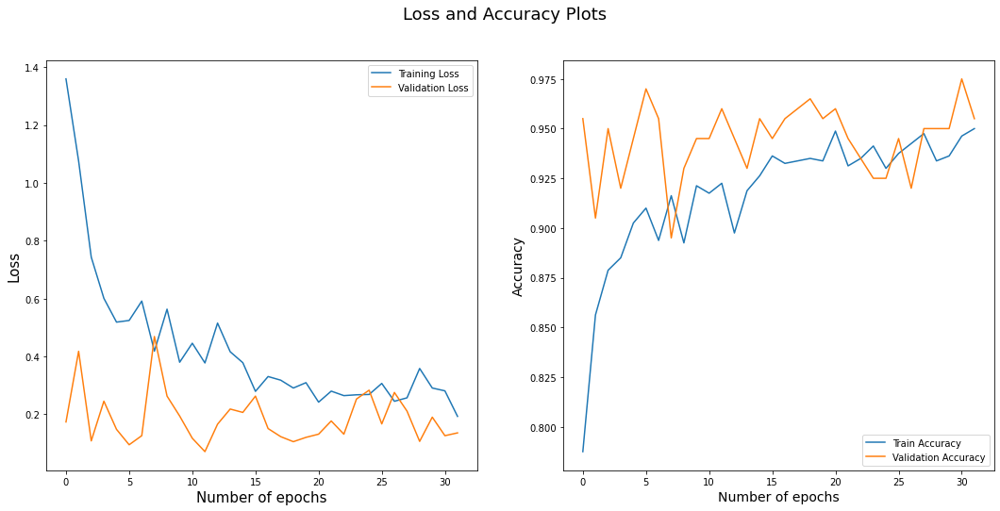

7/7 [==============================] - 2s 39ms/step
0.88


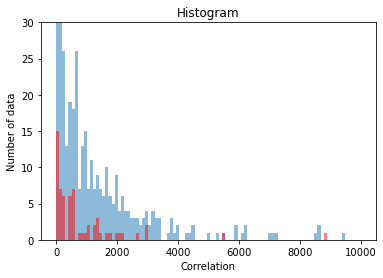

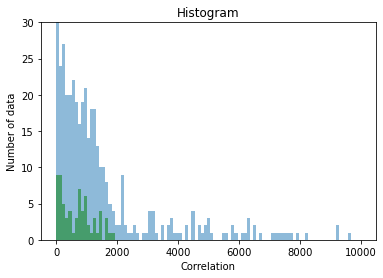

Model: "sequential_95"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_95 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 129ms/step - loss: 1.5135 - acc: 0.7714 - val_loss: 0.4765 - val_acc: 0.9000
Epoch 2/32
25/25 [==============================] - 1s 54ms/step - loss: 1.0732 - acc: 0.8317 - val_loss: 0.3293 - val_acc: 0.9100
Epoch 3/32
25/25 [==============================] - 1s 57ms/step - loss: 0.6182 - acc: 0.8894 - val_loss: 0.1674 - val_acc: 0.9300
Epoch 4/32
25/25 [==============================] - 1s 54ms/step - loss: 0.7110 - acc: 0.8706 - val_loss: 0.1525 - val_acc: 0.9450
Epoch 5/32
25/25 [==============================] - 1s 55ms/step - loss: 0.4887 - acc: 0.8957 - val_loss: 0.1986 - val_acc: 0.9500
Epoch 6/32
25/25 [==============================] - 1s 53ms/step - loss: 0.5403 - acc: 0.8807 - val_loss: 0.2382 - val_acc: 0.9350
Epoch 7/32
25/25 [==============================] - 1s 56ms/step - loss: 0.4519 - acc: 0.9033 - val_loss: 0.1906 - val_acc: 0.9450
Epoch 8/32
25/25 [==============================] - 1s 56ms/step - loss: 0.4044 - acc: 0.9234

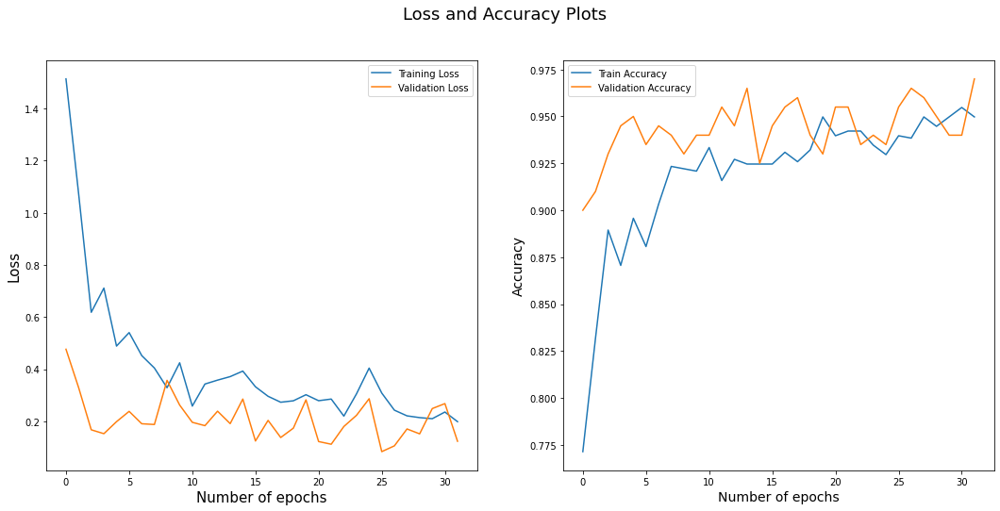

32/32 [==============================] - 1s 36ms/step
Round:  47
Test Accuracy:  0.875
Label Accuracy:  0.871
Number of catagory 1:  493.0
Number of catagory 2:  507.0
Model: "sequential_96"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_96 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
E

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 125ms/step - loss: 1.8925 - acc: 0.7675 - val_loss: 0.3731 - val_acc: 0.9350
Epoch 2/32
25/25 [==============================] - 1s 52ms/step - loss: 1.0871 - acc: 0.8500 - val_loss: 0.3625 - val_acc: 0.9000
Epoch 3/32
25/25 [==============================] - 1s 55ms/step - loss: 0.7475 - acc: 0.8625 - val_loss: 0.3806 - val_acc: 0.8950
Epoch 4/32
25/25 [==============================] - 1s 55ms/step - loss: 0.8150 - acc: 0.8763 - val_loss: 0.2261 - val_acc: 0.9350
Epoch 5/32
25/25 [==============================] - 1s 57ms/step - loss: 0.5987 - acc: 0.8988 - val_loss: 0.1751 - val_acc: 0.9350
Epoch 6/32
25/25 [==============================] - 1s 57ms/step - loss: 0.5860 - acc: 0.8988 - val_loss: 0.2167 - val_acc: 0.9300
Epoch 7/32
25/25 [==============================] - 1s 54ms/step - loss: 0.5078 - acc: 0.9013 - val_loss: 0.1480 - val_acc: 0.9450
Epoch 8/32
25/25 [==============================] - 1s 53ms/step - loss: 0.4070 - acc: 0.9250

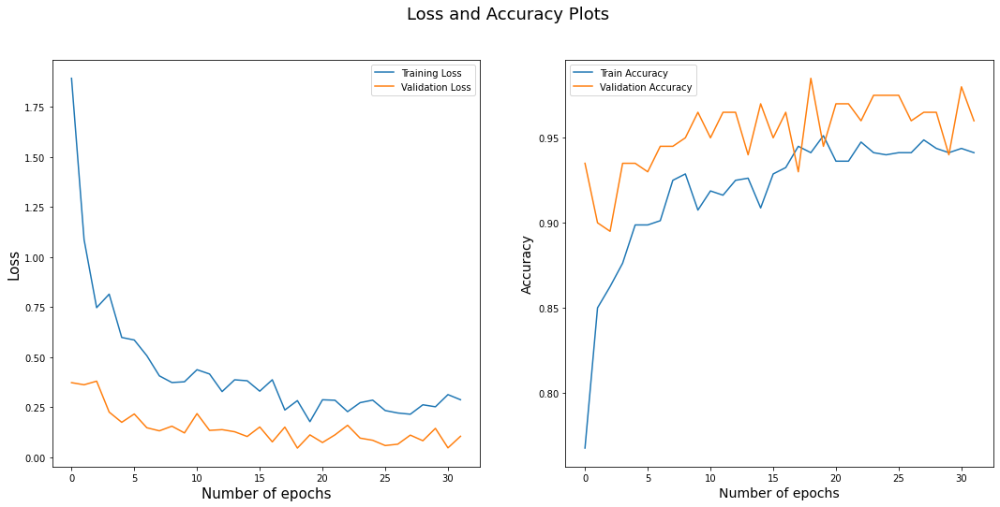

7/7 [==============================] - 2s 38ms/step
0.86


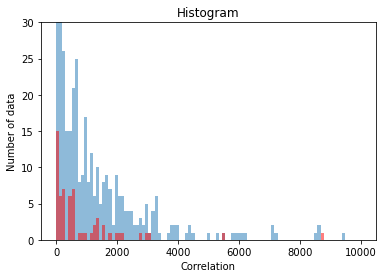

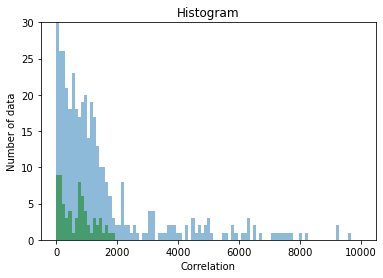

Model: "sequential_97"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_97 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 126ms/step - loss: 1.3012 - acc: 0.7701 - val_loss: 0.4352 - val_acc: 0.9100
Epoch 2/32
25/25 [==============================] - 1s 56ms/step - loss: 1.0030 - acc: 0.8417 - val_loss: 0.3878 - val_acc: 0.9100
Epoch 3/32
25/25 [==============================] - 1s 58ms/step - loss: 0.7651 - acc: 0.8719 - val_loss: 0.2421 - val_acc: 0.9450
Epoch 4/32
25/25 [==============================] - 2s 60ms/step - loss: 0.6719 - acc: 0.8819 - val_loss: 0.1421 - val_acc: 0.9650
Epoch 5/32
25/25 [==============================] - 1s 56ms/step - loss: 0.5784 - acc: 0.8832 - val_loss: 0.4003 - val_acc: 0.9100
Epoch 6/32
25/25 [==============================] - 1s 54ms/step - loss: 0.5581 - acc: 0.9070 - val_loss: 0.1741 - val_acc: 0.9500
Epoch 7/32
25/25 [==============================] - 1s 56ms/step - loss: 0.4990 - acc: 0.8945 - val_loss: 0.3269 - val_acc: 0.9000
Epoch 8/32
25/25 [==============================] - 1s 56ms/step - loss: 0.4190 - acc: 0.8970

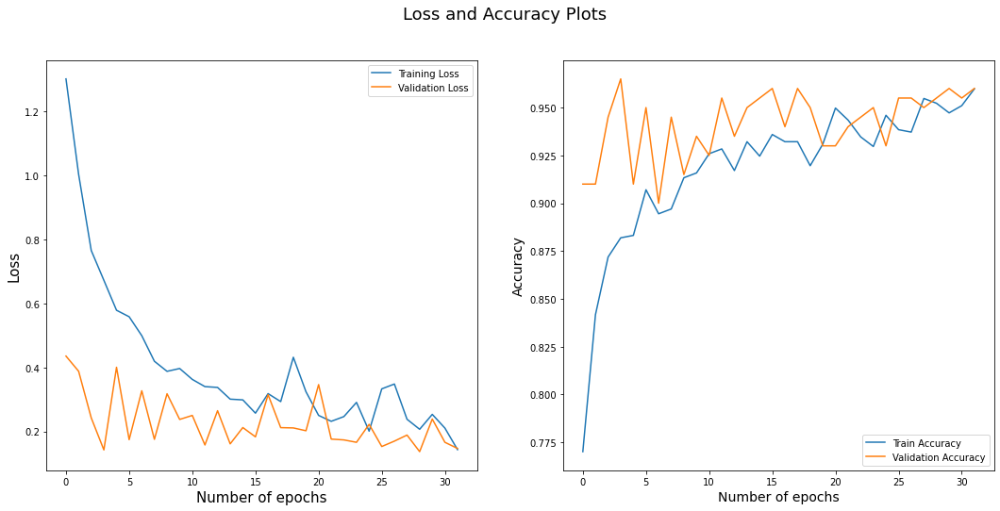

32/32 [==============================] - 1s 38ms/step
Round:  48
Test Accuracy:  0.87
Label Accuracy:  0.871
Number of catagory 1:  493.0
Number of catagory 2:  507.0
Model: "sequential_98"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_98 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Ep

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 139ms/step - loss: 1.3463 - acc: 0.7825 - val_loss: 0.3530 - val_acc: 0.9000
Epoch 2/32
25/25 [==============================] - 1s 55ms/step - loss: 0.7256 - acc: 0.8500 - val_loss: 0.2658 - val_acc: 0.9300
Epoch 3/32
25/25 [==============================] - 1s 54ms/step - loss: 0.6719 - acc: 0.8838 - val_loss: 0.2434 - val_acc: 0.9400
Epoch 4/32
25/25 [==============================] - 1s 55ms/step - loss: 0.7939 - acc: 0.8637 - val_loss: 0.2518 - val_acc: 0.9450
Epoch 5/32
25/25 [==============================] - 1s 59ms/step - loss: 0.5998 - acc: 0.8900 - val_loss: 0.1946 - val_acc: 0.9400
Epoch 6/32
25/25 [==============================] - 1s 55ms/step - loss: 0.4502 - acc: 0.9112 - val_loss: 0.1628 - val_acc: 0.9500
Epoch 7/32
25/25 [==============================] - 1s 55ms/step - loss: 0.4429 - acc: 0.9112 - val_loss: 0.2268 - val_acc: 0.9400
Epoch 8/32
25/25 [==============================] - 1s 54ms/step - loss: 0.3564 - acc: 0.9225

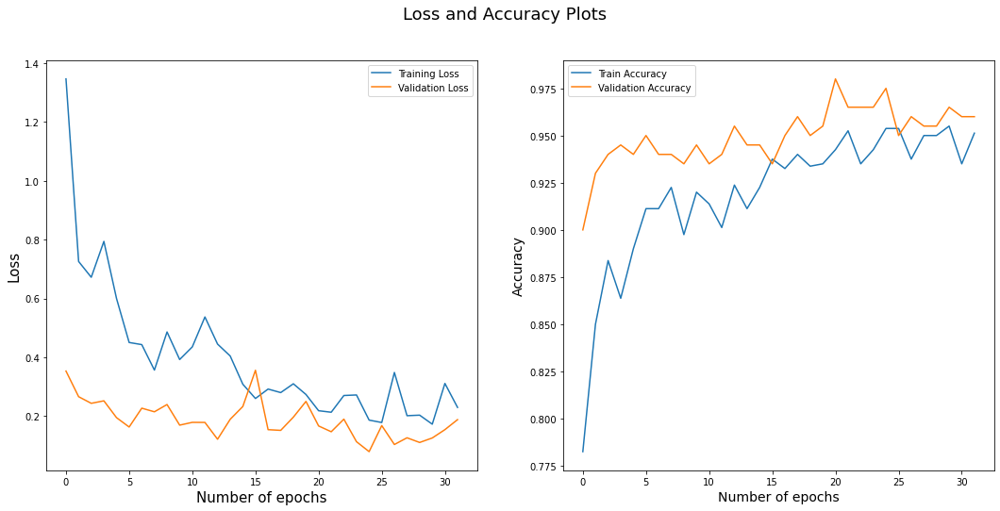

7/7 [==============================] - 2s 37ms/step
0.88


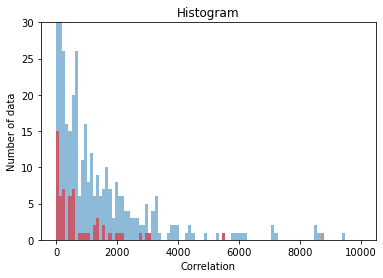

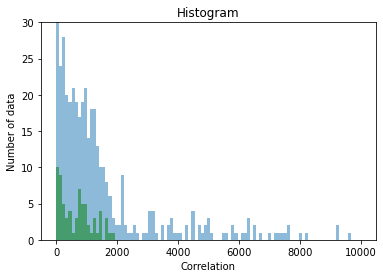

Model: "sequential_99"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_99 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 146ms/step - loss: 2.0829 - acc: 0.7462 - val_loss: 0.2119 - val_acc: 0.9400
Epoch 2/32
25/25 [==============================] - 1s 56ms/step - loss: 0.9725 - acc: 0.8618 - val_loss: 0.1976 - val_acc: 0.9150
Epoch 3/32
25/25 [==============================] - 1s 58ms/step - loss: 0.9725 - acc: 0.8606 - val_loss: 0.1673 - val_acc: 0.9550
Epoch 4/32
25/25 [==============================] - 1s 57ms/step - loss: 0.8249 - acc: 0.8731 - val_loss: 0.1262 - val_acc: 0.9500
Epoch 5/32
25/25 [==============================] - 1s 53ms/step - loss: 0.5998 - acc: 0.8819 - val_loss: 0.2209 - val_acc: 0.9300
Epoch 6/32
25/25 [==============================] - 1s 57ms/step - loss: 0.5290 - acc: 0.8932 - val_loss: 0.1220 - val_acc: 0.9400
Epoch 7/32
25/25 [==============================] - 1s 54ms/step - loss: 0.4209 - acc: 0.9095 - val_loss: 0.1328 - val_acc: 0.9500
Epoch 8/32
25/25 [==============================] - 1s 57ms/step - loss: 0.3920 - acc: 0.9221

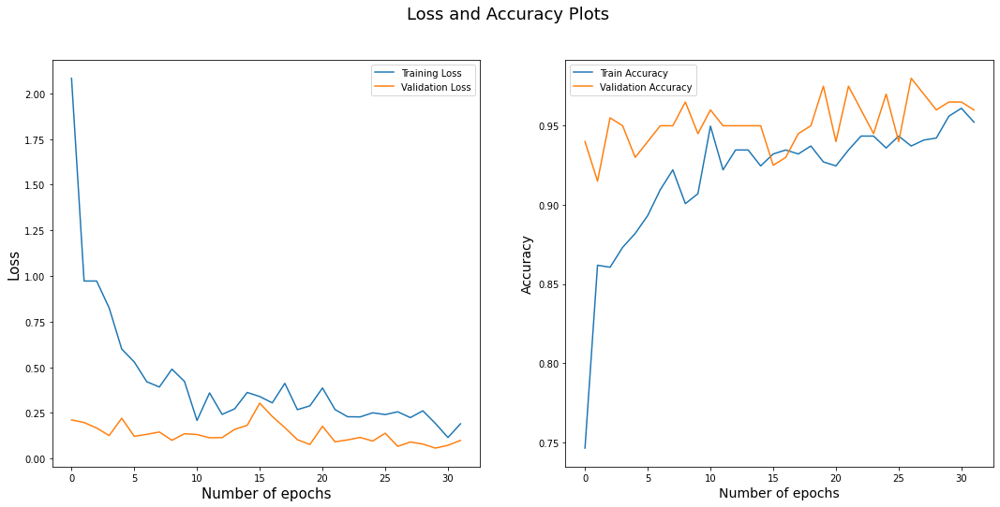

32/32 [==============================] - 1s 37ms/step
Round:  49
Test Accuracy:  0.895
Label Accuracy:  0.872
Number of catagory 1:  494.0
Number of catagory 2:  506.0
Model: "sequential_100"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_100 (Dropout)       (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 132ms/step - loss: 1.2127 - acc: 0.8062 - val_loss: 0.2758 - val_acc: 0.9000
Epoch 2/32
25/25 [==============================] - 1s 54ms/step - loss: 0.8764 - acc: 0.8450 - val_loss: 0.2871 - val_acc: 0.9100
Epoch 3/32
25/25 [==============================] - 1s 54ms/step - loss: 0.7458 - acc: 0.8700 - val_loss: 0.1377 - val_acc: 0.9500
Epoch 4/32
25/25 [==============================] - 1s 54ms/step - loss: 0.6251 - acc: 0.9000 - val_loss: 0.3756 - val_acc: 0.8950
Epoch 5/32
25/25 [==============================] - 1s 54ms/step - loss: 0.6642 - acc: 0.8750 - val_loss: 0.1400 - val_acc: 0.9600
Epoch 6/32
25/25 [==============================] - 1s 58ms/step - loss: 0.5534 - acc: 0.9087 - val_loss: 0.2184 - val_acc: 0.9350
Epoch 7/32
25/25 [==============================] - 1s 56ms/step - loss: 0.4349 - acc: 0.9025 - val_loss: 0.1083 - val_acc: 0.9700
Epoch 8/32
25/25 [==============================] - 1s 56ms/step - loss: 0.5378 - acc: 0.8950

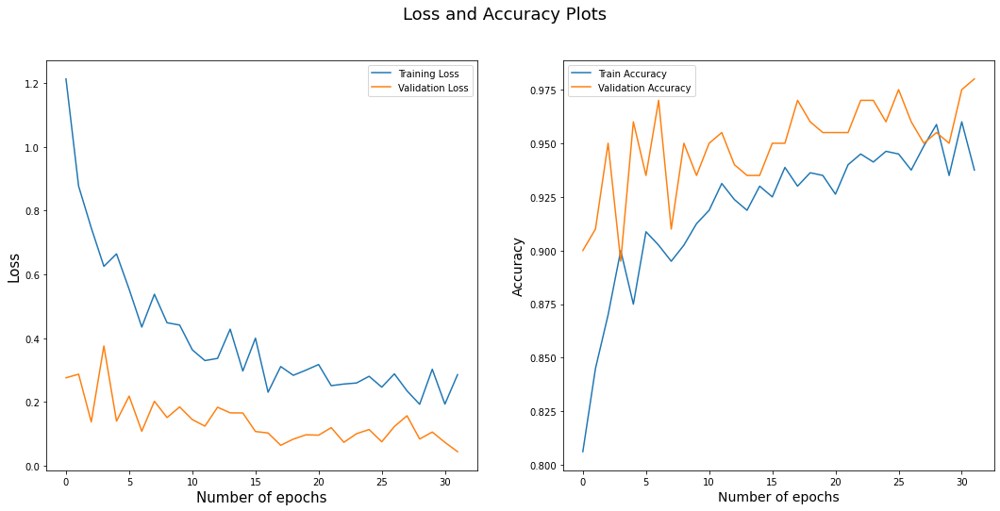

7/7 [==============================] - 2s 37ms/step
0.865


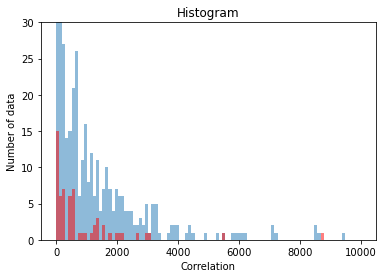

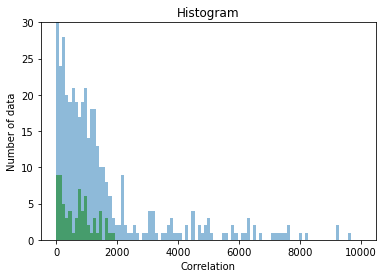

Model: "sequential_101"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_101 (Dropout)       (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 129ms/step - loss: 1.5080 - acc: 0.7701 - val_loss: 0.2896 - val_acc: 0.9200
Epoch 2/32
25/25 [==============================] - 1s 56ms/step - loss: 0.8971 - acc: 0.8643 - val_loss: 0.3003 - val_acc: 0.9050
Epoch 3/32
25/25 [==============================] - 1s 53ms/step - loss: 0.7848 - acc: 0.8819 - val_loss: 0.3069 - val_acc: 0.9100
Epoch 4/32
25/25 [==============================] - 1s 59ms/step - loss: 0.6839 - acc: 0.8593 - val_loss: 0.1428 - val_acc: 0.9450
Epoch 5/32
25/25 [==============================] - 1s 52ms/step - loss: 0.6242 - acc: 0.8756 - val_loss: 0.1191 - val_acc: 0.9550
Epoch 6/32
25/25 [==============================] - 1s 59ms/step - loss: 0.4433 - acc: 0.8957 - val_loss: 0.2165 - val_acc: 0.9450
Epoch 7/32
25/25 [==============================] - 1s 59ms/step - loss: 0.5969 - acc: 0.8970 - val_loss: 0.1150 - val_acc: 0.9600
Epoch 8/32
25/25 [==============================] - 1s 54ms/step - loss: 0.5412 - acc: 0.9146

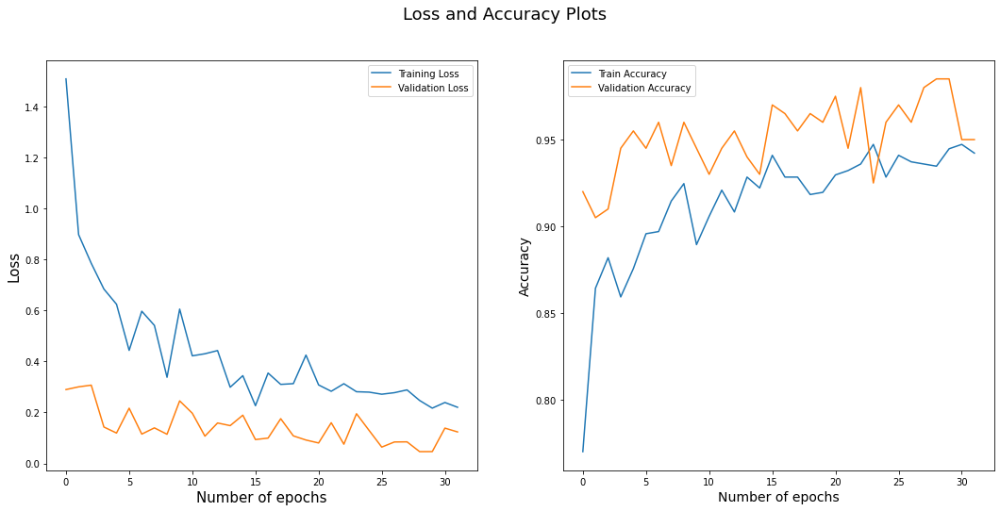

32/32 [==============================] - 1s 39ms/step
Round:  50
Test Accuracy:  0.86
Label Accuracy:  0.873
Number of catagory 1:  495.0
Number of catagory 2:  505.0
Model: "sequential_102"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_102 (Dropout)       (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
E

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 133ms/step - loss: 1.6663 - acc: 0.7862 - val_loss: 0.1886 - val_acc: 0.9350
Epoch 2/32
25/25 [==============================] - 1s 55ms/step - loss: 1.2278 - acc: 0.8413 - val_loss: 0.2968 - val_acc: 0.9300
Epoch 3/32
25/25 [==============================] - 1s 55ms/step - loss: 0.9343 - acc: 0.8462 - val_loss: 0.1889 - val_acc: 0.9500
Epoch 4/32
25/25 [==============================] - 1s 54ms/step - loss: 0.6994 - acc: 0.8900 - val_loss: 0.2260 - val_acc: 0.9150
Epoch 5/32
25/25 [==============================] - 1s 57ms/step - loss: 0.5573 - acc: 0.8888 - val_loss: 0.1531 - val_acc: 0.9550
Epoch 6/32
25/25 [==============================] - 1s 57ms/step - loss: 0.7142 - acc: 0.8850 - val_loss: 0.1701 - val_acc: 0.9500
Epoch 7/32
25/25 [==============================] - 1s 56ms/step - loss: 0.4554 - acc: 0.9025 - val_loss: 0.1944 - val_acc: 0.9300
Epoch 8/32
25/25 [==============================] - 1s 55ms/step - loss: 0.3242 - acc: 0.9175

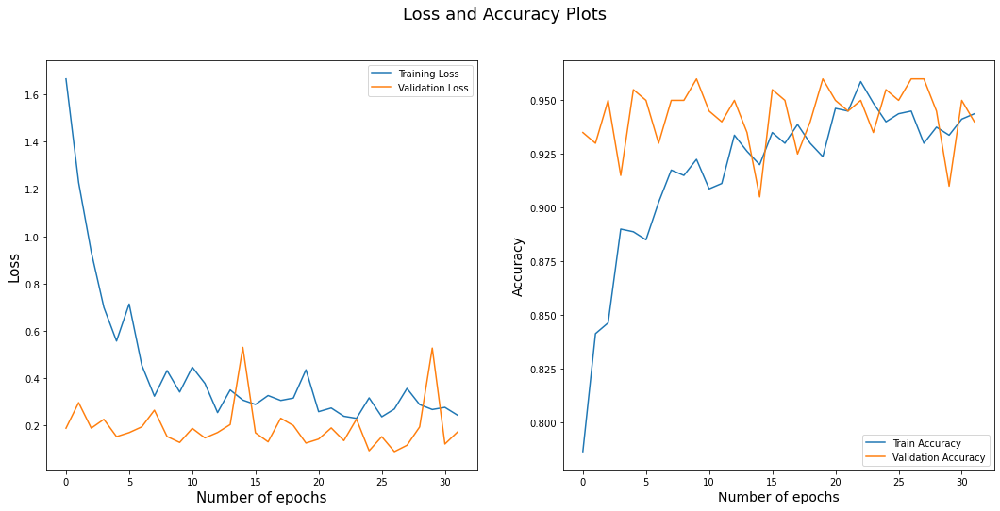

7/7 [==============================] - 2s 39ms/step
0.86


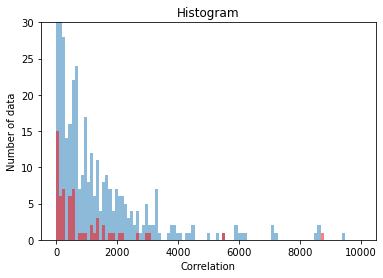

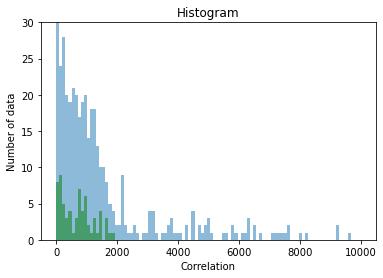

Model: "sequential_103"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_103 (Dropout)       (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 133ms/step - loss: 1.3391 - acc: 0.7789 - val_loss: 0.2246 - val_acc: 0.9350
Epoch 2/32
25/25 [==============================] - 1s 56ms/step - loss: 0.7627 - acc: 0.8731 - val_loss: 0.2332 - val_acc: 0.9400
Epoch 3/32
25/25 [==============================] - 1s 57ms/step - loss: 0.7490 - acc: 0.8643 - val_loss: 0.1938 - val_acc: 0.9450
Epoch 4/32
25/25 [==============================] - 1s 57ms/step - loss: 0.6736 - acc: 0.8844 - val_loss: 0.1994 - val_acc: 0.9250
Epoch 5/32
25/25 [==============================] - 1s 53ms/step - loss: 0.4274 - acc: 0.9008 - val_loss: 0.2731 - val_acc: 0.9100
Epoch 6/32
25/25 [==============================] - 1s 53ms/step - loss: 0.6248 - acc: 0.8957 - val_loss: 0.1947 - val_acc: 0.9500
Epoch 7/32
25/25 [==============================] - 1s 60ms/step - loss: 0.5225 - acc: 0.8844 - val_loss: 0.1359 - val_acc: 0.9600
Epoch 8/32
25/25 [==============================] - 1s 57ms/step - loss: 0.4030 - acc: 0.9171

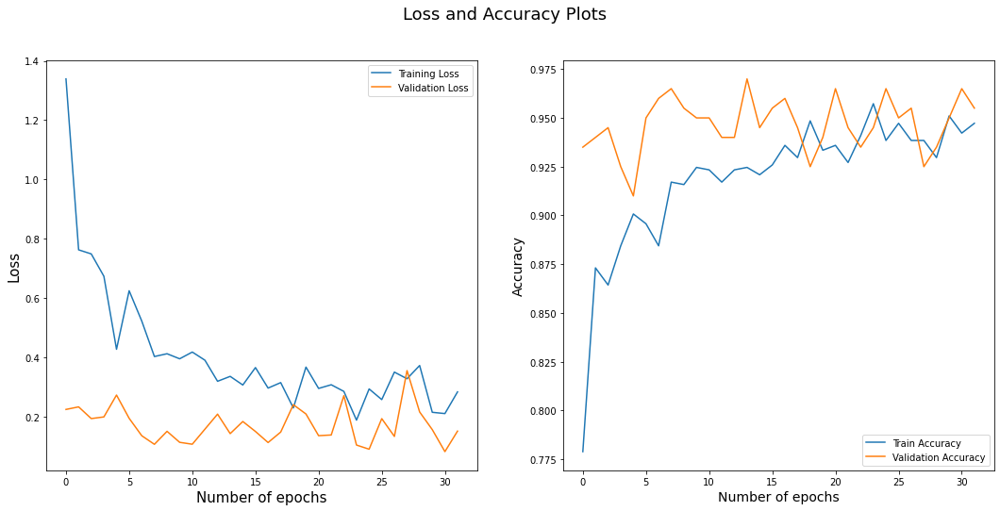

32/32 [==============================] - 1s 38ms/step
Round:  51
Test Accuracy:  0.865
Label Accuracy:  0.871
Number of catagory 1:  493.0
Number of catagory 2:  507.0
Model: "sequential_104"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_104 (Dropout)       (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 202ms/step - loss: 1.2347 - acc: 0.8025 - val_loss: 0.2192 - val_acc: 0.9300
Epoch 2/32
25/25 [==============================] - 1s 56ms/step - loss: 0.7703 - acc: 0.8700 - val_loss: 0.3485 - val_acc: 0.8850
Epoch 3/32
25/25 [==============================] - 1s 58ms/step - loss: 0.6373 - acc: 0.8737 - val_loss: 0.1140 - val_acc: 0.9650
Epoch 4/32
25/25 [==============================] - 1s 57ms/step - loss: 0.6034 - acc: 0.9038 - val_loss: 0.2738 - val_acc: 0.9250
Epoch 5/32
25/25 [==============================] - 1s 55ms/step - loss: 0.4552 - acc: 0.9038 - val_loss: 0.1265 - val_acc: 0.9600
Epoch 6/32
25/25 [==============================] - 1s 59ms/step - loss: 0.5618 - acc: 0.8950 - val_loss: 0.2961 - val_acc: 0.9250
Epoch 7/32
25/25 [==============================] - 1s 52ms/step - loss: 0.4719 - acc: 0.8863 - val_loss: 0.1264 - val_acc: 0.9500
Epoch 8/32
25/25 [==============================] - 1s 58ms/step - loss: 0.4888 - acc: 0.9100

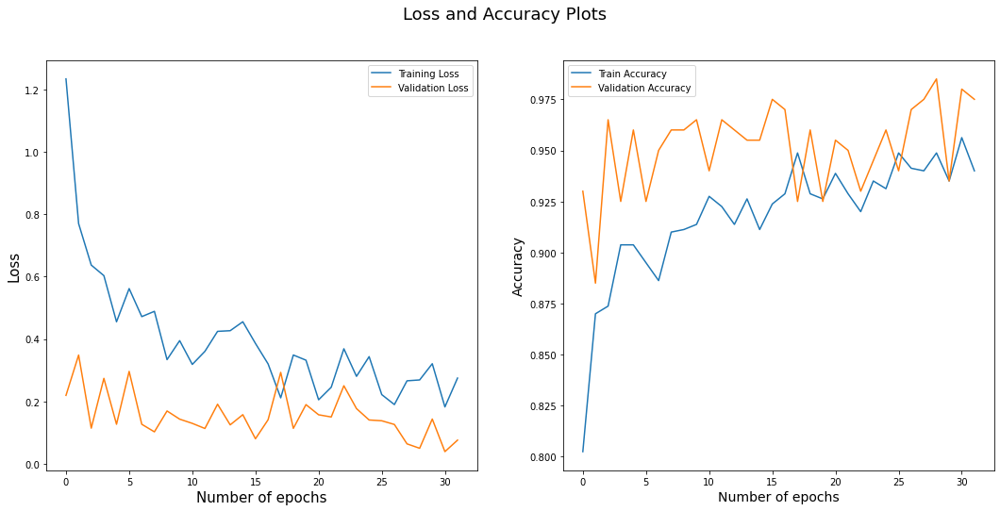

7/7 [==============================] - 3s 41ms/step
0.895


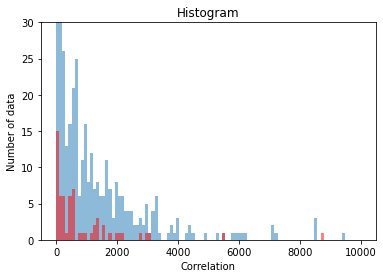

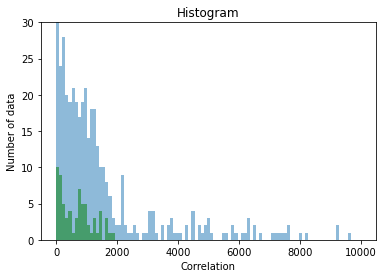

Model: "sequential_105"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_105 (Dropout)       (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 11s 151ms/step - loss: 1.4117 - acc: 0.7694 - val_loss: 0.3232 - val_acc: 0.9250
Epoch 2/32
25/25 [==============================] - 1s 57ms/step - loss: 0.8643 - acc: 0.8459 - val_loss: 0.4865 - val_acc: 0.8700
Epoch 3/32
25/25 [==============================] - 1s 59ms/step - loss: 0.6868 - acc: 0.8747 - val_loss: 0.3650 - val_acc: 0.8950
Epoch 4/32
25/25 [==============================] - 1s 57ms/step - loss: 0.7075 - acc: 0.8722 - val_loss: 0.1700 - val_acc: 0.9450
Epoch 5/32
25/25 [==============================] - 1s 60ms/step - loss: 0.5270 - acc: 0.8897 - val_loss: 0.1564 - val_acc: 0.9250
Epoch 6/32
25/25 [==============================] - 1s 57ms/step - loss: 0.5110 - acc: 0.8872 - val_loss: 0.1544 - val_acc: 0.9400
Epoch 7/32
25/25 [==============================] - 1s 58ms/step - loss: 0.4987 - acc: 0.9085 - val_loss: 0.1221 - val_acc: 0.9650
Epoch 8/32
25/25 [==============================] - 1s 59ms/step - loss: 0.4347 - acc: 0.932

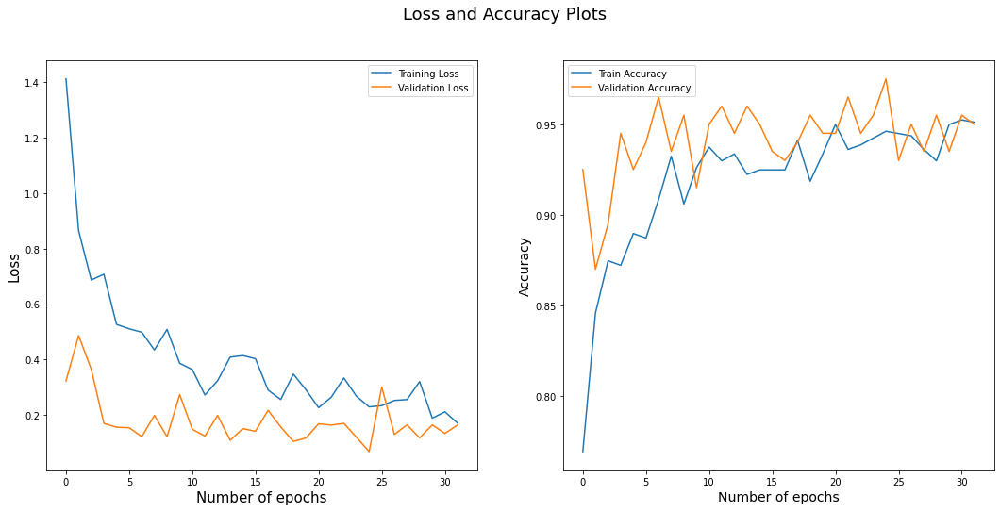

32/32 [==============================] - 1s 37ms/step
Round:  52
Test Accuracy:  0.86
Label Accuracy:  0.87
Number of catagory 1:  494.0
Number of catagory 2:  506.0
Model: "sequential_106"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_106 (Dropout)       (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Ep

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 134ms/step - loss: 1.3728 - acc: 0.7775 - val_loss: 0.4624 - val_acc: 0.8800
Epoch 2/32
25/25 [==============================] - 1s 60ms/step - loss: 0.9245 - acc: 0.8388 - val_loss: 0.2760 - val_acc: 0.9250
Epoch 3/32
25/25 [==============================] - 1s 56ms/step - loss: 0.7783 - acc: 0.8662 - val_loss: 0.3244 - val_acc: 0.9050
Epoch 4/32
25/25 [==============================] - 1s 53ms/step - loss: 0.6329 - acc: 0.8913 - val_loss: 0.2859 - val_acc: 0.9200
Epoch 5/32
25/25 [==============================] - 1s 58ms/step - loss: 0.6711 - acc: 0.8913 - val_loss: 0.1455 - val_acc: 0.9500
Epoch 6/32
25/25 [==============================] - 1s 56ms/step - loss: 0.5133 - acc: 0.8863 - val_loss: 0.2263 - val_acc: 0.9400
Epoch 7/32
25/25 [==============================] - 1s 55ms/step - loss: 0.4871 - acc: 0.9000 - val_loss: 0.1654 - val_acc: 0.9200
Epoch 8/32
25/25 [==============================] - 1s 57ms/step - loss: 0.4661 - acc: 0.9112

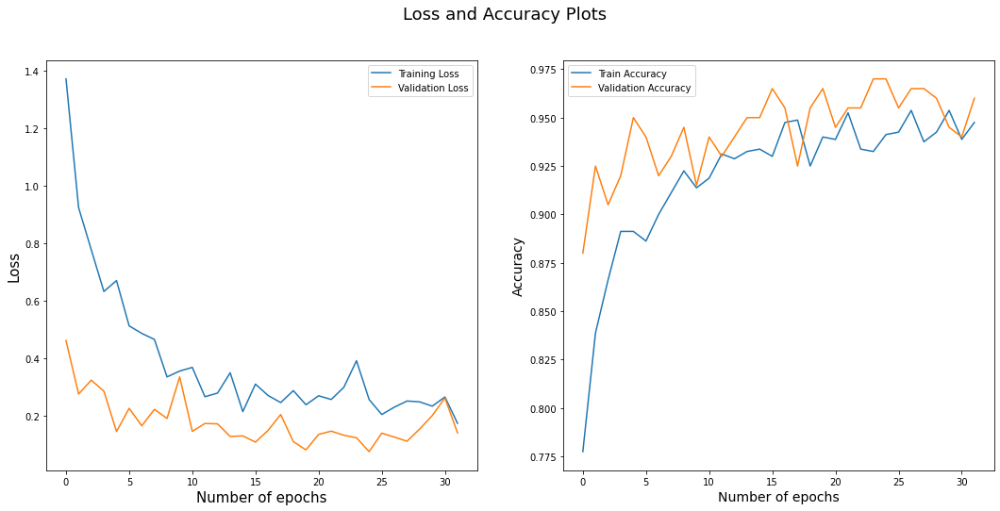

7/7 [==============================] - 2s 36ms/step
0.845


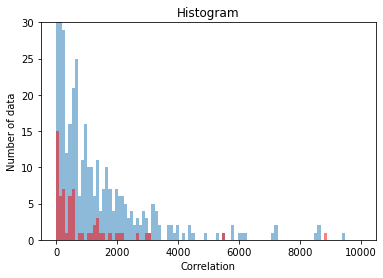

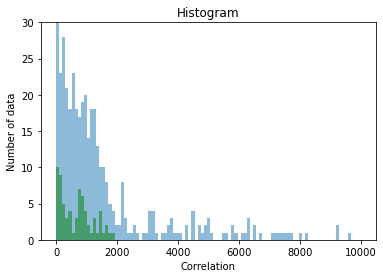

Model: "sequential_107"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_107 (Dropout)       (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 10s 139ms/step - loss: 1.6317 - acc: 0.7732 - val_loss: 0.4403 - val_acc: 0.8950
Epoch 2/32
25/25 [==============================] - 1s 57ms/step - loss: 0.9796 - acc: 0.8434 - val_loss: 0.3545 - val_acc: 0.8850
Epoch 3/32
25/25 [==============================] - 1s 57ms/step - loss: 0.8040 - acc: 0.8709 - val_loss: 0.1912 - val_acc: 0.9200
Epoch 4/32
25/25 [==============================] - 1s 57ms/step - loss: 0.5175 - acc: 0.8847 - val_loss: 0.3248 - val_acc: 0.9250
Epoch 5/32
25/25 [==============================] - 1s 53ms/step - loss: 0.6511 - acc: 0.8759 - val_loss: 0.1902 - val_acc: 0.9400
Epoch 6/32
25/25 [==============================] - 1s 57ms/step - loss: 0.4892 - acc: 0.9010 - val_loss: 0.1499 - val_acc: 0.9600
Epoch 7/32
25/25 [==============================] - 1s 55ms/step - loss: 0.3657 - acc: 0.9160 - val_loss: 0.1324 - val_acc: 0.9400
Epoch 8/32
25/25 [==============================] - 1s 50ms/step - loss: 0.4022 - acc: 0.923

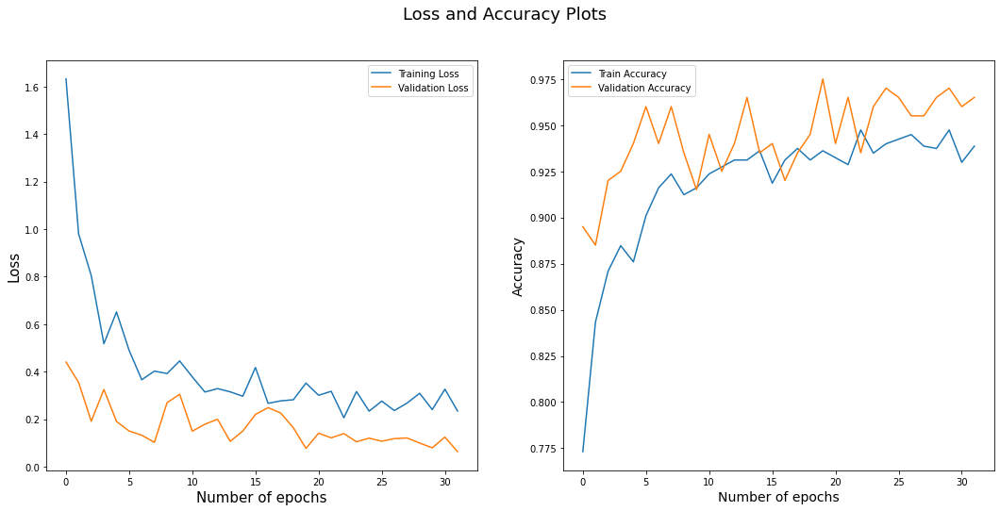

32/32 [==============================] - 1s 41ms/step
Round:  53
Test Accuracy:  0.875
Label Accuracy:  0.87
Number of catagory 1:  494.0
Number of catagory 2:  506.0
Model: "sequential_108"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_108 (Dropout)       (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
E

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 10s 142ms/step - loss: 1.5779 - acc: 0.7887 - val_loss: 0.3117 - val_acc: 0.9350
Epoch 2/32
25/25 [==============================] - 1s 57ms/step - loss: 1.0236 - acc: 0.8587 - val_loss: 0.2511 - val_acc: 0.9300
Epoch 3/32
25/25 [==============================] - 1s 56ms/step - loss: 0.6818 - acc: 0.8838 - val_loss: 0.2682 - val_acc: 0.9150
Epoch 4/32
25/25 [==============================] - 1s 54ms/step - loss: 0.6246 - acc: 0.8850 - val_loss: 0.2508 - val_acc: 0.9300
Epoch 5/32
25/25 [==============================] - 1s 58ms/step - loss: 0.5415 - acc: 0.8813 - val_loss: 0.2419 - val_acc: 0.9350
Epoch 6/32
25/25 [==============================] - 1s 56ms/step - loss: 0.5182 - acc: 0.8900 - val_loss: 0.3198 - val_acc: 0.9150
Epoch 7/32
25/25 [==============================] - 1s 56ms/step - loss: 0.4801 - acc: 0.8938 - val_loss: 0.2488 - val_acc: 0.9500
Epoch 8/32
25/25 [==============================] - 1s 54ms/step - loss: 0.4048 - acc: 0.911

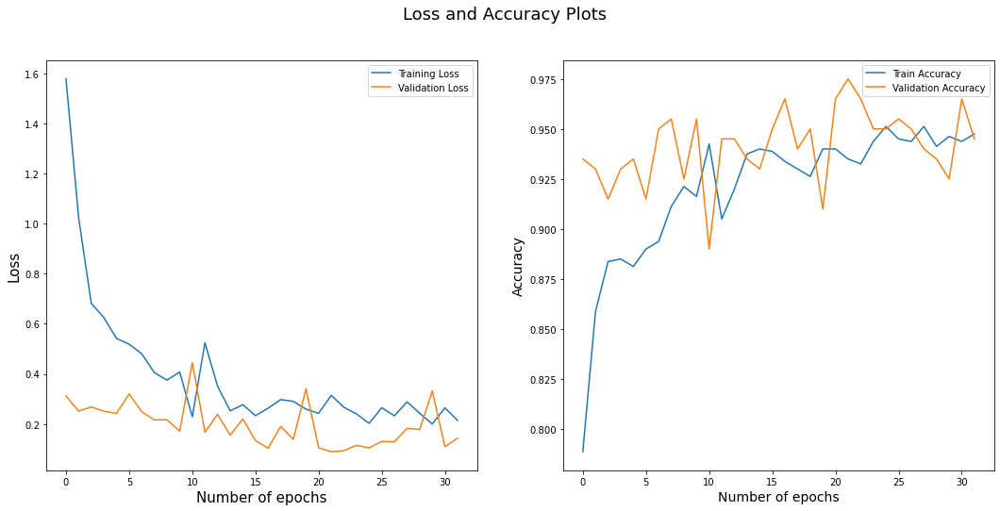

7/7 [==============================] - 2s 41ms/step
0.88


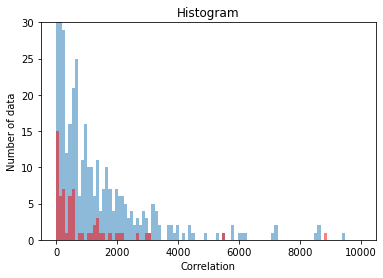

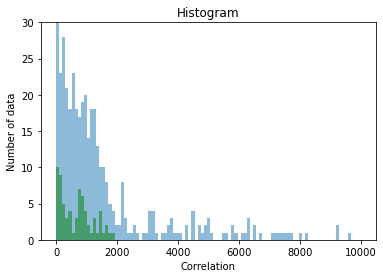

Model: "sequential_109"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_109 (Dropout)       (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 136ms/step - loss: 1.3283 - acc: 0.7820 - val_loss: 0.2444 - val_acc: 0.9450
Epoch 2/32
25/25 [==============================] - 1s 57ms/step - loss: 0.8068 - acc: 0.8596 - val_loss: 0.2633 - val_acc: 0.9250
Epoch 3/32
25/25 [==============================] - 1s 57ms/step - loss: 0.6532 - acc: 0.8810 - val_loss: 0.1640 - val_acc: 0.9250
Epoch 4/32
25/25 [==============================] - 1s 58ms/step - loss: 0.6124 - acc: 0.8872 - val_loss: 0.1595 - val_acc: 0.9400
Epoch 5/32
25/25 [==============================] - 1s 57ms/step - loss: 0.6594 - acc: 0.8935 - val_loss: 0.1950 - val_acc: 0.9300
Epoch 6/32
25/25 [==============================] - 1s 52ms/step - loss: 0.5371 - acc: 0.8935 - val_loss: 0.1458 - val_acc: 0.9350
Epoch 7/32
25/25 [==============================] - 1s 54ms/step - loss: 0.4401 - acc: 0.9098 - val_loss: 0.1427 - val_acc: 0.9400
Epoch 8/32
25/25 [==============================] - 1s 54ms/step - loss: 0.4014 - acc: 0.9173

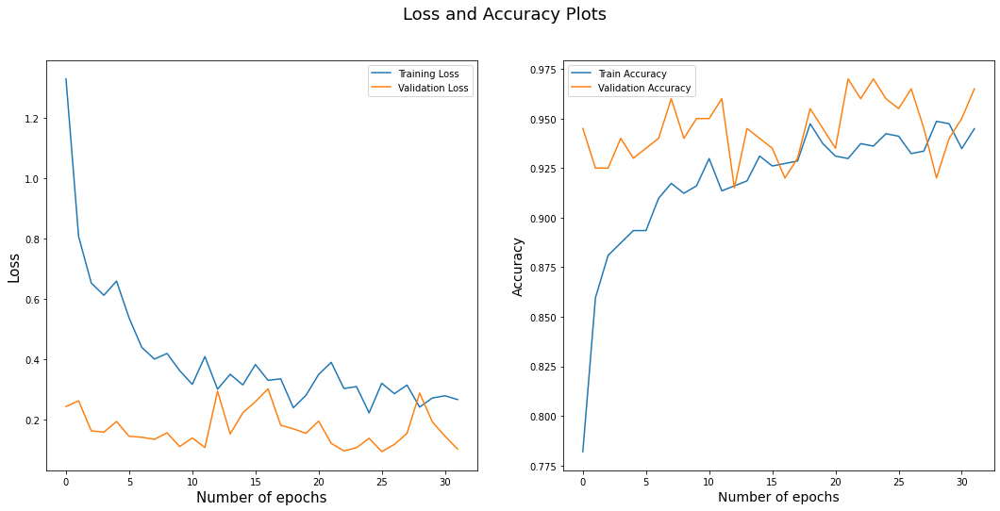

32/32 [==============================] - 1s 35ms/step
Round:  54
Test Accuracy:  0.865
Label Accuracy:  0.87
Number of catagory 1:  494.0
Number of catagory 2:  506.0
Model: "sequential_110"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_110 (Dropout)       (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
E

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 210ms/step - loss: 1.4812 - acc: 0.7788 - val_loss: 0.4306 - val_acc: 0.8850
Epoch 2/32
25/25 [==============================] - 1s 56ms/step - loss: 1.0466 - acc: 0.8500 - val_loss: 0.2971 - val_acc: 0.9250
Epoch 3/32
25/25 [==============================] - 2s 61ms/step - loss: 0.7414 - acc: 0.8775 - val_loss: 0.2390 - val_acc: 0.9400
Epoch 4/32
25/25 [==============================] - 1s 57ms/step - loss: 0.5956 - acc: 0.8825 - val_loss: 0.1975 - val_acc: 0.9450
Epoch 5/32
25/25 [==============================] - 1s 53ms/step - loss: 0.6704 - acc: 0.8788 - val_loss: 0.1669 - val_acc: 0.9500
Epoch 6/32
25/25 [==============================] - 1s 55ms/step - loss: 0.3582 - acc: 0.9212 - val_loss: 0.1841 - val_acc: 0.9400
Epoch 7/32
25/25 [==============================] - 1s 55ms/step - loss: 0.4971 - acc: 0.9000 - val_loss: 0.3041 - val_acc: 0.9150
Epoch 8/32
25/25 [==============================] - 1s 55ms/step - loss: 0.4831 - acc: 0.9000

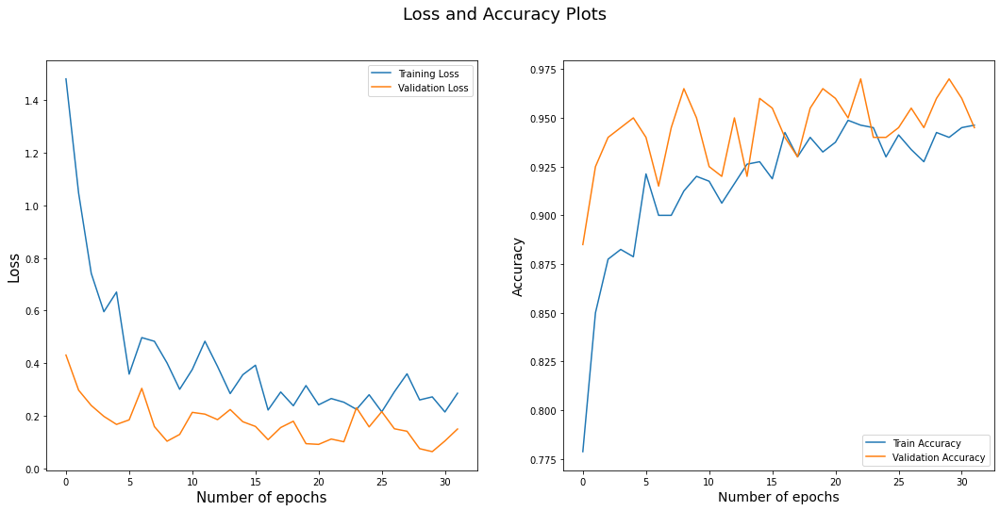

7/7 [==============================] - 3s 37ms/step
0.88


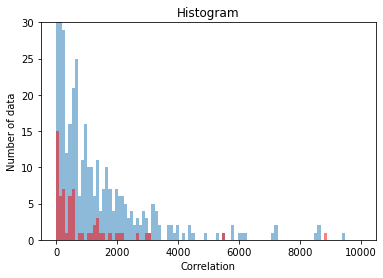

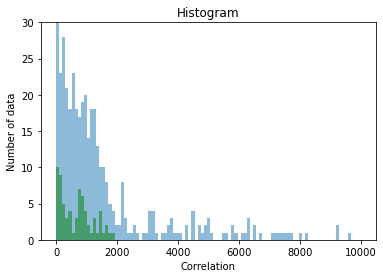

Model: "sequential_111"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_111 (Dropout)       (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 10s 149ms/step - loss: 1.4870 - acc: 0.7757 - val_loss: 0.3475 - val_acc: 0.9000
Epoch 2/32
25/25 [==============================] - 1s 56ms/step - loss: 1.1120 - acc: 0.8496 - val_loss: 0.4317 - val_acc: 0.8900
Epoch 3/32
25/25 [==============================] - 1s 56ms/step - loss: 0.8638 - acc: 0.8446 - val_loss: 0.1605 - val_acc: 0.9350
Epoch 4/32
25/25 [==============================] - 1s 57ms/step - loss: 0.7819 - acc: 0.8722 - val_loss: 0.1615 - val_acc: 0.9250
Epoch 5/32
25/25 [==============================] - 1s 58ms/step - loss: 0.7223 - acc: 0.8672 - val_loss: 0.1935 - val_acc: 0.9350
Epoch 6/32
25/25 [==============================] - 1s 56ms/step - loss: 0.6725 - acc: 0.8935 - val_loss: 0.1574 - val_acc: 0.9550
Epoch 7/32
25/25 [==============================] - 1s 58ms/step - loss: 0.4972 - acc: 0.9010 - val_loss: 0.2024 - val_acc: 0.9300
Epoch 8/32
25/25 [==============================] - 1s 56ms/step - loss: 0.5401 - acc: 0.904

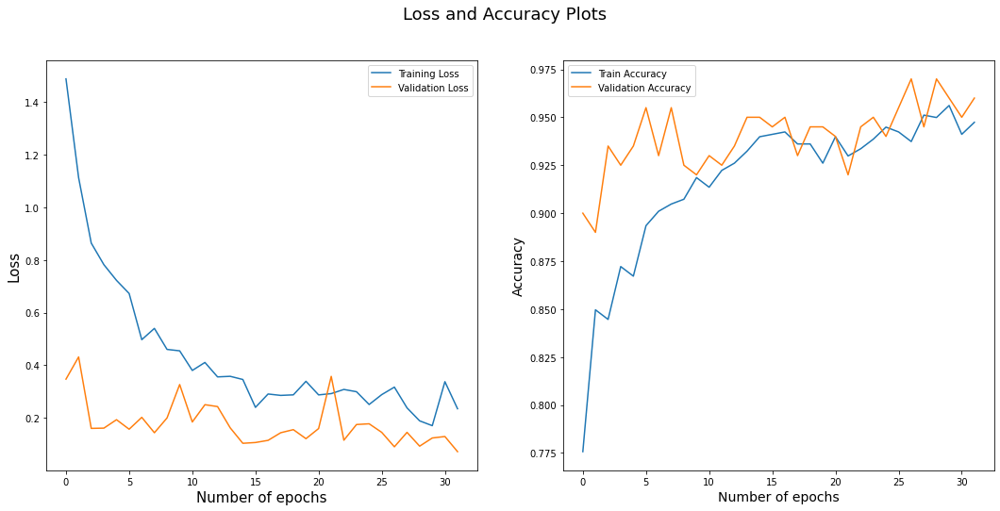

32/32 [==============================] - 1s 41ms/step
Round:  55
Test Accuracy:  0.855
Label Accuracy:  0.87
Number of catagory 1:  494.0
Number of catagory 2:  506.0
Model: "sequential_112"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_112 (Dropout)       (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
E

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 10s 144ms/step - loss: 1.3794 - acc: 0.7850 - val_loss: 0.2290 - val_acc: 0.9200
Epoch 2/32
25/25 [==============================] - 1s 59ms/step - loss: 0.9319 - acc: 0.8525 - val_loss: 0.2223 - val_acc: 0.9350
Epoch 3/32
25/25 [==============================] - 1s 56ms/step - loss: 0.6727 - acc: 0.8763 - val_loss: 0.3756 - val_acc: 0.9100
Epoch 4/32
25/25 [==============================] - 1s 61ms/step - loss: 0.7900 - acc: 0.8675 - val_loss: 0.1463 - val_acc: 0.9450
Epoch 5/32
25/25 [==============================] - 1s 58ms/step - loss: 0.7374 - acc: 0.8687 - val_loss: 0.2300 - val_acc: 0.9350
Epoch 6/32
25/25 [==============================] - 1s 56ms/step - loss: 0.6358 - acc: 0.8900 - val_loss: 0.3703 - val_acc: 0.9250
Epoch 7/32
25/25 [==============================] - 1s 56ms/step - loss: 0.5417 - acc: 0.9050 - val_loss: 0.2920 - val_acc: 0.9150
Epoch 8/32
25/25 [==============================] - 1s 57ms/step - loss: 0.4650 - acc: 0.905

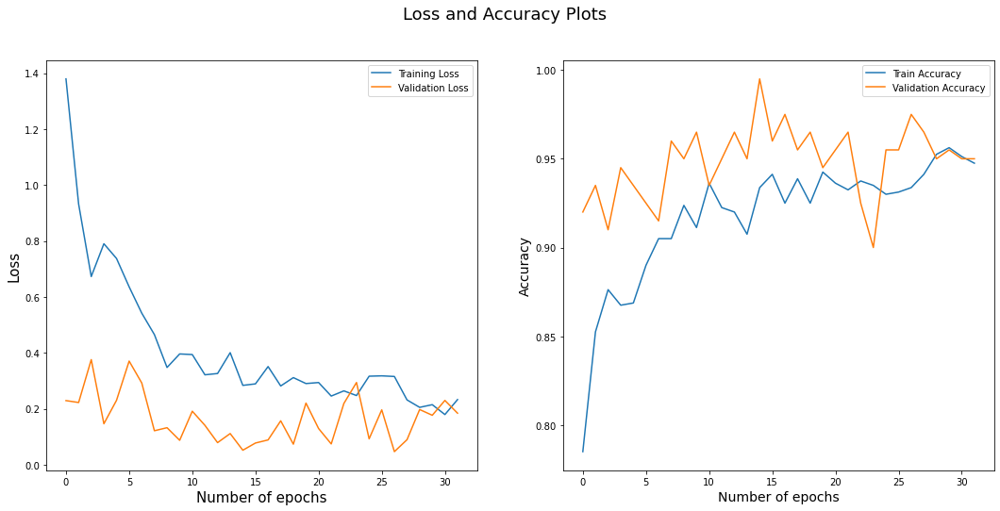

7/7 [==============================] - 2s 40ms/step
0.88


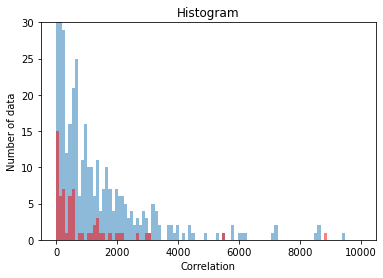

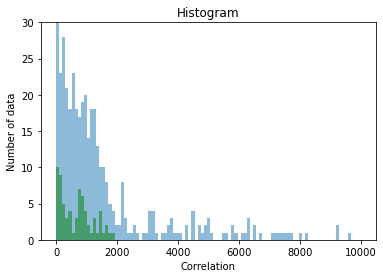

Model: "sequential_113"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_113 (Dropout)       (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 10s 141ms/step - loss: 1.5065 - acc: 0.7794 - val_loss: 0.2189 - val_acc: 0.9500
Epoch 2/32
25/25 [==============================] - 1s 54ms/step - loss: 0.9557 - acc: 0.8496 - val_loss: 0.2175 - val_acc: 0.9150
Epoch 3/32
25/25 [==============================] - 1s 53ms/step - loss: 0.6120 - acc: 0.8897 - val_loss: 0.2909 - val_acc: 0.9150
Epoch 4/32
25/25 [==============================] - 1s 55ms/step - loss: 0.5311 - acc: 0.8910 - val_loss: 0.2198 - val_acc: 0.9250
Epoch 5/32
25/25 [==============================] - 1s 54ms/step - loss: 0.4564 - acc: 0.9035 - val_loss: 0.1358 - val_acc: 0.9650
Epoch 6/32
25/25 [==============================] - 1s 57ms/step - loss: 0.4338 - acc: 0.8960 - val_loss: 0.1166 - val_acc: 0.9550
Epoch 7/32
25/25 [==============================] - 1s 60ms/step - loss: 0.4213 - acc: 0.9248 - val_loss: 0.1269 - val_acc: 0.9600
Epoch 8/32
25/25 [==============================] - 1s 58ms/step - loss: 0.4413 - acc: 0.918

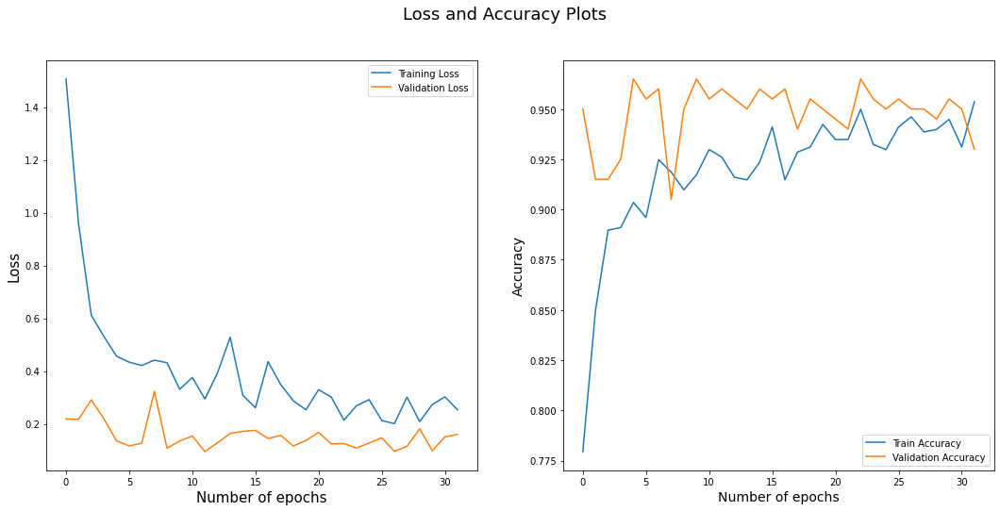

32/32 [==============================] - 1s 38ms/step
Round:  56
Test Accuracy:  0.875
Label Accuracy:  0.869
Number of catagory 1:  493.0
Number of catagory 2:  507.0
Model: "sequential_114"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_114 (Dropout)       (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 129ms/step - loss: 1.4634 - acc: 0.7800 - val_loss: 0.3479 - val_acc: 0.8950
Epoch 2/32
25/25 [==============================] - 1s 55ms/step - loss: 0.9728 - acc: 0.8537 - val_loss: 0.3732 - val_acc: 0.8900
Epoch 3/32
25/25 [==============================] - 1s 54ms/step - loss: 0.7405 - acc: 0.8700 - val_loss: 0.2020 - val_acc: 0.9250
Epoch 4/32
25/25 [==============================] - 1s 52ms/step - loss: 0.7285 - acc: 0.8763 - val_loss: 0.3058 - val_acc: 0.9450
Epoch 5/32
25/25 [==============================] - 1s 54ms/step - loss: 0.4313 - acc: 0.8950 - val_loss: 0.1949 - val_acc: 0.9500
Epoch 6/32
25/25 [==============================] - 1s 56ms/step - loss: 0.5334 - acc: 0.8975 - val_loss: 0.1514 - val_acc: 0.9650
Epoch 7/32
25/25 [==============================] - 1s 55ms/step - loss: 0.4529 - acc: 0.9062 - val_loss: 0.1250 - val_acc: 0.9550
Epoch 8/32
25/25 [==============================] - 1s 52ms/step - loss: 0.4060 - acc: 0.9212

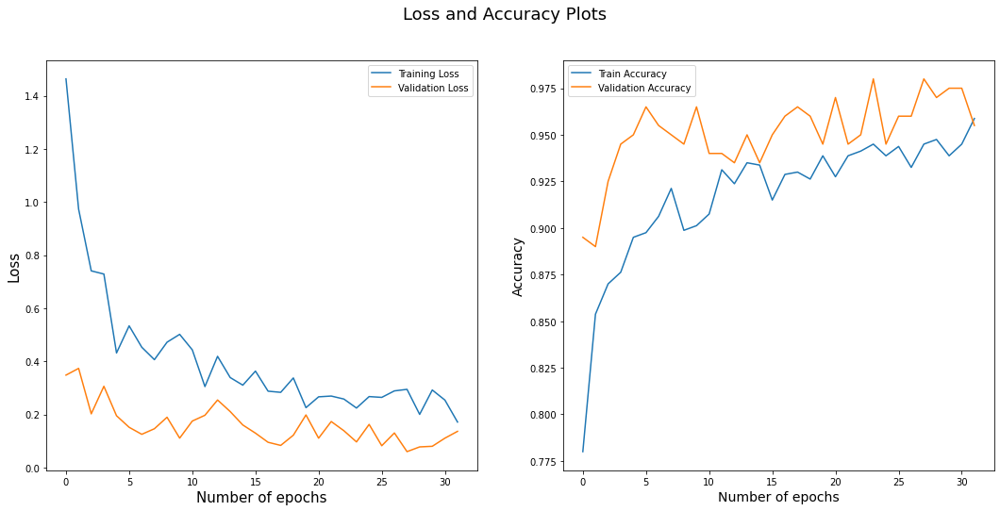

7/7 [==============================] - 2s 38ms/step
0.865


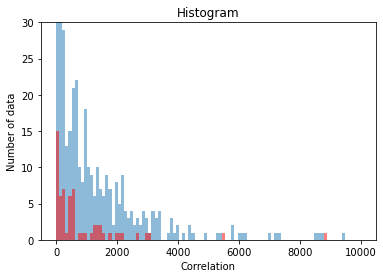

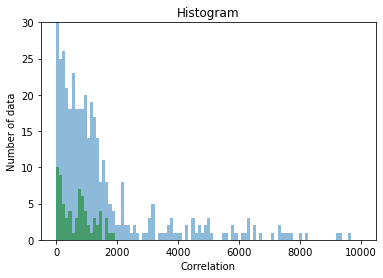

Model: "sequential_115"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_115 (Dropout)       (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 132ms/step - loss: 1.4226 - acc: 0.7807 - val_loss: 0.1979 - val_acc: 0.9500
Epoch 2/32
25/25 [==============================] - 1s 54ms/step - loss: 0.9360 - acc: 0.8571 - val_loss: 0.1647 - val_acc: 0.9450
Epoch 3/32
25/25 [==============================] - 1s 55ms/step - loss: 0.7482 - acc: 0.8684 - val_loss: 0.2773 - val_acc: 0.9250
Epoch 4/32
25/25 [==============================] - 1s 55ms/step - loss: 0.5768 - acc: 0.8810 - val_loss: 0.0875 - val_acc: 0.9600
Epoch 5/32
25/25 [==============================] - 1s 55ms/step - loss: 0.5429 - acc: 0.8897 - val_loss: 0.1360 - val_acc: 0.9450
Epoch 6/32
25/25 [==============================] - 1s 52ms/step - loss: 0.6424 - acc: 0.8985 - val_loss: 0.1293 - val_acc: 0.9400
Epoch 7/32
25/25 [==============================] - 1s 54ms/step - loss: 0.5269 - acc: 0.8897 - val_loss: 0.1090 - val_acc: 0.9550
Epoch 8/32
25/25 [==============================] - 1s 55ms/step - loss: 0.4045 - acc: 0.9060

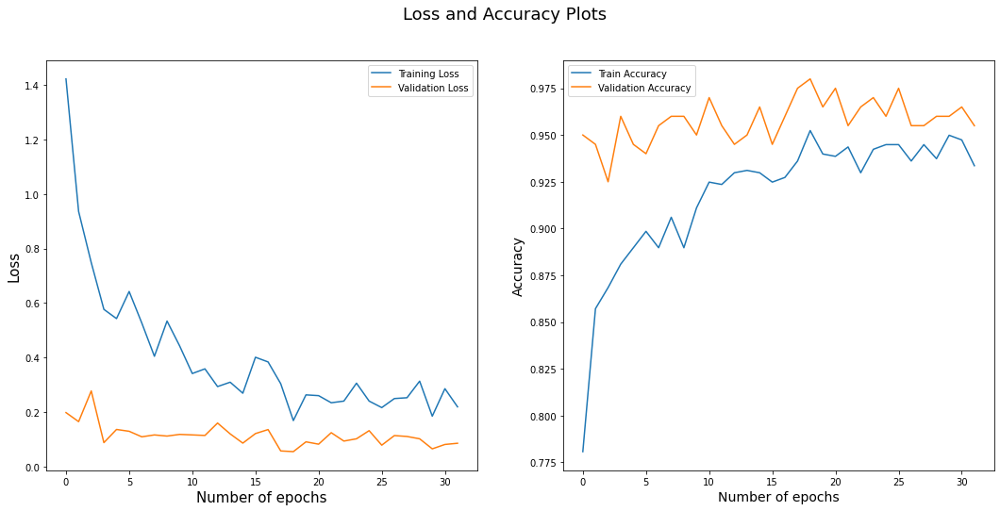

32/32 [==============================] - 1s 40ms/step
Round:  57
Test Accuracy:  0.885
Label Accuracy:  0.869
Number of catagory 1:  493.0
Number of catagory 2:  507.0
Model: "sequential_116"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_116 (Dropout)       (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 148ms/step - loss: 1.4349 - acc: 0.7700 - val_loss: 0.2280 - val_acc: 0.9400
Epoch 2/32
25/25 [==============================] - 1s 56ms/step - loss: 0.8498 - acc: 0.8625 - val_loss: 0.2092 - val_acc: 0.9250
Epoch 3/32
25/25 [==============================] - 1s 56ms/step - loss: 0.6392 - acc: 0.8813 - val_loss: 0.2267 - val_acc: 0.9200
Epoch 4/32
25/25 [==============================] - 1s 51ms/step - loss: 0.5760 - acc: 0.8888 - val_loss: 0.1618 - val_acc: 0.9400
Epoch 5/32
25/25 [==============================] - 1s 54ms/step - loss: 0.7285 - acc: 0.8875 - val_loss: 0.1220 - val_acc: 0.9400
Epoch 6/32
25/25 [==============================] - 1s 53ms/step - loss: 0.5940 - acc: 0.8813 - val_loss: 0.1456 - val_acc: 0.9500
Epoch 7/32
25/25 [==============================] - 1s 53ms/step - loss: 0.4791 - acc: 0.8938 - val_loss: 0.1980 - val_acc: 0.9450
Epoch 8/32
25/25 [==============================] - 1s 56ms/step - loss: 0.3967 - acc: 0.9162

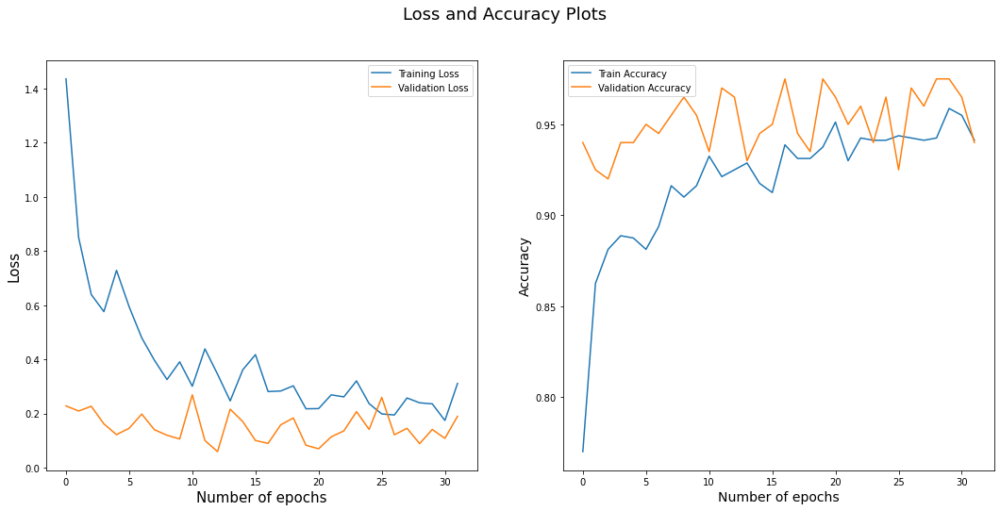

7/7 [==============================] - 2s 39ms/step
0.89


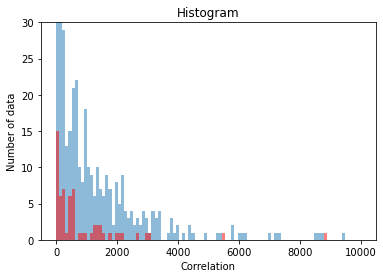

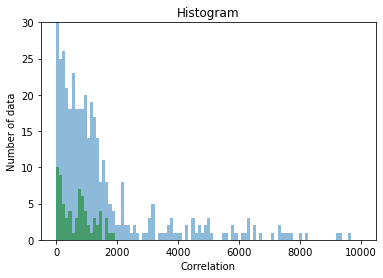

Model: "sequential_117"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_117 (Dropout)       (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 129ms/step - loss: 1.4182 - acc: 0.7657 - val_loss: 0.3490 - val_acc: 0.9000
Epoch 2/32
25/25 [==============================] - 1s 53ms/step - loss: 0.9395 - acc: 0.8596 - val_loss: 0.2118 - val_acc: 0.9150
Epoch 3/32
25/25 [==============================] - 1s 56ms/step - loss: 0.7063 - acc: 0.8772 - val_loss: 0.5285 - val_acc: 0.8900
Epoch 4/32
25/25 [==============================] - 1s 54ms/step - loss: 0.6420 - acc: 0.8897 - val_loss: 0.2819 - val_acc: 0.9250
Epoch 5/32
25/25 [==============================] - 1s 54ms/step - loss: 0.5931 - acc: 0.8822 - val_loss: 0.1881 - val_acc: 0.9200
Epoch 6/32
25/25 [==============================] - 1s 56ms/step - loss: 0.5145 - acc: 0.9073 - val_loss: 0.1395 - val_acc: 0.9450
Epoch 7/32
25/25 [==============================] - 1s 53ms/step - loss: 0.5024 - acc: 0.9060 - val_loss: 0.0947 - val_acc: 0.9600
Epoch 8/32
25/25 [==============================] - 1s 55ms/step - loss: 0.4604 - acc: 0.9110

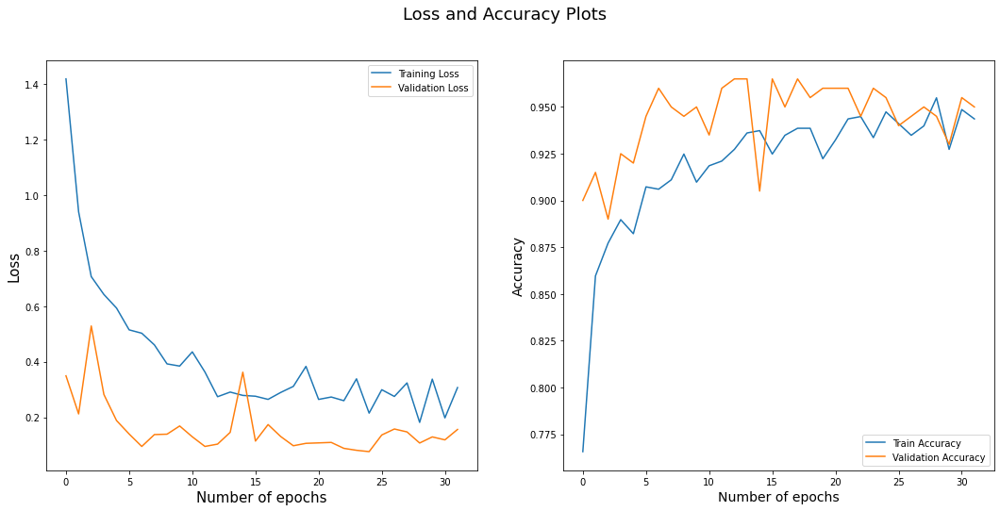

32/32 [==============================] - 1s 37ms/step
Round:  58
Test Accuracy:  0.885
Label Accuracy:  0.871
Number of catagory 1:  491.0
Number of catagory 2:  509.0
Model: "sequential_118"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_118 (Dropout)       (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 144ms/step - loss: 1.6215 - acc: 0.7788 - val_loss: 0.2722 - val_acc: 0.9500
Epoch 2/32
25/25 [==============================] - 1s 56ms/step - loss: 1.0374 - acc: 0.8425 - val_loss: 0.2109 - val_acc: 0.9400
Epoch 3/32
25/25 [==============================] - 1s 55ms/step - loss: 0.6150 - acc: 0.8913 - val_loss: 0.3230 - val_acc: 0.9100
Epoch 4/32
25/25 [==============================] - 1s 58ms/step - loss: 0.6582 - acc: 0.8825 - val_loss: 0.1740 - val_acc: 0.9550
Epoch 5/32
25/25 [==============================] - 1s 58ms/step - loss: 0.6706 - acc: 0.8763 - val_loss: 0.1545 - val_acc: 0.9500
Epoch 6/32
25/25 [==============================] - 1s 55ms/step - loss: 0.4830 - acc: 0.9087 - val_loss: 0.1301 - val_acc: 0.9500
Epoch 7/32
25/25 [==============================] - 1s 57ms/step - loss: 0.3818 - acc: 0.9075 - val_loss: 0.1168 - val_acc: 0.9650
Epoch 8/32
25/25 [==============================] - 1s 56ms/step - loss: 0.4742 - acc: 0.9062

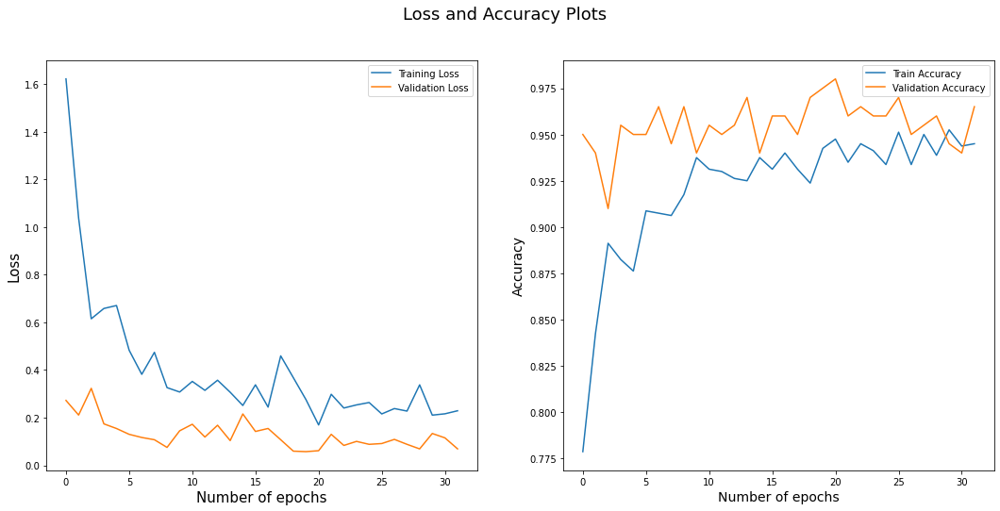

7/7 [==============================] - 2s 34ms/step
0.88


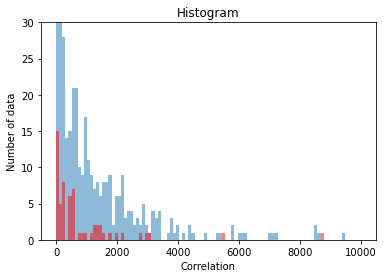

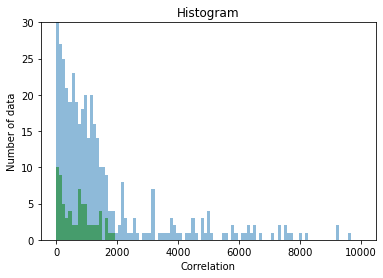

Model: "sequential_119"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_119 (Dropout)       (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 131ms/step - loss: 1.6236 - acc: 0.7970 - val_loss: 0.5223 - val_acc: 0.9150
Epoch 2/32
25/25 [==============================] - 1s 56ms/step - loss: 1.0160 - acc: 0.8622 - val_loss: 0.2722 - val_acc: 0.9150
Epoch 3/32
25/25 [==============================] - 1s 56ms/step - loss: 0.7650 - acc: 0.8734 - val_loss: 0.2748 - val_acc: 0.9200
Epoch 4/32
25/25 [==============================] - 1s 56ms/step - loss: 0.7423 - acc: 0.8797 - val_loss: 0.2275 - val_acc: 0.9200
Epoch 5/32
25/25 [==============================] - 1s 57ms/step - loss: 0.5215 - acc: 0.8935 - val_loss: 0.2985 - val_acc: 0.9250
Epoch 6/32
25/25 [==============================] - 1s 55ms/step - loss: 0.4871 - acc: 0.8972 - val_loss: 0.3560 - val_acc: 0.9200
Epoch 7/32
25/25 [==============================] - 1s 59ms/step - loss: 0.5059 - acc: 0.8910 - val_loss: 0.1895 - val_acc: 0.9400
Epoch 8/32
25/25 [==============================] - 1s 60ms/step - loss: 0.4888 - acc: 0.9110

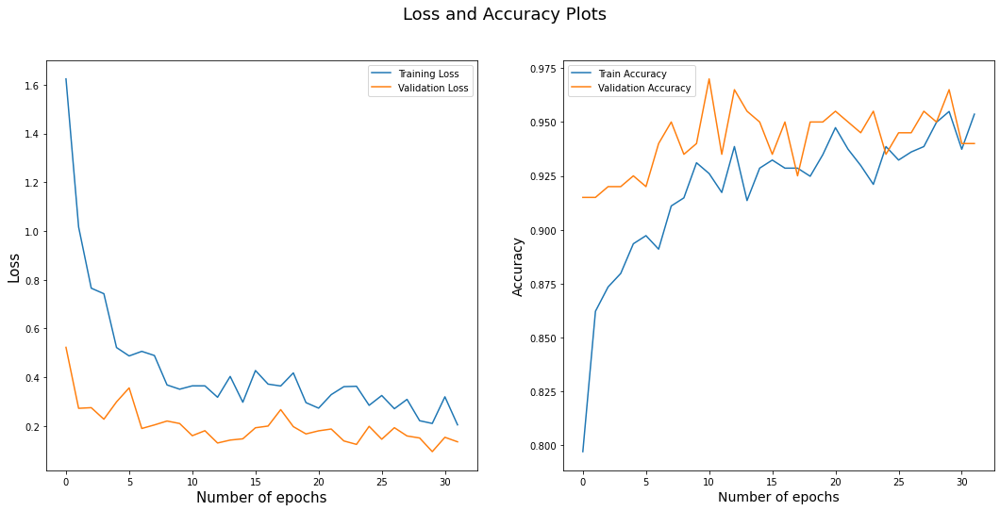

32/32 [==============================] - 1s 35ms/step
Round:  59
Test Accuracy:  0.87
Label Accuracy:  0.871
Number of catagory 1:  489.0
Number of catagory 2:  511.0
Model: "sequential_120"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_120 (Dropout)       (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
E

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 125ms/step - loss: 1.6213 - acc: 0.7625 - val_loss: 0.4097 - val_acc: 0.9100
Epoch 2/32
25/25 [==============================] - 1s 53ms/step - loss: 1.0385 - acc: 0.8462 - val_loss: 0.1204 - val_acc: 0.9500
Epoch 3/32
25/25 [==============================] - 1s 53ms/step - loss: 0.8499 - acc: 0.8600 - val_loss: 0.0711 - val_acc: 0.9750
Epoch 4/32
25/25 [==============================] - 1s 54ms/step - loss: 0.5841 - acc: 0.8850 - val_loss: 0.1243 - val_acc: 0.9550
Epoch 5/32
25/25 [==============================] - 1s 58ms/step - loss: 0.4867 - acc: 0.8950 - val_loss: 0.1287 - val_acc: 0.9550
Epoch 6/32
25/25 [==============================] - 1s 56ms/step - loss: 0.5088 - acc: 0.9100 - val_loss: 0.2031 - val_acc: 0.9500
Epoch 7/32
25/25 [==============================] - 1s 56ms/step - loss: 0.4071 - acc: 0.8988 - val_loss: 0.1168 - val_acc: 0.9500
Epoch 8/32
25/25 [==============================] - 1s 56ms/step - loss: 0.5015 - acc: 0.9087

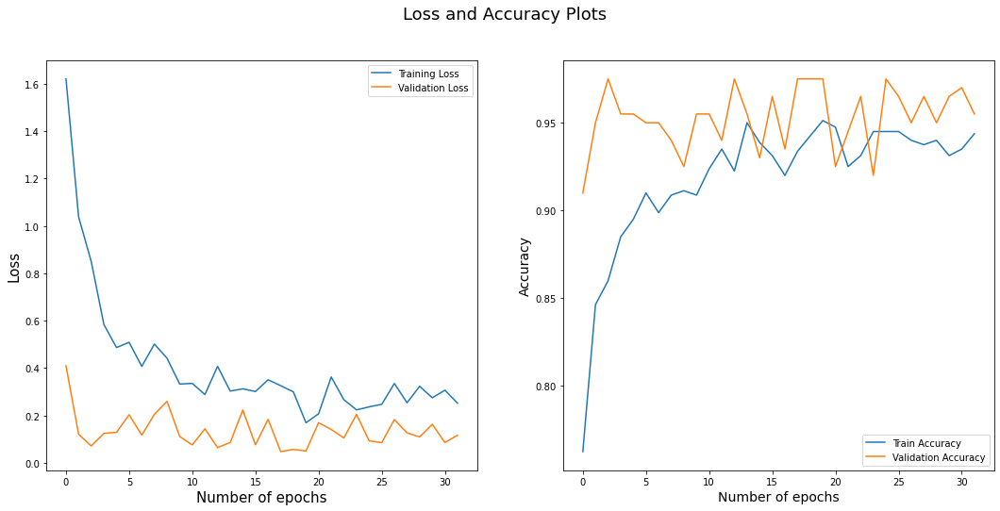

7/7 [==============================] - 2s 41ms/step
0.88


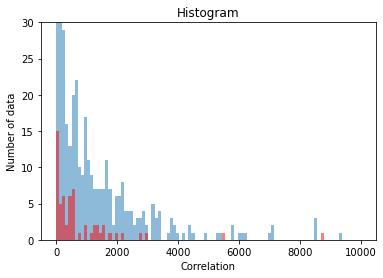

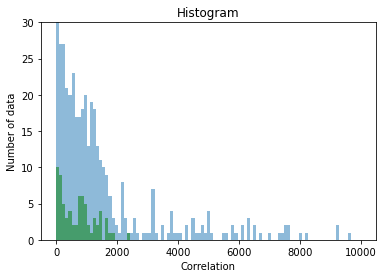

Model: "sequential_121"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_121 (Dropout)       (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 9s 169ms/step - loss: 1.3857 - acc: 0.7932 - val_loss: 0.3445 - val_acc: 0.9150
Epoch 2/32
25/25 [==============================] - 1s 57ms/step - loss: 0.8264 - acc: 0.8609 - val_loss: 0.3245 - val_acc: 0.9200
Epoch 3/32
25/25 [==============================] - 1s 56ms/step - loss: 0.6628 - acc: 0.8647 - val_loss: 0.2841 - val_acc: 0.9300
Epoch 4/32
25/25 [==============================] - 1s 54ms/step - loss: 0.4967 - acc: 0.9085 - val_loss: 0.2768 - val_acc: 0.9250
Epoch 5/32
25/25 [==============================] - 1s 56ms/step - loss: 0.6073 - acc: 0.8860 - val_loss: 0.1893 - val_acc: 0.9400
Epoch 6/32
25/25 [==============================] - 1s 54ms/step - loss: 0.5778 - acc: 0.8997 - val_loss: 0.2483 - val_acc: 0.9150
Epoch 7/32
25/25 [==============================] - 1s 58ms/step - loss: 0.4082 - acc: 0.9248 - val_loss: 0.1418 - val_acc: 0.9350
Epoch 8/32
25/25 [==============================] - 1s 52ms/step - loss: 0.5101 - acc: 0.9110

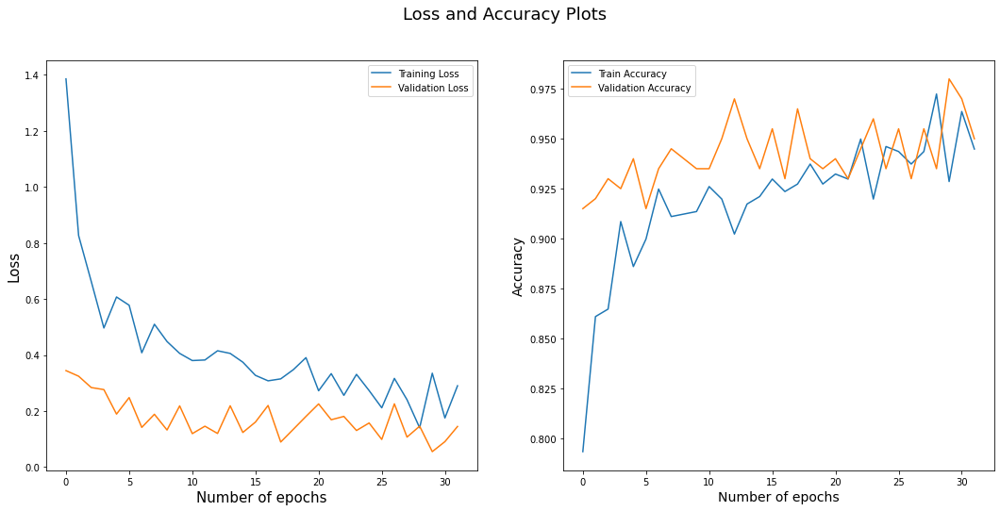

32/32 [==============================] - 1s 39ms/step
Round:  60
Test Accuracy:  0.865
Label Accuracy:  0.87
Number of catagory 1:  490.0
Number of catagory 2:  510.0
Model: "sequential_122"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_122 (Dropout)       (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
E

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 7s 122ms/step - loss: 1.3351 - acc: 0.7912 - val_loss: 0.1575 - val_acc: 0.9500
Epoch 2/32
25/25 [==============================] - 1s 54ms/step - loss: 0.9362 - acc: 0.8575 - val_loss: 0.2528 - val_acc: 0.9200
Epoch 3/32
25/25 [==============================] - 1s 52ms/step - loss: 0.7804 - acc: 0.8675 - val_loss: 0.2042 - val_acc: 0.9450
Epoch 4/32
25/25 [==============================] - 1s 57ms/step - loss: 0.5382 - acc: 0.8975 - val_loss: 0.3868 - val_acc: 0.9150
Epoch 5/32
25/25 [==============================] - 1s 51ms/step - loss: 0.7031 - acc: 0.8888 - val_loss: 0.4323 - val_acc: 0.9000
Epoch 6/32
25/25 [==============================] - 1s 53ms/step - loss: 0.5547 - acc: 0.9000 - val_loss: 0.2116 - val_acc: 0.9200
Epoch 7/32
25/25 [==============================] - 1s 52ms/step - loss: 0.4264 - acc: 0.8988 - val_loss: 0.1704 - val_acc: 0.9550
Epoch 8/32
25/25 [==============================] - 1s 52ms/step - loss: 0.3328 - acc: 0.9225

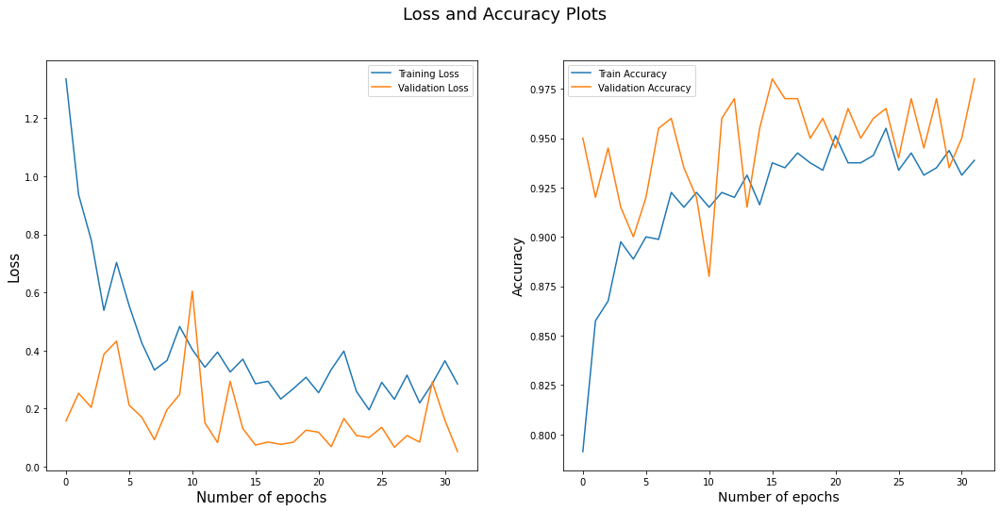

7/7 [==============================] - 2s 35ms/step
0.86


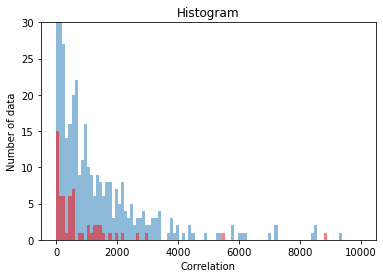

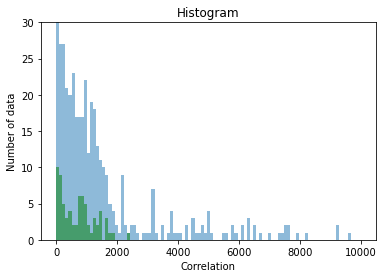

Model: "sequential_123"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_123 (Dropout)       (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 138ms/step - loss: 1.4686 - acc: 0.7882 - val_loss: 0.3027 - val_acc: 0.9150
Epoch 2/32
25/25 [==============================] - 1s 55ms/step - loss: 0.9064 - acc: 0.8534 - val_loss: 0.3685 - val_acc: 0.9200
Epoch 3/32
25/25 [==============================] - 1s 55ms/step - loss: 0.6652 - acc: 0.8722 - val_loss: 0.2698 - val_acc: 0.9250
Epoch 4/32
25/25 [==============================] - 1s 57ms/step - loss: 0.6567 - acc: 0.8797 - val_loss: 0.1992 - val_acc: 0.9400
Epoch 5/32
25/25 [==============================] - 1s 58ms/step - loss: 0.5394 - acc: 0.8960 - val_loss: 0.2897 - val_acc: 0.9150
Epoch 6/32
25/25 [==============================] - 1s 56ms/step - loss: 0.6020 - acc: 0.8935 - val_loss: 0.2467 - val_acc: 0.9200
Epoch 7/32
25/25 [==============================] - 1s 58ms/step - loss: 0.4615 - acc: 0.9060 - val_loss: 0.1733 - val_acc: 0.9500
Epoch 8/32
25/25 [==============================] - 1s 55ms/step - loss: 0.5116 - acc: 0.8997

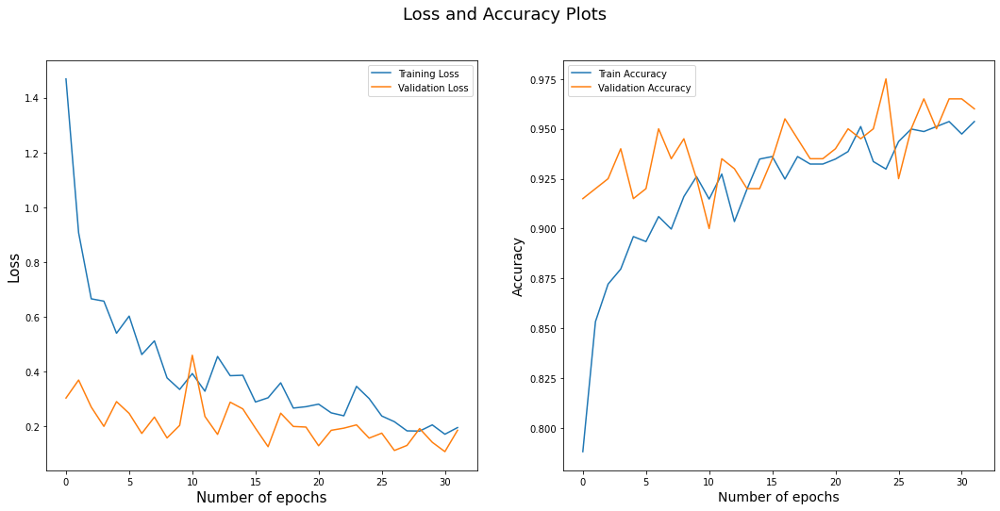

32/32 [==============================] - 1s 36ms/step
Round:  61
Test Accuracy:  0.855
Label Accuracy:  0.869
Number of catagory 1:  487.0
Number of catagory 2:  513.0
Model: "sequential_124"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_124 (Dropout)       (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 125ms/step - loss: 1.2974 - acc: 0.7875 - val_loss: 0.2230 - val_acc: 0.9450
Epoch 2/32
25/25 [==============================] - 1s 54ms/step - loss: 0.9433 - acc: 0.8525 - val_loss: 0.1704 - val_acc: 0.9500
Epoch 3/32
25/25 [==============================] - 1s 53ms/step - loss: 0.6309 - acc: 0.8650 - val_loss: 0.1182 - val_acc: 0.9700
Epoch 4/32
25/25 [==============================] - 1s 53ms/step - loss: 0.6478 - acc: 0.8875 - val_loss: 0.1284 - val_acc: 0.9550
Epoch 5/32
25/25 [==============================] - 1s 56ms/step - loss: 0.4502 - acc: 0.8988 - val_loss: 0.1862 - val_acc: 0.9200
Epoch 6/32
25/25 [==============================] - 1s 53ms/step - loss: 0.4482 - acc: 0.9013 - val_loss: 0.1388 - val_acc: 0.9600
Epoch 7/32
25/25 [==============================] - 1s 54ms/step - loss: 0.4407 - acc: 0.9187 - val_loss: 0.2753 - val_acc: 0.9400
Epoch 8/32
25/25 [==============================] - 1s 52ms/step - loss: 0.3583 - acc: 0.9237

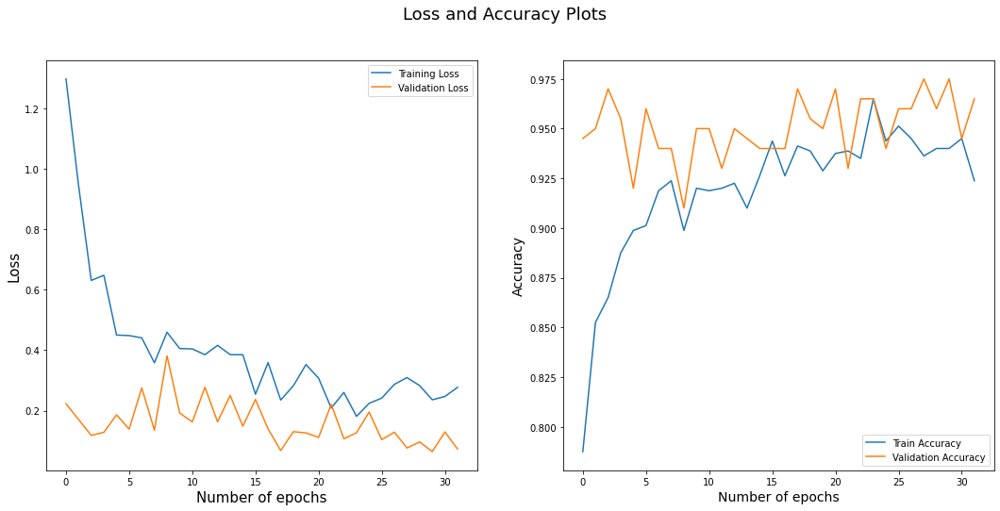

7/7 [==============================] - 2s 37ms/step
0.89


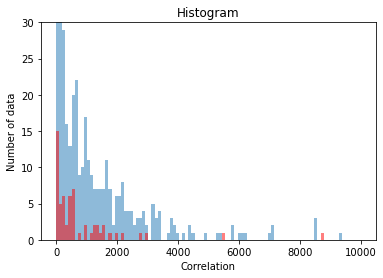

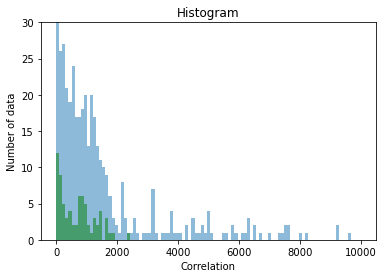

Model: "sequential_125"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_125 (Dropout)       (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 126ms/step - loss: 1.3320 - acc: 0.7882 - val_loss: 0.3803 - val_acc: 0.9250
Epoch 2/32
25/25 [==============================] - 1s 56ms/step - loss: 0.8199 - acc: 0.8684 - val_loss: 0.2316 - val_acc: 0.9150
Epoch 3/32
25/25 [==============================] - 1s 54ms/step - loss: 0.7478 - acc: 0.8734 - val_loss: 0.3230 - val_acc: 0.9000
Epoch 4/32
25/25 [==============================] - 1s 57ms/step - loss: 0.6270 - acc: 0.8822 - val_loss: 0.1616 - val_acc: 0.9300
Epoch 5/32
25/25 [==============================] - 1s 57ms/step - loss: 0.4699 - acc: 0.9035 - val_loss: 0.2806 - val_acc: 0.9150
Epoch 6/32
25/25 [==============================] - 1s 57ms/step - loss: 0.5427 - acc: 0.8985 - val_loss: 0.2722 - val_acc: 0.8850
Epoch 7/32
25/25 [==============================] - 1s 59ms/step - loss: 0.4608 - acc: 0.8997 - val_loss: 0.1298 - val_acc: 0.9650
Epoch 8/32
25/25 [==============================] - 1s 58ms/step - loss: 0.3520 - acc: 0.9173

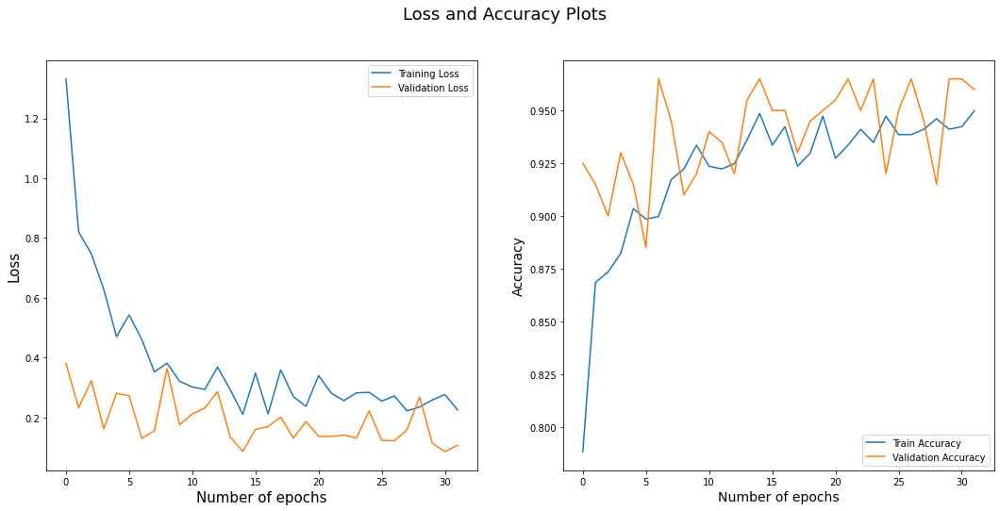

32/32 [==============================] - 1s 36ms/step
Round:  62
Test Accuracy:  0.87
Label Accuracy:  0.869
Number of catagory 1:  487.0
Number of catagory 2:  513.0
Model: "sequential_126"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_126 (Dropout)       (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
E

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 7s 122ms/step - loss: 1.3014 - acc: 0.7750 - val_loss: 0.3484 - val_acc: 0.9100
Epoch 2/32
25/25 [==============================] - 1s 53ms/step - loss: 0.8448 - acc: 0.8600 - val_loss: 0.2841 - val_acc: 0.9100
Epoch 3/32
25/25 [==============================] - 1s 53ms/step - loss: 0.5992 - acc: 0.8838 - val_loss: 0.1739 - val_acc: 0.9300
Epoch 4/32
25/25 [==============================] - 1s 55ms/step - loss: 0.5722 - acc: 0.8825 - val_loss: 0.2565 - val_acc: 0.9100
Epoch 5/32
25/25 [==============================] - 1s 55ms/step - loss: 0.5213 - acc: 0.8938 - val_loss: 0.2347 - val_acc: 0.9250
Epoch 6/32
25/25 [==============================] - 1s 57ms/step - loss: 0.3948 - acc: 0.9087 - val_loss: 0.1985 - val_acc: 0.9250
Epoch 7/32
25/25 [==============================] - 1s 58ms/step - loss: 0.5427 - acc: 0.8963 - val_loss: 0.2536 - val_acc: 0.9200
Epoch 8/32
25/25 [==============================] - 1s 53ms/step - loss: 0.4562 - acc: 0.9038

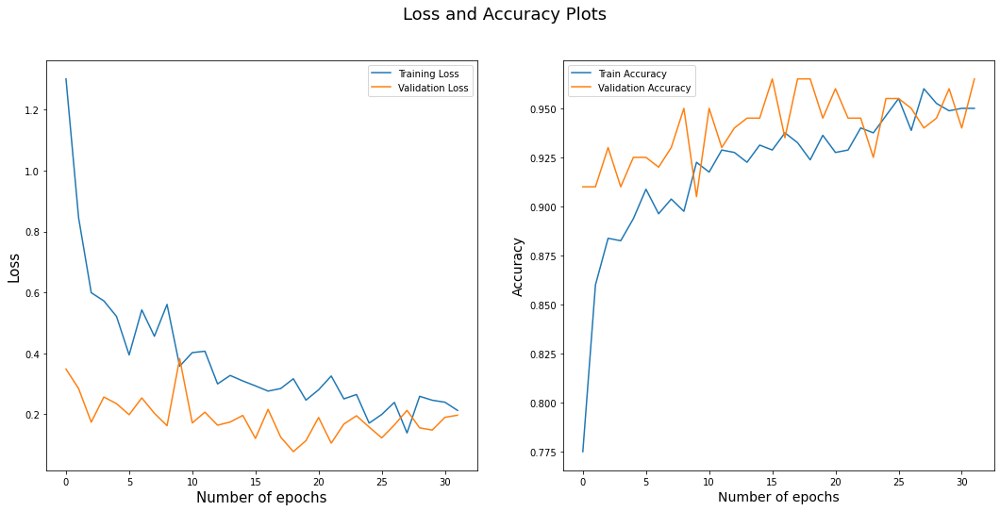

7/7 [==============================] - 2s 33ms/step
0.89


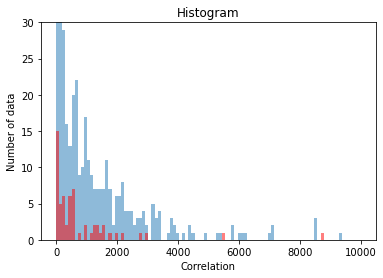

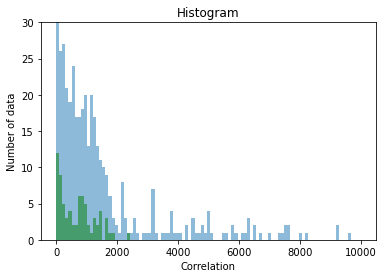

Model: "sequential_127"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_127 (Dropout)       (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


25/25 [==============================] - 8s 123ms/step - loss: 1.2186 - acc: 0.7932 - val_loss: 0.2403 - val_acc: 0.9250
Epoch 2/32
25/25 [==============================] - 1s 58ms/step - loss: 1.0953 - acc: 0.8471 - val_loss: 0.2918 - val_acc: 0.9100
Epoch 3/32
25/25 [==============================] - 1s 57ms/step - loss: 0.7651 - acc: 0.8772 - val_loss: 0.1760 - val_acc: 0.9150
Epoch 4/32
25/25 [==============================] - 1s 56ms/step - loss: 0.6198 - acc: 0.8784 - val_loss: 0.3315 - val_acc: 0.9100
Epoch 5/32
25/25 [==============================] - 1s 50ms/step - loss: 0.5579 - acc: 0.8910 - val_loss: 0.1629 - val_acc: 0.9350
Epoch 6/32
25/25 [==============================] - 1s 54ms/step - loss: 0.6058 - acc: 0.8822 - val_loss: 0.1161 - val_acc: 0.9500
Epoch 7/32
25/25 [==============================] - 1s 58ms/step - loss: 0.4205 - acc: 0.9160 - val_loss: 0.1280 - val_acc: 0.9400
Epoch 8/32
25/25 [==============================] - 1s 60ms/step - loss: 0.4193 - acc: 0.9060

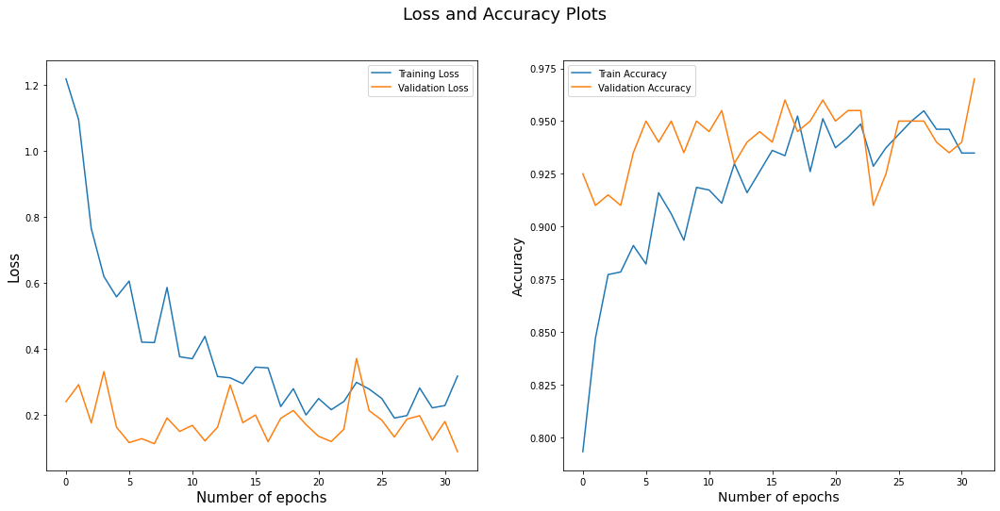

32/32 [==============================] - 1s 39ms/step
Round:  63
Test Accuracy:  0.87
Label Accuracy:  0.87
Number of catagory 1:  486.0
Number of catagory 2:  514.0


In [1]:
np.random.seed(0)

(X_c, y_c), (X_test_c, y_test_c) = cifar100.load_data()

fine_label_list =  ['apple', 'aquarium_fish', 'baby', 'bear', 'beaver', 'bed', 'bee', 'beetle', 'bicycle', 'bottle', 'bowl', 'boy', 'bridge', 'bus', 'butterfly', 
                    'camel', 'can', 'castle', 'caterpillar', 'cattle', 'chair', 'chimpanzee', 'clock', 'cloud', 'cockroach', 'couch', 'crab', 'crocodile', 'cup', 
                    'dinosaur', 'dolphin', 'elephant', 'flatfish', 'forest', 'fox', 'girl', 'hamster', 'house', 'kangaroo', 'computer_keyboard', 
                    'lamp', 'lawn_mower', 'leopard', 'lion', 'lizard', 'lobster', 'man', 'maple_tree', 'motorcycle', 'mountain', 'mouse', 'mushroom', 
                    'oak_tree', 'orange', 'orchid', 'otter', 'palm_tree', 'pear', 'pickup_truck', 'pine_tree', 'plain', 'plate', 'poppy', 'porcupine', 'possum', 
                    'rabbit', 'raccoon', 'ray', 'road', 'rocket', 'rose', 
                    'sea', 'seal', 'shark', 'shrew', 'skunk', 'skyscraper', 'snail', 'snake', 'spider', 'squirrel', 'streetcar', 'sunflower', 'sweet_pepper', 
                    'table', 'tank', 'telephone', 'television', 'tiger', 'tractor', 'train', 'trout', 'tulip', 'turtle', 
                    'wardrobe', 'whale', 'willow_tree', 'wolf', 'woman', 'worm']

def label_shiftting(y, p = 0.2):
    L0 = np.where(y == 0)[0]
    L1 = np.where(y == 1)[0]
    A0 = np.random.choice(500, size=int(500*p), replace=False)
    A1 = np.random.choice(500, size=int(500*p), replace=False)
    y[L0[A0]] = 1
    y[L1[A1]] = 0
    return y, L0[A0], L1[A1]
 
X = []
y = []
for i,x in enumerate(X_c):
    if fine_label_list[y_c[i][0]] == 'caterpillar':
        X.append(x)
        y.append(0)
    elif fine_label_list[y_c[i][0]] == 'worm':
        X.append(x)
        y.append(1)
        
X_test = []
y_test = []
for i,x in enumerate(X_test_c):
    if fine_label_list[y_test_c[i][0]] == 'caterpillar':
        X_test.append(x)
        y_test.append(0)
    elif fine_label_list[y_test_c[i][0]] == 'worm':
        X_test.append(x)
        y_test.append(1)

X = np.array(X)
y = np.array(y)
y_shifted, L01, L10 = label_shiftting(y.copy(), p = 0.2)
y_shifted = to_categorical(y_shifted, 2)

X_test = np.array(X_test)
y_test = np.array(y_test)


#---Train---
from tensorflow.compat.v1.keras.applications import ResNet101

res = ResNet101(weights='imagenet', include_top = False, classes = 2, input_shape=(32,32,3))

Label_Accuracy = []
Test_Accuracy = []
Test_Accurracy_0 = []

Rounds = 64


for Round in range(Rounds):
    model = Sequential()
    
    model.add(res)
    # model.add(GlobalAveragePooling2D(name='penultimate'))
    model.add(Flatten(name='penultimate'))
    
    model.add(Dropout(0.5))
    model.add(Dense(2, activation = 'softmax', name='dense'))
    res.trainable = False
    model.summary()
    
    lr = 1e-3
    sgd = SGD(lr = lr, momentum = 0.9, nesterov = True)
    model.compile(loss = 'categorical_crossentropy', optimizer = sgd, metrics = ['acc'])
    
    hist = model.fit(x=X, y=y_shifted, batch_size=32, epochs=32, verbose=1, callbacks=None, validation_split=0.2, validation_data=None, shuffle=True, class_weight=None, sample_weight=None, initial_epoch=0, steps_per_epoch=None, validation_steps=None)
    
    
    
    plt.figure(figsize=(18,8))
    
    plt.suptitle('Loss and Accuracy Plots', fontsize=18)
    
    plt.subplot(1,2,1)
    plt.plot(hist.history['loss'], label='Training Loss')
    plt.plot(hist.history['val_loss'], label='Validation Loss')
    plt.legend()
    plt.xlabel('Number of epochs', fontsize=15)
    plt.ylabel('Loss', fontsize=15)
    
    plt.subplot(1,2,2)
    plt.plot(hist.history['acc'], label='Train Accuracy')
    plt.plot(hist.history['val_acc'], label='Validation Accuracy')
    plt.legend()
    plt.xlabel('Number of epochs', fontsize=14)
    plt.ylabel('Accuracy', fontsize=14)
    plt.show()
    
    
    y_pred = model.predict(X_test, verbose=1)
    y_pred = np.argmax(y_pred, axis = 1)
    print(accuracy_score(y_test, y_pred))
    Test_Accurracy_0.append(accuracy_score(y_test, y_pred))
    
    sub_model = tf.keras.Model(inputs = model.input, outputs = model.get_layer('penultimate').output)
    R = sub_model.predict(X)
    
    preserved_index = []
    relabel_index = []
    
    T_index = [-1 for i in range(1000)]
    for catagory in [0, 1]:
        R_c = R[y_shifted[:,catagory] == 1]
        R_hat = np.average(R_c, axis=0)
        M = R_c.copy()
        for i in range(len(M)):
            M[i] -= R_hat
        u, s, vh = np.linalg.svd(M, full_matrices=True)
        v = vh[0]
        
        T = []
        T00 = []
        T01 = []
        T10 = []
        for i, r in enumerate(R):
            if y_shifted[i, catagory] == 1:
                T.append((np.dot((r-R_hat), v)**2))
                T_index[i] = len(T)-1
                
                if (y_shifted[i] == to_categorical(y, 2)[i]).all():
                    T00.append((np.dot((r-R_hat), v)**2))
                elif y_shifted[i][0] == 1:
                    T01.append((np.dot((r-R_hat), v)**2))
                elif y_shifted[i][0] == 0:
                    T10.append((np.dot((r-R_hat), v)**2))
        
        bins = np.linspace(0, 10000, 100)
        n, bins, patches=plt.hist(T00,alpha = 0.5,bins=bins)
        n, bins, patches=plt.hist(T01,bins=bins,alpha = 0.5,color='red')
        n, bins, patches=plt.hist(T10,bins=bins,alpha = 0.5,color='green')
        plt.ylim(0, 30)
        plt.xlabel("Correlation")
        plt.ylabel("Number of data")
        plt.title("Histogram")
        plt.show()
    
        S = sorted(range(len(T)), key=lambda k: T[k])
        # d = T[S[int(len(M) * (1 - 0.25 * (1 - (Round / Rounds))))]]
        d = T[S[int(len(M) * (1 - 0.25 * 0.5**Round))-1]]
        # rl = T[S[int(len(M) * (1 - 0.5**Round))]]
        # d = T[S[int(len(M) * (1 - 0.25))]]
        # rl = T[S[int(500*(1-0.1))]]
        for i, r in enumerate(R):
            if y_shifted[i, catagory] == 1 and T[T_index[i]] < d:
                preserved_index.append(i)
            # if y_shifted[i, catagory] == 1 and T[T_index[i]] >= rl:
            #     relabel_index.append(i)
                
    
    preserved_index.sort()
    relabel_index.sort()
    X_p = X[preserved_index]
    y_p = y_shifted.copy()
    y_p = y_p[preserved_index]
    
    
    
    model = Sequential()
    model.add(res)
    # model.add(GlobalAveragePooling2D(name='GAP'))
    model.add(Flatten(name='FC'))
    # 
    model.add(Dropout(0.5))
    model.add(Dense(2, activation = 'softmax', name='dense'))
    res.trainable = False
    model.summary()
    
    lr = 1e-3
    sgd = SGD(lr = lr, momentum = 0.9, nesterov = True)
    model.compile(loss = 'categorical_crossentropy', optimizer = sgd, metrics = ['acc'])
    
    hist = model.fit(x=X_p, y=y_p, batch_size=32, epochs=32, verbose=1, callbacks=None, validation_split=0.2, validation_data=None, shuffle=True, class_weight=None, sample_weight=None, initial_epoch=0, steps_per_epoch=None, validation_steps=None)
    
    plt.figure(figsize=(18,8))
    
    plt.suptitle('Loss and Accuracy Plots', fontsize=18)
    
    plt.subplot(1,2,1)
    plt.plot(hist.history['loss'], label='Training Loss')
    plt.plot(hist.history['val_loss'], label='Validation Loss')
    plt.legend()
    plt.xlabel('Number of epochs', fontsize=15)
    plt.ylabel('Loss', fontsize=15)
    
    plt.subplot(1,2,2)
    plt.plot(hist.history['acc'], label='Train Accuracy')
    plt.plot(hist.history['val_acc'], label='Validation Accuracy')
    plt.legend()
    plt.xlabel('Number of epochs', fontsize=14)
    plt.ylabel('Accuracy', fontsize=14)
    plt.show()
    
    y_pred = model.predict(X_test, verbose=1)
    y_pred = np.argmax(y_pred, axis = 1)
    
    y_new_pred = model.predict(X, verbose=1)
    y_new = np.argmax(y_new_pred, axis = 1)
    
    # for i in relabel_index:
    for i in range(1000):
        if max(y_new_pred[i]) > 0.99: 
            y_shifted[i] = to_categorical(y_new, 2)[i]
    
    print('Round: ', Round)
    print('Test Accuracy: ', accuracy_score(y_test, y_pred))
    print('Label Accuracy: ', accuracy_score(y, y_shifted[:,1]))
    print('Number of catagory 1: ', np.sum(y_shifted[:,0]))
    print('Number of catagory 2: ', np.sum(y_shifted[:,1]))
    Label_Accuracy.append(accuracy_score(y, y_shifted[:,1]))
    Test_Accuracy.append(accuracy_score(y_test, y_pred))

In [1]:
np.random.seed(0)

# (X_c, y_c), (X_test_c, y_test_c) = cifar100.load_data()
# real-world cifar10 dataset
noise_label = torch.load('./data/CIFAR-10_human.pt')
clean_label = noise_label['clean_label']
worst_label = noise_label['worse_label']
aggre_label = noise_label['aggre_label']
random_label1 = noise_label['random_label1']
random_label2 = noise_label['random_label2']
random_label3 = noise_label['random_label3']

train_dataset,test_dataset,num_classes,num_training_samples = input_dataset('cifar10', 'clean', './data/CIFAR-10_human.pt', True)
X_c = train_dataset.train_data
y_c = aggre_label
X_test_c = test_dataset.test_data
y_test_c = test_dataset.test_labels

fine_label_list = ['airplane', 'automobile', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck']

def label_shiftting(y, p = 0.2):
    L0 = np.where(y == 0)[0]
    L1 = np.where(y == 1)[0]
    A0 = np.random.choice(500, size=int(500*p), replace=False)
    A1 = np.random.choice(500, size=int(500*p), replace=False)
    y[L0[A0]] = 1
    y[L1[A1]] = 0
    return y, L0[A0], L1[A1]
 
X = []
y = []
for i,x in enumerate(X_c):
    if fine_label_list[y_c[i]] == 'automobile':
        X.append(x)
        y.append(0)
    elif fine_label_list[y_c[i]] == 'truck':
        X.append(x)
        y.append(1)
        
X_test = []
y_test = []
for i,x in enumerate(X_test_c):
    if fine_label_list[y_test_c[i]] == 'automobile':
        X_test.append(x)
        y_test.append(0)
    elif fine_label_list[y_test_c[i]] == 'truck':
        X_test.append(x)
        y_test.append(1)

X = np.array(X)
y = np.array(y)
# y_shifted, L01, L10 = label_shiftting(y.copy(), p = 0.2)
y_shifted = to_categorical(y.copy(), 2)

X_test = np.array(X_test)
y_test = np.array(y_test)




Files already downloaded and verified


2022-01-09 11:20:55.515938: I tensorflow/core/platform/cpu_feature_guard.cc:151] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-01-09 11:20:58.023352: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1525] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 9157 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 2080 Ti, pci bus id: 0000:21:00.0, compute capability: 7.5


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout (Dropout)           (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)
2022-01-09 11:21:06.884955: I tensorflow/stream_executor/cuda/cuda_dnn.cc:366] Loaded cuDNN version 8204


260/260 [==============================] - 21s 55ms/step - loss: 1.3829 - acc: 0.6411 - val_loss: 0.7025 - val_acc: 0.7322
Epoch 2/32
260/260 [==============================] - 12s 47ms/step - loss: 0.8945 - acc: 0.6901 - val_loss: 0.6355 - val_acc: 0.7476
Epoch 3/32
260/260 [==============================] - 12s 47ms/step - loss: 0.7694 - acc: 0.7023 - val_loss: 0.6867 - val_acc: 0.7033
Epoch 4/32
260/260 [==============================] - 12s 47ms/step - loss: 0.7105 - acc: 0.7071 - val_loss: 0.5779 - val_acc: 0.7616
Epoch 5/32
260/260 [==============================] - 12s 46ms/step - loss: 0.6760 - acc: 0.7200 - val_loss: 0.5463 - val_acc: 0.7601
Epoch 6/32
260/260 [==============================] - 12s 47ms/step - loss: 0.6533 - acc: 0.7236 - val_loss: 0.5408 - val_acc: 0.7630
Epoch 7/32
260/260 [==============================] - 12s 47ms/step - loss: 0.6429 - acc: 0.7205 - val_loss: 0.5333 - val_acc: 0.7654
Epoch 8/32
260/260 [==============================] - 12s 47ms/step - los

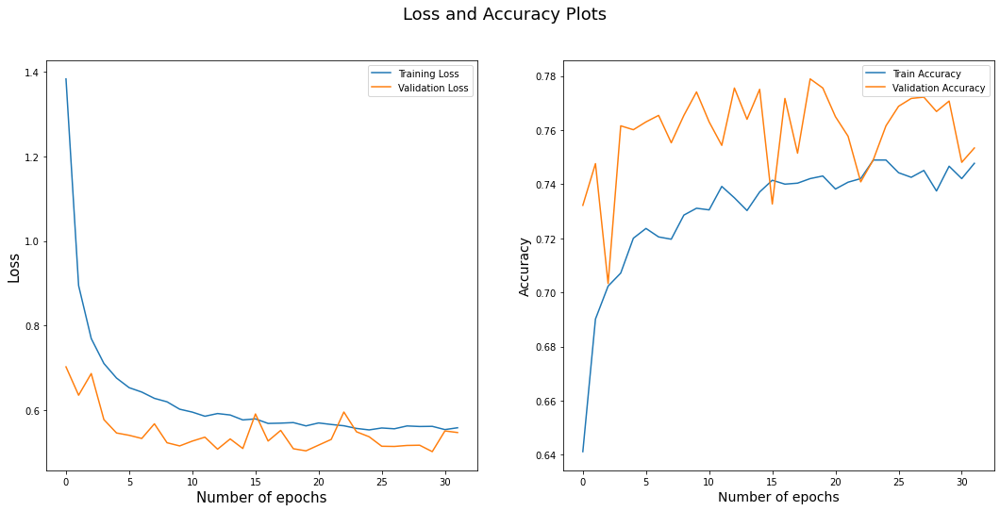

63/63 [==============================] - 4s 37ms/step
0.7725


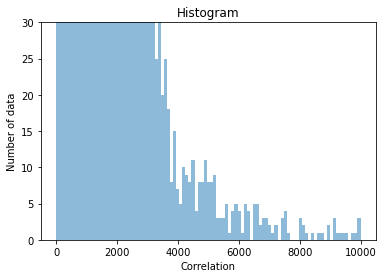

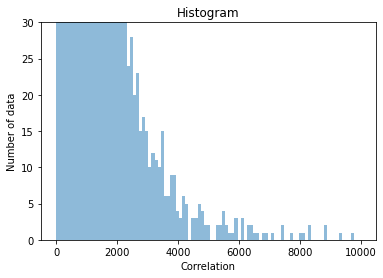

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_1 (Dropout)         (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


195/195 [==============================] - 16s 57ms/step - loss: 1.5017 - acc: 0.6342 - val_loss: 0.6563 - val_acc: 0.7450
Epoch 2/32
195/195 [==============================] - 9s 47ms/step - loss: 0.9169 - acc: 0.6946 - val_loss: 0.6030 - val_acc: 0.7559
Epoch 3/32
195/195 [==============================] - 9s 47ms/step - loss: 0.8198 - acc: 0.7088 - val_loss: 0.5526 - val_acc: 0.7688
Epoch 4/32
195/195 [==============================] - 9s 47ms/step - loss: 0.7328 - acc: 0.7097 - val_loss: 0.5494 - val_acc: 0.7636
Epoch 5/32
195/195 [==============================] - 9s 48ms/step - loss: 0.7056 - acc: 0.7165 - val_loss: 0.5340 - val_acc: 0.7707
Epoch 6/32
195/195 [==============================] - 9s 47ms/step - loss: 0.6643 - acc: 0.7226 - val_loss: 0.5185 - val_acc: 0.7836
Epoch 7/32
195/195 [==============================] - 9s 47ms/step - loss: 0.6260 - acc: 0.7316 - val_loss: 0.5134 - val_acc: 0.7765
Epoch 8/32
195/195 [==============================] - 9s 47ms/step - loss: 0.61

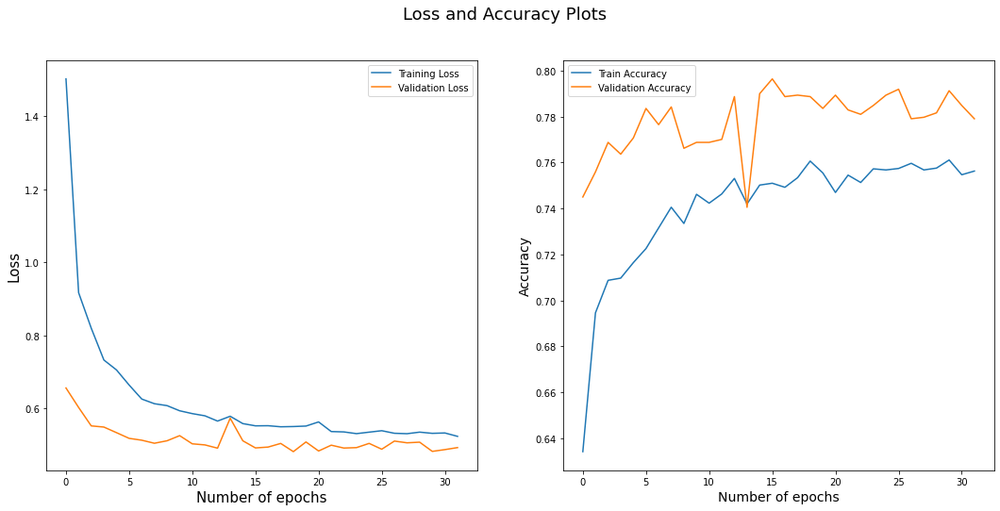

325/325 [==============================] - 12s 38ms/step
Round:  0
Test Accuracy:  0.7825
Label Accuracy:  0.9968208092485549
Number of catagory 1:  5534.0
Number of catagory 2:  4846.0
Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_2 (Dropout)         (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
__________________________________________________

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


260/260 [==============================] - 19s 53ms/step - loss: 1.2839 - acc: 0.6562 - val_loss: 0.6332 - val_acc: 0.7428
Epoch 2/32
260/260 [==============================] - 13s 48ms/step - loss: 0.8860 - acc: 0.6939 - val_loss: 0.5566 - val_acc: 0.7635
Epoch 3/32
260/260 [==============================] - 13s 49ms/step - loss: 0.7606 - acc: 0.7072 - val_loss: 0.5268 - val_acc: 0.7702
Epoch 4/32
260/260 [==============================] - 13s 49ms/step - loss: 0.6914 - acc: 0.7203 - val_loss: 0.5927 - val_acc: 0.7365
Epoch 5/32
260/260 [==============================] - 12s 48ms/step - loss: 0.6497 - acc: 0.7231 - val_loss: 0.5607 - val_acc: 0.7529
Epoch 6/32
260/260 [==============================] - 12s 47ms/step - loss: 0.6326 - acc: 0.7257 - val_loss: 0.5973 - val_acc: 0.7288
Epoch 7/32
260/260 [==============================] - 12s 47ms/step - loss: 0.6165 - acc: 0.7323 - val_loss: 0.5269 - val_acc: 0.7601
Epoch 8/32
260/260 [==============================] - 12s 48ms/step - los

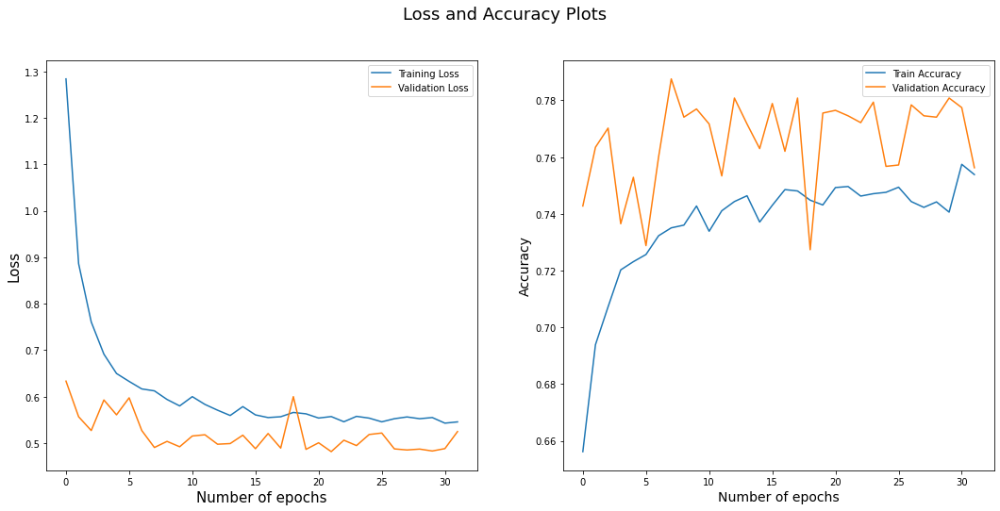

63/63 [==============================] - 4s 38ms/step
0.7795


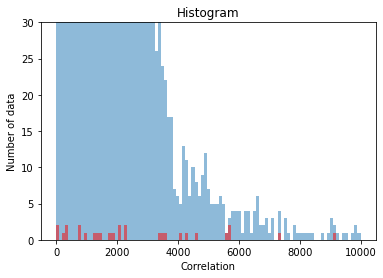

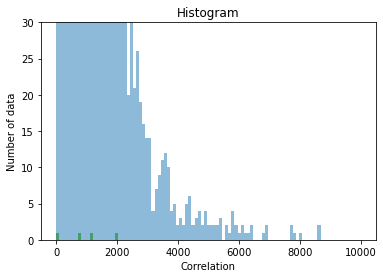

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_3 (Dropout)         (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


227/227 [==============================] - 18s 58ms/step - loss: 1.3151 - acc: 0.6455 - val_loss: 0.6825 - val_acc: 0.7307
Epoch 2/32
227/227 [==============================] - 11s 50ms/step - loss: 0.9326 - acc: 0.6849 - val_loss: 0.5672 - val_acc: 0.7599
Epoch 3/32
227/227 [==============================] - 11s 48ms/step - loss: 0.8144 - acc: 0.6987 - val_loss: 0.6210 - val_acc: 0.7351
Epoch 4/32
227/227 [==============================] - 11s 48ms/step - loss: 0.6936 - acc: 0.7117 - val_loss: 0.5332 - val_acc: 0.7583
Epoch 5/32
227/227 [==============================] - 11s 49ms/step - loss: 0.6721 - acc: 0.7174 - val_loss: 0.5792 - val_acc: 0.7340
Epoch 6/32
227/227 [==============================] - 11s 49ms/step - loss: 0.6518 - acc: 0.7226 - val_loss: 0.5083 - val_acc: 0.7726
Epoch 7/32
227/227 [==============================] - 11s 47ms/step - loss: 0.6429 - acc: 0.7252 - val_loss: 0.4935 - val_acc: 0.7616
Epoch 8/32
227/227 [==============================] - 11s 46ms/step - los

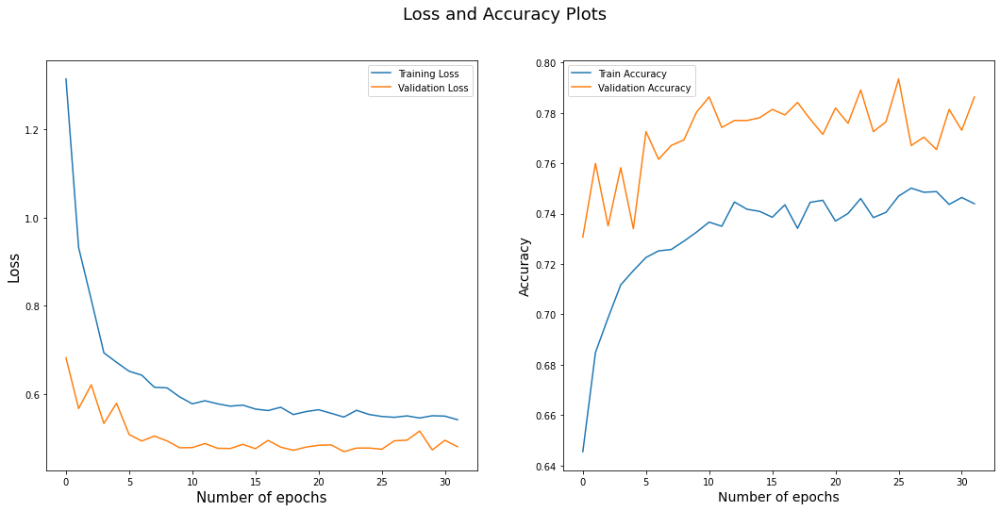

325/325 [==============================] - 11s 35ms/step
Round:  1
Test Accuracy:  0.7845
Label Accuracy:  0.9958574181117533
Number of catagory 1:  5542.0
Number of catagory 2:  4838.0
Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_4 (Dropout)         (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
__________________________________________________

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


260/260 [==============================] - 19s 52ms/step - loss: 1.3756 - acc: 0.6488 - val_loss: 0.6326 - val_acc: 0.7433
Epoch 2/32
260/260 [==============================] - 12s 46ms/step - loss: 0.8636 - acc: 0.6881 - val_loss: 0.5566 - val_acc: 0.7572
Epoch 3/32
260/260 [==============================] - 12s 47ms/step - loss: 0.7615 - acc: 0.7132 - val_loss: 0.5679 - val_acc: 0.7510
Epoch 4/32
260/260 [==============================] - 12s 47ms/step - loss: 0.7023 - acc: 0.7251 - val_loss: 0.5214 - val_acc: 0.7664
Epoch 5/32
260/260 [==============================] - 13s 50ms/step - loss: 0.6782 - acc: 0.7170 - val_loss: 0.5290 - val_acc: 0.7606
Epoch 6/32
260/260 [==============================] - 13s 48ms/step - loss: 0.6340 - acc: 0.7286 - val_loss: 0.5114 - val_acc: 0.7707
Epoch 7/32
260/260 [==============================] - 13s 49ms/step - loss: 0.6188 - acc: 0.7322 - val_loss: 0.5069 - val_acc: 0.7649
Epoch 8/32
260/260 [==============================] - 13s 49ms/step - los

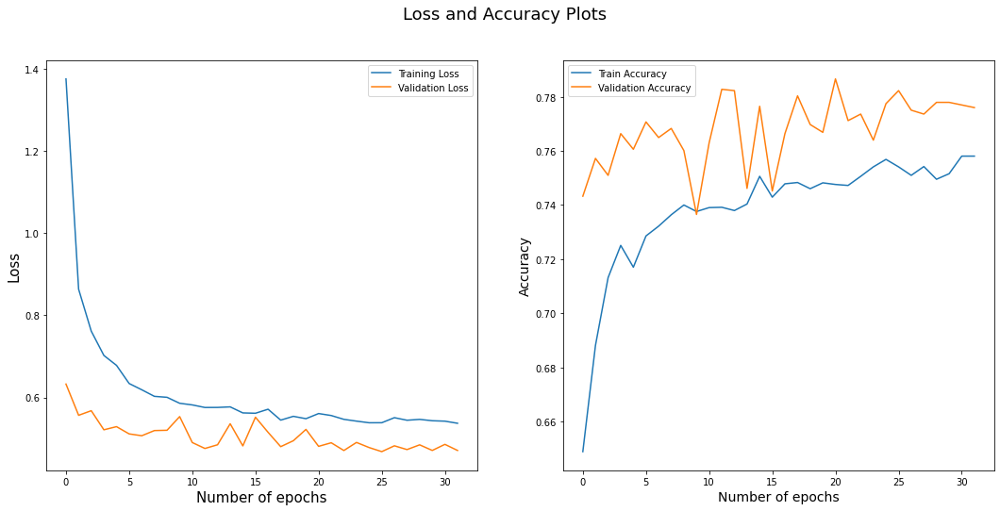

63/63 [==============================] - 4s 38ms/step
0.787


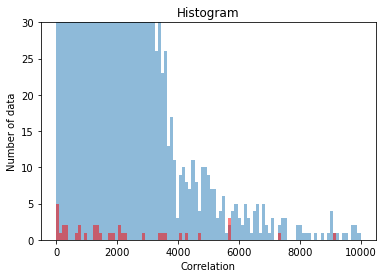

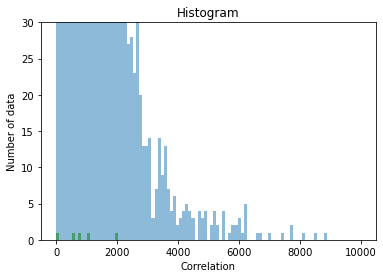

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_5 (Dropout)         (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


244/244 [==============================] - 18s 56ms/step - loss: 1.3644 - acc: 0.6488 - val_loss: 0.6942 - val_acc: 0.7210
Epoch 2/32
244/244 [==============================] - 12s 49ms/step - loss: 0.8840 - acc: 0.6946 - val_loss: 0.6066 - val_acc: 0.7405
Epoch 3/32
244/244 [==============================] - 12s 50ms/step - loss: 0.7630 - acc: 0.7107 - val_loss: 0.6113 - val_acc: 0.7446
Epoch 4/32
244/244 [==============================] - 12s 49ms/step - loss: 0.6961 - acc: 0.7197 - val_loss: 0.5410 - val_acc: 0.7682
Epoch 5/32
244/244 [==============================] - 12s 49ms/step - loss: 0.6799 - acc: 0.7161 - val_loss: 0.5479 - val_acc: 0.7646
Epoch 6/32
244/244 [==============================] - 12s 50ms/step - loss: 0.6538 - acc: 0.7253 - val_loss: 0.5251 - val_acc: 0.7693
Epoch 7/32
244/244 [==============================] - 11s 47ms/step - loss: 0.6133 - acc: 0.7357 - val_loss: 0.5123 - val_acc: 0.7698
Epoch 8/32
244/244 [==============================] - 11s 47ms/step - los

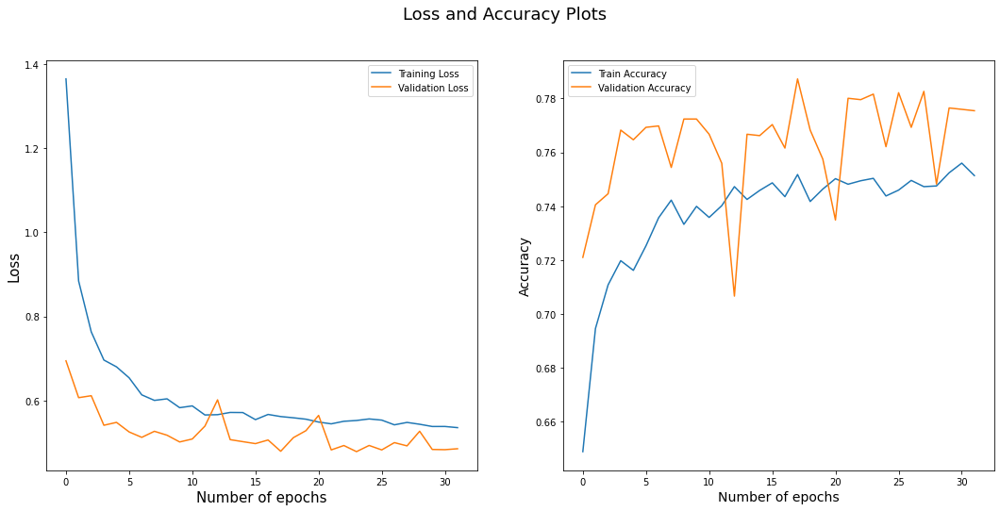

325/325 [==============================] - 12s 36ms/step
Round:  2
Test Accuracy:  0.791
Label Accuracy:  0.9950867052023121
Number of catagory 1:  5544.0
Number of catagory 2:  4836.0
Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_6 (Dropout)         (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
___________________________________________________

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


260/260 [==============================] - 19s 58ms/step - loss: 1.3777 - acc: 0.6555 - val_loss: 0.6356 - val_acc: 0.7433
Epoch 2/32
260/260 [==============================] - 13s 50ms/step - loss: 0.8776 - acc: 0.6950 - val_loss: 0.5685 - val_acc: 0.7490
Epoch 3/32
260/260 [==============================] - 13s 51ms/step - loss: 0.7631 - acc: 0.7103 - val_loss: 0.5449 - val_acc: 0.7688
Epoch 4/32
260/260 [==============================] - 13s 51ms/step - loss: 0.6938 - acc: 0.7195 - val_loss: 0.5267 - val_acc: 0.7683
Epoch 5/32
260/260 [==============================] - 13s 51ms/step - loss: 0.6493 - acc: 0.7299 - val_loss: 0.4986 - val_acc: 0.7832
Epoch 6/32
260/260 [==============================] - 13s 50ms/step - loss: 0.6434 - acc: 0.7304 - val_loss: 0.4972 - val_acc: 0.7775
Epoch 7/32
260/260 [==============================] - 13s 50ms/step - loss: 0.6145 - acc: 0.7303 - val_loss: 0.5033 - val_acc: 0.7876
Epoch 8/32
260/260 [==============================] - 13s 51ms/step - los

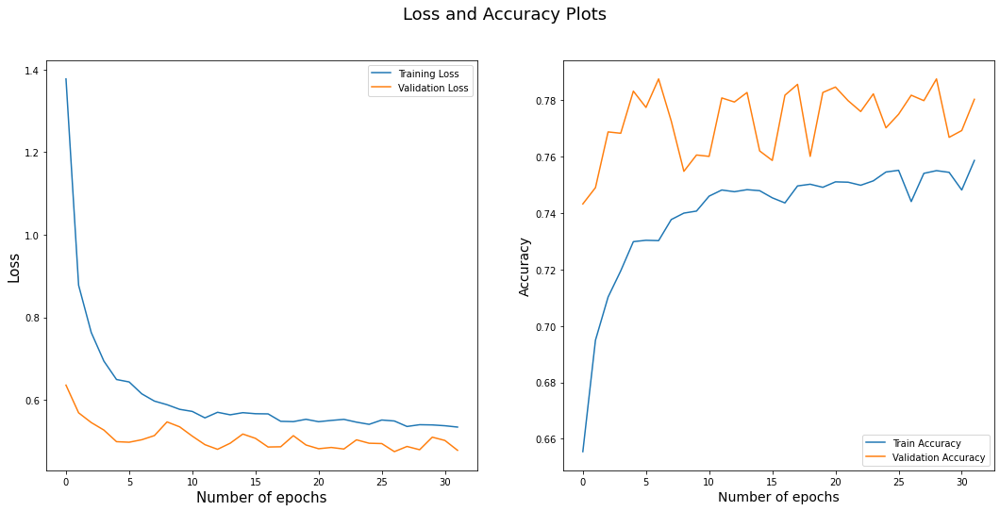

63/63 [==============================] - 4s 39ms/step
0.792


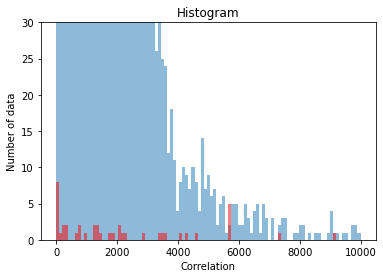

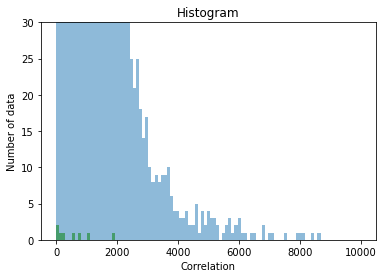

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_7 (Dropout)         (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


252/252 [==============================] - 20s 57ms/step - loss: 1.3499 - acc: 0.6533 - val_loss: 0.6661 - val_acc: 0.7489
Epoch 2/32
252/252 [==============================] - 13s 51ms/step - loss: 0.8972 - acc: 0.6896 - val_loss: 0.5910 - val_acc: 0.7544
Epoch 3/32
252/252 [==============================] - 13s 51ms/step - loss: 0.7576 - acc: 0.7064 - val_loss: 0.5474 - val_acc: 0.7653
Epoch 4/32
252/252 [==============================] - 13s 51ms/step - loss: 0.7080 - acc: 0.7130 - val_loss: 0.5463 - val_acc: 0.7603
Epoch 5/32
252/252 [==============================] - 13s 52ms/step - loss: 0.6550 - acc: 0.7294 - val_loss: 0.5263 - val_acc: 0.7693
Epoch 6/32
252/252 [==============================] - 13s 50ms/step - loss: 0.6470 - acc: 0.7239 - val_loss: 0.5555 - val_acc: 0.7529
Epoch 7/32
252/252 [==============================] - 13s 50ms/step - loss: 0.6131 - acc: 0.7339 - val_loss: 0.5291 - val_acc: 0.7529
Epoch 8/32
252/252 [==============================] - 13s 50ms/step - los

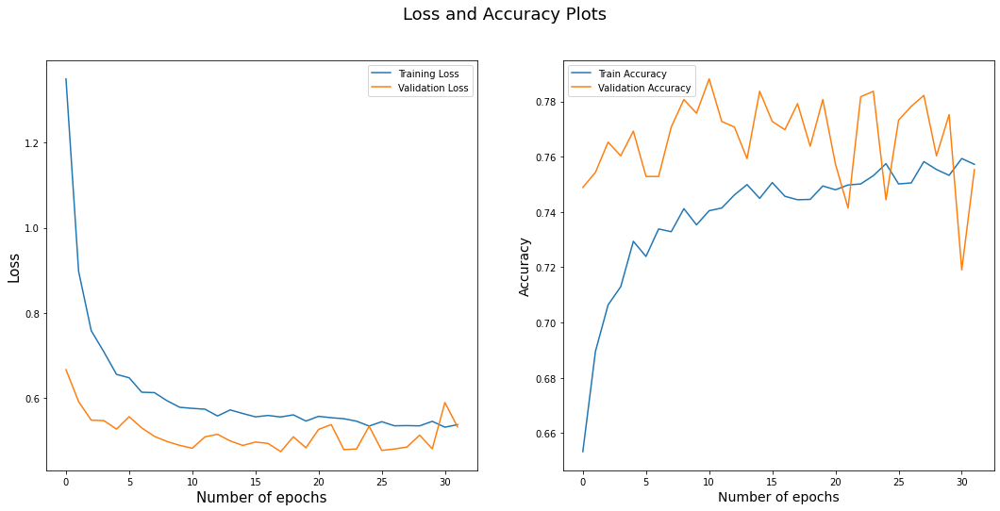

325/325 [==============================] - 11s 35ms/step
Round:  3
Test Accuracy:  0.755
Label Accuracy:  0.9910404624277457
Number of catagory 1:  5586.0
Number of catagory 2:  4794.0
Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_8 (Dropout)         (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
___________________________________________________

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


260/260 [==============================] - 20s 57ms/step - loss: 1.3174 - acc: 0.6564 - val_loss: 0.6687 - val_acc: 0.7433
Epoch 2/32
260/260 [==============================] - 12s 48ms/step - loss: 0.8757 - acc: 0.7016 - val_loss: 0.5531 - val_acc: 0.7563
Epoch 3/32
260/260 [==============================] - 12s 48ms/step - loss: 0.7567 - acc: 0.7098 - val_loss: 0.5204 - val_acc: 0.7712
Epoch 4/32
260/260 [==============================] - 12s 48ms/step - loss: 0.6840 - acc: 0.7322 - val_loss: 0.5118 - val_acc: 0.7731
Epoch 5/32
260/260 [==============================] - 12s 48ms/step - loss: 0.6291 - acc: 0.7374 - val_loss: 0.4939 - val_acc: 0.7770
Epoch 6/32
260/260 [==============================] - 12s 48ms/step - loss: 0.6215 - acc: 0.7384 - val_loss: 0.5095 - val_acc: 0.7712
Epoch 7/32
260/260 [==============================] - 13s 49ms/step - loss: 0.6102 - acc: 0.7382 - val_loss: 0.5197 - val_acc: 0.7553
Epoch 8/32
260/260 [==============================] - 12s 47ms/step - los

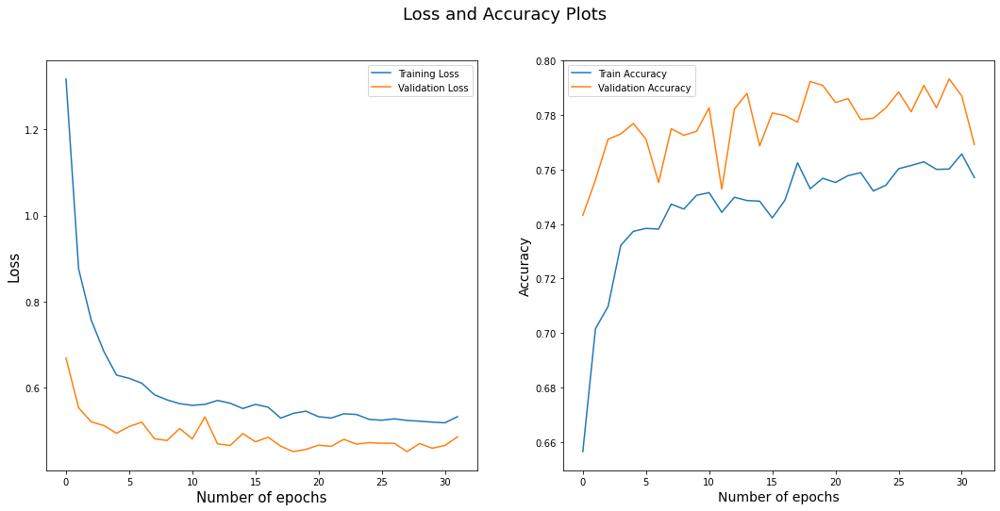

63/63 [==============================] - 4s 39ms/step
0.7735


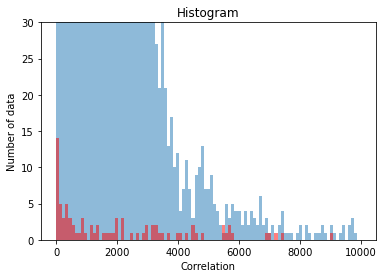

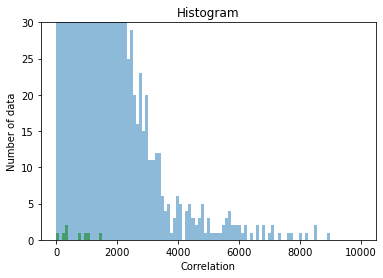

Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_9 (Dropout)         (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


256/256 [==============================] - 22s 60ms/step - loss: 1.2891 - acc: 0.6521 - val_loss: 0.6285 - val_acc: 0.7479
Epoch 2/32
256/256 [==============================] - 13s 52ms/step - loss: 0.8562 - acc: 0.6997 - val_loss: 0.5527 - val_acc: 0.7499
Epoch 3/32
256/256 [==============================] - 13s 51ms/step - loss: 0.7316 - acc: 0.7139 - val_loss: 0.5462 - val_acc: 0.7538
Epoch 4/32
256/256 [==============================] - 13s 52ms/step - loss: 0.6671 - acc: 0.7266 - val_loss: 0.5170 - val_acc: 0.7719
Epoch 5/32
256/256 [==============================] - 13s 51ms/step - loss: 0.6448 - acc: 0.7326 - val_loss: 0.5178 - val_acc: 0.7670
Epoch 6/32
256/256 [==============================] - 13s 51ms/step - loss: 0.6252 - acc: 0.7349 - val_loss: 0.5140 - val_acc: 0.7567
Epoch 7/32
256/256 [==============================] - 13s 50ms/step - loss: 0.6025 - acc: 0.7401 - val_loss: 0.4784 - val_acc: 0.7802
Epoch 8/32
256/256 [==============================] - 13s 50ms/step - los

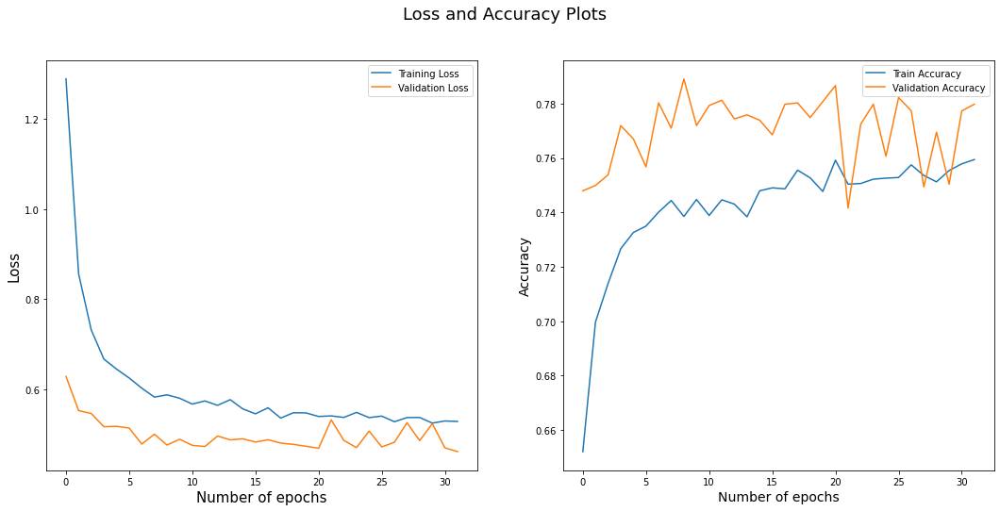

325/325 [==============================] - 12s 38ms/step
Round:  4
Test Accuracy:  0.7955
Label Accuracy:  0.9908477842003853
Number of catagory 1:  5584.0
Number of catagory 2:  4796.0
Model: "sequential_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_10 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


260/260 [==============================] - 21s 56ms/step - loss: 1.3802 - acc: 0.6458 - val_loss: 0.6280 - val_acc: 0.7394
Epoch 2/32
260/260 [==============================] - 13s 49ms/step - loss: 0.8877 - acc: 0.6948 - val_loss: 0.5572 - val_acc: 0.7649
Epoch 3/32
260/260 [==============================] - 12s 48ms/step - loss: 0.7577 - acc: 0.7175 - val_loss: 0.5361 - val_acc: 0.7625
Epoch 4/32
260/260 [==============================] - 13s 49ms/step - loss: 0.7043 - acc: 0.7142 - val_loss: 0.5263 - val_acc: 0.7659
Epoch 5/32
260/260 [==============================] - 13s 50ms/step - loss: 0.6474 - acc: 0.7311 - val_loss: 0.5018 - val_acc: 0.7775
Epoch 6/32
260/260 [==============================] - 13s 50ms/step - loss: 0.6278 - acc: 0.7400 - val_loss: 0.5312 - val_acc: 0.7519
Epoch 7/32
260/260 [==============================] - 13s 50ms/step - loss: 0.6120 - acc: 0.7393 - val_loss: 0.5403 - val_acc: 0.7539
Epoch 8/32
260/260 [==============================] - 13s 50ms/step - los

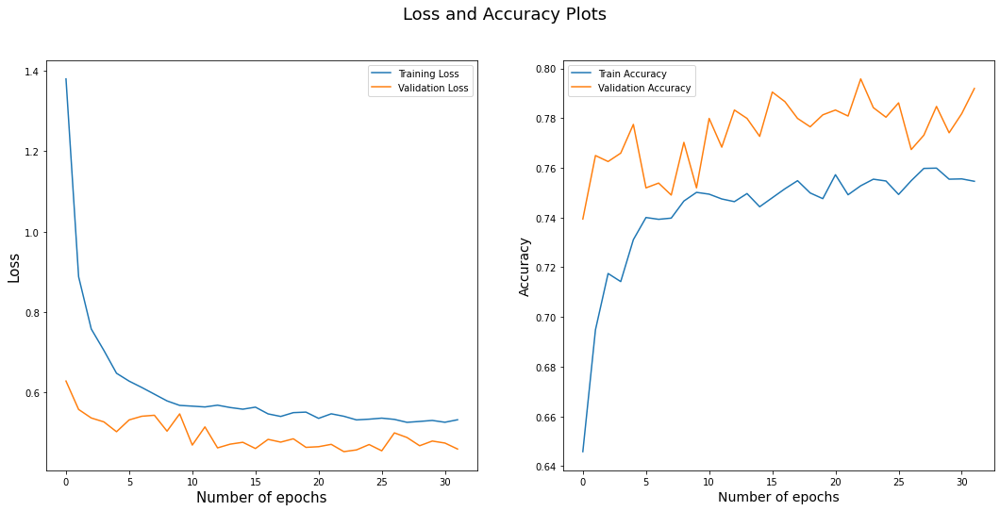

63/63 [==============================] - 4s 36ms/step
0.799


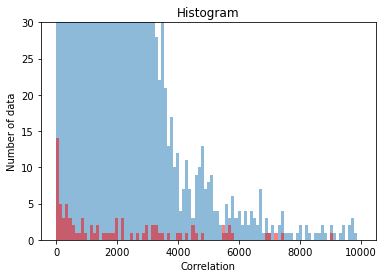

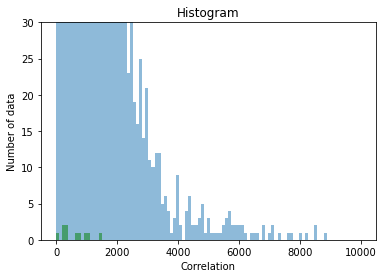

Model: "sequential_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_11 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


258/258 [==============================] - 20s 58ms/step - loss: 1.3273 - acc: 0.6502 - val_loss: 0.6058 - val_acc: 0.7529
Epoch 2/32
258/258 [==============================] - 13s 50ms/step - loss: 0.8575 - acc: 0.6951 - val_loss: 0.5570 - val_acc: 0.7626
Epoch 3/32
258/258 [==============================] - 12s 48ms/step - loss: 0.7529 - acc: 0.7132 - val_loss: 0.5180 - val_acc: 0.7728
Epoch 4/32
258/258 [==============================] - 13s 50ms/step - loss: 0.6988 - acc: 0.7175 - val_loss: 0.5284 - val_acc: 0.7689
Epoch 5/32
258/258 [==============================] - 13s 50ms/step - loss: 0.6450 - acc: 0.7360 - val_loss: 0.4955 - val_acc: 0.7767
Epoch 6/32
258/258 [==============================] - 13s 49ms/step - loss: 0.6178 - acc: 0.7385 - val_loss: 0.5006 - val_acc: 0.7636
Epoch 7/32
258/258 [==============================] - 13s 51ms/step - loss: 0.6156 - acc: 0.7306 - val_loss: 0.4844 - val_acc: 0.7840
Epoch 8/32
258/258 [==============================] - 13s 49ms/step - los

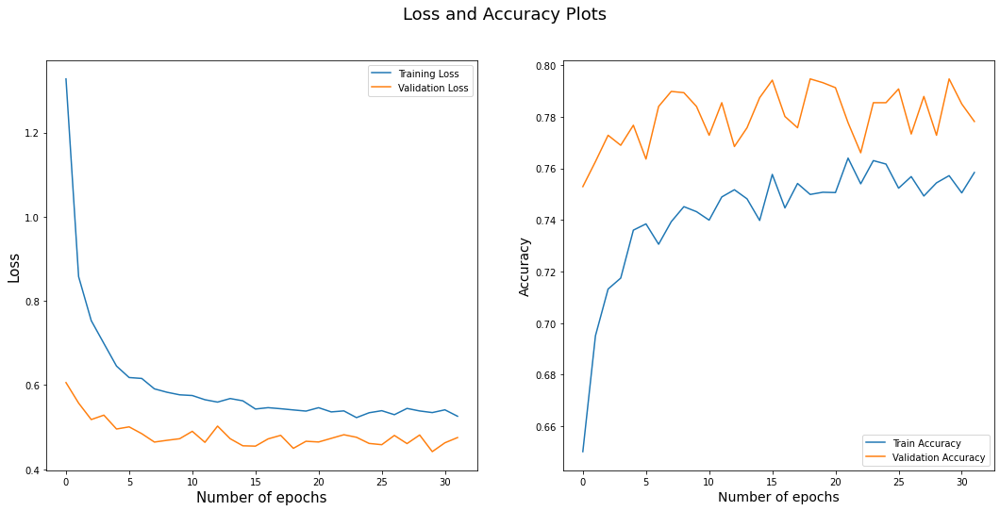

325/325 [==============================] - 12s 36ms/step
Round:  5
Test Accuracy:  0.787
Label Accuracy:  0.9904624277456647
Number of catagory 1:  5580.0
Number of catagory 2:  4800.0
Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_12 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
__________________________________________________

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


260/260 [==============================] - 19s 55ms/step - loss: 1.3628 - acc: 0.6463 - val_loss: 0.6789 - val_acc: 0.7278
Epoch 2/32
260/260 [==============================] - 13s 48ms/step - loss: 0.8918 - acc: 0.6920 - val_loss: 0.6617 - val_acc: 0.7423
Epoch 3/32
260/260 [==============================] - 12s 48ms/step - loss: 0.7343 - acc: 0.7123 - val_loss: 0.5850 - val_acc: 0.7529
Epoch 4/32
260/260 [==============================] - 13s 49ms/step - loss: 0.6821 - acc: 0.7292 - val_loss: 0.5062 - val_acc: 0.7760
Epoch 5/32
260/260 [==============================] - 12s 48ms/step - loss: 0.6445 - acc: 0.7264 - val_loss: 0.4830 - val_acc: 0.7881
Epoch 6/32
260/260 [==============================] - 12s 48ms/step - loss: 0.6127 - acc: 0.7369 - val_loss: 0.4985 - val_acc: 0.7837
Epoch 7/32
260/260 [==============================] - 13s 50ms/step - loss: 0.6032 - acc: 0.7404 - val_loss: 0.5081 - val_acc: 0.7760
Epoch 8/32
260/260 [==============================] - 12s 48ms/step - los

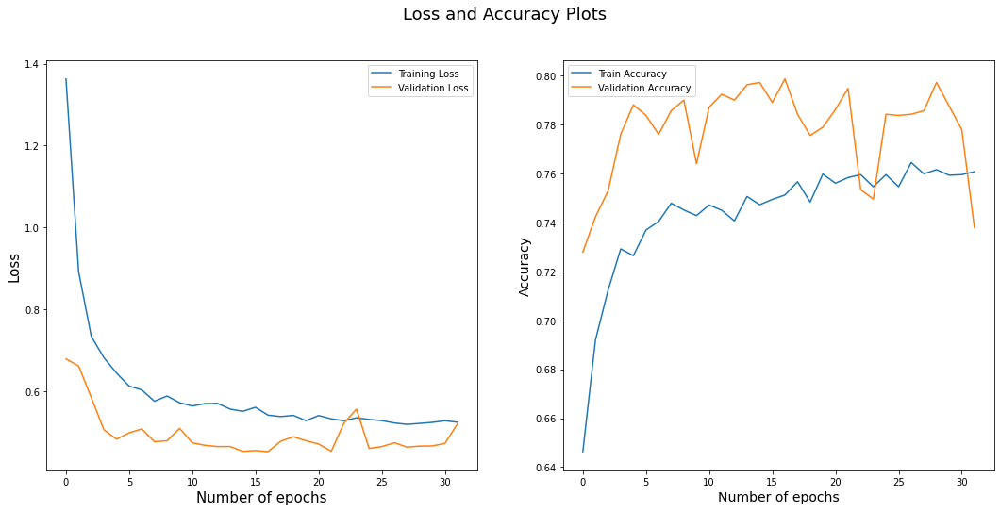

63/63 [==============================] - 7s 44ms/step
0.731


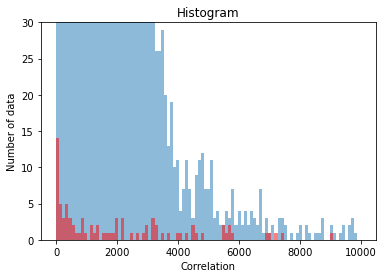

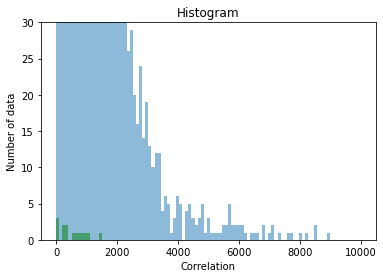

Model: "sequential_13"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_13 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


259/259 [==============================] - 21s 58ms/step - loss: 1.3671 - acc: 0.6420 - val_loss: 0.6010 - val_acc: 0.7626
Epoch 2/32
259/259 [==============================] - 12s 48ms/step - loss: 0.8579 - acc: 0.7025 - val_loss: 0.5769 - val_acc: 0.7640
Epoch 3/32
259/259 [==============================] - 13s 48ms/step - loss: 0.7499 - acc: 0.7104 - val_loss: 0.5301 - val_acc: 0.7689
Epoch 4/32
259/259 [==============================] - 13s 49ms/step - loss: 0.6783 - acc: 0.7237 - val_loss: 0.5385 - val_acc: 0.7568
Epoch 5/32
259/259 [==============================] - 13s 49ms/step - loss: 0.6705 - acc: 0.7232 - val_loss: 0.5120 - val_acc: 0.7631
Epoch 6/32
259/259 [==============================] - 13s 52ms/step - loss: 0.6306 - acc: 0.7390 - val_loss: 0.5125 - val_acc: 0.7679
Epoch 7/32
259/259 [==============================] - 13s 50ms/step - loss: 0.6070 - acc: 0.7390 - val_loss: 0.5328 - val_acc: 0.7553
Epoch 8/32
259/259 [==============================] - 13s 51ms/step - los

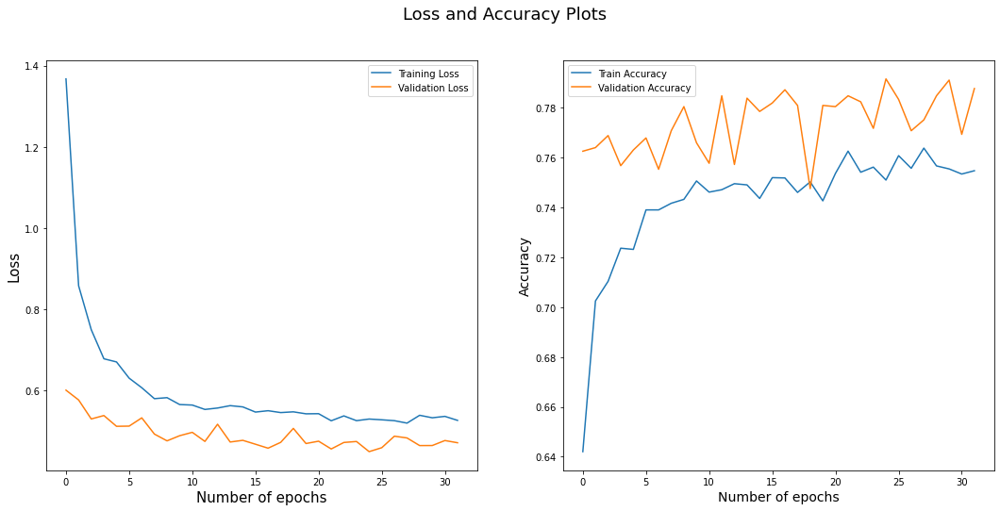

325/325 [==============================] - 11s 35ms/step
Round:  6
Test Accuracy:  0.793
Label Accuracy:  0.9902697495183044
Number of catagory 1:  5582.0
Number of catagory 2:  4798.0
Model: "sequential_14"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_14 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
__________________________________________________

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


260/260 [==============================] - 20s 55ms/step - loss: 1.2955 - acc: 0.6493 - val_loss: 0.6459 - val_acc: 0.7596
Epoch 2/32
260/260 [==============================] - 12s 46ms/step - loss: 0.8833 - acc: 0.6942 - val_loss: 0.5979 - val_acc: 0.7423
Epoch 3/32
260/260 [==============================] - 12s 48ms/step - loss: 0.7396 - acc: 0.7191 - val_loss: 0.4994 - val_acc: 0.7765
Epoch 4/32
260/260 [==============================] - 13s 50ms/step - loss: 0.6773 - acc: 0.7275 - val_loss: 0.5408 - val_acc: 0.7457
Epoch 5/32
260/260 [==============================] - 12s 48ms/step - loss: 0.6462 - acc: 0.7309 - val_loss: 0.4900 - val_acc: 0.7750
Epoch 6/32
260/260 [==============================] - 12s 48ms/step - loss: 0.6257 - acc: 0.7345 - val_loss: 0.4777 - val_acc: 0.7770
Epoch 7/32
260/260 [==============================] - 12s 47ms/step - loss: 0.5999 - acc: 0.7378 - val_loss: 0.5133 - val_acc: 0.7640
Epoch 8/32
260/260 [==============================] - 12s 48ms/step - los

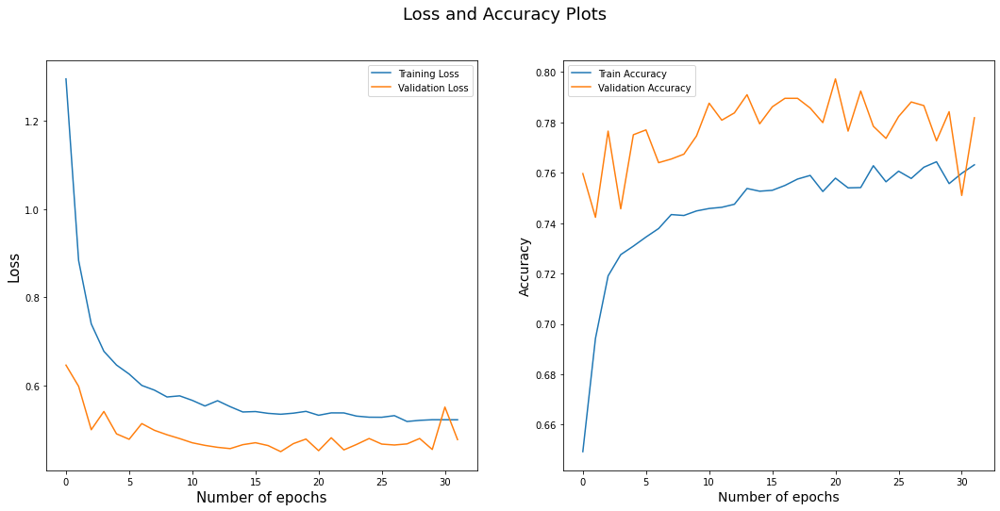

63/63 [==============================] - 4s 37ms/step
0.778


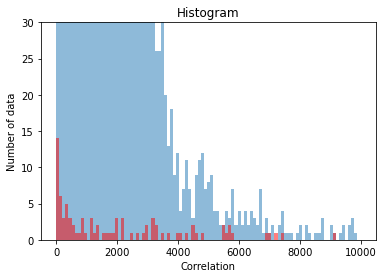

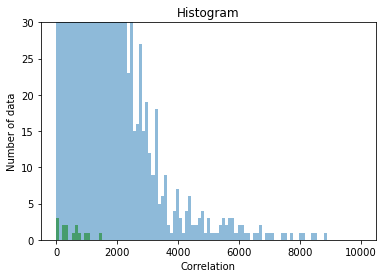

Model: "sequential_15"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_15 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


259/259 [==============================] - 22s 59ms/step - loss: 1.3634 - acc: 0.6491 - val_loss: 0.6494 - val_acc: 0.7519
Epoch 2/32
259/259 [==============================] - 13s 49ms/step - loss: 0.8689 - acc: 0.6990 - val_loss: 0.5606 - val_acc: 0.7616
Epoch 3/32
259/259 [==============================] - 13s 50ms/step - loss: 0.7415 - acc: 0.7116 - val_loss: 0.5535 - val_acc: 0.7616
Epoch 4/32
259/259 [==============================] - 13s 50ms/step - loss: 0.6718 - acc: 0.7278 - val_loss: 0.5197 - val_acc: 0.7703
Epoch 5/32
259/259 [==============================] - 12s 48ms/step - loss: 0.6448 - acc: 0.7273 - val_loss: 0.5049 - val_acc: 0.7659
Epoch 6/32
259/259 [==============================] - 13s 49ms/step - loss: 0.6196 - acc: 0.7334 - val_loss: 0.5348 - val_acc: 0.7413
Epoch 7/32
259/259 [==============================] - 13s 48ms/step - loss: 0.6018 - acc: 0.7407 - val_loss: 0.5929 - val_acc: 0.7278
Epoch 8/32
259/259 [==============================] - 12s 47ms/step - los

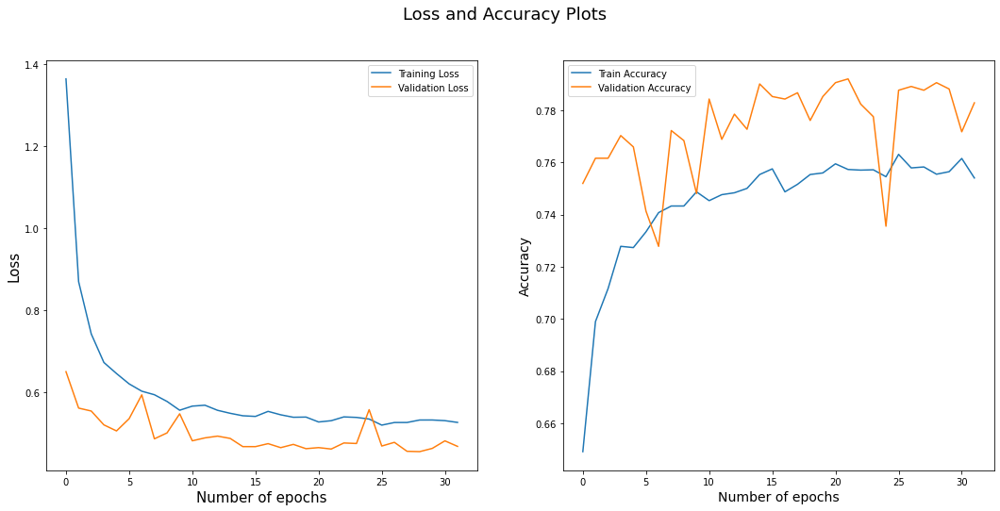

325/325 [==============================] - 12s 35ms/step
Round:  7
Test Accuracy:  0.786
Label Accuracy:  0.989980732177264
Number of catagory 1:  5581.0
Number of catagory 2:  4799.0
Model: "sequential_16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_16 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
___________________________________________________

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


260/260 [==============================] - 20s 56ms/step - loss: 1.3111 - acc: 0.6563 - val_loss: 0.6128 - val_acc: 0.7447
Epoch 2/32
260/260 [==============================] - 13s 49ms/step - loss: 0.8853 - acc: 0.6962 - val_loss: 0.6070 - val_acc: 0.7418
Epoch 3/32
260/260 [==============================] - 12s 48ms/step - loss: 0.7608 - acc: 0.7110 - val_loss: 0.5367 - val_acc: 0.7635
Epoch 4/32
260/260 [==============================] - 12s 48ms/step - loss: 0.6924 - acc: 0.7229 - val_loss: 0.5213 - val_acc: 0.7611
Epoch 5/32
260/260 [==============================] - 12s 47ms/step - loss: 0.6566 - acc: 0.7365 - val_loss: 0.5989 - val_acc: 0.7399
Epoch 6/32
260/260 [==============================] - 13s 49ms/step - loss: 0.6267 - acc: 0.7371 - val_loss: 0.4961 - val_acc: 0.7722
Epoch 7/32
260/260 [==============================] - 13s 48ms/step - loss: 0.6257 - acc: 0.7345 - val_loss: 0.5375 - val_acc: 0.7495
Epoch 8/32
260/260 [==============================] - 13s 48ms/step - los

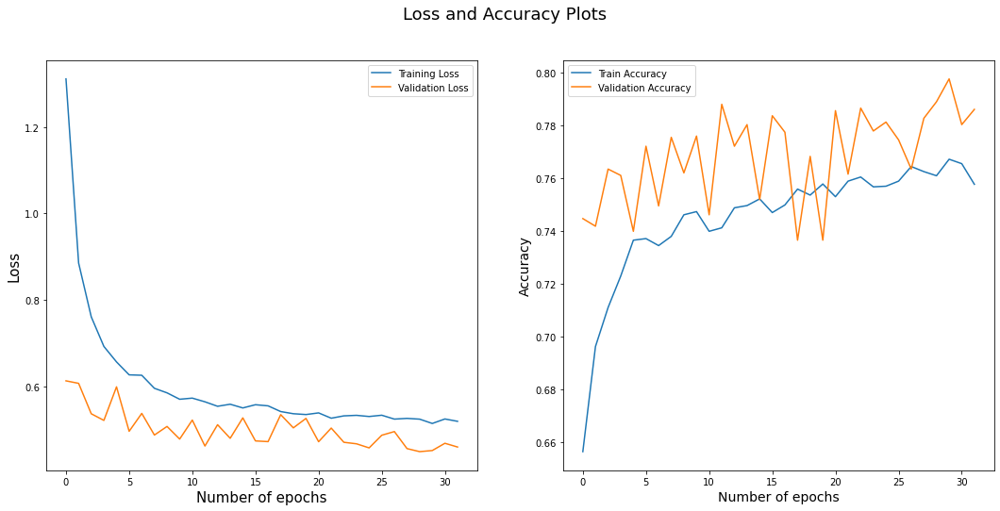

63/63 [==============================] - 4s 38ms/step
0.7965


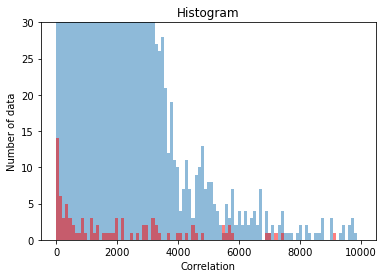

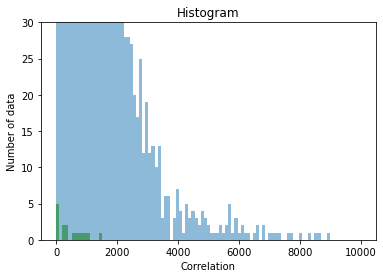

Model: "sequential_17"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_17 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


260/260 [==============================] - 21s 62ms/step - loss: 1.3263 - acc: 0.6614 - val_loss: 0.6360 - val_acc: 0.7546
Epoch 2/32
260/260 [==============================] - 13s 48ms/step - loss: 0.8661 - acc: 0.6987 - val_loss: 0.6190 - val_acc: 0.7464
Epoch 3/32
260/260 [==============================] - 13s 48ms/step - loss: 0.7348 - acc: 0.7188 - val_loss: 0.5177 - val_acc: 0.7705
Epoch 4/32
260/260 [==============================] - 12s 47ms/step - loss: 0.6705 - acc: 0.7249 - val_loss: 0.5314 - val_acc: 0.7695
Epoch 5/32
260/260 [==============================] - 13s 49ms/step - loss: 0.6369 - acc: 0.7356 - val_loss: 0.5904 - val_acc: 0.7319
Epoch 6/32
260/260 [==============================] - 12s 48ms/step - loss: 0.6186 - acc: 0.7344 - val_loss: 0.4918 - val_acc: 0.7772
Epoch 7/32
260/260 [==============================] - 13s 49ms/step - loss: 0.6013 - acc: 0.7429 - val_loss: 0.6760 - val_acc: 0.6914
Epoch 8/32
260/260 [==============================] - 12s 47ms/step - los

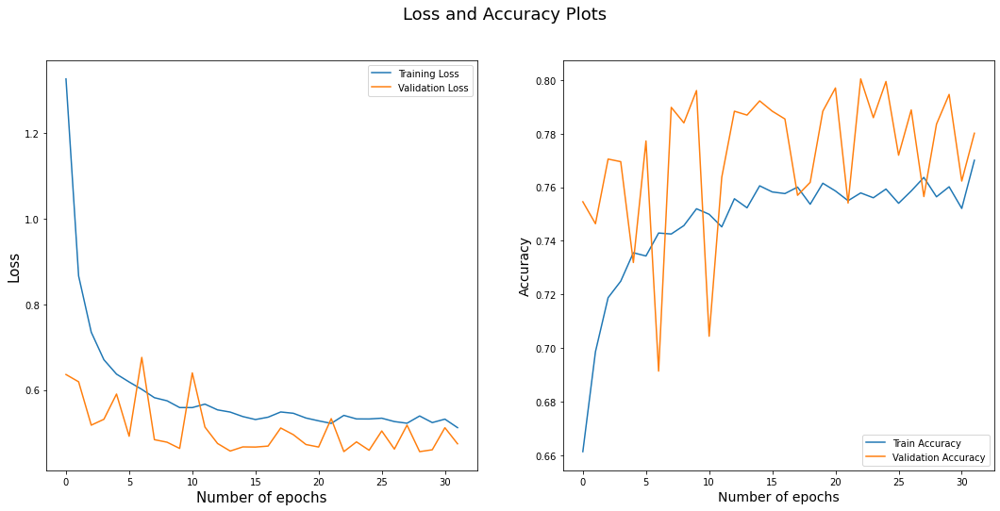

325/325 [==============================] - 12s 37ms/step
Round:  8
Test Accuracy:  0.786
Label Accuracy:  0.9890173410404625
Number of catagory 1:  5571.0
Number of catagory 2:  4809.0
Model: "sequential_18"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_18 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
__________________________________________________

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


260/260 [==============================] - 19s 57ms/step - loss: 1.2993 - acc: 0.6499 - val_loss: 0.6153 - val_acc: 0.7592
Epoch 2/32
260/260 [==============================] - 12s 48ms/step - loss: 0.8623 - acc: 0.7018 - val_loss: 0.5469 - val_acc: 0.7669
Epoch 3/32
260/260 [==============================] - 12s 46ms/step - loss: 0.7413 - acc: 0.7118 - val_loss: 0.5101 - val_acc: 0.7779
Epoch 4/32
260/260 [==============================] - 12s 47ms/step - loss: 0.6728 - acc: 0.7282 - val_loss: 0.5043 - val_acc: 0.7808
Epoch 5/32
260/260 [==============================] - 12s 47ms/step - loss: 0.6493 - acc: 0.7343 - val_loss: 0.4886 - val_acc: 0.7828
Epoch 6/32
260/260 [==============================] - 12s 48ms/step - loss: 0.6258 - acc: 0.7352 - val_loss: 0.4800 - val_acc: 0.7712
Epoch 7/32
260/260 [==============================] - 13s 49ms/step - loss: 0.6096 - acc: 0.7387 - val_loss: 0.4756 - val_acc: 0.7837
Epoch 8/32
260/260 [==============================] - 13s 49ms/step - los

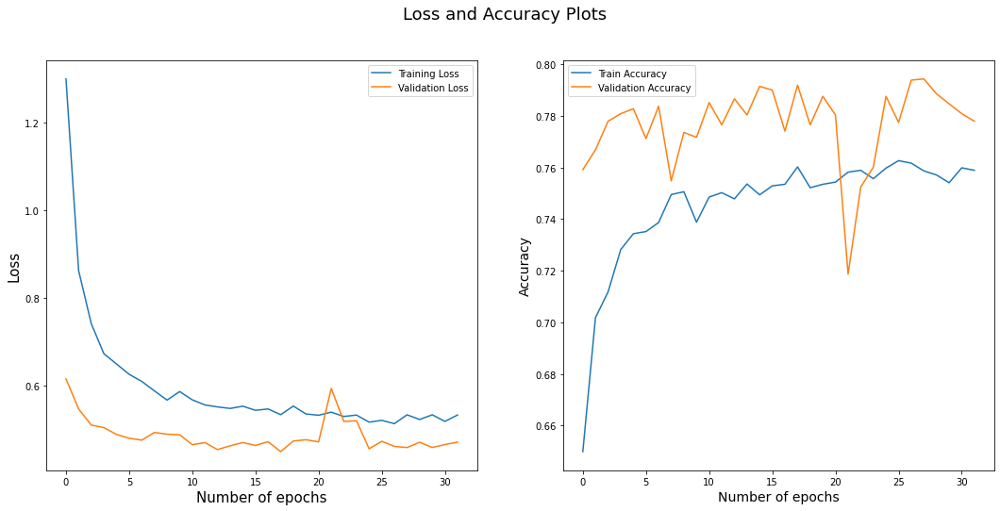

63/63 [==============================] - 6s 39ms/step
0.787


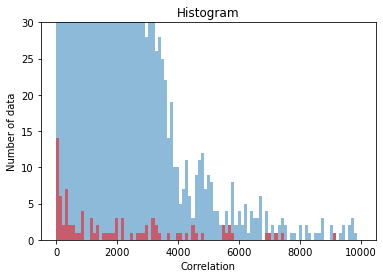

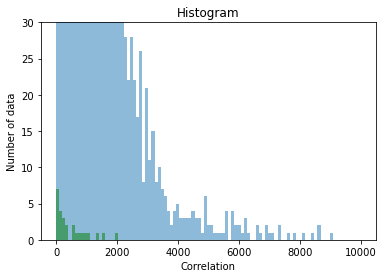

Model: "sequential_19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_19 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


260/260 [==============================] - 20s 57ms/step - loss: 1.2519 - acc: 0.6635 - val_loss: 0.9511 - val_acc: 0.6752
Epoch 2/32
260/260 [==============================] - 13s 49ms/step - loss: 0.8733 - acc: 0.6972 - val_loss: 0.5627 - val_acc: 0.7561
Epoch 3/32
260/260 [==============================] - 12s 48ms/step - loss: 0.7509 - acc: 0.7147 - val_loss: 0.5726 - val_acc: 0.7446
Epoch 4/32
260/260 [==============================] - 12s 47ms/step - loss: 0.6817 - acc: 0.7241 - val_loss: 0.5081 - val_acc: 0.7696
Epoch 5/32
260/260 [==============================] - 13s 49ms/step - loss: 0.6382 - acc: 0.7304 - val_loss: 0.5152 - val_acc: 0.7692
Epoch 6/32
260/260 [==============================] - 12s 48ms/step - loss: 0.6276 - acc: 0.7348 - val_loss: 0.4813 - val_acc: 0.7740
Epoch 7/32
260/260 [==============================] - 12s 48ms/step - loss: 0.5995 - acc: 0.7368 - val_loss: 0.4916 - val_acc: 0.7749
Epoch 8/32
260/260 [==============================] - 13s 49ms/step - los

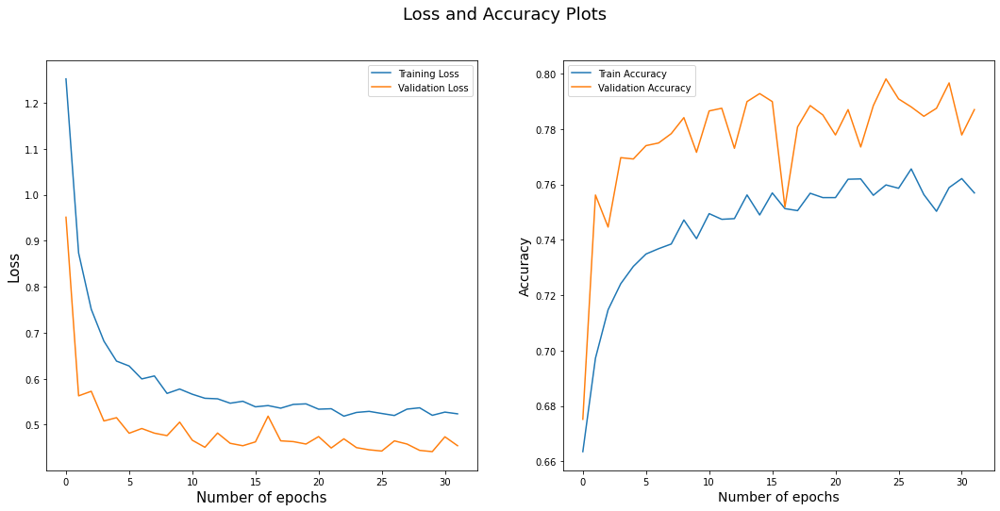

325/325 [==============================] - 12s 37ms/step
Round:  9
Test Accuracy:  0.7975
Label Accuracy:  0.9888246628131021
Number of catagory 1:  5569.0
Number of catagory 2:  4811.0
Model: "sequential_20"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_20 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


260/260 [==============================] - 20s 55ms/step - loss: 1.2969 - acc: 0.6474 - val_loss: 0.6290 - val_acc: 0.7514
Epoch 2/32
260/260 [==============================] - 12s 48ms/step - loss: 0.8638 - acc: 0.6981 - val_loss: 0.5552 - val_acc: 0.7678
Epoch 3/32
260/260 [==============================] - 12s 47ms/step - loss: 0.7266 - acc: 0.7195 - val_loss: 0.5302 - val_acc: 0.7693
Epoch 4/32
260/260 [==============================] - 13s 49ms/step - loss: 0.6654 - acc: 0.7325 - val_loss: 0.5485 - val_acc: 0.7683
Epoch 5/32
260/260 [==============================] - 13s 49ms/step - loss: 0.6440 - acc: 0.7295 - val_loss: 0.5282 - val_acc: 0.7563
Epoch 6/32
260/260 [==============================] - 12s 48ms/step - loss: 0.6194 - acc: 0.7303 - val_loss: 0.4896 - val_acc: 0.7755
Epoch 7/32
260/260 [==============================] - 13s 48ms/step - loss: 0.6003 - acc: 0.7370 - val_loss: 0.4839 - val_acc: 0.7842
Epoch 8/32
260/260 [==============================] - 12s 48ms/step - los

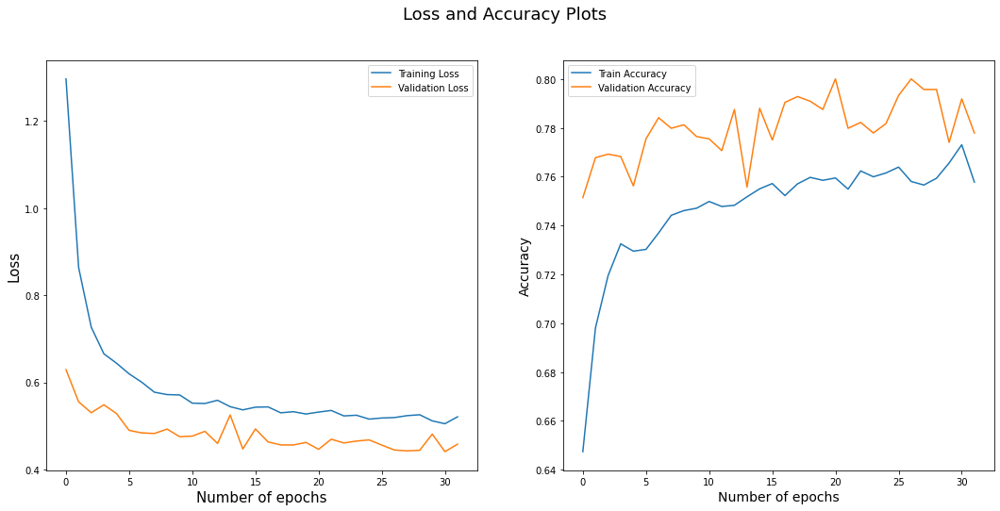

63/63 [==============================] - 4s 35ms/step
0.792


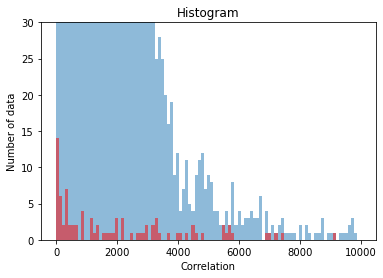

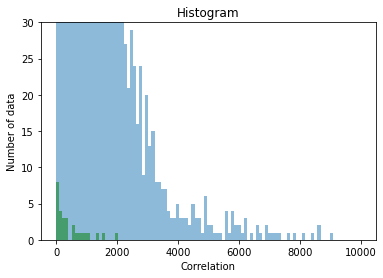

Model: "sequential_21"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_21 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


260/260 [==============================] - 21s 56ms/step - loss: 1.3365 - acc: 0.6521 - val_loss: 0.6311 - val_acc: 0.7523
Epoch 2/32
260/260 [==============================] - 12s 47ms/step - loss: 0.8909 - acc: 0.6941 - val_loss: 0.5672 - val_acc: 0.7552
Epoch 3/32
260/260 [==============================] - 13s 49ms/step - loss: 0.7261 - acc: 0.7184 - val_loss: 0.5169 - val_acc: 0.7754
Epoch 4/32
260/260 [==============================] - 13s 49ms/step - loss: 0.6982 - acc: 0.7245 - val_loss: 0.5111 - val_acc: 0.7740
Epoch 5/32
260/260 [==============================] - 13s 51ms/step - loss: 0.6454 - acc: 0.7351 - val_loss: 0.5112 - val_acc: 0.7610
Epoch 6/32
260/260 [==============================] - 13s 51ms/step - loss: 0.6273 - acc: 0.7376 - val_loss: 0.4997 - val_acc: 0.7629
Epoch 7/32
260/260 [==============================] - 13s 51ms/step - loss: 0.5944 - acc: 0.7439 - val_loss: 0.5338 - val_acc: 0.7571
Epoch 8/32
260/260 [==============================] - 13s 50ms/step - los

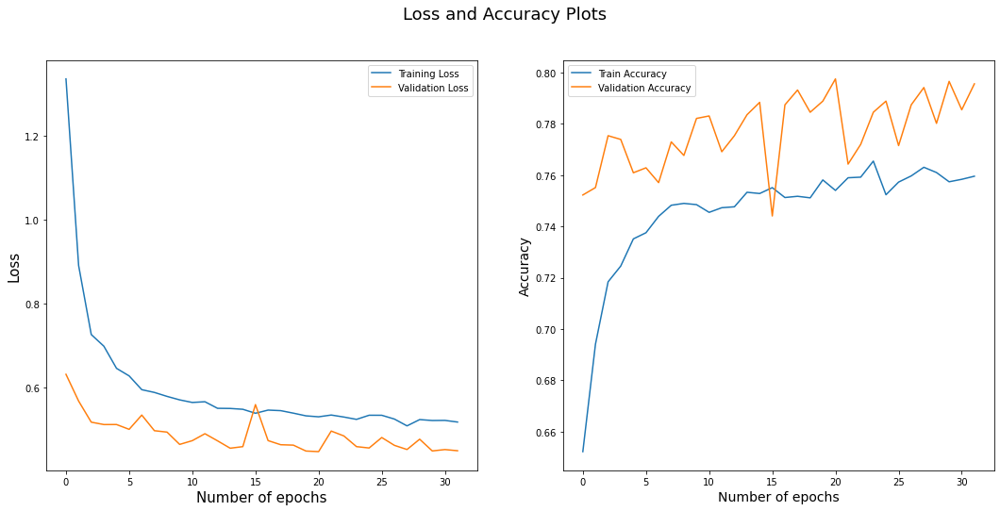

325/325 [==============================] - 12s 37ms/step
Round:  10
Test Accuracy:  0.805
Label Accuracy:  0.9886319845857419
Number of catagory 1:  5567.0
Number of catagory 2:  4813.0
Model: "sequential_22"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_22 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


260/260 [==============================] - 20s 55ms/step - loss: 1.3145 - acc: 0.6558 - val_loss: 0.6938 - val_acc: 0.7225
Epoch 2/32
260/260 [==============================] - 12s 48ms/step - loss: 0.8570 - acc: 0.6952 - val_loss: 0.5424 - val_acc: 0.7789
Epoch 3/32
260/260 [==============================] - 12s 47ms/step - loss: 0.7284 - acc: 0.7194 - val_loss: 0.4958 - val_acc: 0.7770
Epoch 4/32
260/260 [==============================] - 13s 49ms/step - loss: 0.6724 - acc: 0.7280 - val_loss: 0.4950 - val_acc: 0.7722
Epoch 5/32
260/260 [==============================] - 13s 48ms/step - loss: 0.6270 - acc: 0.7354 - val_loss: 0.4807 - val_acc: 0.7784
Epoch 6/32
260/260 [==============================] - 12s 47ms/step - loss: 0.6138 - acc: 0.7368 - val_loss: 0.4750 - val_acc: 0.7871
Epoch 7/32
260/260 [==============================] - 13s 49ms/step - loss: 0.5913 - acc: 0.7424 - val_loss: 0.4633 - val_acc: 0.7929
Epoch 8/32
260/260 [==============================] - 13s 49ms/step - los

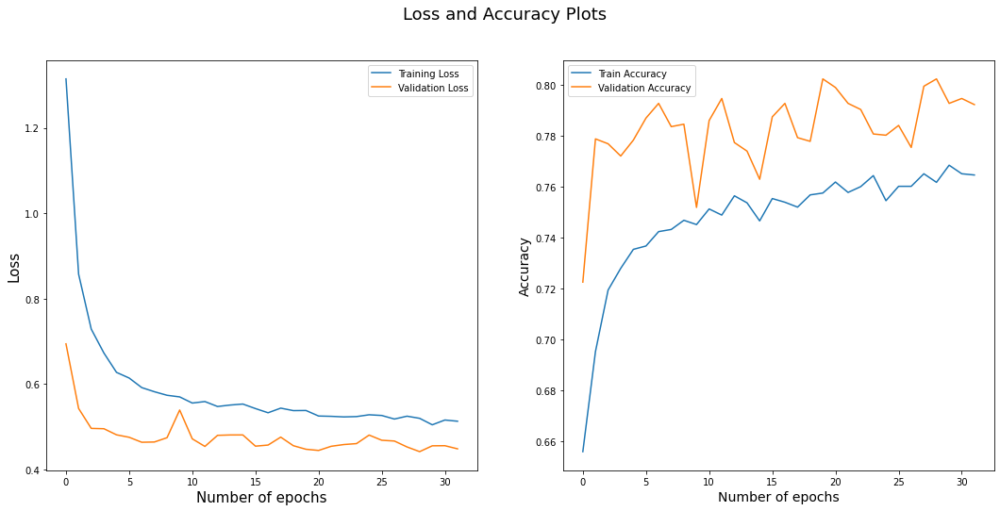

63/63 [==============================] - 4s 35ms/step
0.7945


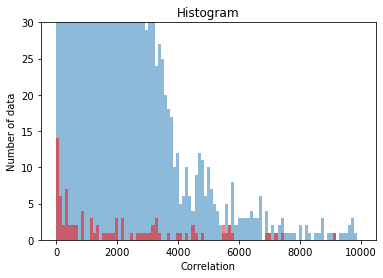

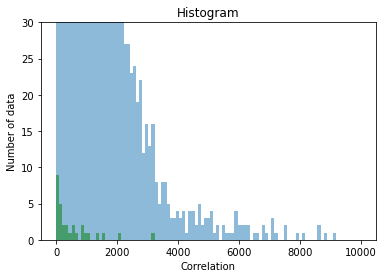

Model: "sequential_23"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_23 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


260/260 [==============================] - 20s 58ms/step - loss: 1.2815 - acc: 0.6494 - val_loss: 0.5967 - val_acc: 0.7563
Epoch 2/32
260/260 [==============================] - 12s 48ms/step - loss: 0.8826 - acc: 0.6999 - val_loss: 0.6608 - val_acc: 0.7486
Epoch 3/32
260/260 [==============================] - 13s 49ms/step - loss: 0.7294 - acc: 0.7176 - val_loss: 0.5181 - val_acc: 0.7659
Epoch 4/32
260/260 [==============================] - 13s 49ms/step - loss: 0.6772 - acc: 0.7220 - val_loss: 0.5237 - val_acc: 0.7640
Epoch 5/32
260/260 [==============================] - 13s 49ms/step - loss: 0.6423 - acc: 0.7319 - val_loss: 0.4814 - val_acc: 0.7799
Epoch 6/32
260/260 [==============================] - 13s 49ms/step - loss: 0.6087 - acc: 0.7378 - val_loss: 0.4716 - val_acc: 0.7832
Epoch 7/32
260/260 [==============================] - 13s 49ms/step - loss: 0.5991 - acc: 0.7441 - val_loss: 0.4602 - val_acc: 0.7919
Epoch 8/32
260/260 [==============================] - 13s 49ms/step - los

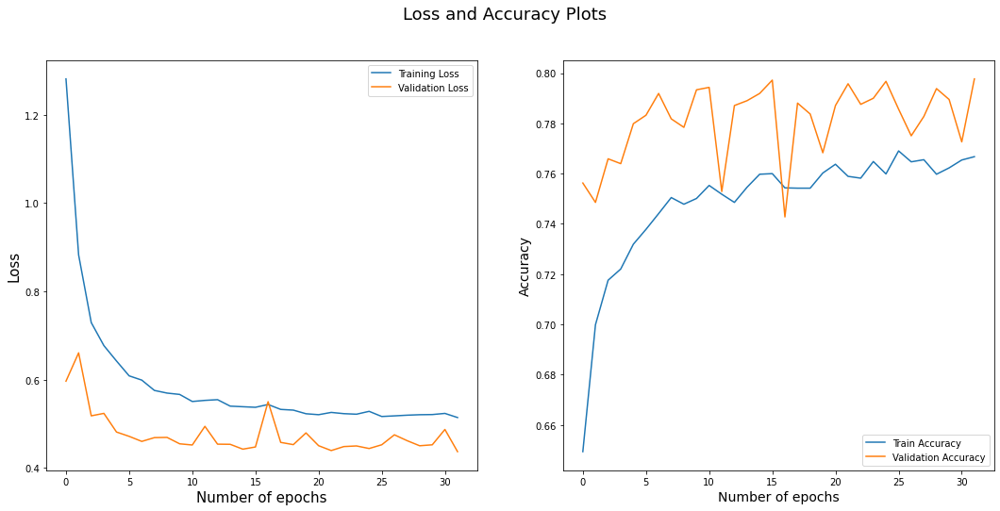

325/325 [==============================] - 13s 39ms/step
Round:  11
Test Accuracy:  0.801
Label Accuracy:  0.9886319845857419
Number of catagory 1:  5567.0
Number of catagory 2:  4813.0
Model: "sequential_24"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_24 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


260/260 [==============================] - 19s 56ms/step - loss: 1.3223 - acc: 0.6588 - val_loss: 0.6322 - val_acc: 0.7413
Epoch 2/32
260/260 [==============================] - 12s 47ms/step - loss: 0.8695 - acc: 0.6981 - val_loss: 0.5477 - val_acc: 0.7693
Epoch 3/32
260/260 [==============================] - 12s 47ms/step - loss: 0.7399 - acc: 0.7144 - val_loss: 0.4925 - val_acc: 0.7736
Epoch 4/32
260/260 [==============================] - 12s 48ms/step - loss: 0.6727 - acc: 0.7247 - val_loss: 0.5460 - val_acc: 0.7645
Epoch 5/32
260/260 [==============================] - 12s 47ms/step - loss: 0.6500 - acc: 0.7270 - val_loss: 0.4831 - val_acc: 0.7861
Epoch 6/32
260/260 [==============================] - 13s 49ms/step - loss: 0.6138 - acc: 0.7382 - val_loss: 0.4786 - val_acc: 0.7784
Epoch 7/32
260/260 [==============================] - 12s 48ms/step - loss: 0.5910 - acc: 0.7406 - val_loss: 0.4708 - val_acc: 0.7784
Epoch 8/32
260/260 [==============================] - 12s 48ms/step - los

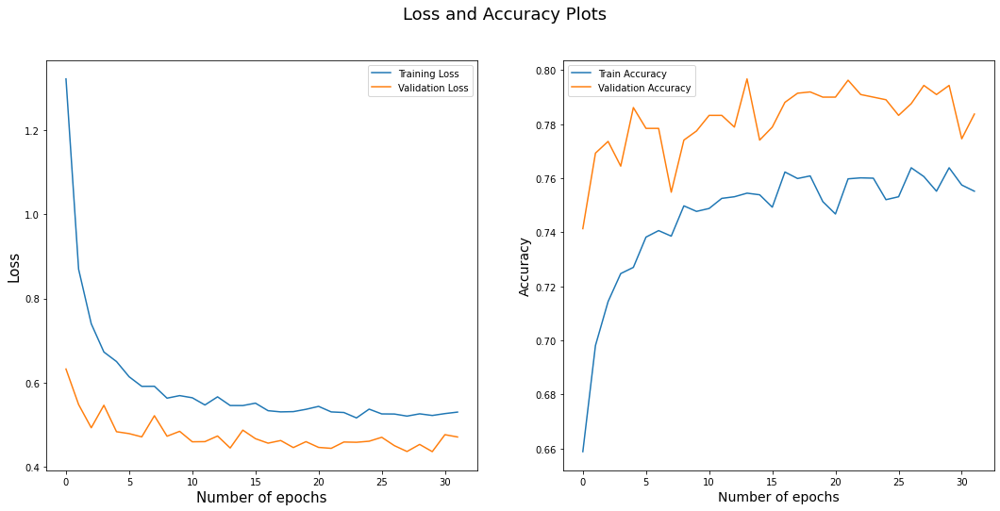

63/63 [==============================] - 4s 36ms/step
0.7875


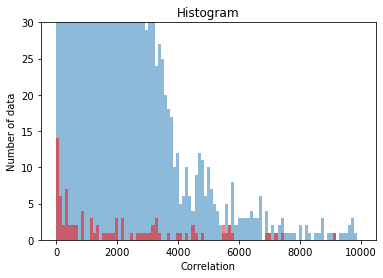

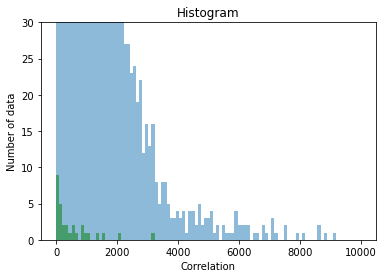

Model: "sequential_25"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_25 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


260/260 [==============================] - 22s 60ms/step - loss: 1.2783 - acc: 0.6582 - val_loss: 0.6223 - val_acc: 0.7567
Epoch 2/32
260/260 [==============================] - 13s 51ms/step - loss: 0.8334 - acc: 0.7034 - val_loss: 0.5493 - val_acc: 0.7572
Epoch 3/32
260/260 [==============================] - 13s 50ms/step - loss: 0.7315 - acc: 0.7182 - val_loss: 0.5121 - val_acc: 0.7731
Epoch 4/32
260/260 [==============================] - 13s 50ms/step - loss: 0.6803 - acc: 0.7294 - val_loss: 0.5991 - val_acc: 0.7331
Epoch 5/32
260/260 [==============================] - 13s 51ms/step - loss: 0.6376 - acc: 0.7328 - val_loss: 0.5097 - val_acc: 0.7596
Epoch 6/32
260/260 [==============================] - 13s 51ms/step - loss: 0.6249 - acc: 0.7301 - val_loss: 0.4799 - val_acc: 0.7832
Epoch 7/32
260/260 [==============================] - 13s 52ms/step - loss: 0.5970 - acc: 0.7414 - val_loss: 0.4815 - val_acc: 0.7784
Epoch 8/32
260/260 [==============================] - 13s 51ms/step - los

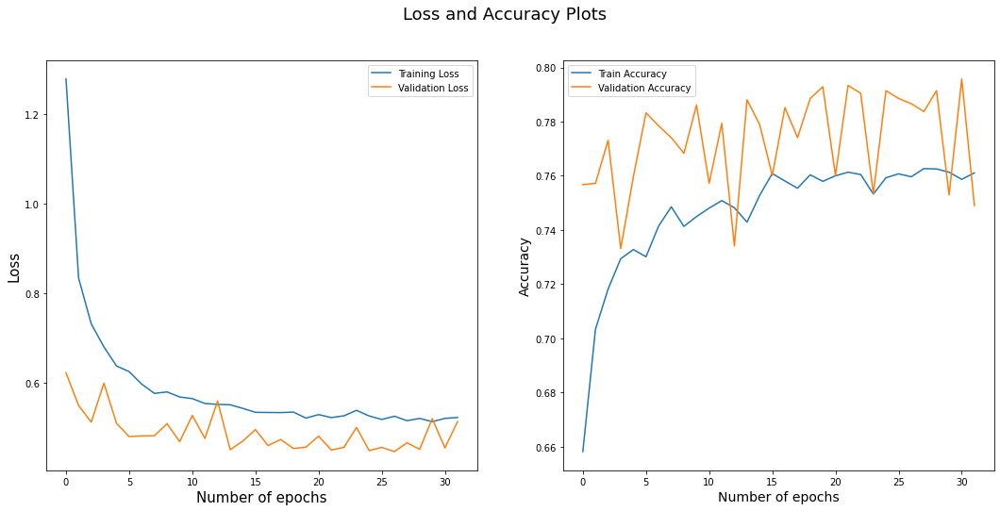

101/325 [========>.....................] - ETA: 8s

KeyboardInterrupt: 

In [5]:
#---Train---
from tensorflow.compat.v1.keras.applications import ResNet101

res = ResNet101(weights='imagenet', include_top = False, classes = 2, input_shape=(32,32,3))

Label_Accuracy = []
Test_Accuracy = []
Test_Accurracy_0 = []

Rounds = 64


for Round in range(Rounds):
    model = Sequential()
    
    model.add(res)
    # model.add(GlobalAveragePooling2D(name='penultimate'))
    model.add(Flatten(name='penultimate'))
    
    model.add(Dropout(0.5))
    model.add(Dense(2, activation = 'softmax', name='dense'))
    res.trainable = False
    model.summary()
    
    lr = 1e-4
    sgd = SGD(lr = lr, momentum = 0.9, nesterov = True)
    model.compile(loss = 'categorical_crossentropy', optimizer = sgd, metrics = ['acc'])
    
    hist = model.fit(x=X, y=y_shifted, batch_size=32, epochs=32, verbose=1, callbacks=None, validation_split=0.2, validation_data=None, shuffle=True, class_weight=None, sample_weight=None, initial_epoch=0, steps_per_epoch=None, validation_steps=None)
    
    
    
    plt.figure(figsize=(18,8))
    
    plt.suptitle('Loss and Accuracy Plots', fontsize=18)
    
    plt.subplot(1,2,1)
    plt.plot(hist.history['loss'], label='Training Loss')
    plt.plot(hist.history['val_loss'], label='Validation Loss')
    plt.legend()
    plt.xlabel('Number of epochs', fontsize=15)
    plt.ylabel('Loss', fontsize=15)
    
    plt.subplot(1,2,2)
    plt.plot(hist.history['acc'], label='Train Accuracy')
    plt.plot(hist.history['val_acc'], label='Validation Accuracy')
    plt.legend()
    plt.xlabel('Number of epochs', fontsize=14)
    plt.ylabel('Accuracy', fontsize=14)
    plt.show()
    
    
    y_pred = model.predict(X_test, verbose=1)
    y_pred = np.argmax(y_pred, axis = 1)
    print(accuracy_score(y_test, y_pred))
    Test_Accurracy_0.append(accuracy_score(y_test, y_pred))
    
    sub_model = tf.keras.Model(inputs = model.input, outputs = model.get_layer('penultimate').output)
    R = sub_model.predict(X)
    
    preserved_index = []
    relabel_index = []
    
    T_index = [-1 for i in range(len(R))]
    for catagory in [0, 1]:
        R_c = R[y_shifted[:,catagory] == 1]
        R_hat = np.average(R_c, axis=0)
        M = R_c.copy()
        for i in range(len(M)):
            M[i] -= R_hat
        u, s, vh = np.linalg.svd(M, full_matrices=True)
        v = vh[0]
        
        T = []
        T00 = []
        T01 = []
        T10 = []
        for i, r in enumerate(R):
            if y_shifted[i, catagory] == 1:
                T.append((np.dot((r-R_hat), v)**2))
                T_index[i] = len(T)-1
                
                if (y_shifted[i] == to_categorical(y, 2)[i]).all():
                    T00.append((np.dot((r-R_hat), v)**2))
                elif y_shifted[i][0] == 1:
                    T01.append((np.dot((r-R_hat), v)**2))
                elif y_shifted[i][0] == 0:
                    T10.append((np.dot((r-R_hat), v)**2))
        
        bins = np.linspace(0, 10000, 100)
        n, bins, patches=plt.hist(T00,alpha = 0.5,bins=bins)
        n, bins, patches=plt.hist(T01,bins=bins,alpha = 0.5,color='red')
        n, bins, patches=plt.hist(T10,bins=bins,alpha = 0.5,color='green')
        plt.ylim(0, 30)
        plt.xlabel("Correlation")
        plt.ylabel("Number of data")
        plt.title("Histogram")
        plt.show()
    
        S = sorted(range(len(T)), key=lambda k: T[k])
        # d = T[S[int(len(M) * (1 - 0.25 * (1 - (Round / Rounds))))]]
        d = T[S[int(len(M) * (1 - 0.25 * 0.5**Round))-1]]
        # rl = T[S[int(len(M) * (1 - 0.5**Round))]]
        # d = T[S[int(len(M) * (1 - 0.25))]]
        # rl = T[S[int(500*(1-0.1))]]
        for i, r in enumerate(R):
            if y_shifted[i, catagory] == 1 and T[T_index[i]] < d:
                preserved_index.append(i)
            # if y_shifted[i, catagory] == 1 and T[T_index[i]] >= rl:
            #     relabel_index.append(i)
                
    
    preserved_index.sort()
    relabel_index.sort()
    X_p = X[preserved_index]
    y_p = y_shifted.copy()
    y_p = y_p[preserved_index]
    
    
    
    model = Sequential()
    model.add(res)
    # model.add(GlobalAveragePooling2D(name='GAP'))
    model.add(Flatten(name='FC'))
    
    model.add(Dropout(0.5))
    model.add(Dense(2, activation = 'softmax', name='dense'))
    res.trainable = False
    model.summary()
    
    lr = 1e-4
    sgd = SGD(lr = lr, momentum = 0.9, nesterov = True)
    model.compile(loss = 'categorical_crossentropy', optimizer = sgd, metrics = ['acc'])
    
    hist = model.fit(x=X_p, y=y_p, batch_size=32, epochs=32, verbose=1, callbacks=None, validation_split=0.2, validation_data=None, shuffle=True, class_weight=None, sample_weight=None, initial_epoch=0, steps_per_epoch=None, validation_steps=None)
    
    plt.figure(figsize=(18,8))
    
    plt.suptitle('Loss and Accuracy Plots', fontsize=18)
    
    plt.subplot(1,2,1)
    plt.plot(hist.history['loss'], label='Training Loss')
    plt.plot(hist.history['val_loss'], label='Validation Loss')
    plt.legend()
    plt.xlabel('Number of epochs', fontsize=15)
    plt.ylabel('Loss', fontsize=15)
    
    plt.subplot(1,2,2)
    plt.plot(hist.history['acc'], label='Train Accuracy')
    plt.plot(hist.history['val_acc'], label='Validation Accuracy')
    plt.legend()
    plt.xlabel('Number of epochs', fontsize=14)
    plt.ylabel('Accuracy', fontsize=14)
    plt.show()
    
    y_pred = model.predict(X_test, verbose=1)
    y_pred = np.argmax(y_pred, axis = 1)
    
    y_new_pred = model.predict(X, verbose=1)
    y_new = np.argmax(y_new_pred, axis = 1)
    
    # for i in relabel_index:
    for i in range(len(X)):
        if max(y_new_pred[i]) > 0.99: 
            y_shifted[i] = to_categorical(y_new, 2)[i]
    
    print('Round: ', Round)
    print('Test Accuracy: ', accuracy_score(y_test, y_pred))
    print('Label Accuracy: ', accuracy_score(y, y_shifted[:,1]))
    print('Number of catagory 1: ', np.sum(y_shifted[:,0]))
    print('Number of catagory 2: ', np.sum(y_shifted[:,1]))
    Label_Accuracy.append(accuracy_score(y, y_shifted[:,1]))
    Test_Accuracy.append(accuracy_score(y_test, y_pred))

In [6]:
X_c = train_dataset.train_data
y_c = random_label1
X_test_c = test_dataset.test_data
y_test_c = test_dataset.test_labels

fine_label_list = ['airplane', 'automobile', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck']

def label_shiftting(y, p = 0.2):
    L0 = np.where(y == 0)[0]
    L1 = np.where(y == 1)[0]
    A0 = np.random.choice(500, size=int(500*p), replace=False)
    A1 = np.random.choice(500, size=int(500*p), replace=False)
    y[L0[A0]] = 1
    y[L1[A1]] = 0
    return y, L0[A0], L1[A1]
 
X = []
y = []
for i,x in enumerate(X_c):
    if fine_label_list[y_c[i]] == 'automobile':
        X.append(x)
        y.append(0)
    elif fine_label_list[y_c[i]] == 'truck':
        X.append(x)
        y.append(1)
        
X_test = []
y_test = []
for i,x in enumerate(X_test_c):
    if fine_label_list[y_test_c[i]] == 'automobile':
        X_test.append(x)
        y_test.append(0)
    elif fine_label_list[y_test_c[i]] == 'truck':
        X_test.append(x)
        y_test.append(1)

X = np.array(X)
y = np.array(y)
# y_shifted, L01, L10 = label_shiftting(y.copy(), p = 0.2)
y_shifted = to_categorical(y.copy(), 2)

X_test = np.array(X_test)
y_test = np.array(y_test)


Model: "sequential_26"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_26 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32
262/262 [==============================] - 22s 58ms/step - loss: 1.4544 - acc: 0.6015 - val_loss: 0.7745 - val_acc: 0.6855
Epoch 2/32
262/262 [===============

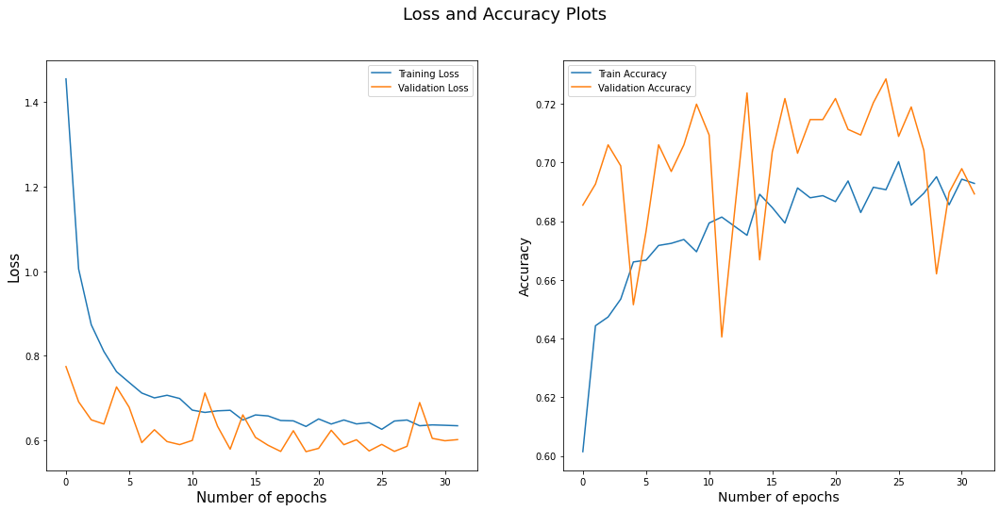

63/63 [==============================] - 4s 38ms/step
0.7635


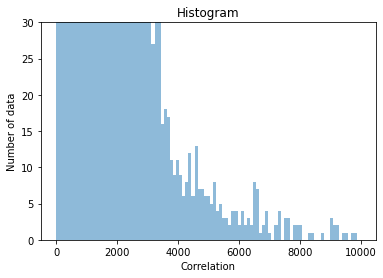

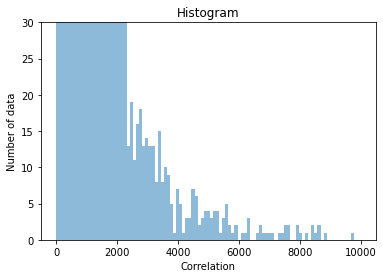

Model: "sequential_27"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_27 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


197/197 [==============================] - 17s 60ms/step - loss: 1.5821 - acc: 0.6117 - val_loss: 0.7636 - val_acc: 0.6877
Epoch 2/32
197/197 [==============================] - 9s 48ms/step - loss: 1.0652 - acc: 0.6418 - val_loss: 0.6777 - val_acc: 0.7106
Epoch 3/32
197/197 [==============================] - 9s 47ms/step - loss: 0.9014 - acc: 0.6577 - val_loss: 0.6860 - val_acc: 0.6966
Epoch 4/32
197/197 [==============================] - 10s 49ms/step - loss: 0.8170 - acc: 0.6759 - val_loss: 0.6414 - val_acc: 0.7157
Epoch 5/32
197/197 [==============================] - 9s 48ms/step - loss: 0.7680 - acc: 0.6832 - val_loss: 0.7337 - val_acc: 0.6832
Epoch 6/32
197/197 [==============================] - 9s 47ms/step - loss: 0.7550 - acc: 0.6848 - val_loss: 0.9431 - val_acc: 0.6106
Epoch 7/32
197/197 [==============================] - 9s 47ms/step - loss: 0.7532 - acc: 0.6797 - val_loss: 0.9531 - val_acc: 0.6150
Epoch 8/32
197/197 [==============================] - 9s 48ms/step - loss: 0.7

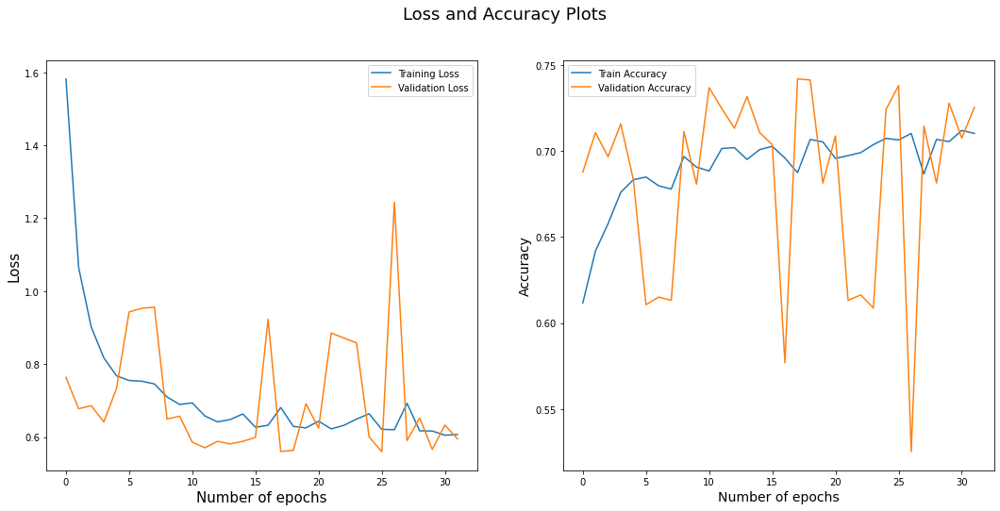

327/327 [==============================] - 12s 38ms/step
Round:  0
Test Accuracy:  0.722
Label Accuracy:  0.9849904397705544
Number of catagory 1:  5711.0
Number of catagory 2:  4749.0
Model: "sequential_28"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_28 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
__________________________________________________

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


262/262 [==============================] - 21s 58ms/step - loss: 1.3991 - acc: 0.6179 - val_loss: 0.8091 - val_acc: 0.6821
Epoch 2/32
262/262 [==============================] - 13s 51ms/step - loss: 0.9297 - acc: 0.6610 - val_loss: 0.6617 - val_acc: 0.6974
Epoch 3/32
262/262 [==============================] - 13s 51ms/step - loss: 0.8232 - acc: 0.6699 - val_loss: 0.6147 - val_acc: 0.7170
Epoch 4/32
262/262 [==============================] - 13s 50ms/step - loss: 0.7547 - acc: 0.6746 - val_loss: 0.6006 - val_acc: 0.7256
Epoch 5/32
262/262 [==============================] - 13s 50ms/step - loss: 0.7090 - acc: 0.6803 - val_loss: 0.5731 - val_acc: 0.7438
Epoch 6/32
262/262 [==============================] - 13s 51ms/step - loss: 0.6792 - acc: 0.6942 - val_loss: 0.5999 - val_acc: 0.6998
Epoch 7/32
262/262 [==============================] - 13s 49ms/step - loss: 0.6667 - acc: 0.6902 - val_loss: 0.5724 - val_acc: 0.7285
Epoch 8/32
262/262 [==============================] - 13s 51ms/step - los

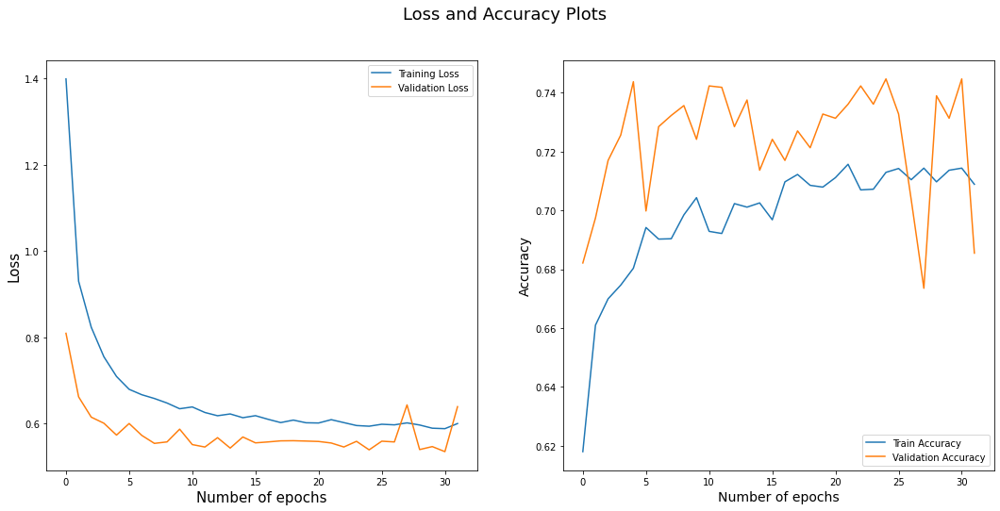

63/63 [==============================] - 4s 38ms/step
0.7335


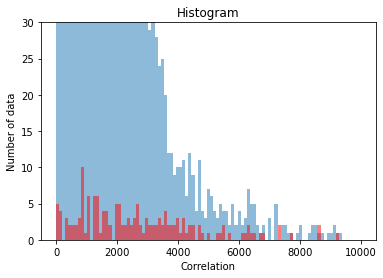

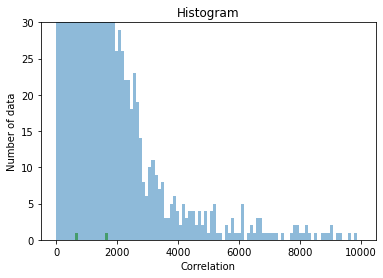

Model: "sequential_29"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_29 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


229/229 [==============================] - 19s 57ms/step - loss: 1.4756 - acc: 0.6090 - val_loss: 0.8440 - val_acc: 0.6809
Epoch 2/32
229/229 [==============================] - 11s 47ms/step - loss: 0.9702 - acc: 0.6493 - val_loss: 0.6686 - val_acc: 0.6885
Epoch 3/32
229/229 [==============================] - 10s 46ms/step - loss: 0.8524 - acc: 0.6612 - val_loss: 0.6717 - val_acc: 0.7011
Epoch 4/32
229/229 [==============================] - 11s 48ms/step - loss: 0.7741 - acc: 0.6788 - val_loss: 0.6171 - val_acc: 0.7158
Epoch 5/32
229/229 [==============================] - 11s 49ms/step - loss: 0.7384 - acc: 0.6777 - val_loss: 0.6074 - val_acc: 0.7120
Epoch 6/32
229/229 [==============================] - 11s 48ms/step - loss: 0.7116 - acc: 0.6832 - val_loss: 0.6039 - val_acc: 0.7038
Epoch 7/32
229/229 [==============================] - 11s 49ms/step - loss: 0.7000 - acc: 0.6801 - val_loss: 0.6073 - val_acc: 0.6913
Epoch 8/32
229/229 [==============================] - 11s 48ms/step - los

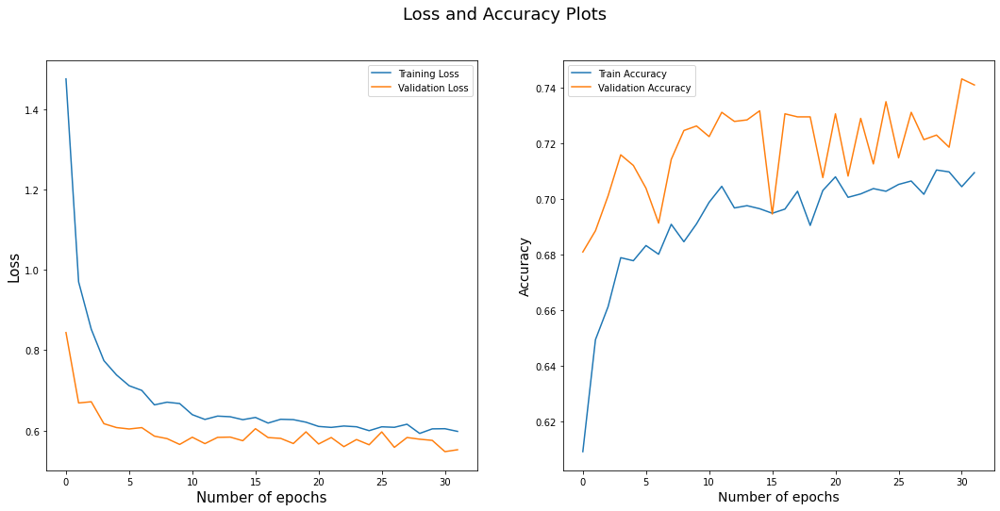

327/327 [==============================] - 12s 37ms/step
Round:  1
Test Accuracy:  0.7755
Label Accuracy:  0.9824091778202677
Number of catagory 1:  5738.0
Number of catagory 2:  4722.0
Model: "sequential_30"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_30 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


262/262 [==============================] - 21s 58ms/step - loss: 1.4010 - acc: 0.6215 - val_loss: 0.7586 - val_acc: 0.7012
Epoch 2/32
262/262 [==============================] - 13s 49ms/step - loss: 0.9255 - acc: 0.6630 - val_loss: 0.6449 - val_acc: 0.7199
Epoch 3/32
262/262 [==============================] - 13s 49ms/step - loss: 0.8371 - acc: 0.6782 - val_loss: 0.6120 - val_acc: 0.7122
Epoch 4/32
262/262 [==============================] - 13s 49ms/step - loss: 0.7702 - acc: 0.6714 - val_loss: 0.5833 - val_acc: 0.7323
Epoch 5/32
262/262 [==============================] - 13s 50ms/step - loss: 0.7097 - acc: 0.6871 - val_loss: 0.5824 - val_acc: 0.7347
Epoch 6/32
262/262 [==============================] - 13s 49ms/step - loss: 0.6808 - acc: 0.6922 - val_loss: 0.5696 - val_acc: 0.7318
Epoch 7/32
262/262 [==============================] - 13s 49ms/step - loss: 0.6678 - acc: 0.6956 - val_loss: 0.5722 - val_acc: 0.7275
Epoch 8/32
262/262 [==============================] - 13s 50ms/step - los

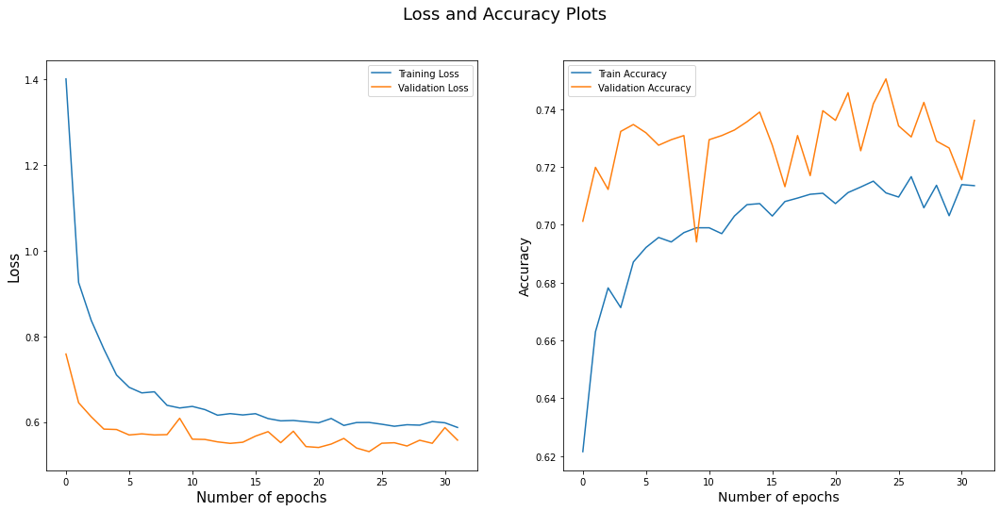

63/63 [==============================] - 4s 39ms/step
0.7715


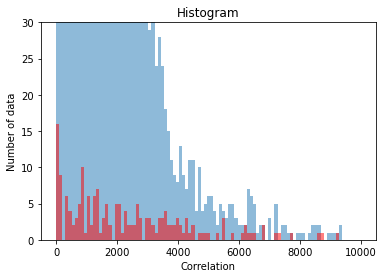

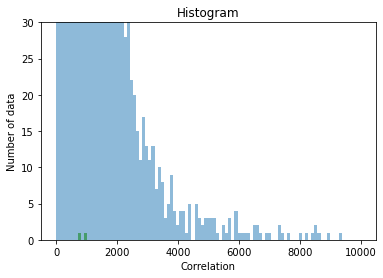

Model: "sequential_31"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_31 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


246/246 [==============================] - 21s 61ms/step - loss: 1.3897 - acc: 0.6109 - val_loss: 0.7407 - val_acc: 0.6879
Epoch 2/32
246/246 [==============================] - 13s 53ms/step - loss: 0.9637 - acc: 0.6511 - val_loss: 0.9923 - val_acc: 0.6150
Epoch 3/32
246/246 [==============================] - 13s 52ms/step - loss: 0.8562 - acc: 0.6640 - val_loss: 0.6305 - val_acc: 0.7063
Epoch 4/32
246/246 [==============================] - 13s 51ms/step - loss: 0.7769 - acc: 0.6748 - val_loss: 0.5948 - val_acc: 0.7267
Epoch 5/32
246/246 [==============================] - 13s 52ms/step - loss: 0.7370 - acc: 0.6839 - val_loss: 0.6396 - val_acc: 0.6894
Epoch 6/32
246/246 [==============================] - 13s 51ms/step - loss: 0.7229 - acc: 0.6825 - val_loss: 0.6835 - val_acc: 0.6884
Epoch 7/32
246/246 [==============================] - 13s 52ms/step - loss: 0.6906 - acc: 0.6873 - val_loss: 0.6128 - val_acc: 0.6935
Epoch 8/32
246/246 [==============================] - 13s 51ms/step - los

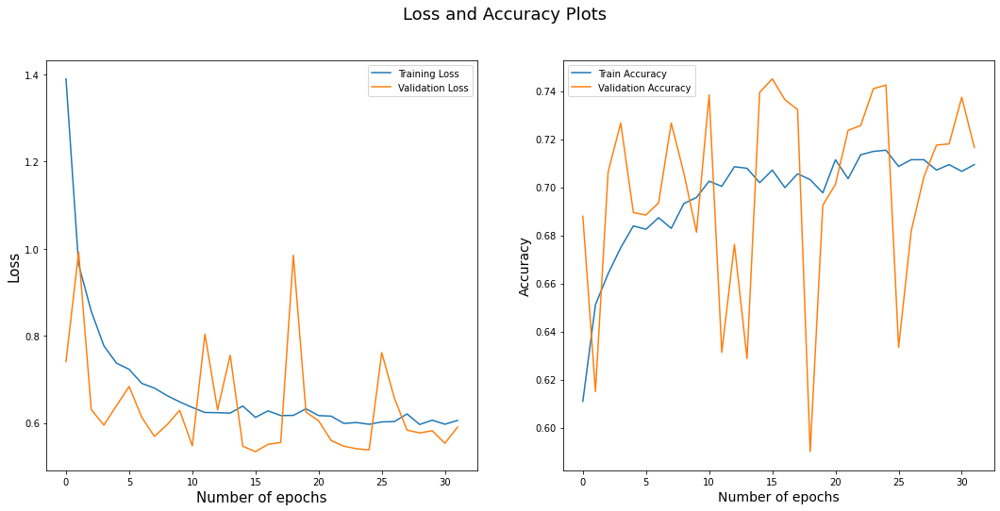

327/327 [==============================] - 12s 38ms/step
Round:  2
Test Accuracy:  0.763
Label Accuracy:  0.9819311663479924
Number of catagory 1:  5733.0
Number of catagory 2:  4727.0
Model: "sequential_32"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_32 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
__________________________________________________

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


262/262 [==============================] - 22s 59ms/step - loss: 1.4241 - acc: 0.6181 - val_loss: 0.7422 - val_acc: 0.6912
Epoch 2/32
262/262 [==============================] - 13s 50ms/step - loss: 0.9337 - acc: 0.6610 - val_loss: 0.6117 - val_acc: 0.7204
Epoch 3/32
262/262 [==============================] - 13s 51ms/step - loss: 0.8349 - acc: 0.6709 - val_loss: 0.5922 - val_acc: 0.7208
Epoch 4/32
262/262 [==============================] - 13s 51ms/step - loss: 0.7290 - acc: 0.6891 - val_loss: 0.5605 - val_acc: 0.7390
Epoch 5/32
262/262 [==============================] - 13s 51ms/step - loss: 0.7136 - acc: 0.6863 - val_loss: 0.5721 - val_acc: 0.7261
Epoch 6/32
262/262 [==============================] - 13s 51ms/step - loss: 0.6759 - acc: 0.6931 - val_loss: 0.5507 - val_acc: 0.7395
Epoch 7/32
262/262 [==============================] - 13s 51ms/step - loss: 0.6553 - acc: 0.7016 - val_loss: 0.5474 - val_acc: 0.7337
Epoch 8/32
262/262 [==============================] - 13s 50ms/step - los

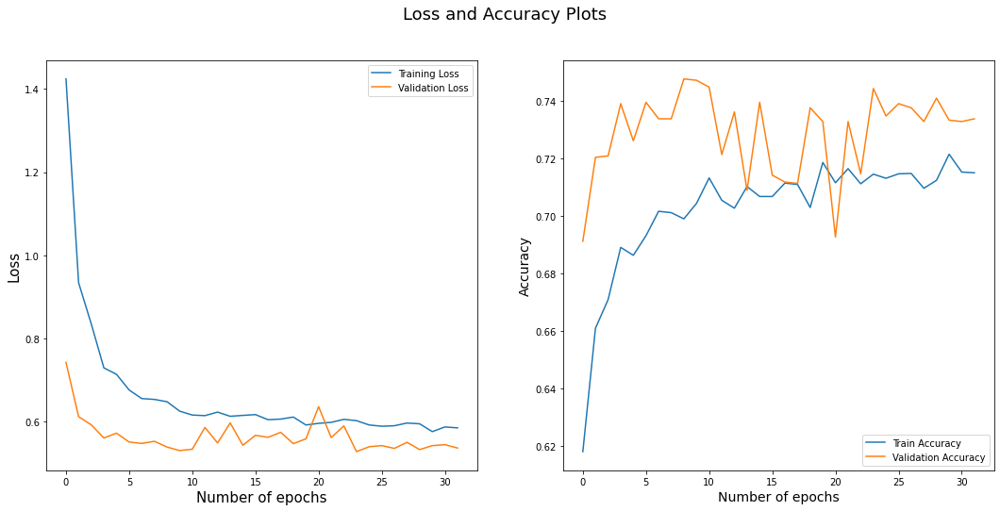

63/63 [==============================] - 5s 38ms/step
0.781


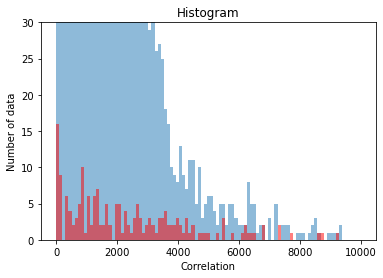

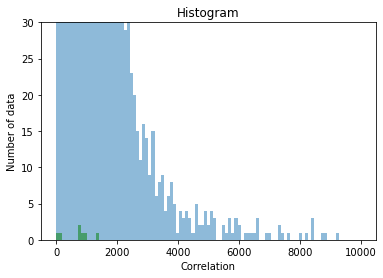

Model: "sequential_33"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_33 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


254/254 [==============================] - 22s 62ms/step - loss: 1.4145 - acc: 0.6194 - val_loss: 0.7099 - val_acc: 0.7122
Epoch 2/32
254/254 [==============================] - 13s 49ms/step - loss: 0.9609 - acc: 0.6556 - val_loss: 0.6397 - val_acc: 0.7226
Epoch 3/32
254/254 [==============================] - 13s 50ms/step - loss: 0.8397 - acc: 0.6644 - val_loss: 0.5921 - val_acc: 0.7330
Epoch 4/32
254/254 [==============================] - 13s 50ms/step - loss: 0.7707 - acc: 0.6765 - val_loss: 0.5999 - val_acc: 0.7216
Epoch 5/32
254/254 [==============================] - 13s 50ms/step - loss: 0.7231 - acc: 0.6860 - val_loss: 0.6379 - val_acc: 0.7034
Epoch 6/32
254/254 [==============================] - 13s 50ms/step - loss: 0.6865 - acc: 0.6889 - val_loss: 0.5997 - val_acc: 0.6999
Epoch 7/32
254/254 [==============================] - 13s 51ms/step - loss: 0.6722 - acc: 0.6915 - val_loss: 0.5932 - val_acc: 0.7201
Epoch 8/32
254/254 [==============================] - 13s 50ms/step - los

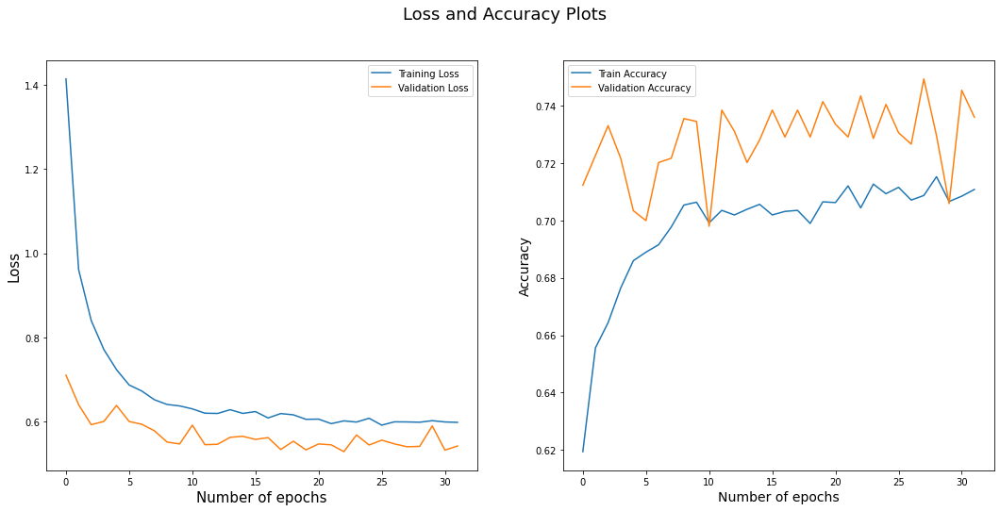

327/327 [==============================] - 13s 38ms/step
Round:  3
Test Accuracy:  0.767
Label Accuracy:  0.9812619502868068
Number of catagory 1:  5740.0
Number of catagory 2:  4720.0
Model: "sequential_34"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_34 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
__________________________________________________

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


262/262 [==============================] - 20s 56ms/step - loss: 1.4309 - acc: 0.6175 - val_loss: 0.7172 - val_acc: 0.7170
Epoch 2/32
262/262 [==============================] - 13s 50ms/step - loss: 0.9265 - acc: 0.6641 - val_loss: 0.6483 - val_acc: 0.7075
Epoch 3/32
262/262 [==============================] - 13s 51ms/step - loss: 0.8123 - acc: 0.6745 - val_loss: 0.5941 - val_acc: 0.7204
Epoch 4/32
262/262 [==============================] - 13s 51ms/step - loss: 0.7465 - acc: 0.6804 - val_loss: 0.5848 - val_acc: 0.7213
Epoch 5/32
262/262 [==============================] - 13s 49ms/step - loss: 0.7052 - acc: 0.6836 - val_loss: 0.5703 - val_acc: 0.7266
Epoch 6/32
262/262 [==============================] - 13s 49ms/step - loss: 0.6757 - acc: 0.6934 - val_loss: 0.5535 - val_acc: 0.7357
Epoch 7/32
262/262 [==============================] - 13s 50ms/step - loss: 0.6680 - acc: 0.6996 - val_loss: 0.6293 - val_acc: 0.6855
Epoch 8/32
262/262 [==============================] - 13s 49ms/step - los

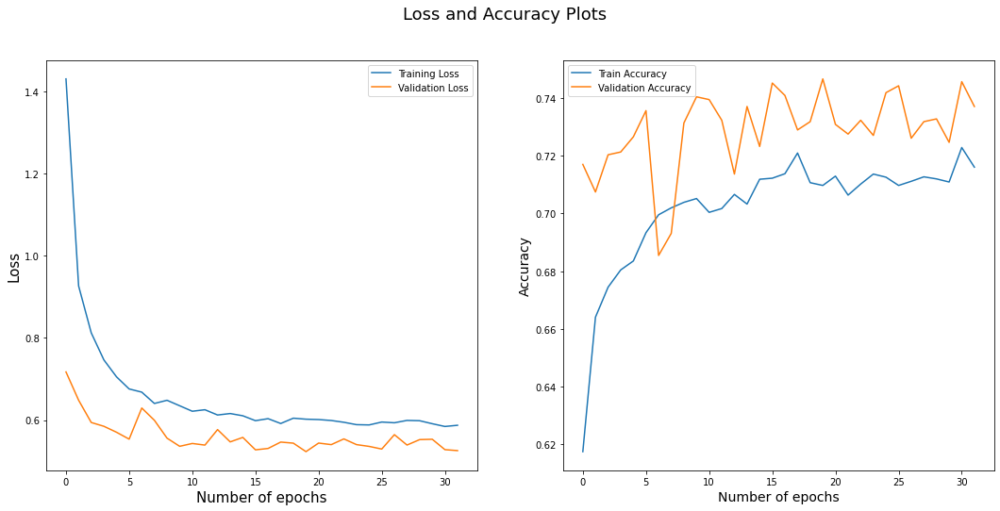

63/63 [==============================] - 7s 41ms/step
0.7795


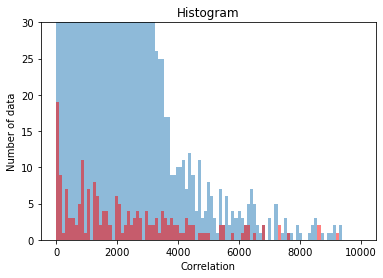

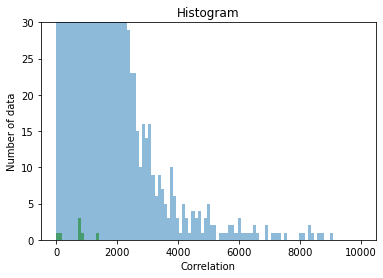

Model: "sequential_35"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_35 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


258/258 [==============================] - 21s 64ms/step - loss: 1.3857 - acc: 0.6175 - val_loss: 0.6886 - val_acc: 0.7164
Epoch 2/32
258/258 [==============================] - 13s 52ms/step - loss: 0.9336 - acc: 0.6570 - val_loss: 0.6394 - val_acc: 0.7275
Epoch 3/32
258/258 [==============================] - 14s 53ms/step - loss: 0.8176 - acc: 0.6733 - val_loss: 0.5844 - val_acc: 0.7280
Epoch 4/32
258/258 [==============================] - 13s 51ms/step - loss: 0.7405 - acc: 0.6808 - val_loss: 0.5721 - val_acc: 0.7217
Epoch 5/32
258/258 [==============================] - 14s 53ms/step - loss: 0.7097 - acc: 0.6848 - val_loss: 0.5668 - val_acc: 0.7280
Epoch 6/32
258/258 [==============================] - 13s 51ms/step - loss: 0.6701 - acc: 0.6896 - val_loss: 0.5734 - val_acc: 0.7295
Epoch 7/32
258/258 [==============================] - 13s 51ms/step - loss: 0.6733 - acc: 0.6939 - val_loss: 0.5647 - val_acc: 0.7334
Epoch 8/32
258/258 [==============================] - 13s 51ms/step - los

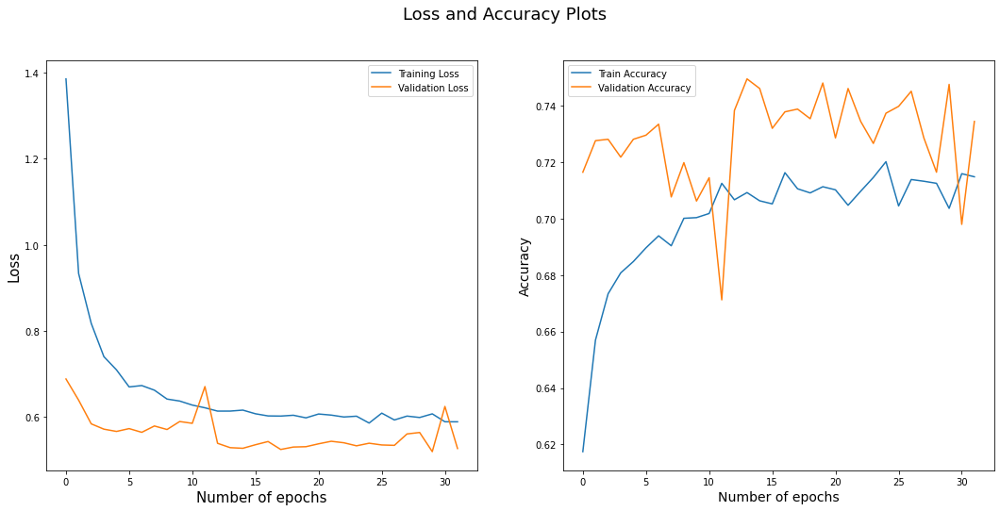

327/327 [==============================] - 13s 38ms/step
Round:  4
Test Accuracy:  0.773
Label Accuracy:  0.9809751434034417
Number of catagory 1:  5743.0
Number of catagory 2:  4717.0
Model: "sequential_36"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_36 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
__________________________________________________

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


262/262 [==============================] - 19s 54ms/step - loss: 1.4785 - acc: 0.6178 - val_loss: 0.6543 - val_acc: 0.7132
Epoch 2/32
262/262 [==============================] - 13s 48ms/step - loss: 0.9356 - acc: 0.6591 - val_loss: 0.6235 - val_acc: 0.7046
Epoch 3/32
262/262 [==============================] - 13s 48ms/step - loss: 0.7916 - acc: 0.6765 - val_loss: 0.5811 - val_acc: 0.7223
Epoch 4/32
262/262 [==============================] - 12s 47ms/step - loss: 0.7449 - acc: 0.6855 - val_loss: 0.5828 - val_acc: 0.7122
Epoch 5/32
262/262 [==============================] - 12s 47ms/step - loss: 0.7103 - acc: 0.6889 - val_loss: 0.5602 - val_acc: 0.7371
Epoch 6/32
262/262 [==============================] - 12s 47ms/step - loss: 0.6688 - acc: 0.6983 - val_loss: 0.5692 - val_acc: 0.7170
Epoch 7/32
262/262 [==============================] - 13s 49ms/step - loss: 0.6582 - acc: 0.6950 - val_loss: 0.5455 - val_acc: 0.7347
Epoch 8/32
262/262 [==============================] - 13s 48ms/step - los

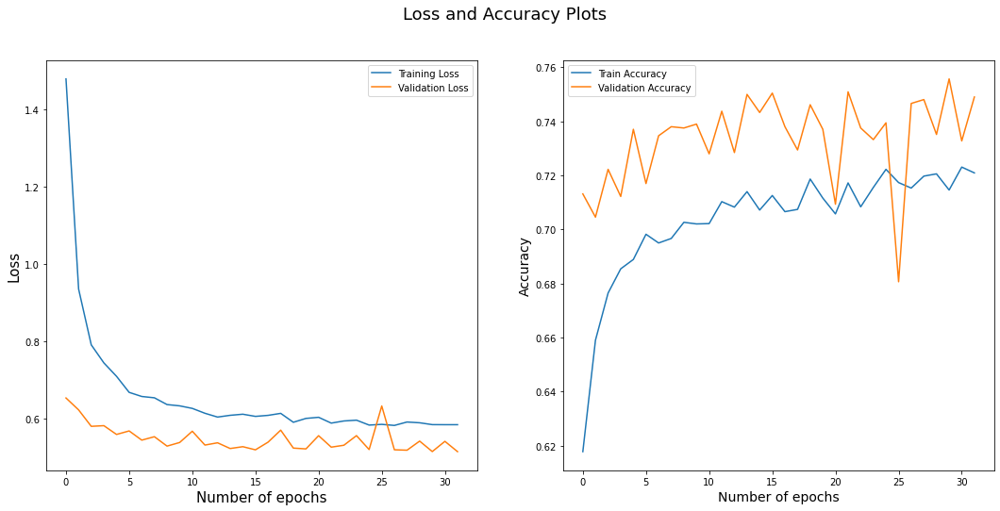

63/63 [==============================] - 4s 39ms/step
0.791


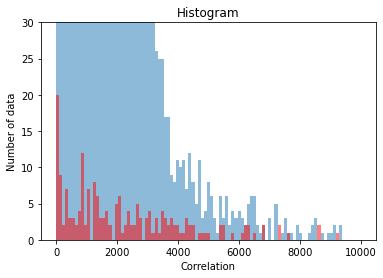

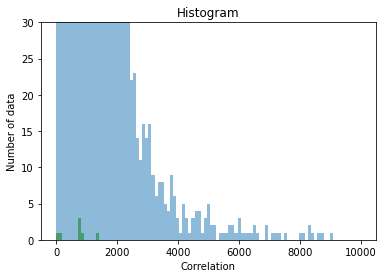

Model: "sequential_37"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_37 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


260/260 [==============================] - 20s 58ms/step - loss: 1.4229 - acc: 0.6206 - val_loss: 0.7215 - val_acc: 0.6932
Epoch 2/32
260/260 [==============================] - 14s 52ms/step - loss: 0.9468 - acc: 0.6608 - val_loss: 0.6451 - val_acc: 0.7187
Epoch 3/32
260/260 [==============================] - 14s 52ms/step - loss: 0.8349 - acc: 0.6681 - val_loss: 0.6136 - val_acc: 0.7201
Epoch 4/32
260/260 [==============================] - 13s 52ms/step - loss: 0.7596 - acc: 0.6776 - val_loss: 0.5871 - val_acc: 0.7254
Epoch 5/32
260/260 [==============================] - 13s 51ms/step - loss: 0.7258 - acc: 0.6871 - val_loss: 0.5839 - val_acc: 0.7264
Epoch 6/32
260/260 [==============================] - 13s 51ms/step - loss: 0.6868 - acc: 0.6923 - val_loss: 0.5497 - val_acc: 0.7418
Epoch 7/32
260/260 [==============================] - 13s 51ms/step - loss: 0.6649 - acc: 0.6960 - val_loss: 0.5668 - val_acc: 0.7269
Epoch 8/32
260/260 [==============================] - 14s 53ms/step - los

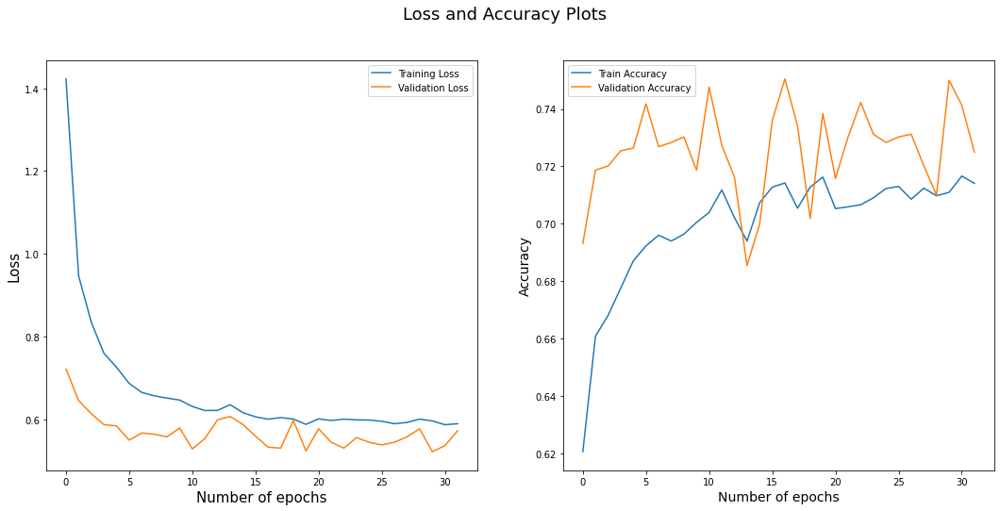

327/327 [==============================] - 13s 38ms/step
Round:  5
Test Accuracy:  0.737
Label Accuracy:  0.9802103250478011
Number of catagory 1:  5751.0
Number of catagory 2:  4709.0
Model: "sequential_38"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_38 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
__________________________________________________

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


262/262 [==============================] - 20s 58ms/step - loss: 1.4185 - acc: 0.6212 - val_loss: 0.7640 - val_acc: 0.6969
Epoch 2/32
262/262 [==============================] - 13s 49ms/step - loss: 0.9540 - acc: 0.6696 - val_loss: 0.6302 - val_acc: 0.7228
Epoch 3/32
262/262 [==============================] - 13s 49ms/step - loss: 0.8193 - acc: 0.6732 - val_loss: 0.6435 - val_acc: 0.6993
Epoch 4/32
262/262 [==============================] - 13s 48ms/step - loss: 0.7558 - acc: 0.6793 - val_loss: 0.6252 - val_acc: 0.7180
Epoch 5/32
262/262 [==============================] - 13s 48ms/step - loss: 0.7131 - acc: 0.6929 - val_loss: 0.5692 - val_acc: 0.7328
Epoch 6/32
262/262 [==============================] - 13s 49ms/step - loss: 0.6873 - acc: 0.6887 - val_loss: 0.5497 - val_acc: 0.7347
Epoch 7/32
262/262 [==============================] - 13s 48ms/step - loss: 0.6734 - acc: 0.6935 - val_loss: 0.5625 - val_acc: 0.7347
Epoch 8/32
262/262 [==============================] - 12s 47ms/step - los

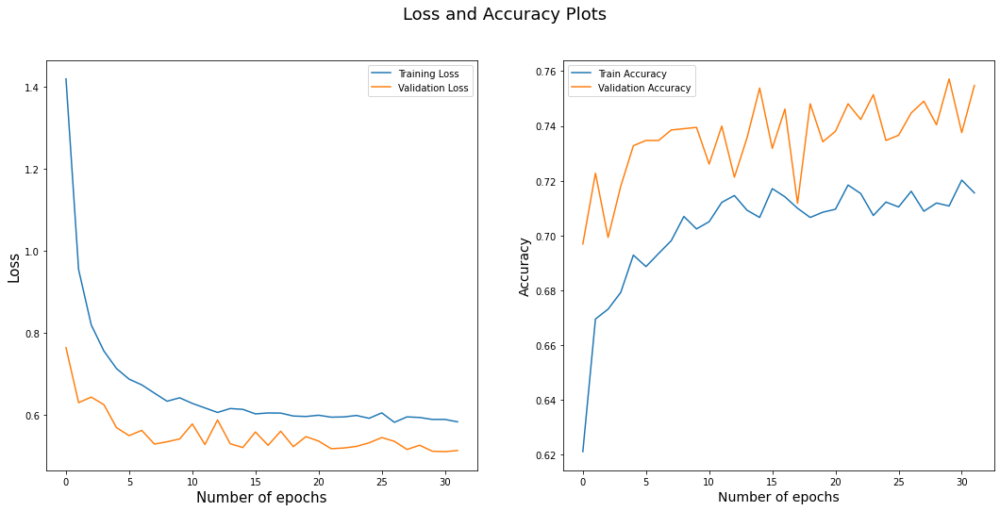

63/63 [==============================] - 4s 36ms/step
0.7865


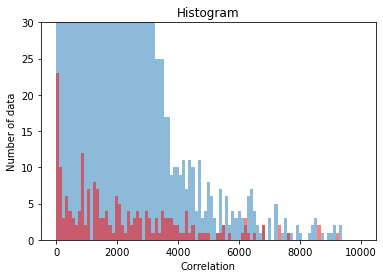

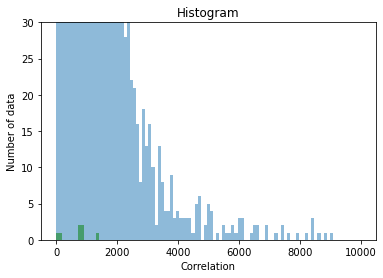

Model: "sequential_39"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_39 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


261/261 [==============================] - 21s 59ms/step - loss: 1.4153 - acc: 0.6158 - val_loss: 0.6848 - val_acc: 0.7284
Epoch 2/32
261/261 [==============================] - 13s 50ms/step - loss: 0.9449 - acc: 0.6593 - val_loss: 0.6043 - val_acc: 0.7270
Epoch 3/32
261/261 [==============================] - 13s 51ms/step - loss: 0.7901 - acc: 0.6894 - val_loss: 0.5791 - val_acc: 0.7217
Epoch 4/32
261/261 [==============================] - 13s 51ms/step - loss: 0.7450 - acc: 0.6899 - val_loss: 0.5723 - val_acc: 0.7375
Epoch 5/32
261/261 [==============================] - 13s 50ms/step - loss: 0.7098 - acc: 0.6871 - val_loss: 0.5754 - val_acc: 0.7231
Epoch 6/32
261/261 [==============================] - 13s 50ms/step - loss: 0.6944 - acc: 0.6827 - val_loss: 0.5302 - val_acc: 0.7481
Epoch 7/32
261/261 [==============================] - 13s 49ms/step - loss: 0.6663 - acc: 0.6924 - val_loss: 0.5495 - val_acc: 0.7385
Epoch 8/32
261/261 [==============================] - 13s 50ms/step - los

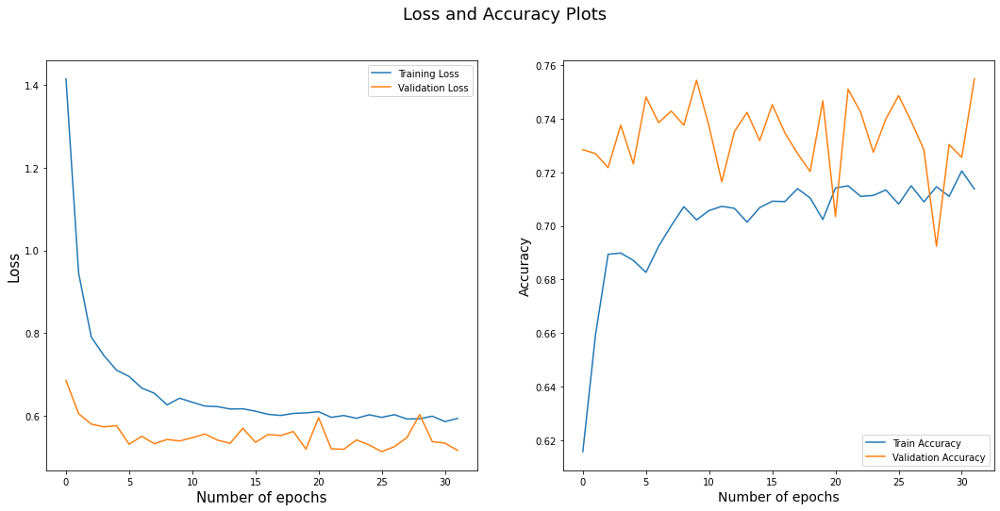

327/327 [==============================] - 12s 38ms/step
Round:  6
Test Accuracy:  0.78
Label Accuracy:  0.9800191204588911
Number of catagory 1:  5753.0
Number of catagory 2:  4707.0
Model: "sequential_40"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_40 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
___________________________________________________

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


262/262 [==============================] - 20s 56ms/step - loss: 1.4141 - acc: 0.6295 - val_loss: 0.6725 - val_acc: 0.7161
Epoch 2/32
262/262 [==============================] - 12s 48ms/step - loss: 0.9231 - acc: 0.6642 - val_loss: 0.6702 - val_acc: 0.6993
Epoch 3/32
262/262 [==============================] - 13s 49ms/step - loss: 0.8058 - acc: 0.6761 - val_loss: 0.5872 - val_acc: 0.7199
Epoch 4/32
262/262 [==============================] - 13s 48ms/step - loss: 0.7582 - acc: 0.6834 - val_loss: 0.5568 - val_acc: 0.7352
Epoch 5/32
262/262 [==============================] - 13s 49ms/step - loss: 0.7138 - acc: 0.6902 - val_loss: 0.6041 - val_acc: 0.7127
Epoch 6/32
262/262 [==============================] - 13s 49ms/step - loss: 0.6807 - acc: 0.6907 - val_loss: 0.5314 - val_acc: 0.7371
Epoch 7/32
262/262 [==============================] - 13s 49ms/step - loss: 0.6599 - acc: 0.6973 - val_loss: 0.5298 - val_acc: 0.7409
Epoch 8/32
262/262 [==============================] - 13s 49ms/step - los

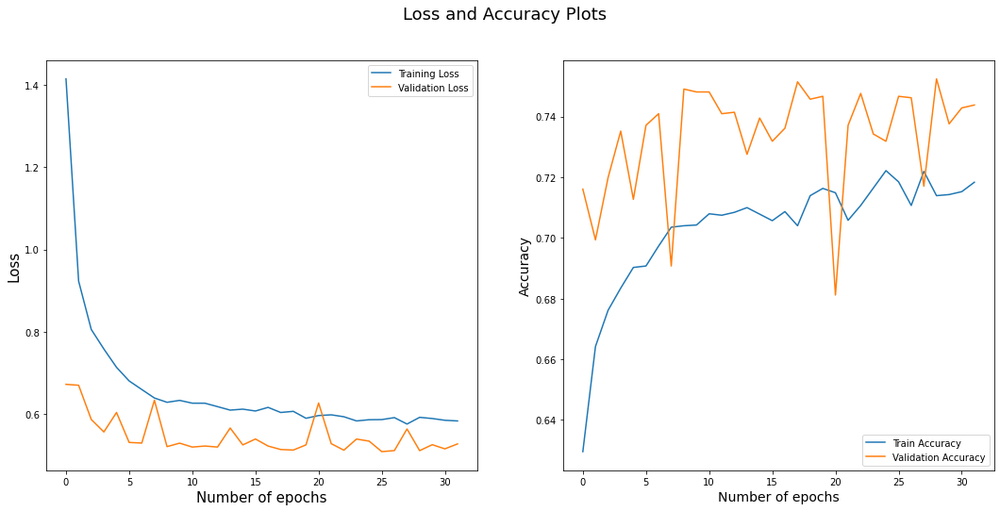

63/63 [==============================] - 4s 38ms/step
0.7795


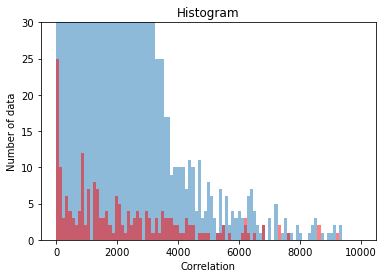

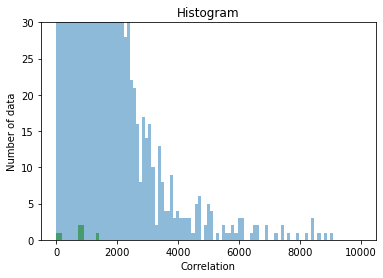

Model: "sequential_41"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_41 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


261/261 [==============================] - 20s 58ms/step - loss: 1.4463 - acc: 0.6269 - val_loss: 0.6584 - val_acc: 0.7040
Epoch 2/32
261/261 [==============================] - 13s 50ms/step - loss: 0.9323 - acc: 0.6640 - val_loss: 0.5960 - val_acc: 0.7179
Epoch 3/32
261/261 [==============================] - 12s 47ms/step - loss: 0.8207 - acc: 0.6703 - val_loss: 0.6541 - val_acc: 0.6968
Epoch 4/32
261/261 [==============================] - 13s 49ms/step - loss: 0.7411 - acc: 0.6809 - val_loss: 0.5599 - val_acc: 0.7438
Epoch 5/32
261/261 [==============================] - 13s 48ms/step - loss: 0.7011 - acc: 0.6947 - val_loss: 0.5892 - val_acc: 0.7045
Epoch 6/32
261/261 [==============================] - 13s 50ms/step - loss: 0.6912 - acc: 0.6902 - val_loss: 0.5515 - val_acc: 0.7208
Epoch 7/32
261/261 [==============================] - 13s 49ms/step - loss: 0.6498 - acc: 0.7000 - val_loss: 0.5388 - val_acc: 0.7375
Epoch 8/32
261/261 [==============================] - 13s 49ms/step - los

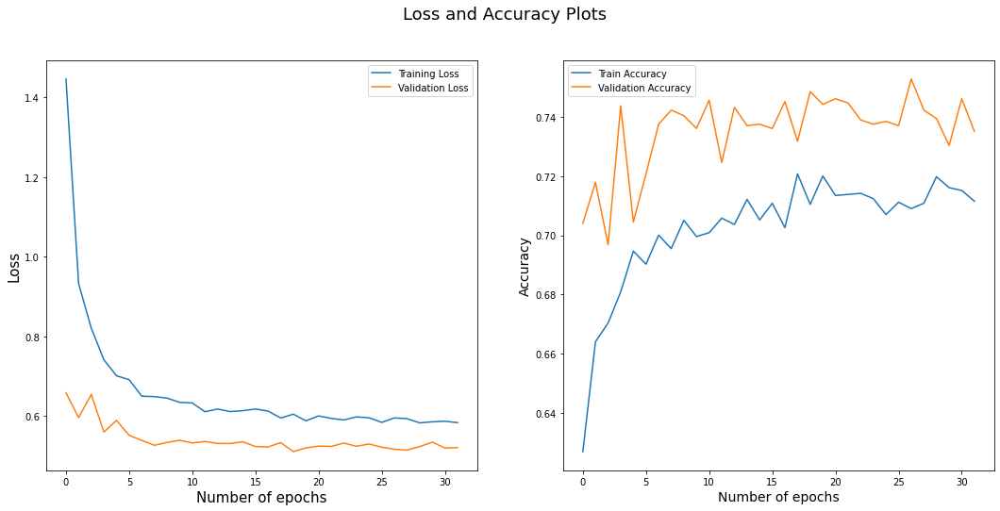

327/327 [==============================] - 13s 38ms/step
Round:  7
Test Accuracy:  0.7785
Label Accuracy:  0.9800191204588911
Number of catagory 1:  5753.0
Number of catagory 2:  4707.0
Model: "sequential_42"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_42 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


262/262 [==============================] - 21s 54ms/step - loss: 1.3976 - acc: 0.6309 - val_loss: 0.7748 - val_acc: 0.6831
Epoch 2/32
262/262 [==============================] - 13s 49ms/step - loss: 0.9253 - acc: 0.6605 - val_loss: 0.6759 - val_acc: 0.7070
Epoch 3/32
262/262 [==============================] - 13s 48ms/step - loss: 0.7999 - acc: 0.6747 - val_loss: 0.6137 - val_acc: 0.7118
Epoch 4/32
262/262 [==============================] - 13s 50ms/step - loss: 0.7598 - acc: 0.6769 - val_loss: 0.5984 - val_acc: 0.7122
Epoch 5/32
262/262 [==============================] - 13s 49ms/step - loss: 0.7166 - acc: 0.6833 - val_loss: 0.5972 - val_acc: 0.7084
Epoch 6/32
262/262 [==============================] - 13s 49ms/step - loss: 0.6813 - acc: 0.6867 - val_loss: 0.5845 - val_acc: 0.7290
Epoch 7/32
262/262 [==============================] - 13s 48ms/step - loss: 0.6647 - acc: 0.7026 - val_loss: 0.5346 - val_acc: 0.7457
Epoch 8/32
262/262 [==============================] - 13s 48ms/step - los

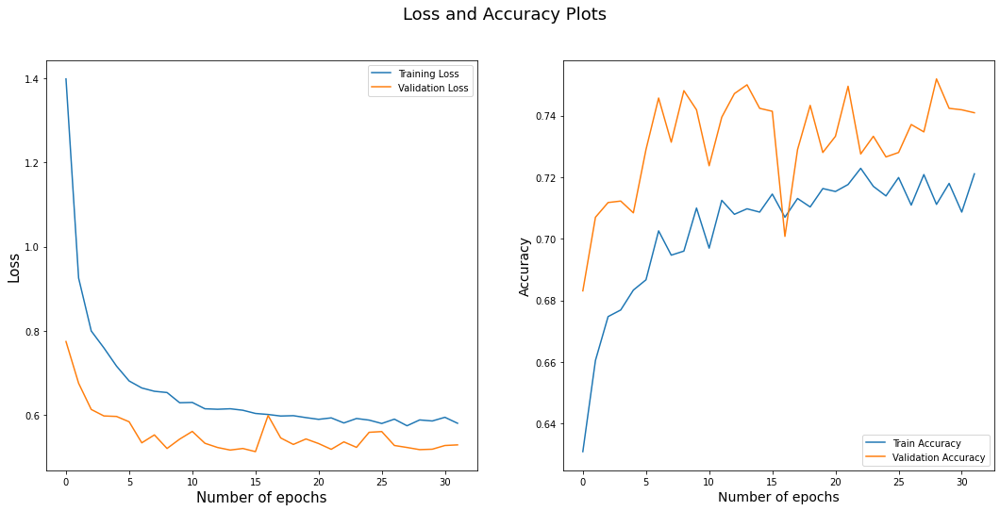

63/63 [==============================] - 4s 37ms/step
0.7655


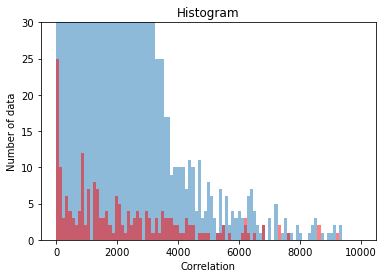

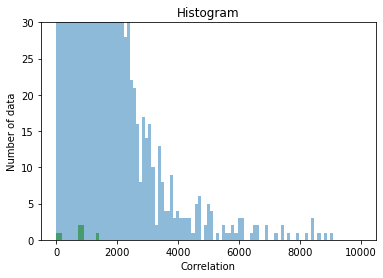

Model: "sequential_43"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_43 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


262/262 [==============================] - 21s 60ms/step - loss: 1.4128 - acc: 0.6226 - val_loss: 0.6950 - val_acc: 0.7067
Epoch 2/32
262/262 [==============================] - 14s 53ms/step - loss: 0.9547 - acc: 0.6608 - val_loss: 0.6381 - val_acc: 0.7086
Epoch 3/32
262/262 [==============================] - 14s 52ms/step - loss: 0.8439 - acc: 0.6647 - val_loss: 0.5932 - val_acc: 0.7292
Epoch 4/32
262/262 [==============================] - 14s 52ms/step - loss: 0.7334 - acc: 0.6830 - val_loss: 0.6064 - val_acc: 0.7368
Epoch 5/32
262/262 [==============================] - 14s 52ms/step - loss: 0.7231 - acc: 0.6840 - val_loss: 0.5516 - val_acc: 0.7474
Epoch 6/32
262/262 [==============================] - 14s 53ms/step - loss: 0.6884 - acc: 0.6949 - val_loss: 0.5598 - val_acc: 0.7292
Epoch 7/32
262/262 [==============================] - 14s 52ms/step - loss: 0.6849 - acc: 0.6842 - val_loss: 0.5793 - val_acc: 0.7220
Epoch 8/32
262/262 [==============================] - 13s 51ms/step - los

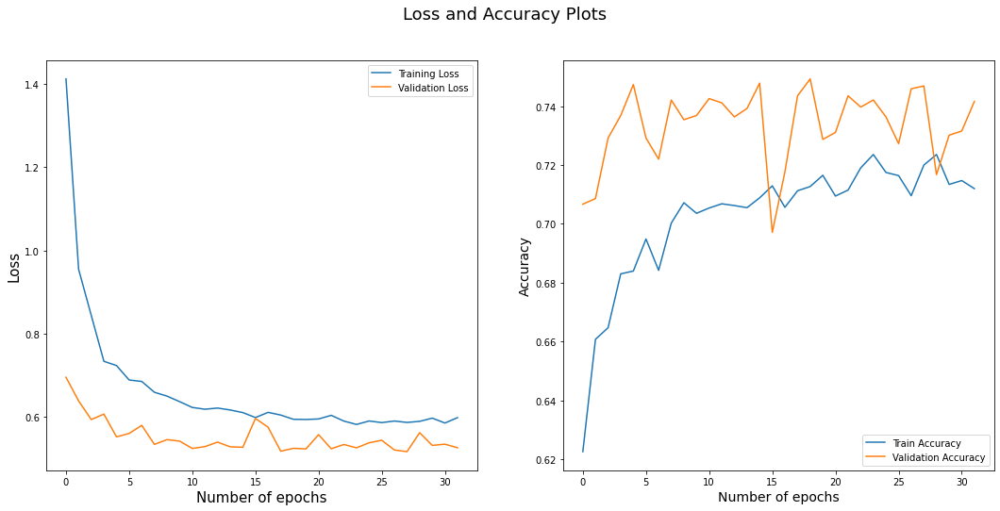

327/327 [==============================] - 12s 37ms/step
Round:  8
Test Accuracy:  0.781
Label Accuracy:  0.9795411089866157
Number of catagory 1:  5752.0
Number of catagory 2:  4708.0
Model: "sequential_44"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_44 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
__________________________________________________

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


262/262 [==============================] - 21s 57ms/step - loss: 1.4319 - acc: 0.6178 - val_loss: 0.7131 - val_acc: 0.7036
Epoch 2/32
262/262 [==============================] - 13s 51ms/step - loss: 0.9385 - acc: 0.6623 - val_loss: 0.6261 - val_acc: 0.7161
Epoch 3/32
262/262 [==============================] - 13s 50ms/step - loss: 0.8374 - acc: 0.6746 - val_loss: 0.5713 - val_acc: 0.7361
Epoch 4/32
262/262 [==============================] - 14s 52ms/step - loss: 0.7518 - acc: 0.6789 - val_loss: 0.5696 - val_acc: 0.7428
Epoch 5/32
262/262 [==============================] - 13s 49ms/step - loss: 0.7141 - acc: 0.6883 - val_loss: 0.5814 - val_acc: 0.7275
Epoch 6/32
262/262 [==============================] - 13s 50ms/step - loss: 0.6876 - acc: 0.6899 - val_loss: 0.5502 - val_acc: 0.7385
Epoch 7/32
262/262 [==============================] - 13s 50ms/step - loss: 0.6666 - acc: 0.6924 - val_loss: 0.5257 - val_acc: 0.7500
Epoch 8/32
262/262 [==============================] - 13s 50ms/step - los

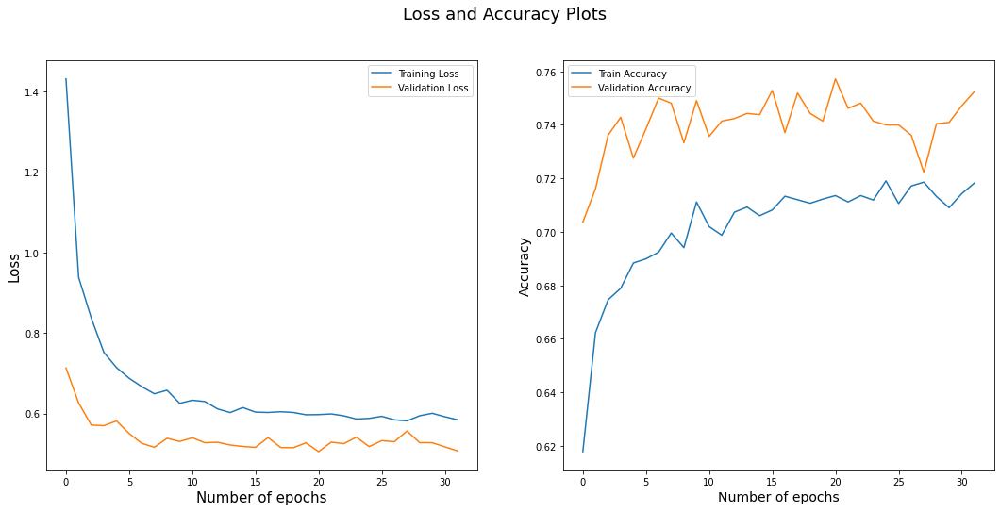

63/63 [==============================] - 5s 38ms/step
0.79


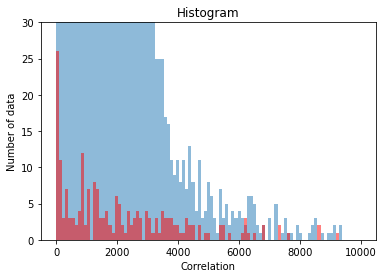

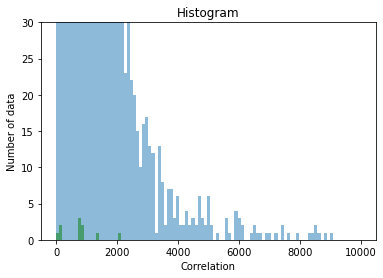

Model: "sequential_45"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_45 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


262/262 [==============================] - 22s 59ms/step - loss: 1.4347 - acc: 0.6185 - val_loss: 0.6561 - val_acc: 0.7131
Epoch 2/32
262/262 [==============================] - 13s 49ms/step - loss: 0.9309 - acc: 0.6665 - val_loss: 0.6503 - val_acc: 0.7126
Epoch 3/32
262/262 [==============================] - 13s 49ms/step - loss: 0.8197 - acc: 0.6671 - val_loss: 0.5946 - val_acc: 0.7207
Epoch 4/32
262/262 [==============================] - 13s 50ms/step - loss: 0.7355 - acc: 0.6856 - val_loss: 0.5900 - val_acc: 0.7327
Epoch 5/32
262/262 [==============================] - 13s 49ms/step - loss: 0.7013 - acc: 0.6893 - val_loss: 0.5495 - val_acc: 0.7427
Epoch 6/32
262/262 [==============================] - 13s 49ms/step - loss: 0.6888 - acc: 0.6880 - val_loss: 0.5575 - val_acc: 0.7293
Epoch 7/32
262/262 [==============================] - 13s 49ms/step - loss: 0.6599 - acc: 0.7010 - val_loss: 0.5510 - val_acc: 0.7374
Epoch 8/32
262/262 [==============================] - 13s 48ms/step - los

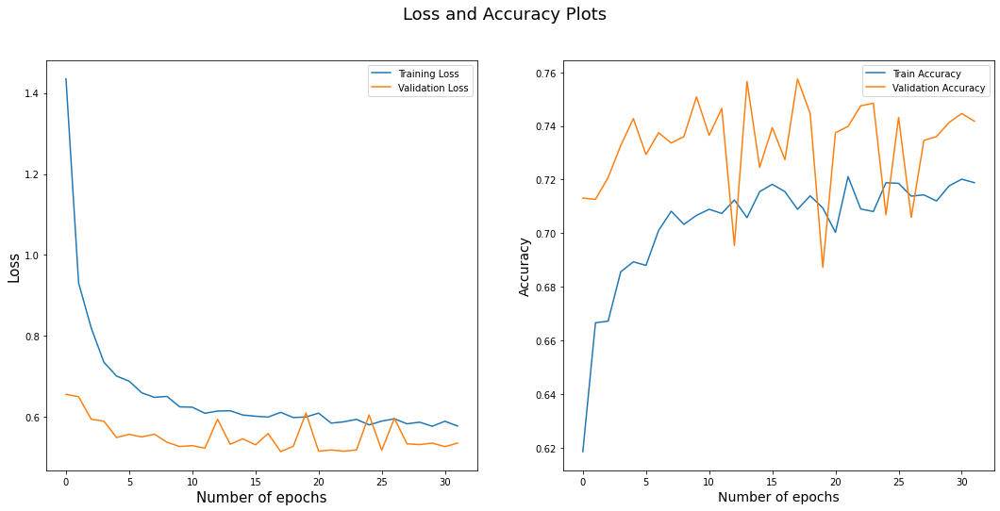

327/327 [==============================] - 12s 38ms/step
Round:  9
Test Accuracy:  0.767
Label Accuracy:  0.9794455066921606
Number of catagory 1:  5753.0
Number of catagory 2:  4707.0
Model: "sequential_46"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_46 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
__________________________________________________

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


262/262 [==============================] - 21s 58ms/step - loss: 1.4655 - acc: 0.6179 - val_loss: 0.6699 - val_acc: 0.7165
Epoch 2/32
262/262 [==============================] - 13s 50ms/step - loss: 0.9597 - acc: 0.6576 - val_loss: 0.6147 - val_acc: 0.7232
Epoch 3/32
262/262 [==============================] - 13s 49ms/step - loss: 0.8022 - acc: 0.6718 - val_loss: 0.5818 - val_acc: 0.7294
Epoch 4/32
262/262 [==============================] - 13s 49ms/step - loss: 0.7441 - acc: 0.6813 - val_loss: 0.5545 - val_acc: 0.7424
Epoch 5/32
262/262 [==============================] - 13s 50ms/step - loss: 0.6985 - acc: 0.6926 - val_loss: 0.5554 - val_acc: 0.7357
Epoch 6/32
262/262 [==============================] - 13s 50ms/step - loss: 0.6797 - acc: 0.6960 - val_loss: 0.5412 - val_acc: 0.7438
Epoch 7/32
262/262 [==============================] - 13s 50ms/step - loss: 0.6513 - acc: 0.7039 - val_loss: 0.5367 - val_acc: 0.7428
Epoch 8/32
262/262 [==============================] - 13s 51ms/step - los

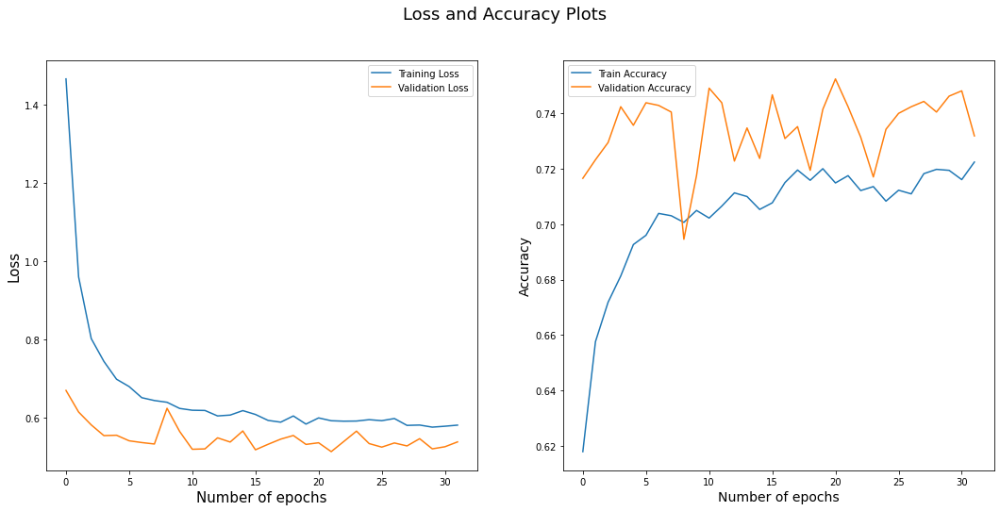

63/63 [==============================] - 5s 38ms/step
0.753


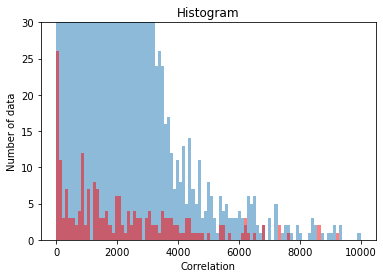

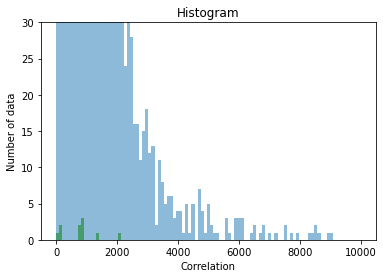

Model: "sequential_47"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_47 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


262/262 [==============================] - 22s 59ms/step - loss: 1.3908 - acc: 0.6237 - val_loss: 0.6603 - val_acc: 0.7202
Epoch 2/32
262/262 [==============================] - 13s 50ms/step - loss: 0.9298 - acc: 0.6612 - val_loss: 0.6189 - val_acc: 0.7121
Epoch 3/32
262/262 [==============================] - 13s 51ms/step - loss: 0.8157 - acc: 0.6718 - val_loss: 0.5679 - val_acc: 0.7284
Epoch 4/32
262/262 [==============================] - 13s 48ms/step - loss: 0.7567 - acc: 0.6878 - val_loss: 0.5603 - val_acc: 0.7298
Epoch 5/32
262/262 [==============================] - 13s 50ms/step - loss: 0.7131 - acc: 0.6838 - val_loss: 0.5982 - val_acc: 0.7293
Epoch 6/32
262/262 [==============================] - 13s 49ms/step - loss: 0.6733 - acc: 0.6999 - val_loss: 0.5373 - val_acc: 0.7331
Epoch 7/32
262/262 [==============================] - 13s 49ms/step - loss: 0.6649 - acc: 0.6939 - val_loss: 0.5356 - val_acc: 0.7360
Epoch 8/32
262/262 [==============================] - 13s 49ms/step - los

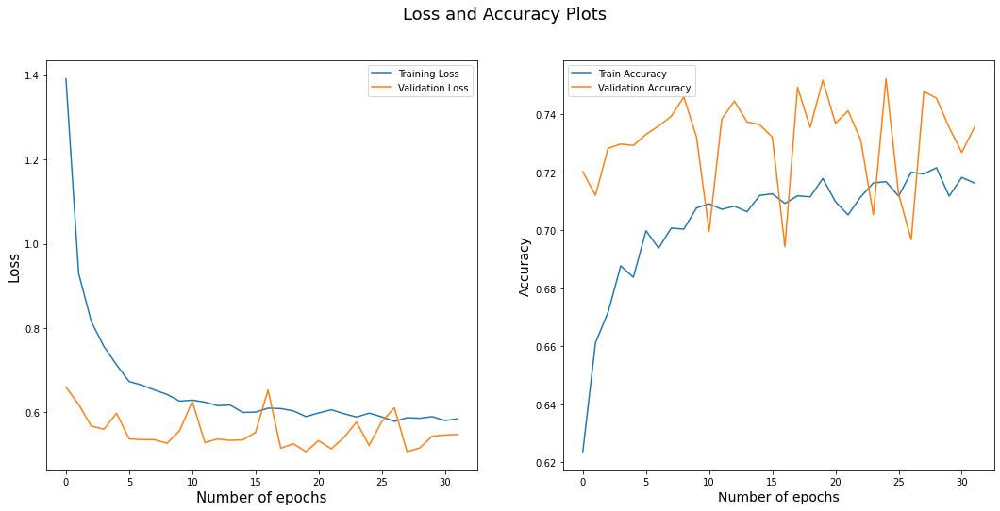

327/327 [==============================] - 13s 38ms/step
Round:  10
Test Accuracy:  0.763
Label Accuracy:  0.9791586998087954
Number of catagory 1:  5752.0
Number of catagory 2:  4708.0
Model: "sequential_48"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_48 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


262/262 [==============================] - 22s 57ms/step - loss: 1.4555 - acc: 0.6218 - val_loss: 0.6628 - val_acc: 0.7213
Epoch 2/32
262/262 [==============================] - 13s 49ms/step - loss: 0.9312 - acc: 0.6623 - val_loss: 0.7077 - val_acc: 0.6812
Epoch 3/32
262/262 [==============================] - 13s 49ms/step - loss: 0.7972 - acc: 0.6748 - val_loss: 0.5802 - val_acc: 0.7256
Epoch 4/32
262/262 [==============================] - 13s 48ms/step - loss: 0.7489 - acc: 0.6917 - val_loss: 0.5695 - val_acc: 0.7304
Epoch 5/32
262/262 [==============================] - 13s 49ms/step - loss: 0.7075 - acc: 0.6938 - val_loss: 0.5730 - val_acc: 0.7213
Epoch 6/32
262/262 [==============================] - 13s 49ms/step - loss: 0.6754 - acc: 0.6972 - val_loss: 0.5871 - val_acc: 0.7266
Epoch 7/32
262/262 [==============================] - 13s 49ms/step - loss: 0.6707 - acc: 0.6950 - val_loss: 0.5396 - val_acc: 0.7476
Epoch 8/32
262/262 [==============================] - 13s 49ms/step - los

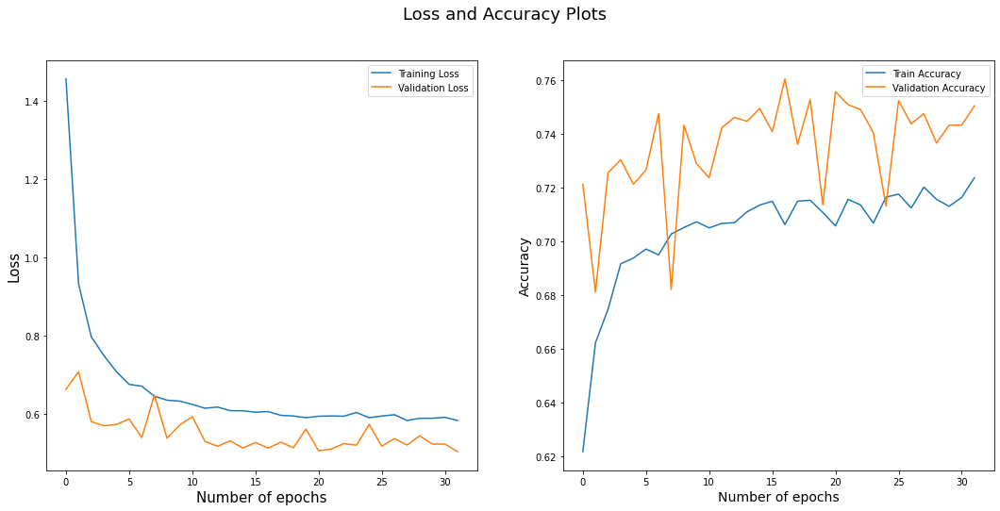

63/63 [==============================] - 5s 37ms/step
0.793


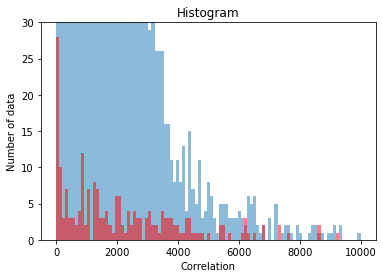

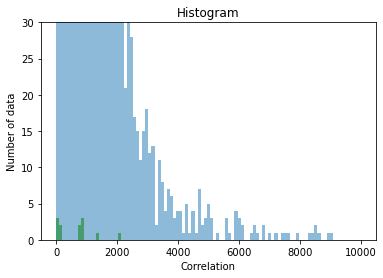

Model: "sequential_49"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_49 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


262/262 [==============================] - 23s 59ms/step - loss: 1.3926 - acc: 0.6247 - val_loss: 0.6859 - val_acc: 0.7118
Epoch 2/32
262/262 [==============================] - 13s 49ms/step - loss: 0.9321 - acc: 0.6618 - val_loss: 0.6157 - val_acc: 0.7247
Epoch 3/32
262/262 [==============================] - 13s 51ms/step - loss: 0.7883 - acc: 0.6795 - val_loss: 0.5728 - val_acc: 0.7299
Epoch 4/32
262/262 [==============================] - 13s 50ms/step - loss: 0.7414 - acc: 0.6809 - val_loss: 0.5646 - val_acc: 0.7323
Epoch 5/32
262/262 [==============================] - 13s 50ms/step - loss: 0.6939 - acc: 0.6927 - val_loss: 0.6082 - val_acc: 0.6965
Epoch 6/32
262/262 [==============================] - 13s 49ms/step - loss: 0.6778 - acc: 0.6987 - val_loss: 0.5562 - val_acc: 0.7318
Epoch 7/32
262/262 [==============================] - 13s 49ms/step - loss: 0.6666 - acc: 0.6929 - val_loss: 0.5444 - val_acc: 0.7395
Epoch 8/32
262/262 [==============================] - 13s 51ms/step - los

KeyboardInterrupt: 

In [7]:
#---Train---
from tensorflow.compat.v1.keras.applications import ResNet101

res = ResNet101(weights='imagenet', include_top = False, classes = 2, input_shape=(32,32,3))

Label_Accuracy = []
Test_Accuracy = []
Test_Accurracy_0 = []

Rounds = 64


for Round in range(Rounds):
    model = Sequential()
    
    model.add(res)
    # model.add(GlobalAveragePooling2D(name='penultimate'))
    model.add(Flatten(name='penultimate'))
    
    model.add(Dropout(0.5))
    model.add(Dense(2, activation = 'softmax', name='dense'))
    res.trainable = False
    model.summary()
    
    lr = 1e-4
    sgd = SGD(lr = lr, momentum = 0.9, nesterov = True)
    model.compile(loss = 'categorical_crossentropy', optimizer = sgd, metrics = ['acc'])
    
    hist = model.fit(x=X, y=y_shifted, batch_size=32, epochs=32, verbose=1, callbacks=None, validation_split=0.2, validation_data=None, shuffle=True, class_weight=None, sample_weight=None, initial_epoch=0, steps_per_epoch=None, validation_steps=None)
    
    
    
    plt.figure(figsize=(18,8))
    
    plt.suptitle('Loss and Accuracy Plots', fontsize=18)
    
    plt.subplot(1,2,1)
    plt.plot(hist.history['loss'], label='Training Loss')
    plt.plot(hist.history['val_loss'], label='Validation Loss')
    plt.legend()
    plt.xlabel('Number of epochs', fontsize=15)
    plt.ylabel('Loss', fontsize=15)
    
    plt.subplot(1,2,2)
    plt.plot(hist.history['acc'], label='Train Accuracy')
    plt.plot(hist.history['val_acc'], label='Validation Accuracy')
    plt.legend()
    plt.xlabel('Number of epochs', fontsize=14)
    plt.ylabel('Accuracy', fontsize=14)
    plt.show()
    
    
    y_pred = model.predict(X_test, verbose=1)
    y_pred = np.argmax(y_pred, axis = 1)
    print(accuracy_score(y_test, y_pred))
    Test_Accurracy_0.append(accuracy_score(y_test, y_pred))
    
    sub_model = tf.keras.Model(inputs = model.input, outputs = model.get_layer('penultimate').output)
    R = sub_model.predict(X)
    
    preserved_index = []
    relabel_index = []
    
    T_index = [-1 for i in range(len(R))]
    for catagory in [0, 1]:
        R_c = R[y_shifted[:,catagory] == 1]
        R_hat = np.average(R_c, axis=0)
        M = R_c.copy()
        for i in range(len(M)):
            M[i] -= R_hat
        u, s, vh = np.linalg.svd(M, full_matrices=True)
        v = vh[0]
        
        T = []
        T00 = []
        T01 = []
        T10 = []
        for i, r in enumerate(R):
            if y_shifted[i, catagory] == 1:
                T.append((np.dot((r-R_hat), v)**2))
                T_index[i] = len(T)-1
                
                if (y_shifted[i] == to_categorical(y, 2)[i]).all():
                    T00.append((np.dot((r-R_hat), v)**2))
                elif y_shifted[i][0] == 1:
                    T01.append((np.dot((r-R_hat), v)**2))
                elif y_shifted[i][0] == 0:
                    T10.append((np.dot((r-R_hat), v)**2))
        
        bins = np.linspace(0, 10000, 100)
        n, bins, patches=plt.hist(T00,alpha = 0.5,bins=bins)
        n, bins, patches=plt.hist(T01,bins=bins,alpha = 0.5,color='red')
        n, bins, patches=plt.hist(T10,bins=bins,alpha = 0.5,color='green')
        plt.ylim(0, 30)
        plt.xlabel("Correlation")
        plt.ylabel("Number of data")
        plt.title("Histogram")
        plt.show()
    
        S = sorted(range(len(T)), key=lambda k: T[k])
        # d = T[S[int(len(M) * (1 - 0.25 * (1 - (Round / Rounds))))]]
        d = T[S[int(len(M) * (1 - 0.25 * 0.5**Round))-1]]
        # rl = T[S[int(len(M) * (1 - 0.5**Round))]]
        # d = T[S[int(len(M) * (1 - 0.25))]]
        # rl = T[S[int(500*(1-0.1))]]
        for i, r in enumerate(R):
            if y_shifted[i, catagory] == 1 and T[T_index[i]] < d:
                preserved_index.append(i)
            # if y_shifted[i, catagory] == 1 and T[T_index[i]] >= rl:
            #     relabel_index.append(i)
                
    
    preserved_index.sort()
    relabel_index.sort()
    X_p = X[preserved_index]
    y_p = y_shifted.copy()
    y_p = y_p[preserved_index]
    
    
    
    model = Sequential()
    model.add(res)
    # model.add(GlobalAveragePooling2D(name='GAP'))
    model.add(Flatten(name='FC'))
    
    model.add(Dropout(0.5))
    model.add(Dense(2, activation = 'softmax', name='dense'))
    res.trainable = False
    model.summary()
    
    lr = 1e-4
    sgd = SGD(lr = lr, momentum = 0.9, nesterov = True)
    model.compile(loss = 'categorical_crossentropy', optimizer = sgd, metrics = ['acc'])
    
    hist = model.fit(x=X_p, y=y_p, batch_size=32, epochs=32, verbose=1, callbacks=None, validation_split=0.2, validation_data=None, shuffle=True, class_weight=None, sample_weight=None, initial_epoch=0, steps_per_epoch=None, validation_steps=None)
    
    plt.figure(figsize=(18,8))
    
    plt.suptitle('Loss and Accuracy Plots', fontsize=18)
    
    plt.subplot(1,2,1)
    plt.plot(hist.history['loss'], label='Training Loss')
    plt.plot(hist.history['val_loss'], label='Validation Loss')
    plt.legend()
    plt.xlabel('Number of epochs', fontsize=15)
    plt.ylabel('Loss', fontsize=15)
    
    plt.subplot(1,2,2)
    plt.plot(hist.history['acc'], label='Train Accuracy')
    plt.plot(hist.history['val_acc'], label='Validation Accuracy')
    plt.legend()
    plt.xlabel('Number of epochs', fontsize=14)
    plt.ylabel('Accuracy', fontsize=14)
    plt.show()
    
    y_pred = model.predict(X_test, verbose=1)
    y_pred = np.argmax(y_pred, axis = 1)
    
    y_new_pred = model.predict(X, verbose=1)
    y_new = np.argmax(y_new_pred, axis = 1)
    
    # for i in relabel_index:
    for i in range(len(X)):
        if max(y_new_pred[i]) > 0.99: 
            y_shifted[i] = to_categorical(y_new, 2)[i]
    
    print('Round: ', Round)
    print('Test Accuracy: ', accuracy_score(y_test, y_pred))
    print('Label Accuracy: ', accuracy_score(y, y_shifted[:,1]))
    print('Number of catagory 1: ', np.sum(y_shifted[:,0]))
    print('Number of catagory 2: ', np.sum(y_shifted[:,1]))
    Label_Accuracy.append(accuracy_score(y, y_shifted[:,1]))
    Test_Accuracy.append(accuracy_score(y_test, y_pred))

In [10]:
X_c = train_dataset.train_data
y_c = worst_label
X_test_c = test_dataset.test_data
y_test_c = test_dataset.test_labels

fine_label_list = ['airplane', 'automobile', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck']

def label_shiftting(y, p = 0.2):
    L0 = np.where(y == 0)[0]
    L1 = np.where(y == 1)[0]
    A0 = np.random.choice(500, size=int(500*p), replace=False)
    A1 = np.random.choice(500, size=int(500*p), replace=False)
    y[L0[A0]] = 1
    y[L1[A1]] = 0
    return y, L0[A0], L1[A1]
 
X = []
y = []
for i,x in enumerate(X_c):
    if fine_label_list[y_c[i]] == 'automobile':
        X.append(x)
        y.append(0)
    elif fine_label_list[y_c[i]] == 'truck':
        X.append(x)
        y.append(1)
        
X_test = []
y_test = []
for i,x in enumerate(X_test_c):
    if fine_label_list[y_test_c[i]] == 'automobile':
        X_test.append(x)
        y_test.append(0)
    elif fine_label_list[y_test_c[i]] == 'truck':
        X_test.append(x)
        y_test.append(1)

X = np.array(X)
y = np.array(y)
# y_shifted, L01, L10 = label_shiftting(y.copy(), p = 0.2)
y_shifted = to_categorical(y.copy(), 2)

X_test = np.array(X_test)
y_test = np.array(y_test)

Model: "sequential_50"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_50 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32
272/272 [==============================] - 21s 55ms/step - loss: 1.6150 - acc: 0.5320 - val_loss: 0.9656 - val_acc: 0.5513
Epoch 2/32
272/272 [===============

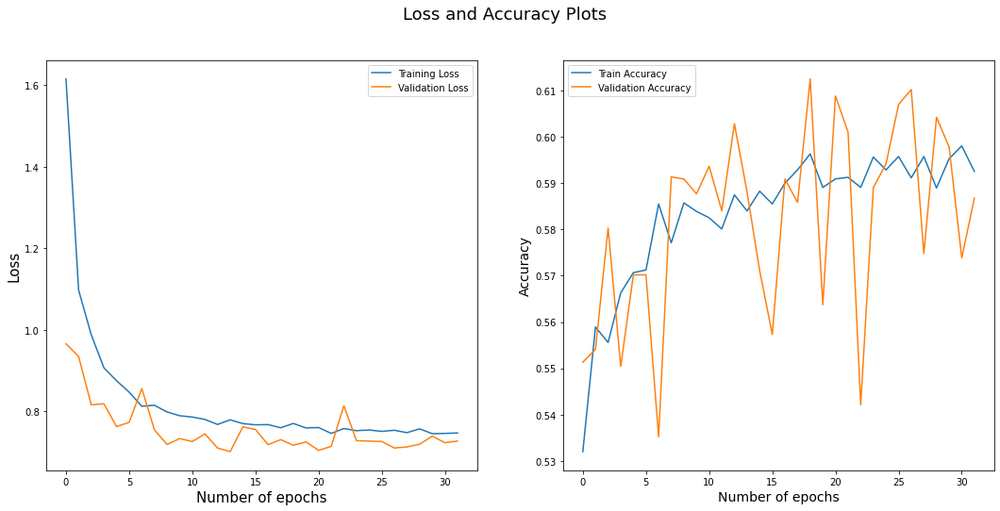

63/63 [==============================] - 8s 39ms/step
0.705


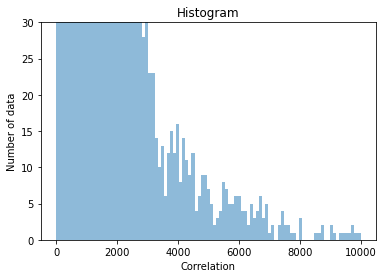

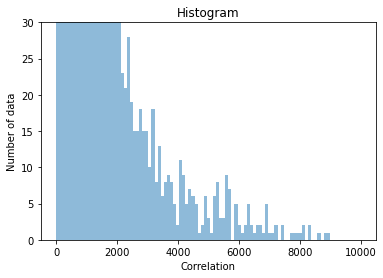

Model: "sequential_51"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_51 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


204/204 [==============================] - 19s 63ms/step - loss: 1.6952 - acc: 0.5452 - val_loss: 1.0000 - val_acc: 0.5777
Epoch 2/32
204/204 [==============================] - 11s 52ms/step - loss: 1.1835 - acc: 0.5601 - val_loss: 0.8727 - val_acc: 0.6010
Epoch 3/32
204/204 [==============================] - 11s 53ms/step - loss: 1.0265 - acc: 0.5751 - val_loss: 0.7981 - val_acc: 0.6120
Epoch 4/32
204/204 [==============================] - 11s 52ms/step - loss: 0.9548 - acc: 0.5734 - val_loss: 0.8072 - val_acc: 0.5887
Epoch 5/32
204/204 [==============================] - 10s 50ms/step - loss: 0.8809 - acc: 0.5920 - val_loss: 0.7990 - val_acc: 0.6176
Epoch 6/32
204/204 [==============================] - 10s 51ms/step - loss: 0.8656 - acc: 0.5791 - val_loss: 0.8366 - val_acc: 0.5850
Epoch 7/32
204/204 [==============================] - 10s 51ms/step - loss: 0.8250 - acc: 0.5928 - val_loss: 0.7570 - val_acc: 0.5942
Epoch 8/32
204/204 [==============================] - 10s 51ms/step - los

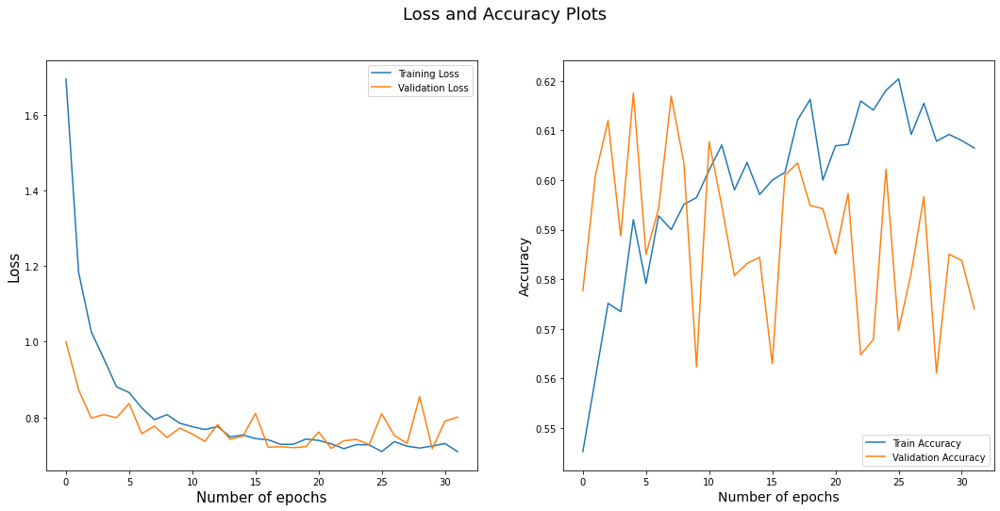

340/340 [==============================] - 13s 39ms/step
Round:  0
Test Accuracy:  0.615
Label Accuracy:  0.9821412132928289
Number of catagory 1:  6247.0
Number of catagory 2:  4616.0
Model: "sequential_52"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_52 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
__________________________________________________

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


272/272 [==============================] - 22s 57ms/step - loss: 1.6011 - acc: 0.5583 - val_loss: 0.9358 - val_acc: 0.6236
Epoch 2/32
272/272 [==============================] - 14s 50ms/step - loss: 1.0695 - acc: 0.5754 - val_loss: 0.8366 - val_acc: 0.5987
Epoch 3/32
272/272 [==============================] - 14s 50ms/step - loss: 0.9298 - acc: 0.5883 - val_loss: 0.9435 - val_acc: 0.5913
Epoch 4/32
272/272 [==============================] - 14s 50ms/step - loss: 0.8927 - acc: 0.5832 - val_loss: 0.8201 - val_acc: 0.5969
Epoch 5/32
272/272 [==============================] - 13s 49ms/step - loss: 0.8287 - acc: 0.5991 - val_loss: 0.7221 - val_acc: 0.6038
Epoch 6/32
272/272 [==============================] - 14s 50ms/step - loss: 0.7976 - acc: 0.5988 - val_loss: 0.7123 - val_acc: 0.5936
Epoch 7/32
272/272 [==============================] - 13s 49ms/step - loss: 0.7854 - acc: 0.5961 - val_loss: 0.6852 - val_acc: 0.6254
Epoch 8/32
272/272 [==============================] - 13s 49ms/step - los

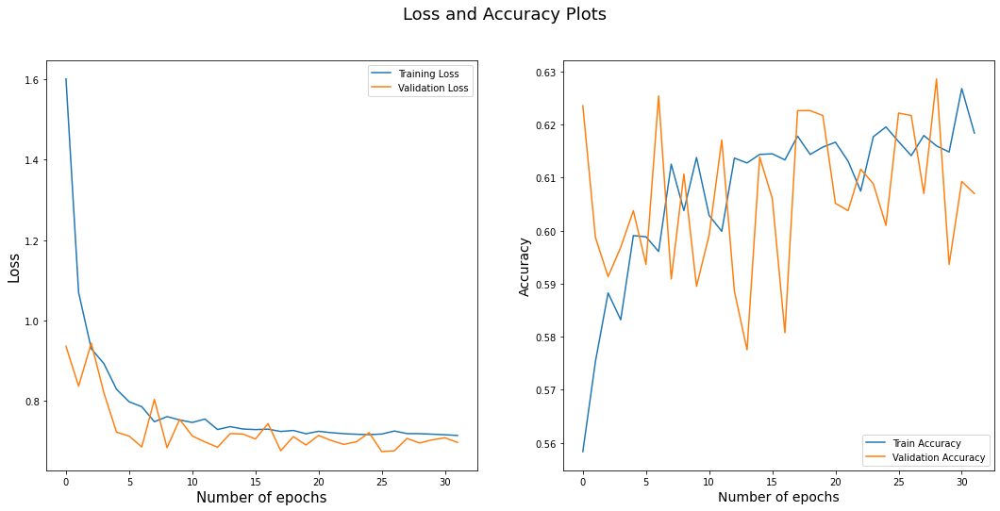

63/63 [==============================] - 4s 36ms/step
0.695


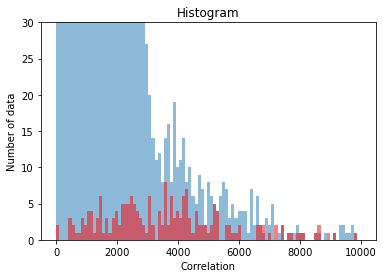

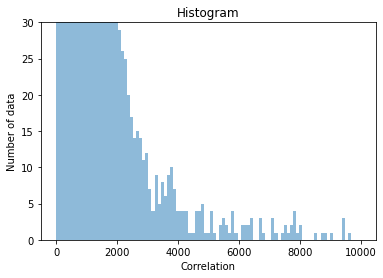

Model: "sequential_53"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_53 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


238/238 [==============================] - 20s 58ms/step - loss: 1.6154 - acc: 0.5535 - val_loss: 0.9168 - val_acc: 0.5697
Epoch 2/32
238/238 [==============================] - 12s 49ms/step - loss: 1.1117 - acc: 0.5730 - val_loss: 0.8420 - val_acc: 0.5855
Epoch 3/32
238/238 [==============================] - 12s 49ms/step - loss: 0.9687 - acc: 0.5812 - val_loss: 0.7636 - val_acc: 0.5992
Epoch 4/32
238/238 [==============================] - 12s 50ms/step - loss: 0.9108 - acc: 0.5821 - val_loss: 0.7513 - val_acc: 0.5944
Epoch 5/32
238/238 [==============================] - 12s 48ms/step - loss: 0.8493 - acc: 0.5883 - val_loss: 0.7394 - val_acc: 0.5823
Epoch 6/32
238/238 [==============================] - 11s 48ms/step - loss: 0.8070 - acc: 0.6047 - val_loss: 0.8071 - val_acc: 0.6034
Epoch 7/32
238/238 [==============================] - 12s 50ms/step - loss: 0.8018 - acc: 0.6018 - val_loss: 0.6960 - val_acc: 0.6128
Epoch 8/32
238/238 [==============================] - 12s 51ms/step - los

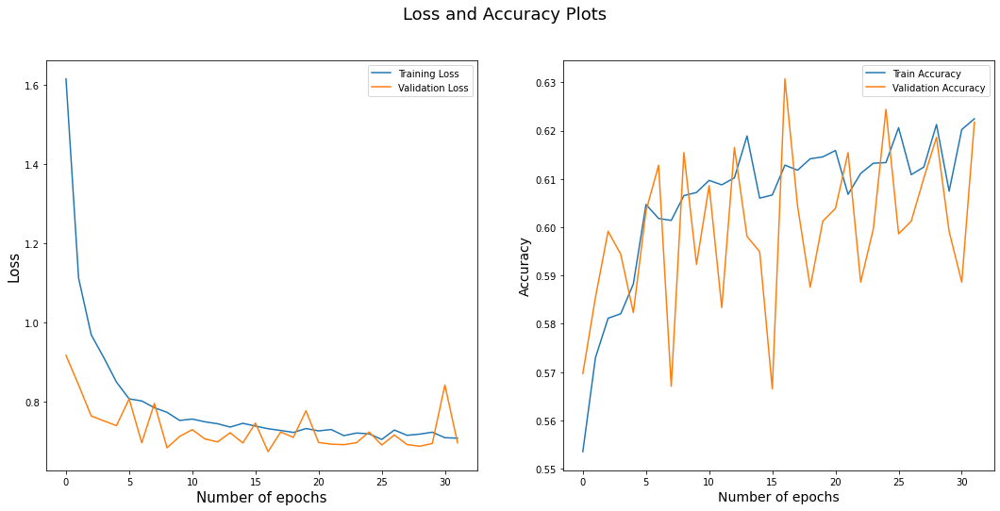

340/340 [==============================] - 13s 38ms/step
Round:  1
Test Accuracy:  0.7385
Label Accuracy:  0.9811286016754119
Number of catagory 1:  6252.0
Number of catagory 2:  4611.0
Model: "sequential_54"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_54 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


272/272 [==============================] - 22s 59ms/step - loss: 1.6024 - acc: 0.5623 - val_loss: 0.8808 - val_acc: 0.5927
Epoch 2/32
272/272 [==============================] - 14s 53ms/step - loss: 1.0748 - acc: 0.5814 - val_loss: 0.8634 - val_acc: 0.6001
Epoch 3/32
272/272 [==============================] - 14s 53ms/step - loss: 0.9535 - acc: 0.5802 - val_loss: 0.7746 - val_acc: 0.6079
Epoch 4/32
272/272 [==============================] - 15s 54ms/step - loss: 0.8792 - acc: 0.5934 - val_loss: 0.7717 - val_acc: 0.6052
Epoch 5/32
272/272 [==============================] - 15s 54ms/step - loss: 0.8268 - acc: 0.5961 - val_loss: 0.8239 - val_acc: 0.6208
Epoch 6/32
272/272 [==============================] - 14s 53ms/step - loss: 0.8063 - acc: 0.6043 - val_loss: 0.7158 - val_acc: 0.6208
Epoch 7/32
272/272 [==============================] - 14s 51ms/step - loss: 0.8071 - acc: 0.5901 - val_loss: 0.7446 - val_acc: 0.6107
Epoch 8/32
272/272 [==============================] - 14s 51ms/step - los

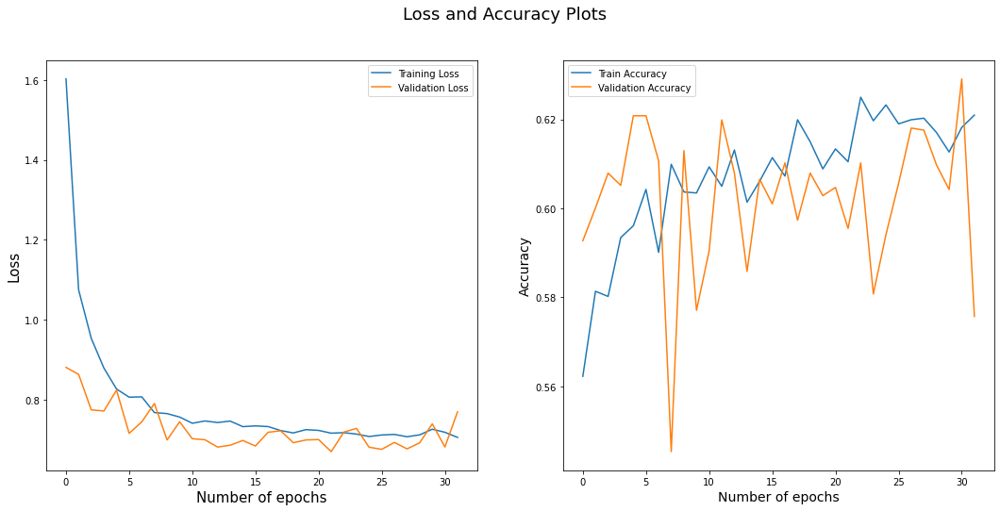

63/63 [==============================] - 5s 38ms/step
0.562


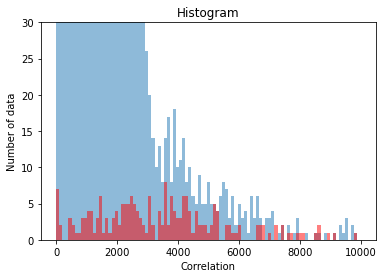

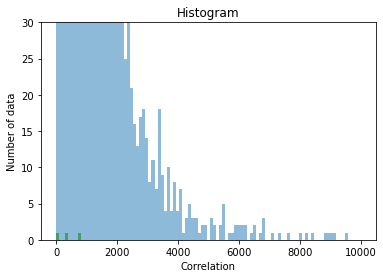

Model: "sequential_55"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_55 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


255/255 [==============================] - 20s 58ms/step - loss: 1.6657 - acc: 0.5533 - val_loss: 0.8951 - val_acc: 0.5857
Epoch 2/32
255/255 [==============================] - 13s 50ms/step - loss: 1.1207 - acc: 0.5680 - val_loss: 0.8685 - val_acc: 0.6004
Epoch 3/32
255/255 [==============================] - 13s 50ms/step - loss: 0.9827 - acc: 0.5814 - val_loss: 0.8592 - val_acc: 0.5862
Epoch 4/32
255/255 [==============================] - 12s 49ms/step - loss: 0.8833 - acc: 0.5932 - val_loss: 0.7552 - val_acc: 0.5881
Epoch 5/32
255/255 [==============================] - 13s 49ms/step - loss: 0.8557 - acc: 0.5846 - val_loss: 0.7963 - val_acc: 0.6087
Epoch 6/32
255/255 [==============================] - 12s 49ms/step - loss: 0.8231 - acc: 0.5955 - val_loss: 0.8593 - val_acc: 0.5940
Epoch 7/32
255/255 [==============================] - 13s 50ms/step - loss: 0.8039 - acc: 0.5955 - val_loss: 0.7435 - val_acc: 0.6097
Epoch 8/32
255/255 [==============================] - 13s 51ms/step - los

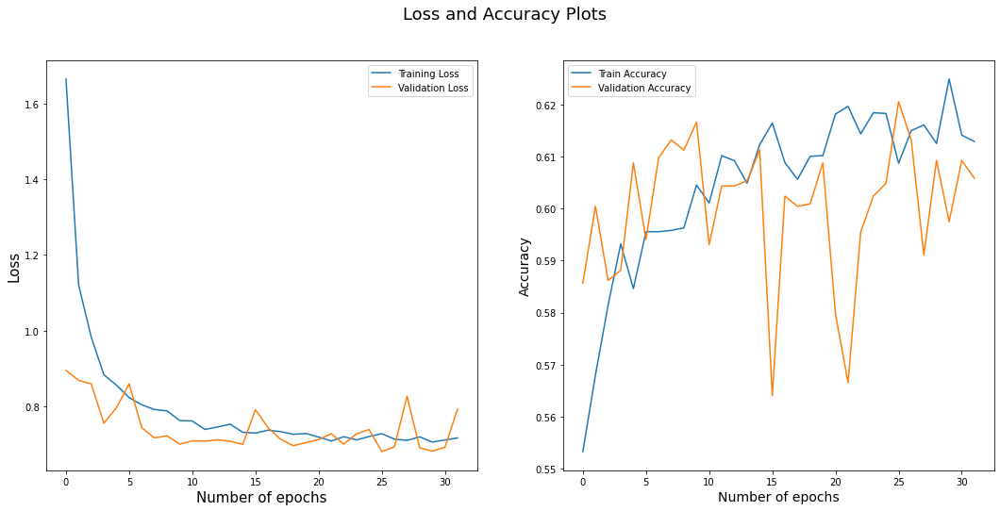

340/340 [==============================] - 13s 39ms/step
Round:  2
Test Accuracy:  0.587
Label Accuracy:  0.9787351560342447
Number of catagory 1:  6278.0
Number of catagory 2:  4585.0
Model: "sequential_56"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_56 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
__________________________________________________

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


272/272 [==============================] - 20s 57ms/step - loss: 1.6462 - acc: 0.5476 - val_loss: 1.0538 - val_acc: 0.5927
Epoch 2/32
272/272 [==============================] - 14s 53ms/step - loss: 1.0848 - acc: 0.5723 - val_loss: 0.7780 - val_acc: 0.6102
Epoch 3/32
272/272 [==============================] - 13s 50ms/step - loss: 0.9451 - acc: 0.5764 - val_loss: 0.7605 - val_acc: 0.6190
Epoch 4/32
272/272 [==============================] - 14s 50ms/step - loss: 0.8675 - acc: 0.5903 - val_loss: 0.7478 - val_acc: 0.6203
Epoch 5/32
272/272 [==============================] - 14s 51ms/step - loss: 0.8169 - acc: 0.6003 - val_loss: 0.7082 - val_acc: 0.6249
Epoch 6/32
272/272 [==============================] - 14s 51ms/step - loss: 0.8040 - acc: 0.5999 - val_loss: 0.6874 - val_acc: 0.6291
Epoch 7/32
272/272 [==============================] - 14s 50ms/step - loss: 0.7906 - acc: 0.6049 - val_loss: 0.7000 - val_acc: 0.6116
Epoch 8/32
272/272 [==============================] - 13s 50ms/step - los

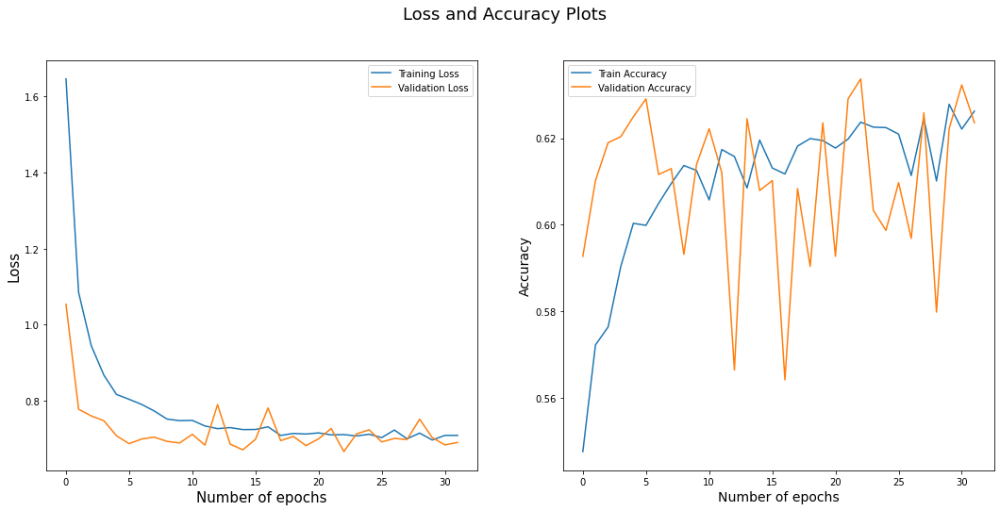

63/63 [==============================] - 5s 39ms/step
0.7165


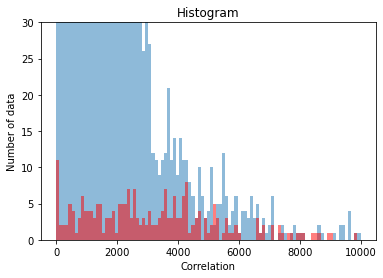

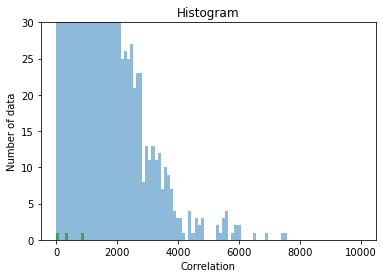

Model: "sequential_57"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_57 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


263/263 [==============================] - 20s 57ms/step - loss: 1.5584 - acc: 0.5591 - val_loss: 1.1028 - val_acc: 0.5822
Epoch 2/32
263/263 [==============================] - 13s 48ms/step - loss: 1.0863 - acc: 0.5688 - val_loss: 0.7979 - val_acc: 0.5827
Epoch 3/32
263/263 [==============================] - 13s 48ms/step - loss: 0.9322 - acc: 0.5879 - val_loss: 0.7597 - val_acc: 0.6055
Epoch 4/32
263/263 [==============================] - 12s 47ms/step - loss: 0.8599 - acc: 0.5902 - val_loss: 0.7729 - val_acc: 0.5917
Epoch 5/32
263/263 [==============================] - 13s 48ms/step - loss: 0.8230 - acc: 0.5951 - val_loss: 0.7468 - val_acc: 0.6041
Epoch 6/32
263/263 [==============================] - 12s 48ms/step - loss: 0.8054 - acc: 0.5989 - val_loss: 0.7367 - val_acc: 0.6117
Epoch 7/32
263/263 [==============================] - 13s 49ms/step - loss: 0.7830 - acc: 0.6040 - val_loss: 0.7327 - val_acc: 0.6017
Epoch 8/32
263/263 [==============================] - 13s 48ms/step - los

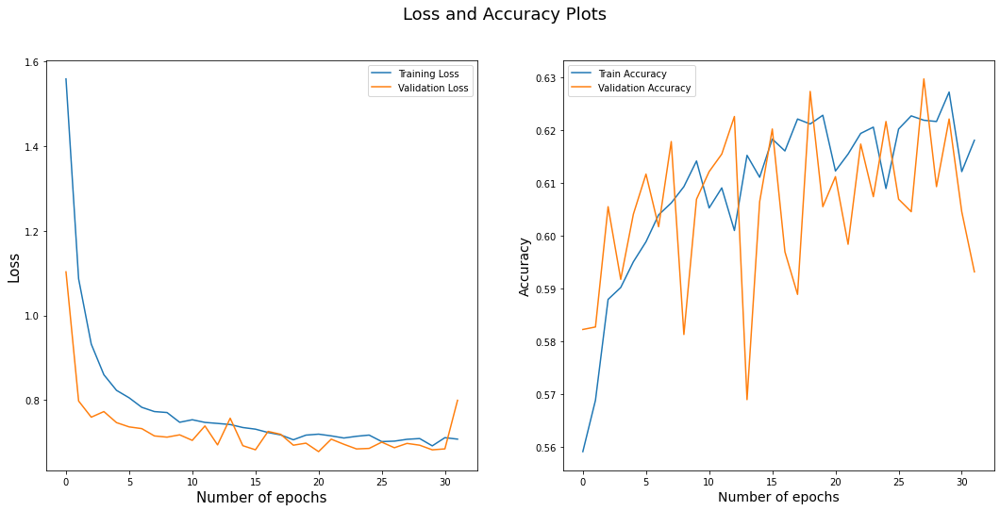

340/340 [==============================] - 13s 40ms/step
Round:  3
Test Accuracy:  0.578
Label Accuracy:  0.9784589892294946
Number of catagory 1:  6281.0
Number of catagory 2:  4582.0
Model: "sequential_58"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_58 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
__________________________________________________

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


272/272 [==============================] - 22s 58ms/step - loss: 1.6134 - acc: 0.5568 - val_loss: 0.9154 - val_acc: 0.5886
Epoch 2/32
272/272 [==============================] - 14s 50ms/step - loss: 1.1168 - acc: 0.5713 - val_loss: 0.8232 - val_acc: 0.6029
Epoch 3/32
272/272 [==============================] - 14s 51ms/step - loss: 0.9518 - acc: 0.5873 - val_loss: 0.7478 - val_acc: 0.5877
Epoch 4/32
272/272 [==============================] - 14s 51ms/step - loss: 0.8715 - acc: 0.5921 - val_loss: 0.7131 - val_acc: 0.6029
Epoch 5/32
272/272 [==============================] - 14s 51ms/step - loss: 0.8252 - acc: 0.5965 - val_loss: 0.7033 - val_acc: 0.6263
Epoch 6/32
272/272 [==============================] - 14s 51ms/step - loss: 0.7951 - acc: 0.6013 - val_loss: 0.6907 - val_acc: 0.6148
Epoch 7/32
272/272 [==============================] - 13s 50ms/step - loss: 0.7803 - acc: 0.6052 - val_loss: 0.7203 - val_acc: 0.6263
Epoch 8/32
272/272 [==============================] - 13s 47ms/step - los

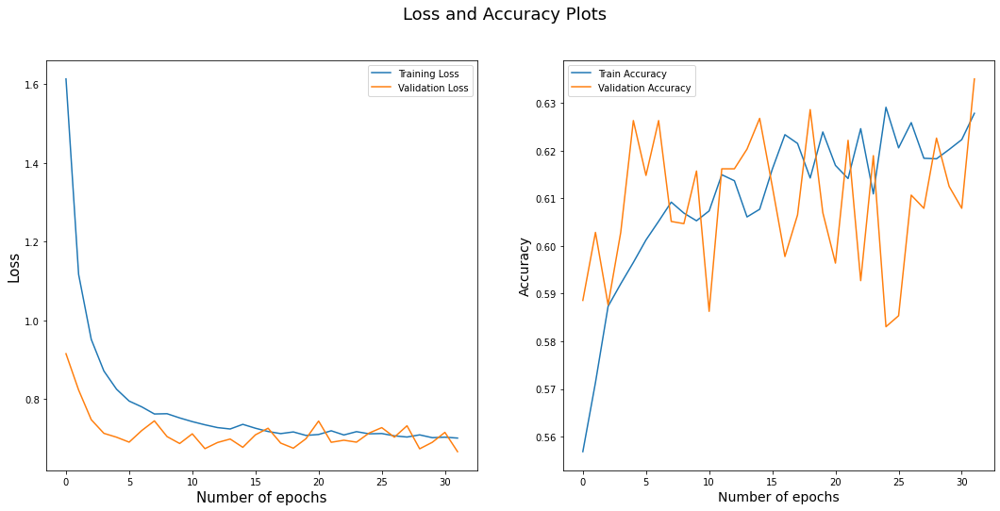

63/63 [==============================] - 5s 39ms/step
0.738


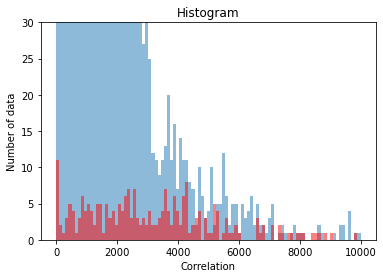

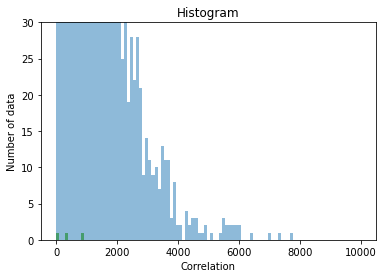

Model: "sequential_59"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_59 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


268/268 [==============================] - 22s 56ms/step - loss: 1.5573 - acc: 0.5547 - val_loss: 0.8986 - val_acc: 0.5790
Epoch 2/32
268/268 [==============================] - 13s 50ms/step - loss: 1.0458 - acc: 0.5842 - val_loss: 0.8405 - val_acc: 0.5926
Epoch 3/32
268/268 [==============================] - 13s 48ms/step - loss: 0.9180 - acc: 0.5838 - val_loss: 0.8096 - val_acc: 0.6085
Epoch 4/32
268/268 [==============================] - 13s 49ms/step - loss: 0.8688 - acc: 0.5926 - val_loss: 0.7484 - val_acc: 0.6034
Epoch 5/32
268/268 [==============================] - 13s 47ms/step - loss: 0.8337 - acc: 0.5951 - val_loss: 0.8476 - val_acc: 0.5926
Epoch 6/32
268/268 [==============================] - 13s 49ms/step - loss: 0.7985 - acc: 0.6051 - val_loss: 0.7047 - val_acc: 0.6052
Epoch 7/32
268/268 [==============================] - 13s 50ms/step - loss: 0.7747 - acc: 0.6052 - val_loss: 0.8479 - val_acc: 0.5982
Epoch 8/32
268/268 [==============================] - 13s 49ms/step - los

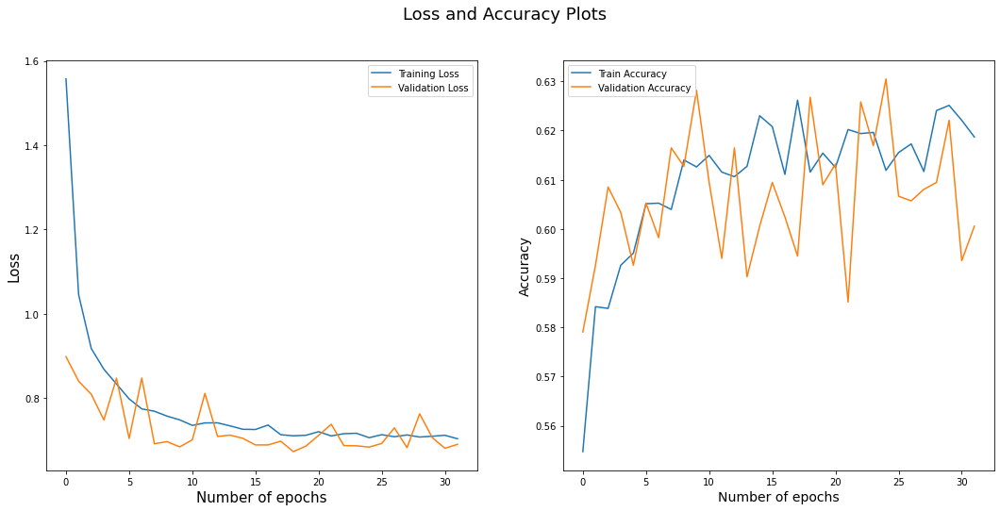

340/340 [==============================] - 13s 38ms/step
Round:  4
Test Accuracy:  0.6335
Label Accuracy:  0.978274878026328
Number of catagory 1:  6283.0
Number of catagory 2:  4580.0
Model: "sequential_60"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_60 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
__________________________________________________

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


272/272 [==============================] - 20s 56ms/step - loss: 1.5965 - acc: 0.5603 - val_loss: 0.8476 - val_acc: 0.5895
Epoch 2/32
272/272 [==============================] - 13s 49ms/step - loss: 1.0942 - acc: 0.5784 - val_loss: 0.7684 - val_acc: 0.6070
Epoch 3/32
272/272 [==============================] - 13s 49ms/step - loss: 0.9330 - acc: 0.5849 - val_loss: 0.7467 - val_acc: 0.6153
Epoch 4/32
272/272 [==============================] - 13s 48ms/step - loss: 0.8686 - acc: 0.5965 - val_loss: 0.7410 - val_acc: 0.5831
Epoch 5/32
272/272 [==============================] - 13s 48ms/step - loss: 0.8220 - acc: 0.6035 - val_loss: 0.7830 - val_acc: 0.6084
Epoch 6/32
272/272 [==============================] - 13s 47ms/step - loss: 0.8161 - acc: 0.5960 - val_loss: 0.6945 - val_acc: 0.6116
Epoch 7/32
272/272 [==============================] - 13s 48ms/step - loss: 0.7711 - acc: 0.6099 - val_loss: 0.6910 - val_acc: 0.6190
Epoch 8/32
272/272 [==============================] - 14s 50ms/step - los

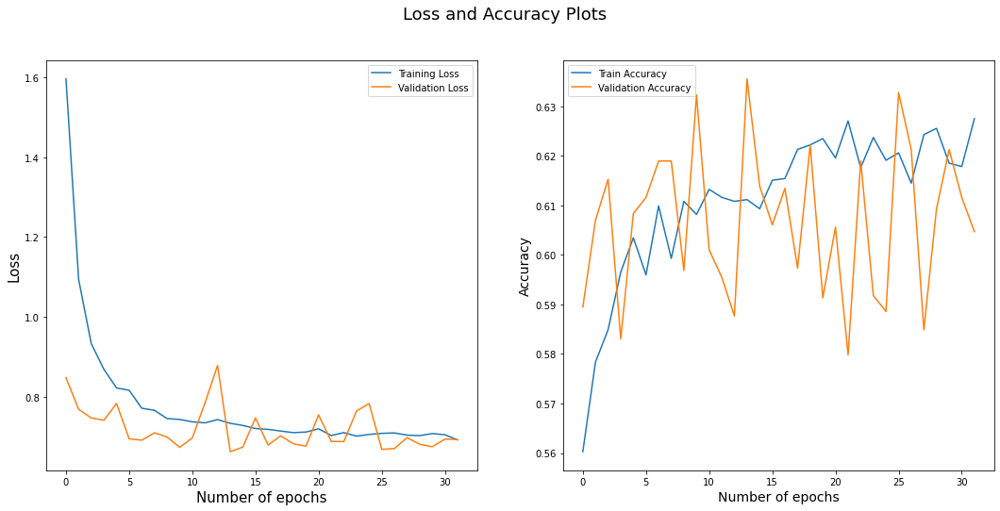

63/63 [==============================] - 5s 36ms/step
0.698


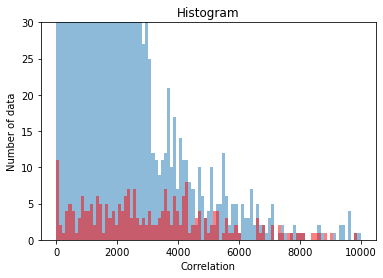

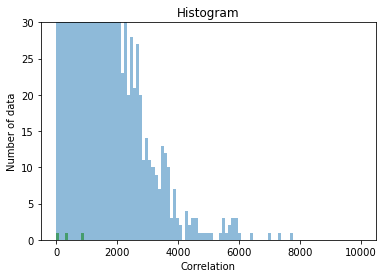

Model: "sequential_61"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_61 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


270/270 [==============================] - 21s 56ms/step - loss: 1.5672 - acc: 0.5588 - val_loss: 0.8984 - val_acc: 0.5759
Epoch 2/32
270/270 [==============================] - 13s 50ms/step - loss: 1.0773 - acc: 0.5716 - val_loss: 0.8113 - val_acc: 0.5930
Epoch 3/32
270/270 [==============================] - 13s 49ms/step - loss: 0.9223 - acc: 0.5865 - val_loss: 0.7769 - val_acc: 0.5944
Epoch 4/32
270/270 [==============================] - 13s 49ms/step - loss: 0.8485 - acc: 0.6019 - val_loss: 0.7687 - val_acc: 0.5754
Epoch 5/32
270/270 [==============================] - 13s 49ms/step - loss: 0.8267 - acc: 0.5961 - val_loss: 0.7135 - val_acc: 0.6065
Epoch 6/32
270/270 [==============================] - 13s 49ms/step - loss: 0.7983 - acc: 0.5992 - val_loss: 0.7119 - val_acc: 0.6274
Epoch 7/32
270/270 [==============================] - 13s 49ms/step - loss: 0.7814 - acc: 0.6125 - val_loss: 0.7448 - val_acc: 0.6121
Epoch 8/32
270/270 [==============================] - 13s 48ms/step - los

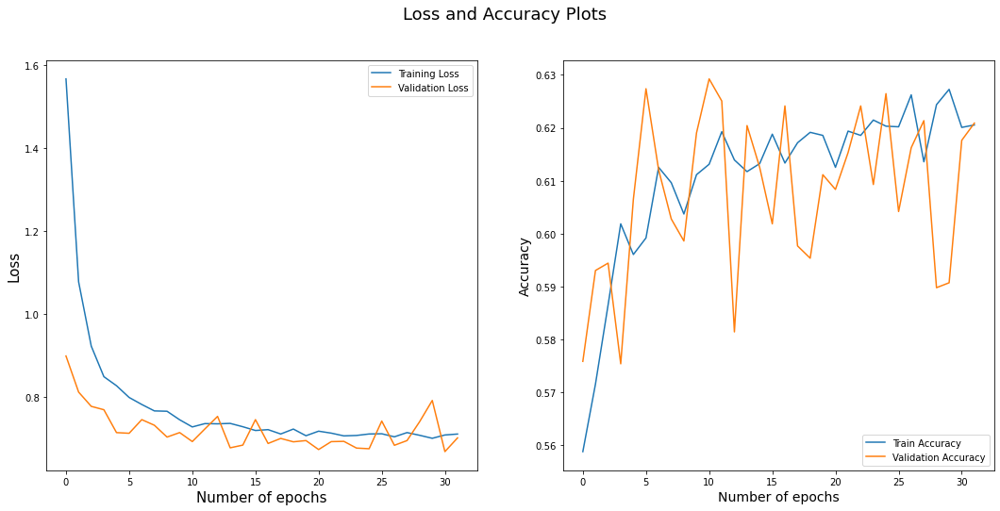

340/340 [==============================] - 13s 38ms/step
Round:  5
Test Accuracy:  0.672
Label Accuracy:  0.9781828224247445
Number of catagory 1:  6284.0
Number of catagory 2:  4579.0
Model: "sequential_62"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_62 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
__________________________________________________

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


272/272 [==============================] - 21s 60ms/step - loss: 1.5185 - acc: 0.5664 - val_loss: 0.9074 - val_acc: 0.5858
Epoch 2/32
272/272 [==============================] - 14s 51ms/step - loss: 1.0570 - acc: 0.5871 - val_loss: 0.8581 - val_acc: 0.6075
Epoch 3/32
272/272 [==============================] - 13s 49ms/step - loss: 0.9286 - acc: 0.5878 - val_loss: 0.7347 - val_acc: 0.6024
Epoch 4/32
272/272 [==============================] - 13s 49ms/step - loss: 0.8458 - acc: 0.5967 - val_loss: 0.8198 - val_acc: 0.5762
Epoch 5/32
272/272 [==============================] - 13s 49ms/step - loss: 0.8291 - acc: 0.5940 - val_loss: 0.7079 - val_acc: 0.6259
Epoch 6/32
272/272 [==============================] - 14s 51ms/step - loss: 0.7915 - acc: 0.6054 - val_loss: 0.6931 - val_acc: 0.6323
Epoch 7/32
272/272 [==============================] - 14s 50ms/step - loss: 0.7779 - acc: 0.6046 - val_loss: 0.7006 - val_acc: 0.6259
Epoch 8/32
272/272 [==============================] - 13s 49ms/step - los

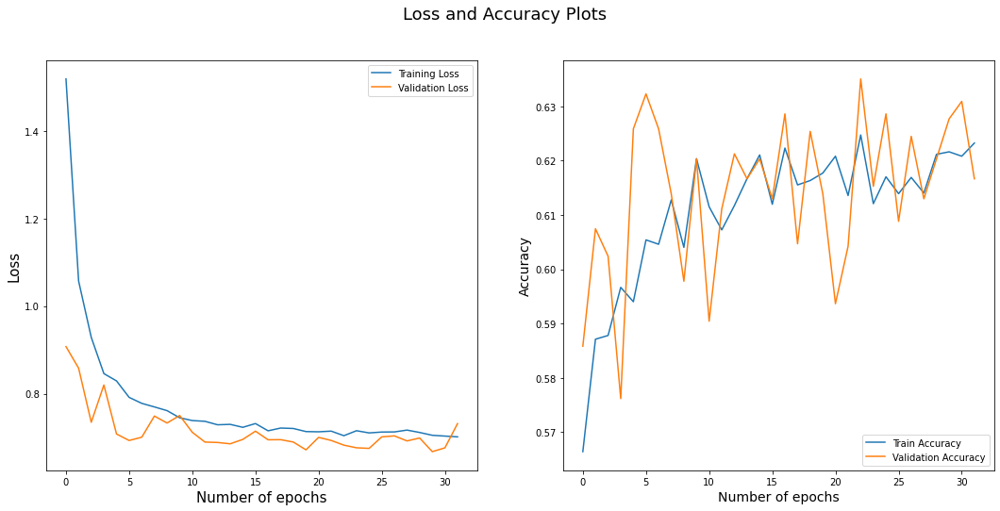

63/63 [==============================] - 5s 41ms/step
0.6835


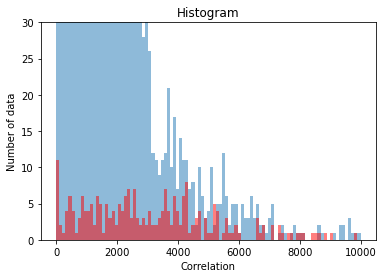

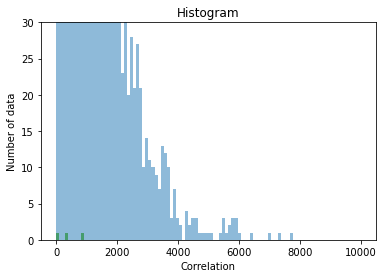

Model: "sequential_63"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_63 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


271/271 [==============================] - 23s 61ms/step - loss: 1.5673 - acc: 0.5575 - val_loss: 0.9016 - val_acc: 0.6044
Epoch 2/32
271/271 [==============================] - 14s 51ms/step - loss: 1.0972 - acc: 0.5731 - val_loss: 0.8967 - val_acc: 0.6128
Epoch 3/32
271/271 [==============================] - 14s 51ms/step - loss: 0.9347 - acc: 0.5852 - val_loss: 0.7833 - val_acc: 0.5920
Epoch 4/32
271/271 [==============================] - 13s 49ms/step - loss: 0.8604 - acc: 0.5920 - val_loss: 0.7479 - val_acc: 0.5809
Epoch 5/32
271/271 [==============================] - 13s 49ms/step - loss: 0.8119 - acc: 0.6034 - val_loss: 0.7243 - val_acc: 0.5961
Epoch 6/32
271/271 [==============================] - 14s 51ms/step - loss: 0.7950 - acc: 0.6024 - val_loss: 0.7073 - val_acc: 0.6128
Epoch 7/32
271/271 [==============================] - 13s 50ms/step - loss: 0.7821 - acc: 0.6058 - val_loss: 0.7000 - val_acc: 0.5998
Epoch 8/32
271/271 [==============================] - 13s 50ms/step - los

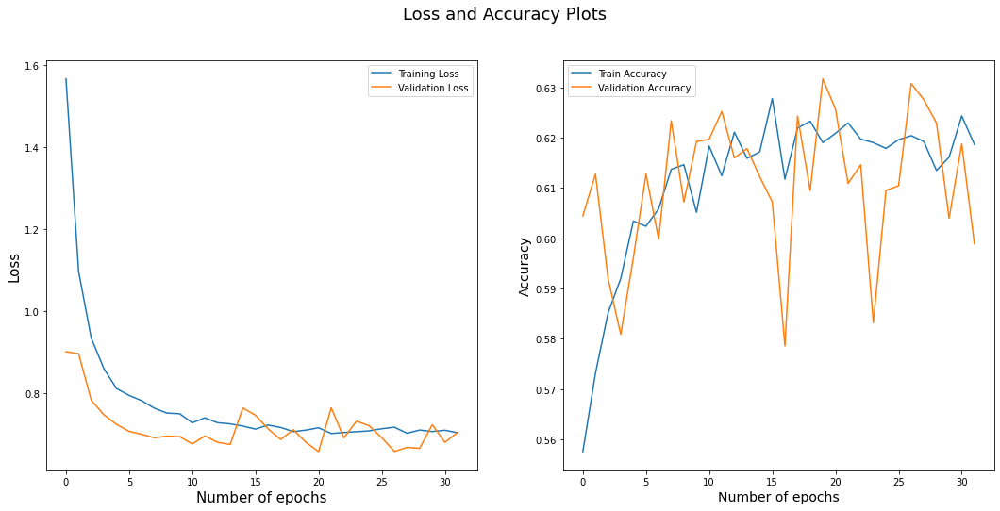

340/340 [==============================] - 13s 39ms/step
Round:  6
Test Accuracy:  0.5975
Label Accuracy:  0.9781828224247445
Number of catagory 1:  6284.0
Number of catagory 2:  4579.0
Model: "sequential_64"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_64 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


272/272 [==============================] - 22s 57ms/step - loss: 1.6136 - acc: 0.5686 - val_loss: 0.9444 - val_acc: 0.5941
Epoch 2/32
272/272 [==============================] - 14s 52ms/step - loss: 1.1139 - acc: 0.5812 - val_loss: 0.7901 - val_acc: 0.6029
Epoch 3/32
272/272 [==============================] - 14s 52ms/step - loss: 0.9153 - acc: 0.5946 - val_loss: 0.7317 - val_acc: 0.5923
Epoch 4/32
272/272 [==============================] - 14s 51ms/step - loss: 0.8687 - acc: 0.5961 - val_loss: 0.7492 - val_acc: 0.5992
Epoch 5/32
272/272 [==============================] - 14s 52ms/step - loss: 0.8301 - acc: 0.5970 - val_loss: 0.7496 - val_acc: 0.6176
Epoch 6/32
272/272 [==============================] - 14s 51ms/step - loss: 0.7832 - acc: 0.6040 - val_loss: 0.7159 - val_acc: 0.6139
Epoch 7/32
272/272 [==============================] - 14s 50ms/step - loss: 0.7892 - acc: 0.5984 - val_loss: 0.7938 - val_acc: 0.5674
Epoch 8/32
272/272 [==============================] - 14s 50ms/step - los

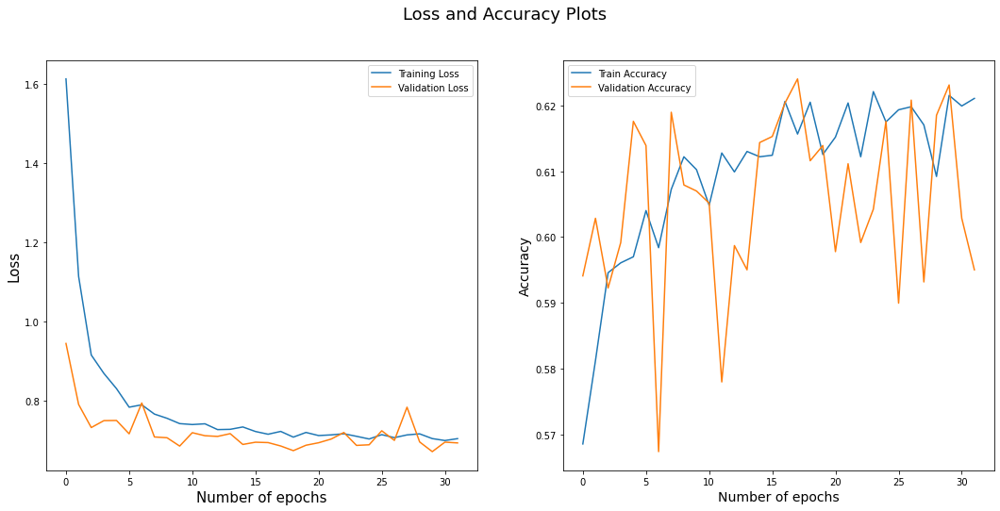

63/63 [==============================] - 5s 38ms/step
0.7095


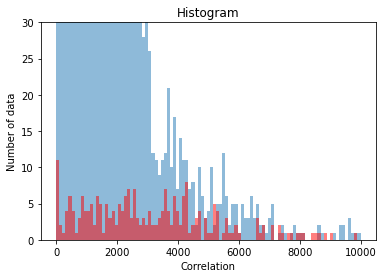

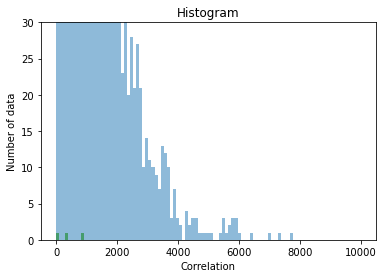

Model: "sequential_65"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_65 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


271/271 [==============================] - 23s 60ms/step - loss: 1.5093 - acc: 0.5713 - val_loss: 0.9013 - val_acc: 0.5923
Epoch 2/32
271/271 [==============================] - 14s 52ms/step - loss: 1.0985 - acc: 0.5774 - val_loss: 0.9235 - val_acc: 0.5687
Epoch 3/32
271/271 [==============================] - 14s 52ms/step - loss: 0.9450 - acc: 0.5814 - val_loss: 0.8340 - val_acc: 0.6019
Epoch 4/32
271/271 [==============================] - 14s 51ms/step - loss: 0.8578 - acc: 0.5947 - val_loss: 0.7548 - val_acc: 0.6204
Epoch 5/32
271/271 [==============================] - 14s 51ms/step - loss: 0.8231 - acc: 0.5996 - val_loss: 0.7235 - val_acc: 0.6310
Epoch 6/32
271/271 [==============================] - 14s 52ms/step - loss: 0.8001 - acc: 0.6045 - val_loss: 0.7429 - val_acc: 0.5876
Epoch 7/32
271/271 [==============================] - 14s 52ms/step - loss: 0.7902 - acc: 0.6010 - val_loss: 0.7291 - val_acc: 0.6273
Epoch 8/32
271/271 [==============================] - 14s 51ms/step - los

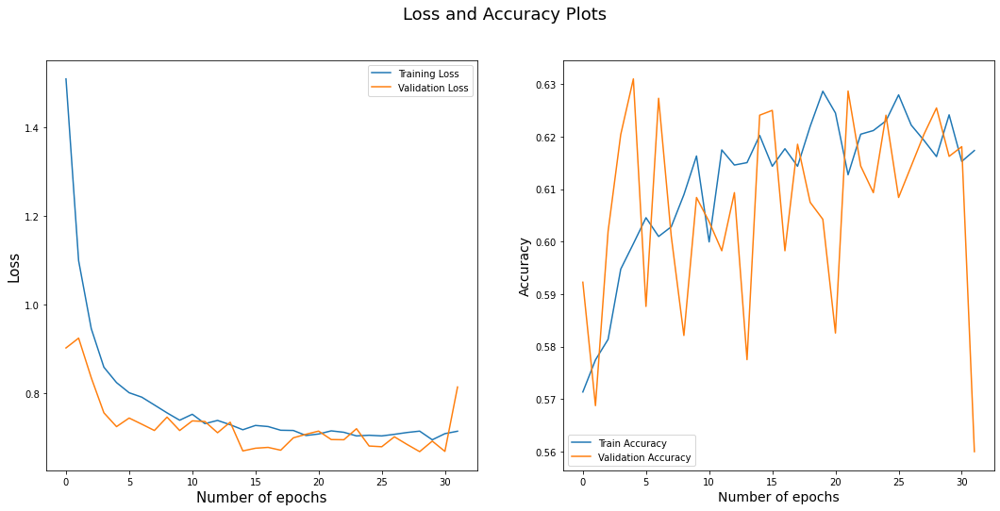

340/340 [==============================] - 13s 38ms/step
Round:  7
Test Accuracy:  0.657
Label Accuracy:  0.9776304888152444
Number of catagory 1:  6278.0
Number of catagory 2:  4585.0
Model: "sequential_66"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_66 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
__________________________________________________

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


272/272 [==============================] - 22s 58ms/step - loss: 1.5546 - acc: 0.5547 - val_loss: 0.8423 - val_acc: 0.6199
Epoch 2/32
272/272 [==============================] - 14s 50ms/step - loss: 1.0617 - acc: 0.5833 - val_loss: 0.7778 - val_acc: 0.6006
Epoch 3/32
272/272 [==============================] - 14s 52ms/step - loss: 0.9304 - acc: 0.5856 - val_loss: 0.7550 - val_acc: 0.6130
Epoch 4/32
272/272 [==============================] - 14s 50ms/step - loss: 0.8712 - acc: 0.5913 - val_loss: 0.7363 - val_acc: 0.6180
Epoch 5/32
272/272 [==============================] - 14s 51ms/step - loss: 0.8397 - acc: 0.5941 - val_loss: 0.7053 - val_acc: 0.6226
Epoch 6/32
272/272 [==============================] - 14s 51ms/step - loss: 0.8015 - acc: 0.5965 - val_loss: 0.6837 - val_acc: 0.6309
Epoch 7/32
272/272 [==============================] - 14s 53ms/step - loss: 0.7748 - acc: 0.6092 - val_loss: 0.7050 - val_acc: 0.6042
Epoch 8/32
272/272 [==============================] - 14s 51ms/step - los

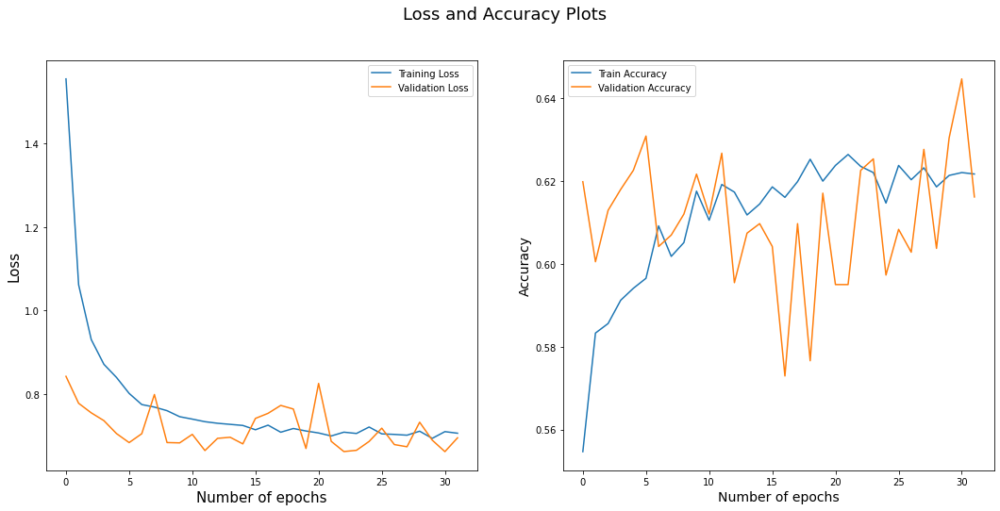

63/63 [==============================] - 5s 40ms/step
0.716


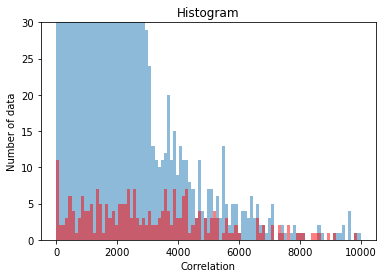

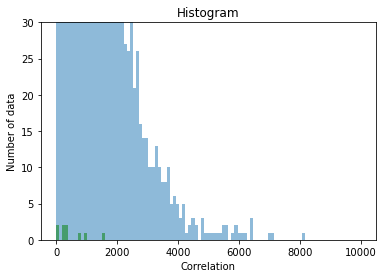

Model: "sequential_67"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_67 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


272/272 [==============================] - 21s 58ms/step - loss: 1.6002 - acc: 0.5644 - val_loss: 0.9746 - val_acc: 0.5940
Epoch 2/32
272/272 [==============================] - 13s 50ms/step - loss: 1.1008 - acc: 0.5831 - val_loss: 0.8618 - val_acc: 0.5871
Epoch 3/32
272/272 [==============================] - 13s 50ms/step - loss: 0.9539 - acc: 0.5926 - val_loss: 0.7493 - val_acc: 0.6134
Epoch 4/32
272/272 [==============================] - 14s 51ms/step - loss: 0.8769 - acc: 0.6048 - val_loss: 0.7336 - val_acc: 0.6161
Epoch 5/32
272/272 [==============================] - 14s 50ms/step - loss: 0.8279 - acc: 0.5971 - val_loss: 0.7381 - val_acc: 0.6060
Epoch 6/32
272/272 [==============================] - 14s 51ms/step - loss: 0.7999 - acc: 0.6078 - val_loss: 0.7334 - val_acc: 0.6207
Epoch 7/32
272/272 [==============================] - 14s 50ms/step - loss: 0.7854 - acc: 0.6010 - val_loss: 0.7731 - val_acc: 0.6171
Epoch 8/32
272/272 [==============================] - 14s 50ms/step - los

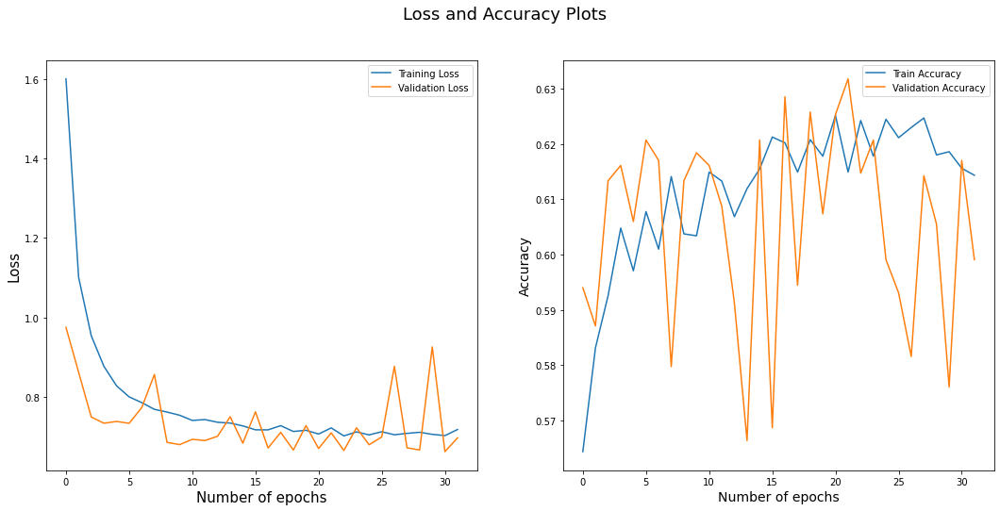

340/340 [==============================] - 14s 40ms/step
Round:  8
Test Accuracy:  0.6215
Label Accuracy:  0.9774463776120776
Number of catagory 1:  6280.0
Number of catagory 2:  4583.0
Model: "sequential_68"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_68 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


272/272 [==============================] - 21s 59ms/step - loss: 1.5720 - acc: 0.5662 - val_loss: 1.0187 - val_acc: 0.5973
Epoch 2/32
272/272 [==============================] - 13s 49ms/step - loss: 1.0666 - acc: 0.5774 - val_loss: 0.7719 - val_acc: 0.6093
Epoch 3/32
272/272 [==============================] - 13s 49ms/step - loss: 0.9332 - acc: 0.5900 - val_loss: 0.7378 - val_acc: 0.6180
Epoch 4/32
272/272 [==============================] - 14s 50ms/step - loss: 0.8758 - acc: 0.5941 - val_loss: 0.7257 - val_acc: 0.6277
Epoch 5/32
272/272 [==============================] - 14s 50ms/step - loss: 0.8254 - acc: 0.6029 - val_loss: 0.6998 - val_acc: 0.6245
Epoch 6/32
272/272 [==============================] - 13s 50ms/step - loss: 0.8158 - acc: 0.6009 - val_loss: 0.7517 - val_acc: 0.5973
Epoch 7/32
272/272 [==============================] - 13s 49ms/step - loss: 0.7785 - acc: 0.6098 - val_loss: 0.7192 - val_acc: 0.6006
Epoch 8/32
272/272 [==============================] - 14s 50ms/step - los

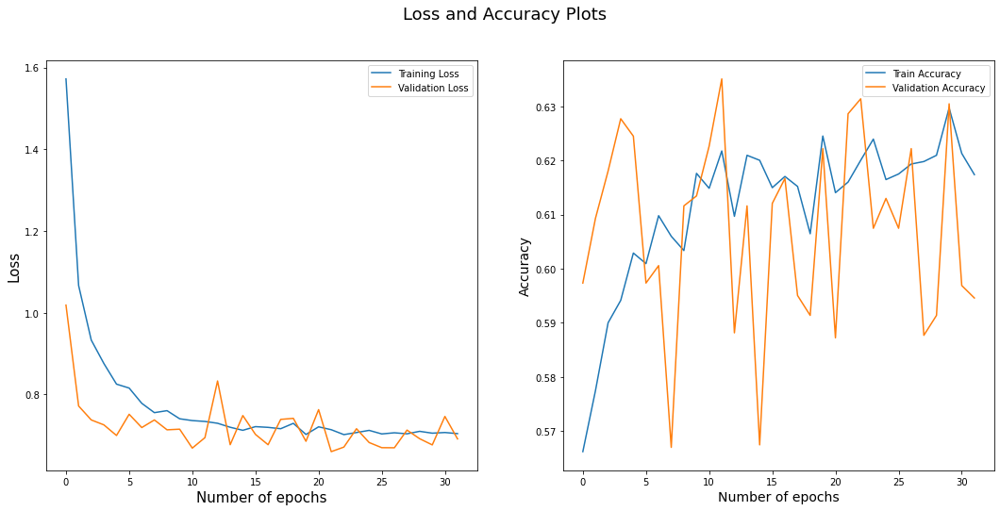

63/63 [==============================] - 5s 39ms/step
0.693


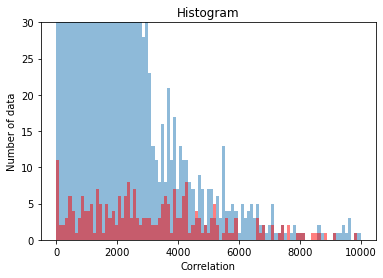

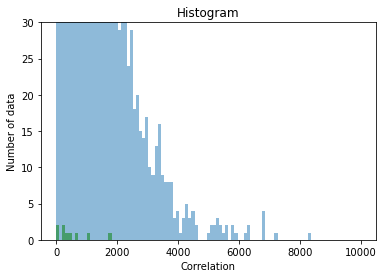

Model: "sequential_69"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_69 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


272/272 [==============================] - 23s 62ms/step - loss: 1.6631 - acc: 0.5582 - val_loss: 0.9718 - val_acc: 0.6135
Epoch 2/32
272/272 [==============================] - 14s 51ms/step - loss: 1.1179 - acc: 0.5819 - val_loss: 0.9311 - val_acc: 0.5997
Epoch 3/32
272/272 [==============================] - 14s 51ms/step - loss: 0.9655 - acc: 0.5901 - val_loss: 0.7230 - val_acc: 0.6384
Epoch 4/32
272/272 [==============================] - 14s 52ms/step - loss: 0.8813 - acc: 0.5870 - val_loss: 0.7016 - val_acc: 0.6241
Epoch 5/32
272/272 [==============================] - 14s 51ms/step - loss: 0.8267 - acc: 0.5947 - val_loss: 0.7001 - val_acc: 0.6223
Epoch 6/32
272/272 [==============================] - 14s 53ms/step - loss: 0.8076 - acc: 0.6039 - val_loss: 0.6931 - val_acc: 0.6329
Epoch 7/32
272/272 [==============================] - 14s 53ms/step - loss: 0.7871 - acc: 0.6049 - val_loss: 0.6870 - val_acc: 0.6264
Epoch 8/32
272/272 [==============================] - 14s 51ms/step - los

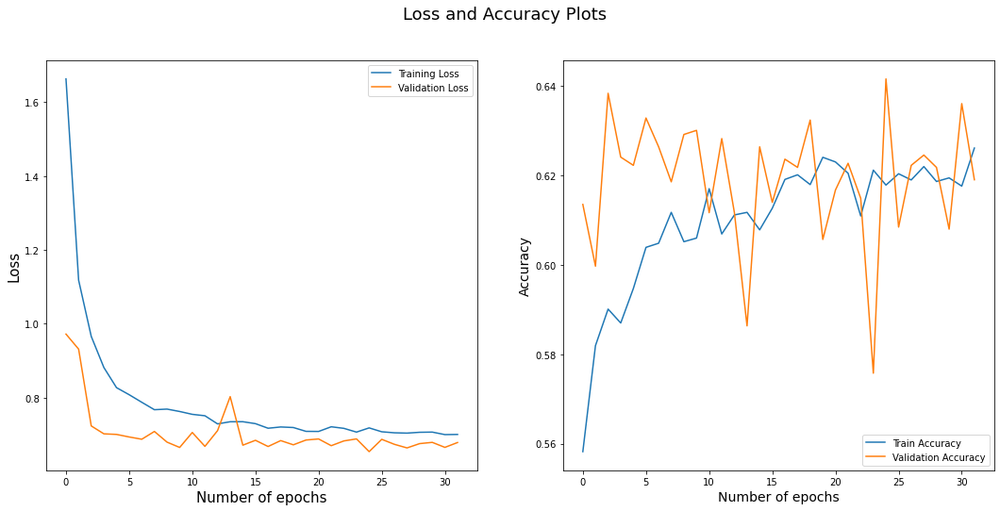

340/340 [==============================] - 13s 38ms/step
Round:  9
Test Accuracy:  0.711
Label Accuracy:  0.9774463776120776
Number of catagory 1:  6280.0
Number of catagory 2:  4583.0
Model: "sequential_70"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_70 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
__________________________________________________

/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


272/272 [==============================] - 23s 61ms/step - loss: 1.6064 - acc: 0.5620 - val_loss: 0.8429 - val_acc: 0.6029
Epoch 2/32
272/272 [==============================] - 14s 52ms/step - loss: 1.0875 - acc: 0.5856 - val_loss: 0.8054 - val_acc: 0.6065
Epoch 3/32
272/272 [==============================] - 14s 52ms/step - loss: 0.9308 - acc: 0.5907 - val_loss: 0.7499 - val_acc: 0.6052
Epoch 4/32
272/272 [==============================] - 14s 53ms/step - loss: 0.8792 - acc: 0.5906 - val_loss: 0.7418 - val_acc: 0.6024
Epoch 5/32
272/272 [==============================] - 14s 52ms/step - loss: 0.8363 - acc: 0.5953 - val_loss: 0.7227 - val_acc: 0.6006
Epoch 6/32
272/272 [==============================] - 14s 53ms/step - loss: 0.7993 - acc: 0.6024 - val_loss: 0.7635 - val_acc: 0.6130
Epoch 7/32
272/272 [==============================] - 15s 53ms/step - loss: 0.7785 - acc: 0.6008 - val_loss: 0.7480 - val_acc: 0.6024
Epoch 8/32
272/272 [==============================] - 14s 53ms/step - los

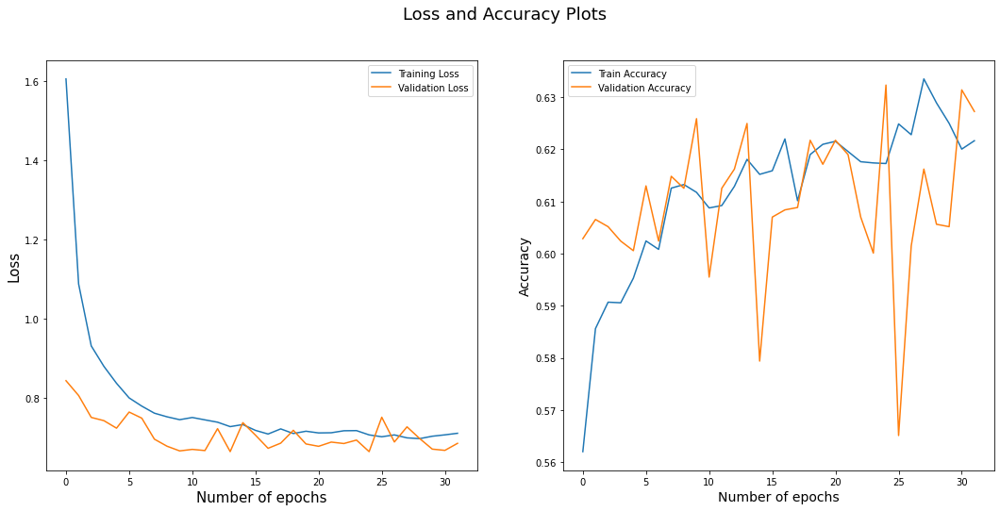

63/63 [==============================] - 5s 39ms/step
0.7185


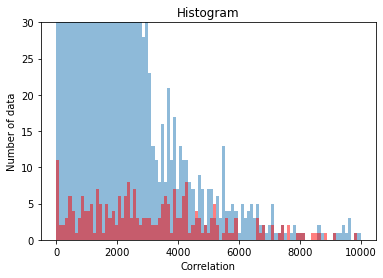

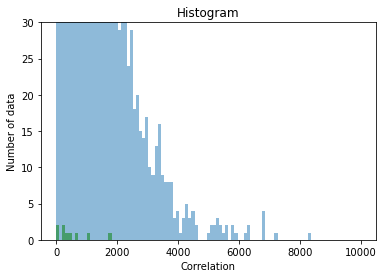

Model: "sequential_71"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_71 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.9/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


272/272 [==============================] - 23s 59ms/step - loss: 1.5398 - acc: 0.5690 - val_loss: 0.8456 - val_acc: 0.6054
Epoch 2/32
272/272 [==============================] - 14s 52ms/step - loss: 1.0802 - acc: 0.5871 - val_loss: 0.7449 - val_acc: 0.6105
Epoch 3/32
272/272 [==============================] - 14s 52ms/step - loss: 0.9583 - acc: 0.5817 - val_loss: 0.7247 - val_acc: 0.6234
Epoch 4/32
272/272 [==============================] - 14s 51ms/step - loss: 0.8538 - acc: 0.5992 - val_loss: 0.7533 - val_acc: 0.6220
Epoch 5/32
272/272 [==============================] - 13s 49ms/step - loss: 0.8302 - acc: 0.5892 - val_loss: 0.6843 - val_acc: 0.6289
Epoch 6/32
272/272 [==============================] - 14s 50ms/step - loss: 0.7832 - acc: 0.6093 - val_loss: 0.7203 - val_acc: 0.6225
Epoch 7/32
272/272 [==============================] - 14s 50ms/step - loss: 0.7717 - acc: 0.6055 - val_loss: 0.7109 - val_acc: 0.6174
Epoch 8/32
272/272 [==============================] - 14s 51ms/step - los

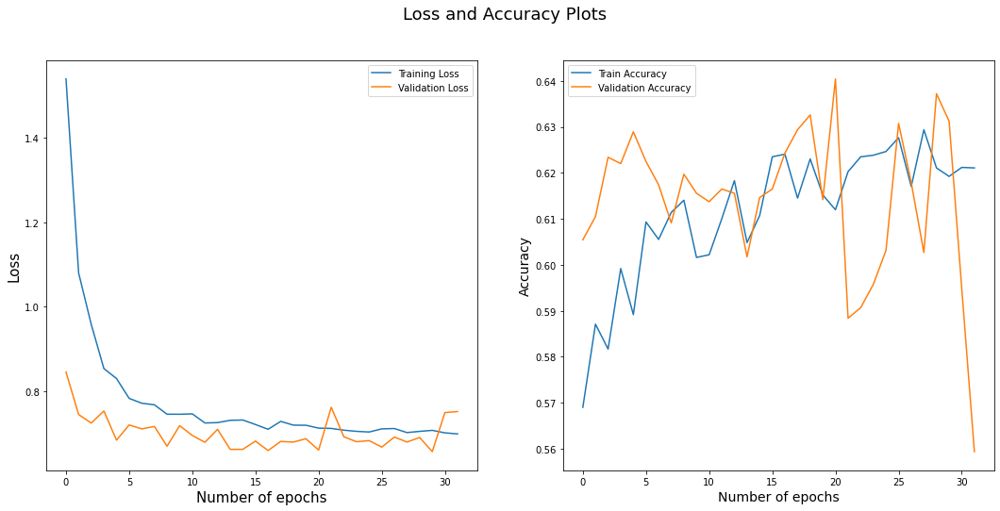

340/340 [==============================] - 13s 37ms/step
Round:  10
Test Accuracy:  0.613
Label Accuracy:  0.9774463776120776
Number of catagory 1:  6280.0
Number of catagory 2:  4583.0


In [11]:
#---Train---
from tensorflow.compat.v1.keras.applications import ResNet101

res = ResNet101(weights='imagenet', include_top = False, classes = 2, input_shape=(32,32,3))

Label_Accuracy = []
Test_Accuracy = []
Test_Accurracy_0 = []

Rounds = 11


for Round in range(Rounds):
    model = Sequential()
    
    model.add(res)
    # model.add(GlobalAveragePooling2D(name='penultimate'))
    model.add(Flatten(name='penultimate'))
    
    model.add(Dropout(0.5))
    model.add(Dense(2, activation = 'softmax', name='dense'))
    res.trainable = False
    model.summary()
    
    lr = 1e-4
    sgd = SGD(lr = lr, momentum = 0.9, nesterov = True)
    model.compile(loss = 'categorical_crossentropy', optimizer = sgd, metrics = ['acc'])
    
    hist = model.fit(x=X, y=y_shifted, batch_size=32, epochs=32, verbose=1, callbacks=None, validation_split=0.2, validation_data=None, shuffle=True, class_weight=None, sample_weight=None, initial_epoch=0, steps_per_epoch=None, validation_steps=None)
    
    
    
    plt.figure(figsize=(18,8))
    
    plt.suptitle('Loss and Accuracy Plots', fontsize=18)
    
    plt.subplot(1,2,1)
    plt.plot(hist.history['loss'], label='Training Loss')
    plt.plot(hist.history['val_loss'], label='Validation Loss')
    plt.legend()
    plt.xlabel('Number of epochs', fontsize=15)
    plt.ylabel('Loss', fontsize=15)
    
    plt.subplot(1,2,2)
    plt.plot(hist.history['acc'], label='Train Accuracy')
    plt.plot(hist.history['val_acc'], label='Validation Accuracy')
    plt.legend()
    plt.xlabel('Number of epochs', fontsize=14)
    plt.ylabel('Accuracy', fontsize=14)
    plt.show()
    
    
    y_pred = model.predict(X_test, verbose=1)
    y_pred = np.argmax(y_pred, axis = 1)
    print(accuracy_score(y_test, y_pred))
    Test_Accurracy_0.append(accuracy_score(y_test, y_pred))
    
    sub_model = tf.keras.Model(inputs = model.input, outputs = model.get_layer('penultimate').output)
    R = sub_model.predict(X)
    
    preserved_index = []
    relabel_index = []
    
    T_index = [-1 for i in range(len(R))]
    for catagory in [0, 1]:
        R_c = R[y_shifted[:,catagory] == 1]
        R_hat = np.average(R_c, axis=0)
        M = R_c.copy()
        for i in range(len(M)):
            M[i] -= R_hat
        u, s, vh = np.linalg.svd(M, full_matrices=True)
        v = vh[0]
        
        T = []
        T00 = []
        T01 = []
        T10 = []
        for i, r in enumerate(R):
            if y_shifted[i, catagory] == 1:
                T.append((np.dot((r-R_hat), v)**2))
                T_index[i] = len(T)-1
                
                if (y_shifted[i] == to_categorical(y, 2)[i]).all():
                    T00.append((np.dot((r-R_hat), v)**2))
                elif y_shifted[i][0] == 1:
                    T01.append((np.dot((r-R_hat), v)**2))
                elif y_shifted[i][0] == 0:
                    T10.append((np.dot((r-R_hat), v)**2))
        
        bins = np.linspace(0, 10000, 100)
        n, bins, patches=plt.hist(T00,alpha = 0.5,bins=bins)
        n, bins, patches=plt.hist(T01,bins=bins,alpha = 0.5,color='red')
        n, bins, patches=plt.hist(T10,bins=bins,alpha = 0.5,color='green')
        plt.ylim(0, 30)
        plt.xlabel("Correlation")
        plt.ylabel("Number of data")
        plt.title("Histogram")
        plt.show()
    
        S = sorted(range(len(T)), key=lambda k: T[k])
        # d = T[S[int(len(M) * (1 - 0.25 * (1 - (Round / Rounds))))]]
        d = T[S[int(len(M) * (1 - 0.25 * 0.5**Round))-1]]
        # rl = T[S[int(len(M) * (1 - 0.5**Round))]]
        # d = T[S[int(len(M) * (1 - 0.25))]]
        # rl = T[S[int(500*(1-0.1))]]
        for i, r in enumerate(R):
            if y_shifted[i, catagory] == 1 and T[T_index[i]] < d:
                preserved_index.append(i)
            # if y_shifted[i, catagory] == 1 and T[T_index[i]] >= rl:
            #     relabel_index.append(i)
                
    
    preserved_index.sort()
    relabel_index.sort()
    X_p = X[preserved_index]
    y_p = y_shifted.copy()
    y_p = y_p[preserved_index]
    
    
    
    model = Sequential()
    model.add(res)
    # model.add(GlobalAveragePooling2D(name='GAP'))
    model.add(Flatten(name='FC'))
    
    model.add(Dropout(0.5))
    model.add(Dense(2, activation = 'softmax', name='dense'))
    res.trainable = False
    model.summary()
    
    lr = 1e-4
    sgd = SGD(lr = lr, momentum = 0.9, nesterov = True)
    model.compile(loss = 'categorical_crossentropy', optimizer = sgd, metrics = ['acc'])
    
    hist = model.fit(x=X_p, y=y_p, batch_size=32, epochs=32, verbose=1, callbacks=None, validation_split=0.2, validation_data=None, shuffle=True, class_weight=None, sample_weight=None, initial_epoch=0, steps_per_epoch=None, validation_steps=None)
    
    plt.figure(figsize=(18,8))
    
    plt.suptitle('Loss and Accuracy Plots', fontsize=18)
    
    plt.subplot(1,2,1)
    plt.plot(hist.history['loss'], label='Training Loss')
    plt.plot(hist.history['val_loss'], label='Validation Loss')
    plt.legend()
    plt.xlabel('Number of epochs', fontsize=15)
    plt.ylabel('Loss', fontsize=15)
    
    plt.subplot(1,2,2)
    plt.plot(hist.history['acc'], label='Train Accuracy')
    plt.plot(hist.history['val_acc'], label='Validation Accuracy')
    plt.legend()
    plt.xlabel('Number of epochs', fontsize=14)
    plt.ylabel('Accuracy', fontsize=14)
    plt.show()
    
    y_pred = model.predict(X_test, verbose=1)
    y_pred = np.argmax(y_pred, axis = 1)
    
    y_new_pred = model.predict(X, verbose=1)
    y_new = np.argmax(y_new_pred, axis = 1)
    
    # for i in relabel_index:
    for i in range(len(X)):
        if max(y_new_pred[i]) > 0.99: 
            y_shifted[i] = to_categorical(y_new, 2)[i]
    
    print('Round: ', Round)
    print('Test Accuracy: ', accuracy_score(y_test, y_pred))
    print('Label Accuracy: ', accuracy_score(y, y_shifted[:,1]))
    print('Number of catagory 1: ', np.sum(y_shifted[:,0]))
    print('Number of catagory 2: ', np.sum(y_shifted[:,1]))
    Label_Accuracy.append(accuracy_score(y, y_shifted[:,1]))
    Test_Accuracy.append(accuracy_score(y_test, y_pred))

Files already downloaded and verified


2022-01-09 23:26:13.347662: I tensorflow/core/platform/cpu_feature_guard.cc:151] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-01-09 23:26:15.828249: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1525] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 9163 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 2080 Ti, pci bus id: 0000:21:00.0, compute capability: 7.5


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout (Dropout)           (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)
2022-01-09 23:26:24.885326: I tensorflow/stream_executor/cuda/cuda_dnn.cc:368] Loaded cuDNN version 8204


240/240 [==============================] - 19s 49ms/step - loss: 1.6960 - acc: 0.5914 - val_loss: 0.9629 - val_acc: 0.6442
Epoch 2/32
240/240 [==============================] - 9s 39ms/step - loss: 1.1148 - acc: 0.6245 - val_loss: 0.7237 - val_acc: 0.6755
Epoch 3/32
240/240 [==============================] - 10s 40ms/step - loss: 0.9492 - acc: 0.6314 - val_loss: 0.7543 - val_acc: 0.6495
Epoch 4/32
240/240 [==============================] - 10s 40ms/step - loss: 0.8679 - acc: 0.6415 - val_loss: 0.7051 - val_acc: 0.6818
Epoch 5/32
240/240 [==============================] - 9s 39ms/step - loss: 0.8083 - acc: 0.6523 - val_loss: 0.6873 - val_acc: 0.6745
Epoch 6/32
240/240 [==============================] - 9s 39ms/step - loss: 0.7724 - acc: 0.6615 - val_loss: 0.6448 - val_acc: 0.6865
Epoch 7/32
240/240 [==============================] - 9s 40ms/step - loss: 0.7777 - acc: 0.6503 - val_loss: 0.6314 - val_acc: 0.6813
Epoch 8/32
240/240 [==============================] - 10s 40ms/step - loss: 0

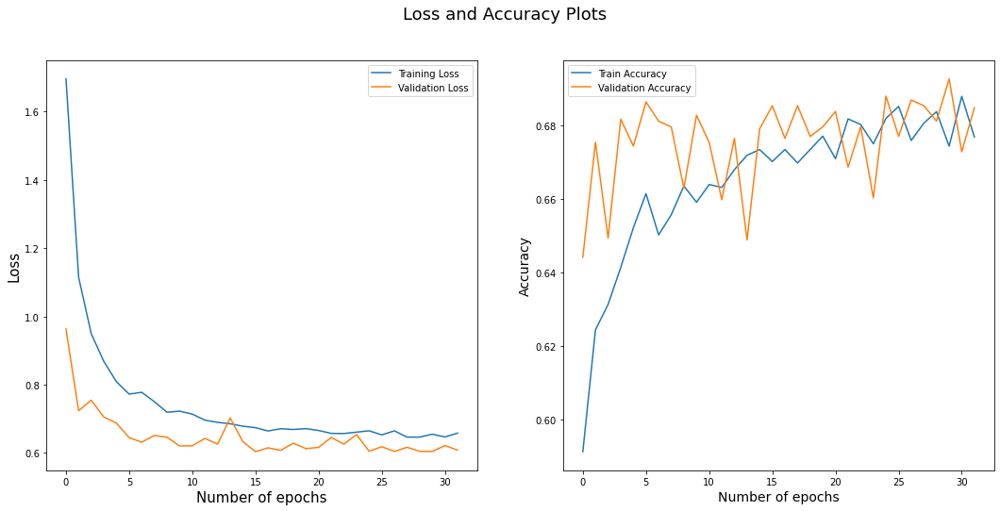

63/63 [==============================] - 4s 29ms/step
0.709


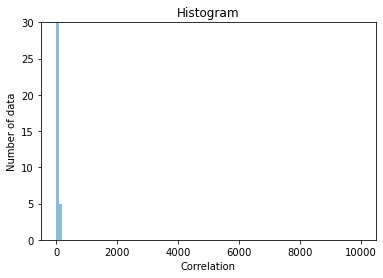

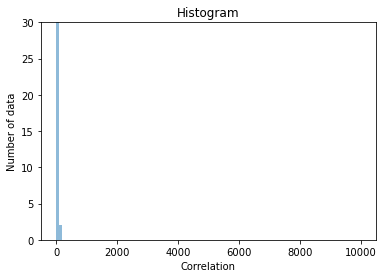

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_1 (Dropout)         (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


180/180 [==============================] - 14s 49ms/step - loss: 1.6550 - acc: 0.5931 - val_loss: 0.7947 - val_acc: 0.6708
Epoch 2/32
180/180 [==============================] - 7s 39ms/step - loss: 1.0902 - acc: 0.6434 - val_loss: 0.7394 - val_acc: 0.6834
Epoch 3/32
180/180 [==============================] - 7s 38ms/step - loss: 0.9312 - acc: 0.6533 - val_loss: 0.6948 - val_acc: 0.7008
Epoch 4/32
180/180 [==============================] - 7s 38ms/step - loss: 0.8542 - acc: 0.6590 - val_loss: 0.6557 - val_acc: 0.6924
Epoch 5/32
180/180 [==============================] - 7s 39ms/step - loss: 0.7606 - acc: 0.6766 - val_loss: 0.6245 - val_acc: 0.7015
Epoch 6/32
180/180 [==============================] - 7s 39ms/step - loss: 0.7493 - acc: 0.6868 - val_loss: 0.6243 - val_acc: 0.7022
Epoch 7/32
180/180 [==============================] - 7s 39ms/step - loss: 0.7257 - acc: 0.6881 - val_loss: 0.5957 - val_acc: 0.7203
Epoch 8/32
180/180 [==============================] - 7s 39ms/step - loss: 0.69

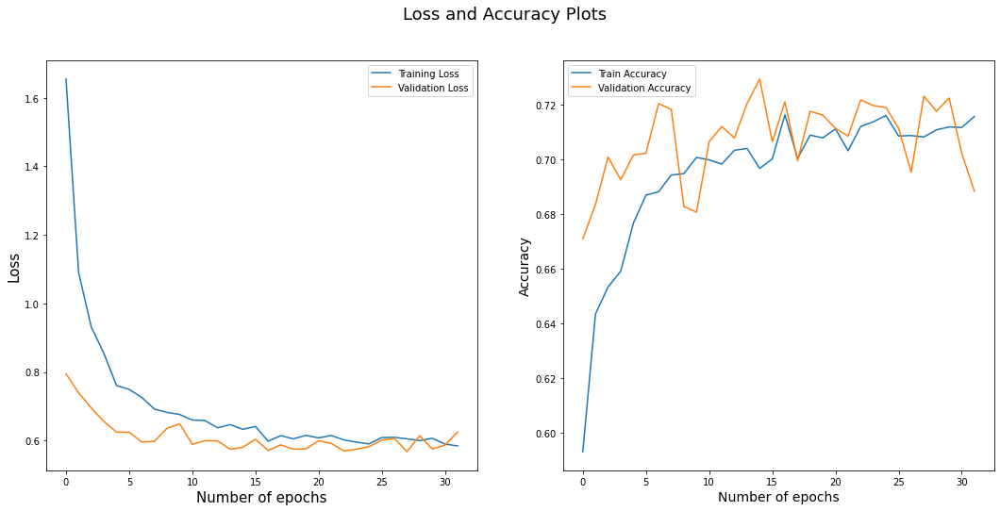

300/300 [==============================] - 9s 31ms/step
Round:  0
Test Accuracy:  0.67
Label Accuracy:  0.9896702838063439
Number of catagory 1:  4694.0
Number of catagory 2:  4890.0
Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_2 (Dropout)         (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_____________________________________________________

/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


240/240 [==============================] - 16s 45ms/step - loss: 1.6987 - acc: 0.5848 - val_loss: 0.8915 - val_acc: 0.6479
Epoch 2/32
240/240 [==============================] - 9s 37ms/step - loss: 1.0897 - acc: 0.6317 - val_loss: 0.7673 - val_acc: 0.6510
Epoch 3/32
240/240 [==============================] - 9s 38ms/step - loss: 0.9365 - acc: 0.6454 - val_loss: 0.6803 - val_acc: 0.6677
Epoch 4/32
240/240 [==============================] - 9s 37ms/step - loss: 0.8284 - acc: 0.6568 - val_loss: 0.6598 - val_acc: 0.6734
Epoch 5/32
240/240 [==============================] - 9s 38ms/step - loss: 0.7969 - acc: 0.6610 - val_loss: 0.6318 - val_acc: 0.6870
Epoch 6/32
240/240 [==============================] - 9s 38ms/step - loss: 0.7703 - acc: 0.6656 - val_loss: 0.6504 - val_acc: 0.6808
Epoch 7/32
240/240 [==============================] - 9s 39ms/step - loss: 0.7600 - acc: 0.6639 - val_loss: 0.6132 - val_acc: 0.6823
Epoch 8/32
240/240 [==============================] - 9s 37ms/step - loss: 0.72

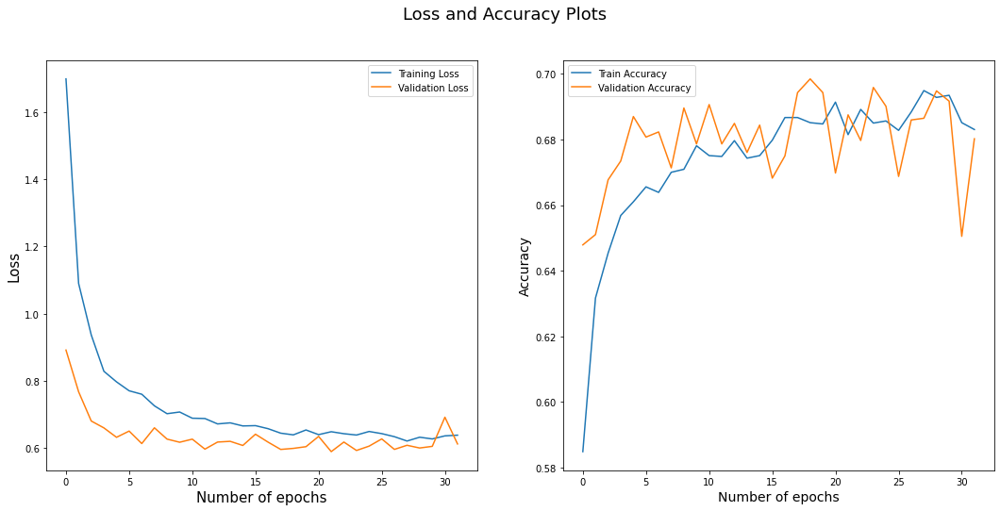

63/63 [==============================] - 4s 31ms/step
0.687


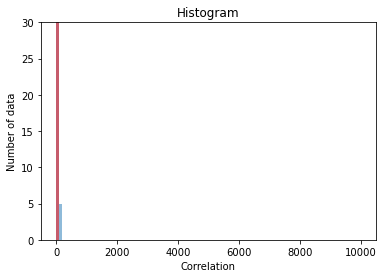

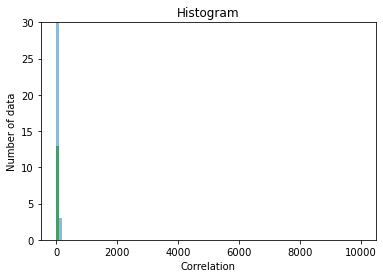

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_3 (Dropout)         (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


210/210 [==============================] - 15s 49ms/step - loss: 1.6335 - acc: 0.5899 - val_loss: 0.8129 - val_acc: 0.6714
Epoch 2/32
210/210 [==============================] - 8s 38ms/step - loss: 1.0672 - acc: 0.6441 - val_loss: 0.7238 - val_acc: 0.6792
Epoch 3/32
210/210 [==============================] - 8s 39ms/step - loss: 0.9051 - acc: 0.6578 - val_loss: 0.6648 - val_acc: 0.6935
Epoch 4/32
210/210 [==============================] - 8s 37ms/step - loss: 0.8608 - acc: 0.6494 - val_loss: 0.6727 - val_acc: 0.6816
Epoch 5/32
210/210 [==============================] - 8s 38ms/step - loss: 0.7883 - acc: 0.6685 - val_loss: 0.6315 - val_acc: 0.6905
Epoch 6/32
210/210 [==============================] - 8s 39ms/step - loss: 0.7477 - acc: 0.6736 - val_loss: 0.6119 - val_acc: 0.6947
Epoch 7/32
210/210 [==============================] - 8s 40ms/step - loss: 0.7319 - acc: 0.6695 - val_loss: 0.6262 - val_acc: 0.7013
Epoch 8/32
210/210 [==============================] - 8s 40ms/step - loss: 0.71

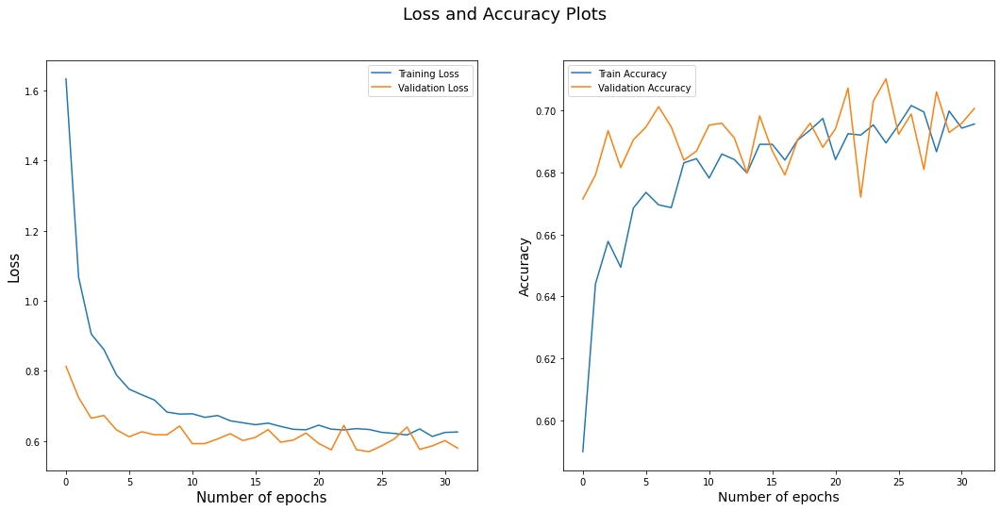

300/300 [==============================] - 8s 27ms/step
Round:  1
Test Accuracy:  0.708
Label Accuracy:  0.9882095158597662
Number of catagory 1:  4688.0
Number of catagory 2:  4896.0
Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_4 (Dropout)         (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
____________________________________________________

/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


240/240 [==============================] - 15s 45ms/step - loss: 1.6465 - acc: 0.5959 - val_loss: 0.8559 - val_acc: 0.6463
Epoch 2/32
240/240 [==============================] - 9s 37ms/step - loss: 1.0966 - acc: 0.6241 - val_loss: 0.7238 - val_acc: 0.6703
Epoch 3/32
240/240 [==============================] - 9s 39ms/step - loss: 0.9162 - acc: 0.6447 - val_loss: 0.6650 - val_acc: 0.6828
Epoch 4/32
240/240 [==============================] - 10s 40ms/step - loss: 0.8358 - acc: 0.6597 - val_loss: 0.6723 - val_acc: 0.6834
Epoch 5/32
240/240 [==============================] - 10s 40ms/step - loss: 0.7773 - acc: 0.6587 - val_loss: 0.6601 - val_acc: 0.6766
Epoch 6/32
240/240 [==============================] - 9s 38ms/step - loss: 0.7649 - acc: 0.6657 - val_loss: 0.6894 - val_acc: 0.6625
Epoch 7/32
240/240 [==============================] - 9s 39ms/step - loss: 0.7306 - acc: 0.6782 - val_loss: 0.6074 - val_acc: 0.6907
Epoch 8/32
240/240 [==============================] - 9s 38ms/step - loss: 0.

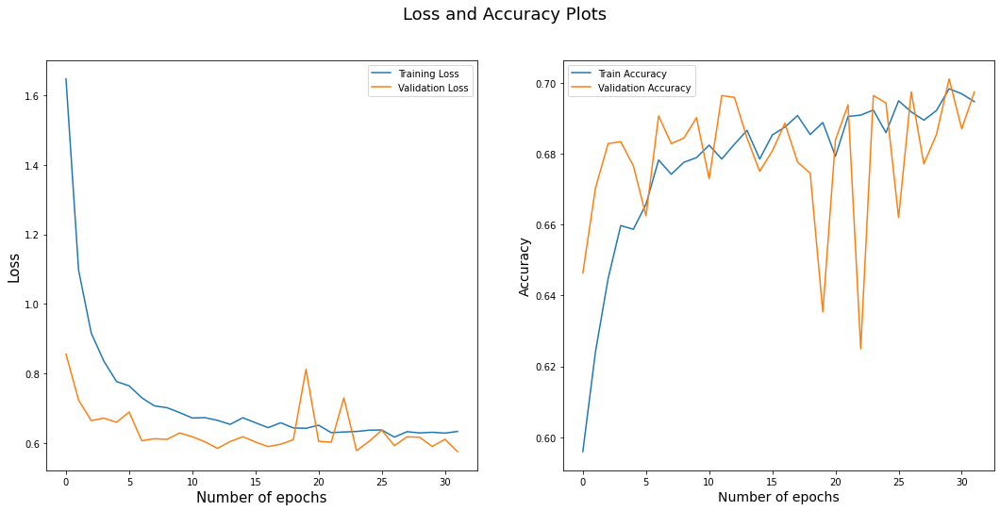

63/63 [==============================] - 4s 30ms/step
0.709


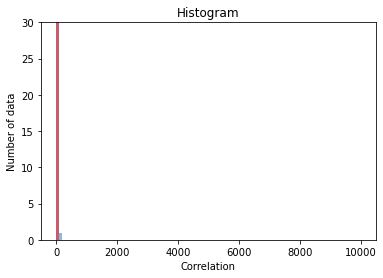

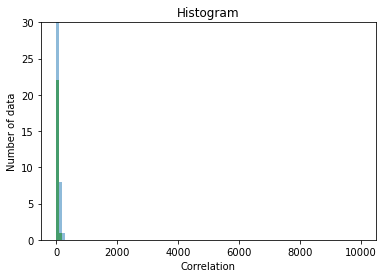

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_5 (Dropout)         (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


225/225 [==============================] - 16s 47ms/step - loss: 1.6366 - acc: 0.5913 - val_loss: 0.9074 - val_acc: 0.6338
Epoch 2/32
225/225 [==============================] - 9s 40ms/step - loss: 1.0914 - acc: 0.6213 - val_loss: 0.7264 - val_acc: 0.6694
Epoch 3/32
225/225 [==============================] - 9s 40ms/step - loss: 0.9120 - acc: 0.6471 - val_loss: 0.7329 - val_acc: 0.6628
Epoch 4/32
225/225 [==============================] - 9s 38ms/step - loss: 0.8451 - acc: 0.6500 - val_loss: 0.7033 - val_acc: 0.6544
Epoch 5/32
225/225 [==============================] - 9s 40ms/step - loss: 0.7761 - acc: 0.6635 - val_loss: 0.6397 - val_acc: 0.6711
Epoch 6/32
225/225 [==============================] - 9s 39ms/step - loss: 0.7392 - acc: 0.6691 - val_loss: 0.6668 - val_acc: 0.6767
Epoch 7/32
225/225 [==============================] - 9s 39ms/step - loss: 0.7224 - acc: 0.6667 - val_loss: 0.6593 - val_acc: 0.6800
Epoch 8/32
225/225 [==============================] - 8s 37ms/step - loss: 0.70

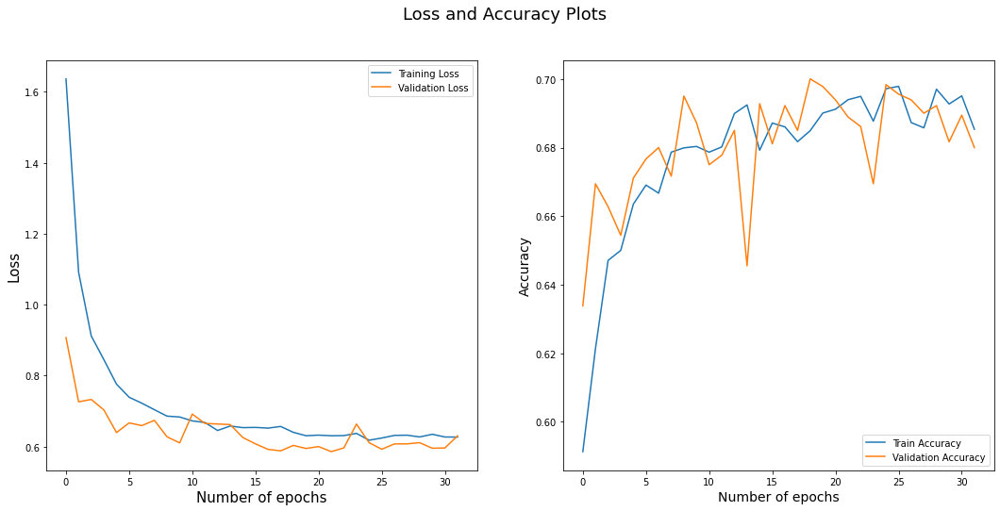

300/300 [==============================] - 8s 27ms/step
Round:  2
Test Accuracy:  0.687
Label Accuracy:  0.9873747913188647
Number of catagory 1:  4682.0
Number of catagory 2:  4902.0
Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_6 (Dropout)         (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
____________________________________________________

/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


240/240 [==============================] - 17s 46ms/step - loss: 1.7614 - acc: 0.5888 - val_loss: 0.9351 - val_acc: 0.6510
Epoch 2/32
240/240 [==============================] - 9s 39ms/step - loss: 1.0860 - acc: 0.6339 - val_loss: 0.8977 - val_acc: 0.6385
Epoch 3/32
240/240 [==============================] - 9s 38ms/step - loss: 0.9391 - acc: 0.6340 - val_loss: 0.6891 - val_acc: 0.6802
Epoch 4/32
240/240 [==============================] - 9s 38ms/step - loss: 0.8435 - acc: 0.6608 - val_loss: 0.6910 - val_acc: 0.6818
Epoch 5/32
240/240 [==============================] - 9s 37ms/step - loss: 0.7773 - acc: 0.6606 - val_loss: 0.6265 - val_acc: 0.6849
Epoch 6/32
240/240 [==============================] - 9s 39ms/step - loss: 0.7628 - acc: 0.6583 - val_loss: 0.6093 - val_acc: 0.6943
Epoch 7/32
240/240 [==============================] - 9s 37ms/step - loss: 0.7345 - acc: 0.6636 - val_loss: 0.6113 - val_acc: 0.6907
Epoch 8/32
240/240 [==============================] - 9s 37ms/step - loss: 0.71

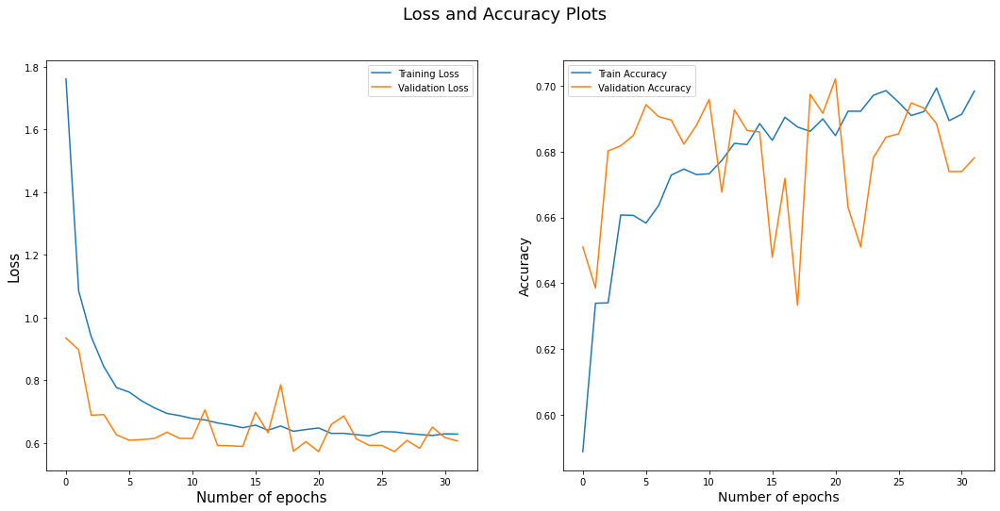

63/63 [==============================] - 3s 29ms/step
0.699


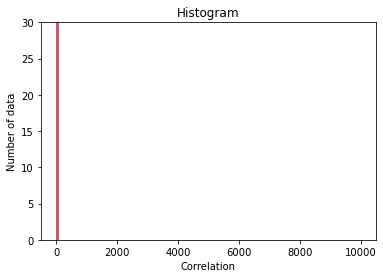

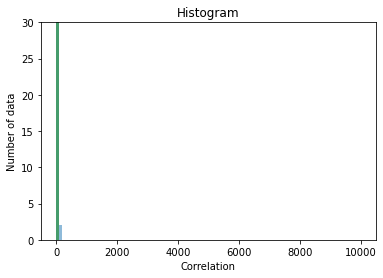

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_7 (Dropout)         (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


232/232 [==============================] - 16s 45ms/step - loss: 1.6800 - acc: 0.5882 - val_loss: 0.7918 - val_acc: 0.6489
Epoch 2/32
232/232 [==============================] - 9s 37ms/step - loss: 1.0892 - acc: 0.6259 - val_loss: 0.7168 - val_acc: 0.6774
Epoch 3/32
232/232 [==============================] - 9s 37ms/step - loss: 0.9262 - acc: 0.6436 - val_loss: 0.6762 - val_acc: 0.6677
Epoch 4/32
232/232 [==============================] - 8s 36ms/step - loss: 0.8145 - acc: 0.6575 - val_loss: 0.6350 - val_acc: 0.6758
Epoch 5/32
232/232 [==============================] - 9s 38ms/step - loss: 0.7782 - acc: 0.6611 - val_loss: 0.6575 - val_acc: 0.6753
Epoch 6/32
232/232 [==============================] - 9s 39ms/step - loss: 0.7667 - acc: 0.6575 - val_loss: 0.6236 - val_acc: 0.6677
Epoch 7/32
232/232 [==============================] - 9s 40ms/step - loss: 0.7066 - acc: 0.6746 - val_loss: 0.6604 - val_acc: 0.6618
Epoch 8/32
232/232 [==============================] - 9s 39ms/step - loss: 0.70

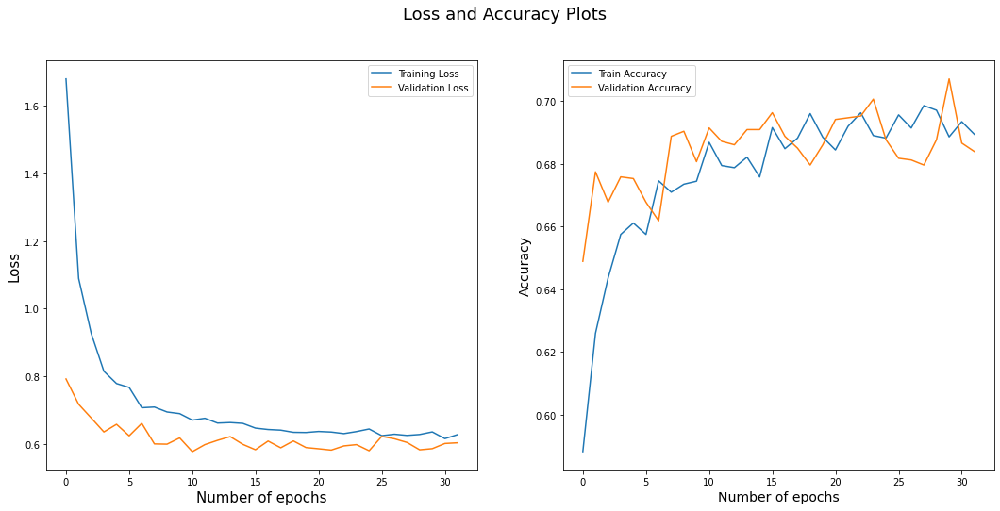

300/300 [==============================] - 9s 29ms/step
Round:  3
Test Accuracy:  0.7075
Label Accuracy:  0.9870617696160268
Number of catagory 1:  4681.0
Number of catagory 2:  4903.0
Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_8 (Dropout)         (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
___________________________________________________

/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


240/240 [==============================] - 16s 45ms/step - loss: 1.6174 - acc: 0.6006 - val_loss: 0.8052 - val_acc: 0.6724
Epoch 2/32
240/240 [==============================] - 9s 38ms/step - loss: 1.0782 - acc: 0.6369 - val_loss: 0.7004 - val_acc: 0.6667
Epoch 3/32
240/240 [==============================] - 9s 36ms/step - loss: 0.9068 - acc: 0.6441 - val_loss: 0.7518 - val_acc: 0.6688
Epoch 4/32
240/240 [==============================] - 9s 37ms/step - loss: 0.8268 - acc: 0.6512 - val_loss: 0.6545 - val_acc: 0.6776
Epoch 5/32
240/240 [==============================] - 9s 37ms/step - loss: 0.7673 - acc: 0.6669 - val_loss: 0.6527 - val_acc: 0.6933
Epoch 6/32
240/240 [==============================] - 9s 37ms/step - loss: 0.7563 - acc: 0.6618 - val_loss: 0.6510 - val_acc: 0.6703
Epoch 7/32
240/240 [==============================] - 9s 37ms/step - loss: 0.7194 - acc: 0.6682 - val_loss: 0.6240 - val_acc: 0.6875
Epoch 8/32
240/240 [==============================] - 9s 38ms/step - loss: 0.69

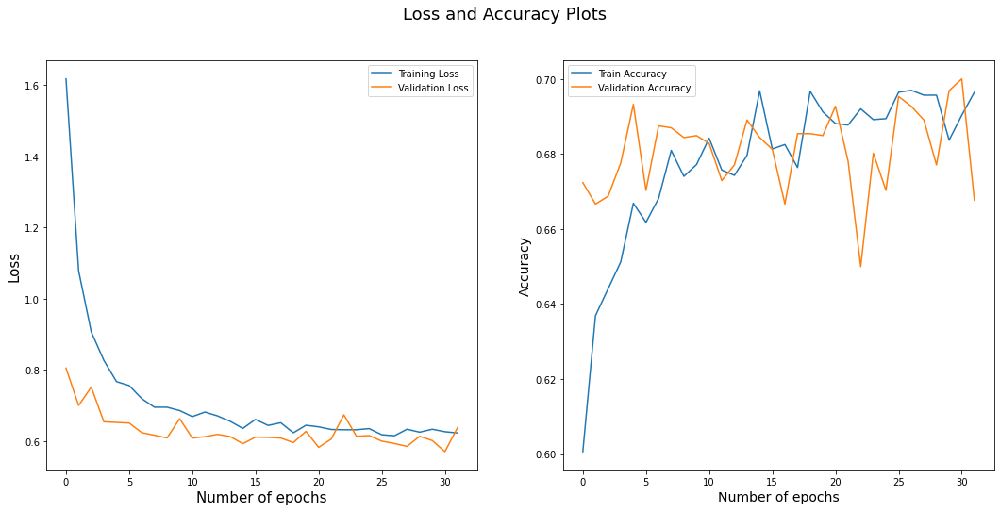

63/63 [==============================] - 3s 28ms/step
0.669


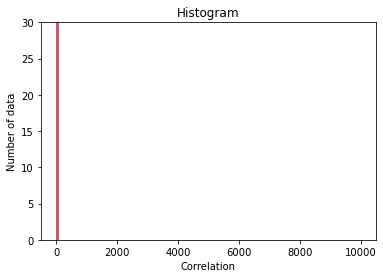

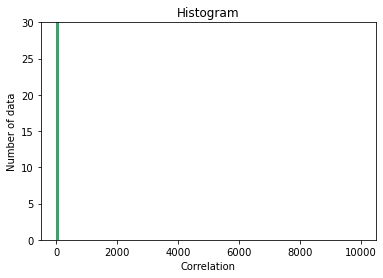

Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_9 (Dropout)         (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


236/236 [==============================] - 16s 49ms/step - loss: 1.5877 - acc: 0.5929 - val_loss: 0.7943 - val_acc: 0.6539
Epoch 2/32
236/236 [==============================] - 9s 37ms/step - loss: 1.0318 - acc: 0.6322 - val_loss: 0.7082 - val_acc: 0.6698
Epoch 3/32
236/236 [==============================] - 9s 38ms/step - loss: 0.9133 - acc: 0.6457 - val_loss: 0.7247 - val_acc: 0.6603
Epoch 4/32
236/236 [==============================] - 9s 37ms/step - loss: 0.8288 - acc: 0.6542 - val_loss: 0.6329 - val_acc: 0.6863
Epoch 5/32
236/236 [==============================] - 9s 37ms/step - loss: 0.7853 - acc: 0.6646 - val_loss: 0.6475 - val_acc: 0.6783
Epoch 6/32
236/236 [==============================] - 9s 38ms/step - loss: 0.7522 - acc: 0.6658 - val_loss: 0.6085 - val_acc: 0.6926
Epoch 7/32
236/236 [==============================] - 9s 36ms/step - loss: 0.7309 - acc: 0.6707 - val_loss: 0.6034 - val_acc: 0.6831
Epoch 8/32
236/236 [==============================] - 9s 36ms/step - loss: 0.69

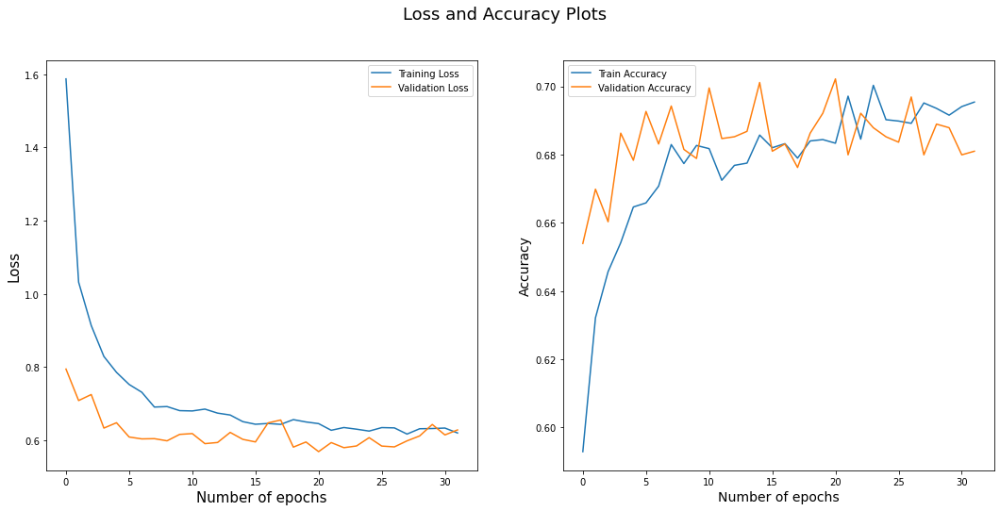

300/300 [==============================] - 10s 32ms/step
Round:  4
Test Accuracy:  0.698
Label Accuracy:  0.9862270450751253
Number of catagory 1:  4673.0
Number of catagory 2:  4911.0
Model: "sequential_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_10 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
__________________________________________________

/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


240/240 [==============================] - 15s 44ms/step - loss: 1.6311 - acc: 0.5825 - val_loss: 0.8001 - val_acc: 0.6661
Epoch 2/32
240/240 [==============================] - 9s 36ms/step - loss: 1.0492 - acc: 0.6328 - val_loss: 0.6855 - val_acc: 0.6881
Epoch 3/32
240/240 [==============================] - 9s 38ms/step - loss: 0.8961 - acc: 0.6545 - val_loss: 0.6657 - val_acc: 0.6781
Epoch 4/32
240/240 [==============================] - 9s 37ms/step - loss: 0.8297 - acc: 0.6550 - val_loss: 0.6431 - val_acc: 0.6693
Epoch 5/32
240/240 [==============================] - 9s 38ms/step - loss: 0.7687 - acc: 0.6677 - val_loss: 0.6350 - val_acc: 0.6808
Epoch 6/32
240/240 [==============================] - 9s 36ms/step - loss: 0.7385 - acc: 0.6751 - val_loss: 0.6218 - val_acc: 0.6813
Epoch 7/32
240/240 [==============================] - 9s 36ms/step - loss: 0.6959 - acc: 0.6827 - val_loss: 0.6868 - val_acc: 0.6625
Epoch 8/32
240/240 [==============================] - 9s 40ms/step - loss: 0.71

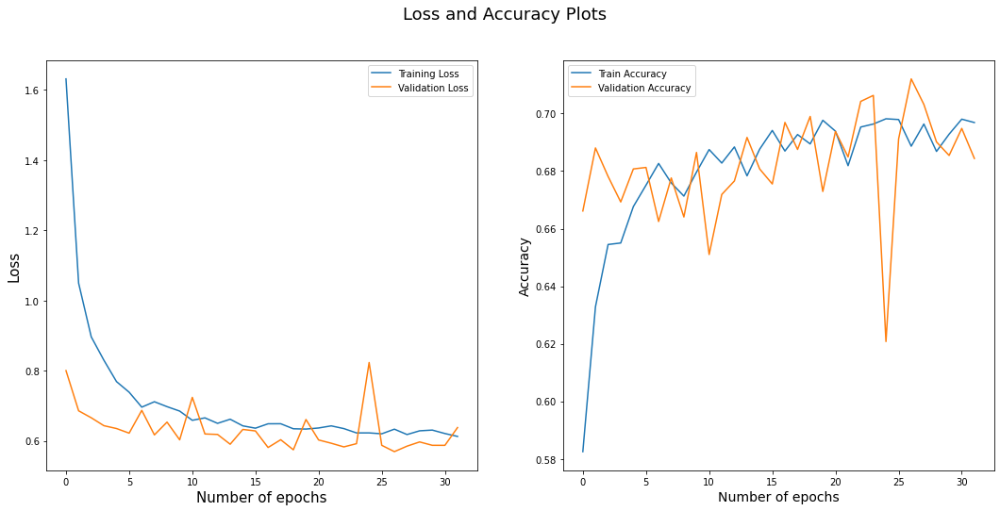

63/63 [==============================] - 4s 30ms/step
0.681


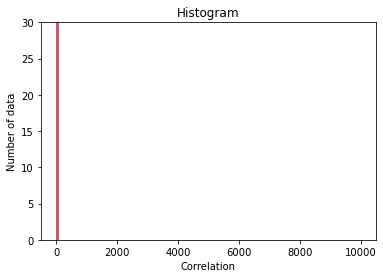

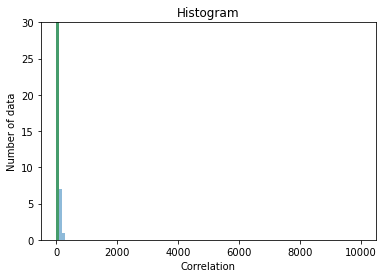

Model: "sequential_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_11 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


238/238 [==============================] - 16s 47ms/step - loss: 1.5814 - acc: 0.5977 - val_loss: 0.7711 - val_acc: 0.6782
Epoch 2/32
238/238 [==============================] - 9s 37ms/step - loss: 1.0887 - acc: 0.6361 - val_loss: 0.6747 - val_acc: 0.6898
Epoch 3/32
238/238 [==============================] - 9s 38ms/step - loss: 0.8972 - acc: 0.6540 - val_loss: 0.6562 - val_acc: 0.6814
Epoch 4/32
238/238 [==============================] - 9s 38ms/step - loss: 0.8050 - acc: 0.6687 - val_loss: 0.6390 - val_acc: 0.6882
Epoch 5/32
238/238 [==============================] - 9s 37ms/step - loss: 0.7808 - acc: 0.6578 - val_loss: 0.6295 - val_acc: 0.6840
Epoch 6/32
238/238 [==============================] - 9s 36ms/step - loss: 0.7405 - acc: 0.6666 - val_loss: 0.6129 - val_acc: 0.7029
Epoch 7/32
238/238 [==============================] - 9s 36ms/step - loss: 0.7227 - acc: 0.6746 - val_loss: 0.5969 - val_acc: 0.6919
Epoch 8/32
238/238 [==============================] - 9s 38ms/step - loss: 0.69

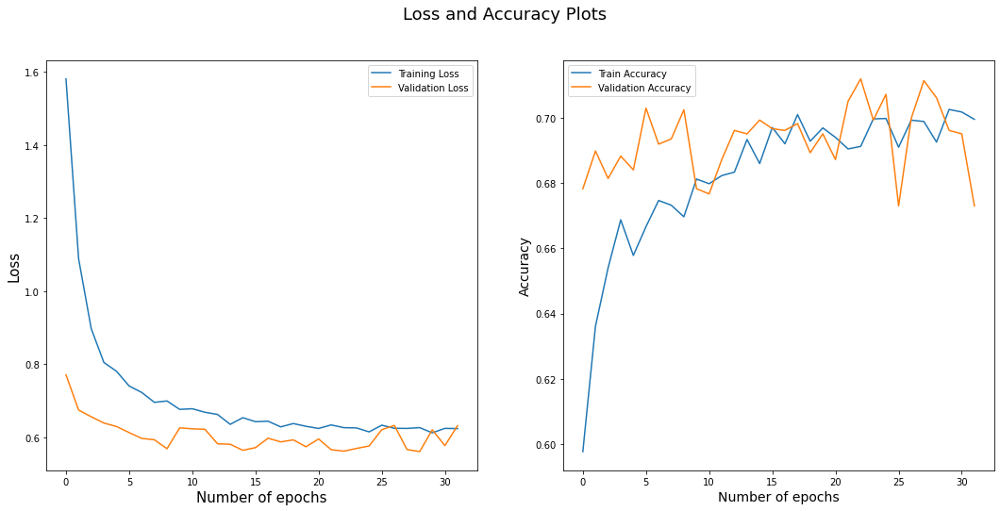

300/300 [==============================] - 9s 30ms/step
Round:  5
Test Accuracy:  0.6855
Label Accuracy:  0.9861227045075125
Number of catagory 1:  4674.0
Number of catagory 2:  4910.0
Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_12 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
__________________________________________________

/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


240/240 [==============================] - 17s 47ms/step - loss: 1.6962 - acc: 0.5918 - val_loss: 0.8606 - val_acc: 0.6641
Epoch 2/32
240/240 [==============================] - 9s 39ms/step - loss: 1.0913 - acc: 0.6327 - val_loss: 0.6552 - val_acc: 0.6907
Epoch 3/32
240/240 [==============================] - 9s 39ms/step - loss: 0.8941 - acc: 0.6559 - val_loss: 0.6610 - val_acc: 0.6839
Epoch 4/32
240/240 [==============================] - 9s 39ms/step - loss: 0.8306 - acc: 0.6587 - val_loss: 0.6485 - val_acc: 0.6667
Epoch 5/32
240/240 [==============================] - 10s 41ms/step - loss: 0.7847 - acc: 0.6645 - val_loss: 0.6248 - val_acc: 0.6985
Epoch 6/32
240/240 [==============================] - 9s 38ms/step - loss: 0.7518 - acc: 0.6684 - val_loss: 0.6226 - val_acc: 0.6886
Epoch 7/32
240/240 [==============================] - 9s 39ms/step - loss: 0.7153 - acc: 0.6784 - val_loss: 0.6081 - val_acc: 0.6917
Epoch 8/32
240/240 [==============================] - 9s 38ms/step - loss: 0.7

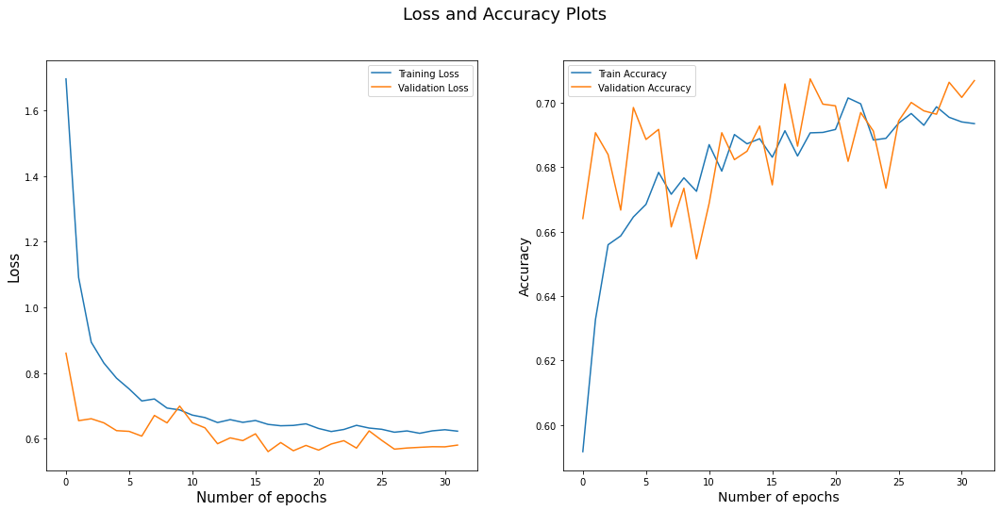

63/63 [==============================] - 4s 27ms/step
0.7195


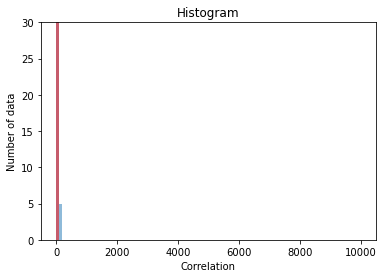

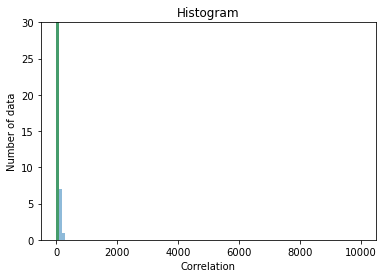

Model: "sequential_13"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_13 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


239/239 [==============================] - 17s 49ms/step - loss: 1.6589 - acc: 0.5920 - val_loss: 0.7968 - val_acc: 0.6606
Epoch 2/32
239/239 [==============================] - 9s 40ms/step - loss: 1.0593 - acc: 0.6362 - val_loss: 0.7576 - val_acc: 0.6689
Epoch 3/32
239/239 [==============================] - 10s 40ms/step - loss: 0.9231 - acc: 0.6493 - val_loss: 0.6764 - val_acc: 0.6747
Epoch 4/32
239/239 [==============================] - 9s 40ms/step - loss: 0.8370 - acc: 0.6571 - val_loss: 0.6248 - val_acc: 0.6878
Epoch 5/32
239/239 [==============================] - 10s 40ms/step - loss: 0.7656 - acc: 0.6626 - val_loss: 0.6458 - val_acc: 0.6909
Epoch 6/32
239/239 [==============================] - 10s 40ms/step - loss: 0.7583 - acc: 0.6589 - val_loss: 0.6008 - val_acc: 0.6930
Epoch 7/32
239/239 [==============================] - 10s 40ms/step - loss: 0.7045 - acc: 0.6741 - val_loss: 0.6619 - val_acc: 0.6684
Epoch 8/32
239/239 [==============================] - 10s 41ms/step - loss:

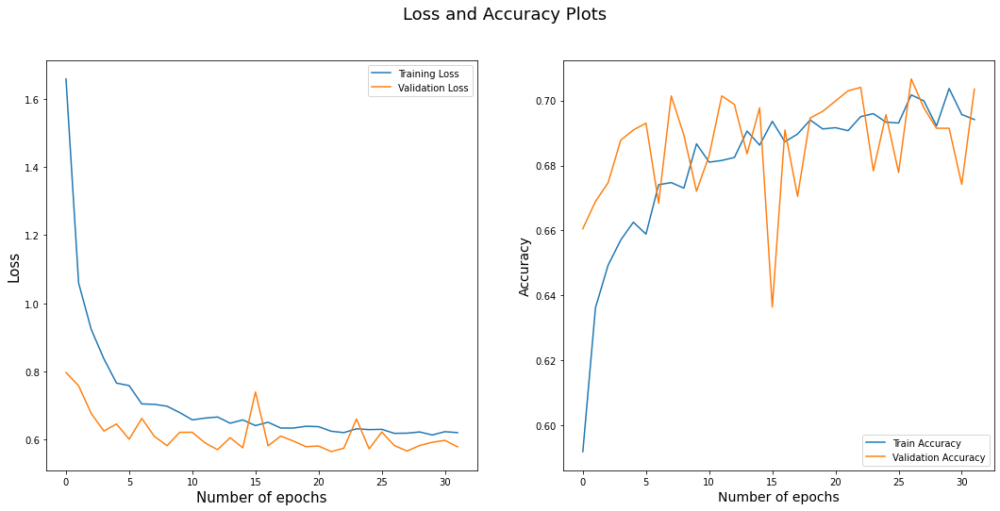

300/300 [==============================] - 8s 28ms/step
Round:  6
Test Accuracy:  0.708
Label Accuracy:  0.9858096828046744
Number of catagory 1:  4671.0
Number of catagory 2:  4913.0
Model: "sequential_14"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_14 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
___________________________________________________

/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


240/240 [==============================] - 16s 45ms/step - loss: 1.6864 - acc: 0.5974 - val_loss: 0.8400 - val_acc: 0.6521
Epoch 2/32
240/240 [==============================] - 9s 37ms/step - loss: 1.0718 - acc: 0.6403 - val_loss: 0.7081 - val_acc: 0.6828
Epoch 3/32
240/240 [==============================] - 9s 38ms/step - loss: 0.9268 - acc: 0.6523 - val_loss: 0.6672 - val_acc: 0.6734
Epoch 4/32
240/240 [==============================] - 9s 37ms/step - loss: 0.8215 - acc: 0.6651 - val_loss: 0.6343 - val_acc: 0.6896
Epoch 5/32
240/240 [==============================] - 9s 38ms/step - loss: 0.7910 - acc: 0.6604 - val_loss: 0.6414 - val_acc: 0.6750
Epoch 6/32
240/240 [==============================] - 9s 38ms/step - loss: 0.7329 - acc: 0.6661 - val_loss: 0.6106 - val_acc: 0.6839
Epoch 7/32
240/240 [==============================] - 9s 37ms/step - loss: 0.7136 - acc: 0.6798 - val_loss: 0.6252 - val_acc: 0.6792
Epoch 8/32
240/240 [==============================] - 9s 37ms/step - loss: 0.70

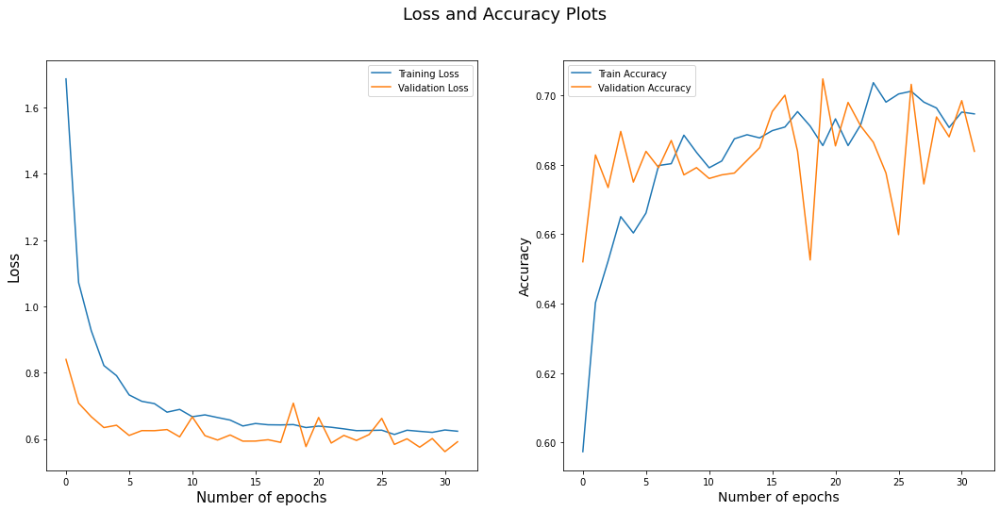

63/63 [==============================] - 3s 29ms/step
0.7185


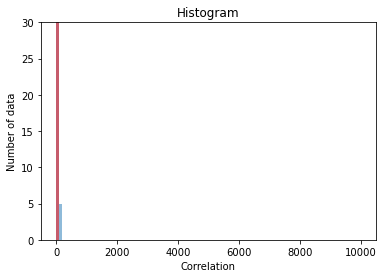

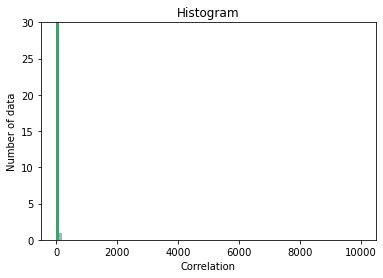

Model: "sequential_15"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_15 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


240/240 [==============================] - 16s 45ms/step - loss: 1.6934 - acc: 0.5921 - val_loss: 0.8133 - val_acc: 0.6681
Epoch 2/32
240/240 [==============================] - 9s 37ms/step - loss: 1.0672 - acc: 0.6334 - val_loss: 0.7007 - val_acc: 0.6963
Epoch 3/32
240/240 [==============================] - 9s 37ms/step - loss: 0.9034 - acc: 0.6562 - val_loss: 0.7279 - val_acc: 0.6581
Epoch 4/32
240/240 [==============================] - 9s 38ms/step - loss: 0.8311 - acc: 0.6585 - val_loss: 0.6354 - val_acc: 0.6832
Epoch 5/32
240/240 [==============================] - 9s 38ms/step - loss: 0.7827 - acc: 0.6568 - val_loss: 0.6249 - val_acc: 0.7026
Epoch 6/32
240/240 [==============================] - 9s 38ms/step - loss: 0.7513 - acc: 0.6708 - val_loss: 0.7054 - val_acc: 0.6461
Epoch 7/32
240/240 [==============================] - 9s 38ms/step - loss: 0.7750 - acc: 0.6606 - val_loss: 0.9689 - val_acc: 0.6079
Epoch 8/32
240/240 [==============================] - 9s 38ms/step - loss: 0.72

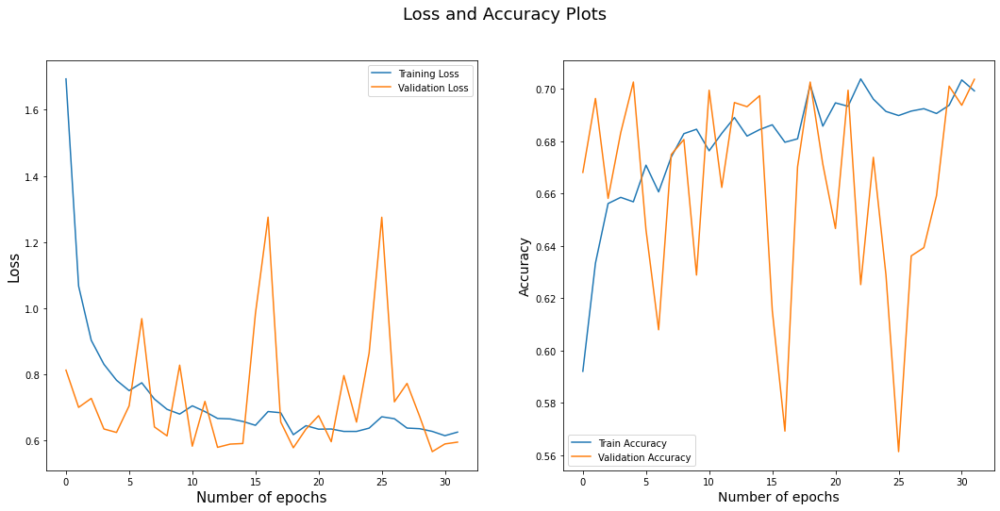

300/300 [==============================] - 8s 28ms/step
Round:  7
Test Accuracy:  0.6915
Label Accuracy:  0.985287979966611
Number of catagory 1:  4668.0
Number of catagory 2:  4916.0
Model: "sequential_16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_16 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
___________________________________________________

/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


240/240 [==============================] - 17s 51ms/step - loss: 1.6597 - acc: 0.5863 - val_loss: 0.8654 - val_acc: 0.6463
Epoch 2/32
240/240 [==============================] - 9s 38ms/step - loss: 1.0587 - acc: 0.6291 - val_loss: 0.6870 - val_acc: 0.6776
Epoch 3/32
240/240 [==============================] - 9s 38ms/step - loss: 0.8755 - acc: 0.6630 - val_loss: 0.6433 - val_acc: 0.6901
Epoch 4/32
240/240 [==============================] - 10s 40ms/step - loss: 0.8145 - acc: 0.6681 - val_loss: 0.6627 - val_acc: 0.6667
Epoch 5/32
240/240 [==============================] - 9s 38ms/step - loss: 0.7808 - acc: 0.6579 - val_loss: 0.6340 - val_acc: 0.6834
Epoch 6/32
240/240 [==============================] - 9s 38ms/step - loss: 0.7408 - acc: 0.6681 - val_loss: 0.6196 - val_acc: 0.6907
Epoch 7/32
240/240 [==============================] - 9s 37ms/step - loss: 0.7238 - acc: 0.6742 - val_loss: 0.6226 - val_acc: 0.6708
Epoch 8/32
240/240 [==============================] - 9s 38ms/step - loss: 0.7

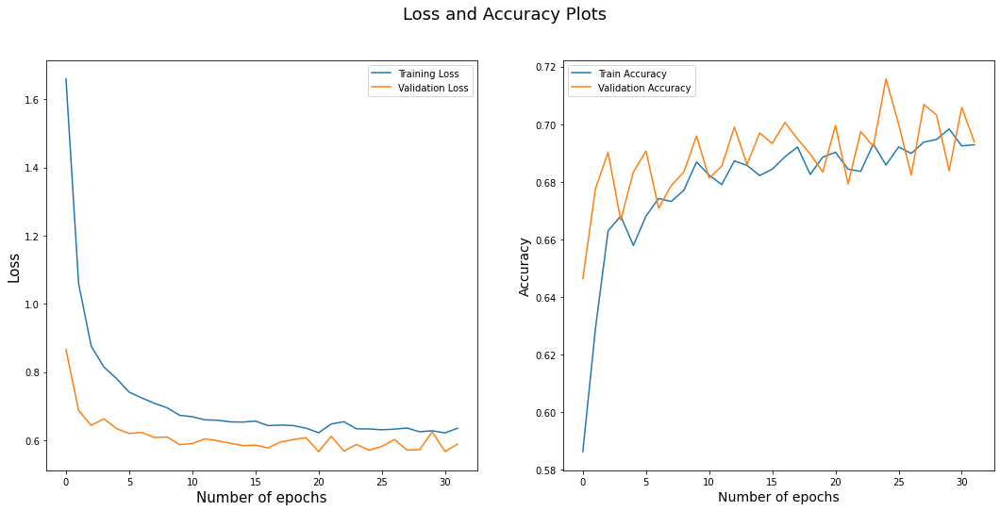

63/63 [==============================] - 4s 28ms/step
0.712


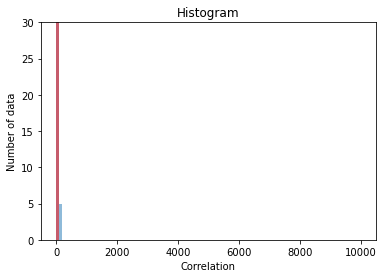

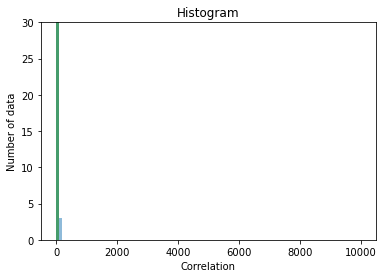

Model: "sequential_17"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_17 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


240/240 [==============================] - 17s 48ms/step - loss: 1.7097 - acc: 0.5829 - val_loss: 0.8011 - val_acc: 0.6517
Epoch 2/32
240/240 [==============================] - 9s 38ms/step - loss: 1.0647 - acc: 0.6406 - val_loss: 0.7431 - val_acc: 0.6789
Epoch 3/32
240/240 [==============================] - 9s 38ms/step - loss: 0.9038 - acc: 0.6569 - val_loss: 0.8199 - val_acc: 0.6480
Epoch 4/32
240/240 [==============================] - 9s 38ms/step - loss: 0.8526 - acc: 0.6557 - val_loss: 0.6867 - val_acc: 0.6648
Epoch 5/32
240/240 [==============================] - 9s 38ms/step - loss: 0.7866 - acc: 0.6591 - val_loss: 0.6231 - val_acc: 0.6940
Epoch 6/32
240/240 [==============================] - 9s 39ms/step - loss: 0.7425 - acc: 0.6687 - val_loss: 0.6094 - val_acc: 0.6883
Epoch 7/32
240/240 [==============================] - 10s 40ms/step - loss: 0.7160 - acc: 0.6662 - val_loss: 0.5886 - val_acc: 0.6919
Epoch 8/32
240/240 [==============================] - 9s 39ms/step - loss: 0.7

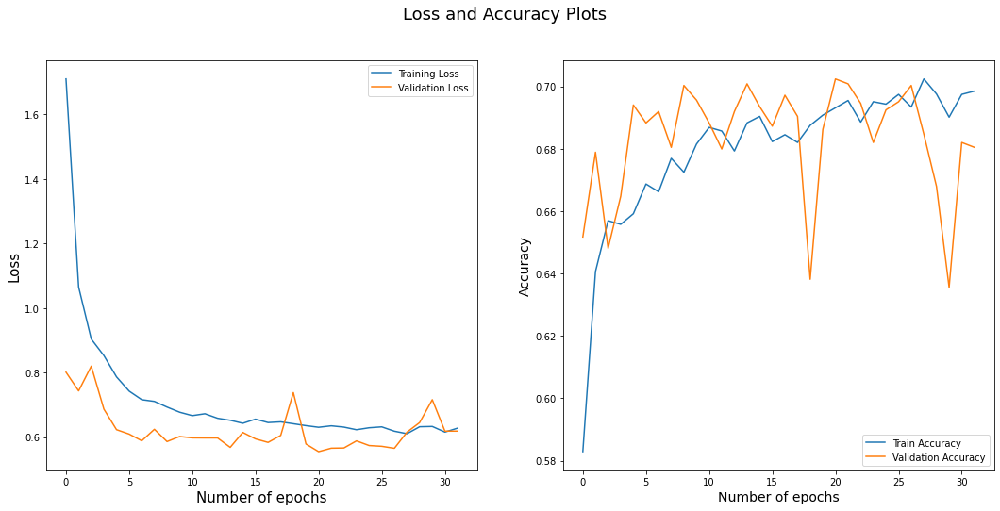

300/300 [==============================] - 9s 29ms/step
Round:  8
Test Accuracy:  0.6795
Label Accuracy:  0.9851836393989983
Number of catagory 1:  4669.0
Number of catagory 2:  4915.0
Model: "sequential_18"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_18 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
__________________________________________________

/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


240/240 [==============================] - 17s 46ms/step - loss: 1.6934 - acc: 0.5899 - val_loss: 0.8035 - val_acc: 0.6609
Epoch 2/32
240/240 [==============================] - 9s 37ms/step - loss: 1.0645 - acc: 0.6369 - val_loss: 0.7303 - val_acc: 0.6750
Epoch 3/32
240/240 [==============================] - 9s 38ms/step - loss: 0.9263 - acc: 0.6446 - val_loss: 0.6521 - val_acc: 0.6802
Epoch 4/32
240/240 [==============================] - 9s 38ms/step - loss: 0.8283 - acc: 0.6585 - val_loss: 0.6129 - val_acc: 0.6948
Epoch 5/32
240/240 [==============================] - 9s 37ms/step - loss: 0.7790 - acc: 0.6631 - val_loss: 0.6140 - val_acc: 0.6907
Epoch 6/32
240/240 [==============================] - 9s 37ms/step - loss: 0.7449 - acc: 0.6669 - val_loss: 0.5912 - val_acc: 0.7068
Epoch 7/32
240/240 [==============================] - 9s 37ms/step - loss: 0.7218 - acc: 0.6674 - val_loss: 0.5729 - val_acc: 0.6927
Epoch 8/32
240/240 [==============================] - 9s 37ms/step - loss: 0.69

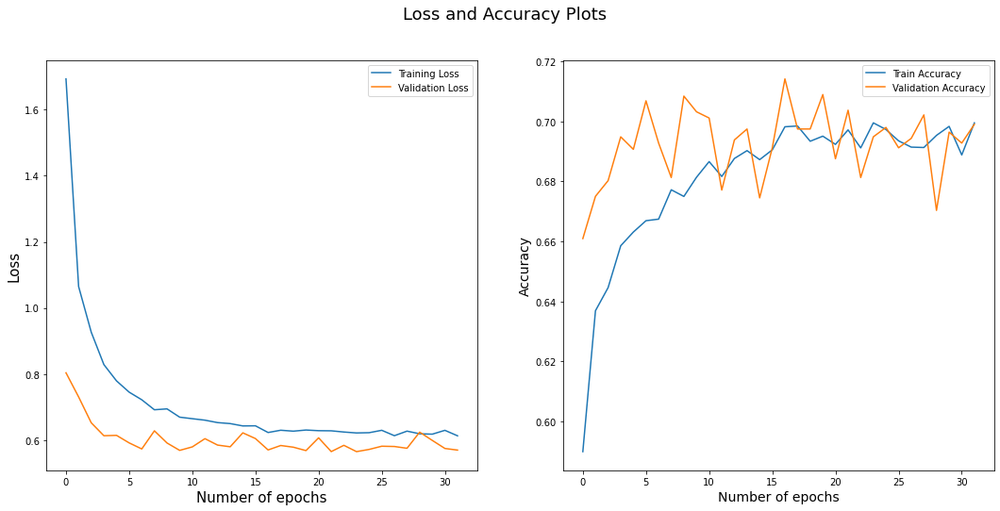

63/63 [==============================] - 4s 31ms/step
0.723


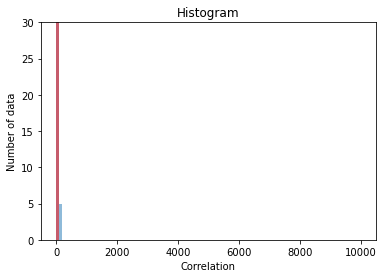

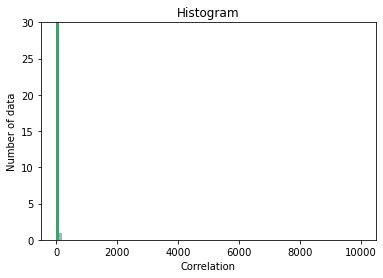

Model: "sequential_19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_19 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


240/240 [==============================] - 17s 49ms/step - loss: 1.7046 - acc: 0.5803 - val_loss: 0.7918 - val_acc: 0.6550
Epoch 2/32
240/240 [==============================] - 10s 40ms/step - loss: 1.0836 - acc: 0.6342 - val_loss: 0.6946 - val_acc: 0.6670
Epoch 3/32
240/240 [==============================] - 9s 38ms/step - loss: 0.9032 - acc: 0.6550 - val_loss: 0.6852 - val_acc: 0.6816
Epoch 4/32
240/240 [==============================] - 9s 39ms/step - loss: 0.8538 - acc: 0.6499 - val_loss: 0.6547 - val_acc: 0.6785
Epoch 5/32
240/240 [==============================] - 9s 39ms/step - loss: 0.7571 - acc: 0.6713 - val_loss: 0.6217 - val_acc: 0.6884
Epoch 6/32
240/240 [==============================] - 9s 38ms/step - loss: 0.7500 - acc: 0.6674 - val_loss: 0.6106 - val_acc: 0.6868
Epoch 7/32
240/240 [==============================] - 9s 37ms/step - loss: 0.7119 - acc: 0.6774 - val_loss: 0.5921 - val_acc: 0.6889
Epoch 8/32
240/240 [==============================] - 9s 38ms/step - loss: 0.7

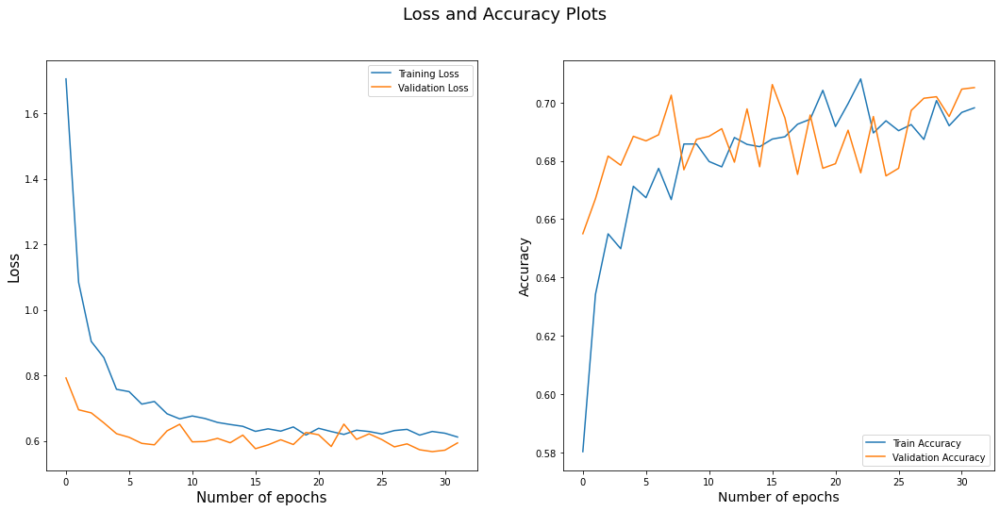

300/300 [==============================] - 9s 30ms/step
Round:  9
Test Accuracy:  0.716
Label Accuracy:  0.9845575959933222
Number of catagory 1:  4663.0
Number of catagory 2:  4921.0
Model: "sequential_20"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_20 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
___________________________________________________

/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


240/240 [==============================] - 17s 46ms/step - loss: 1.7076 - acc: 0.5850 - val_loss: 0.8344 - val_acc: 0.6588
Epoch 2/32
240/240 [==============================] - 9s 39ms/step - loss: 1.0806 - acc: 0.6351 - val_loss: 0.7305 - val_acc: 0.6693
Epoch 3/32
240/240 [==============================] - 9s 38ms/step - loss: 0.8894 - acc: 0.6559 - val_loss: 0.6586 - val_acc: 0.6922
Epoch 4/32
240/240 [==============================] - 9s 39ms/step - loss: 0.8246 - acc: 0.6622 - val_loss: 0.6363 - val_acc: 0.6844
Epoch 5/32
240/240 [==============================] - 10s 40ms/step - loss: 0.7689 - acc: 0.6696 - val_loss: 0.6438 - val_acc: 0.6844
Epoch 6/32
240/240 [==============================] - 9s 39ms/step - loss: 0.7215 - acc: 0.6769 - val_loss: 0.6078 - val_acc: 0.6865
Epoch 7/32
240/240 [==============================] - 9s 38ms/step - loss: 0.7202 - acc: 0.6729 - val_loss: 0.6320 - val_acc: 0.6881
Epoch 8/32
240/240 [==============================] - 9s 38ms/step - loss: 0.6

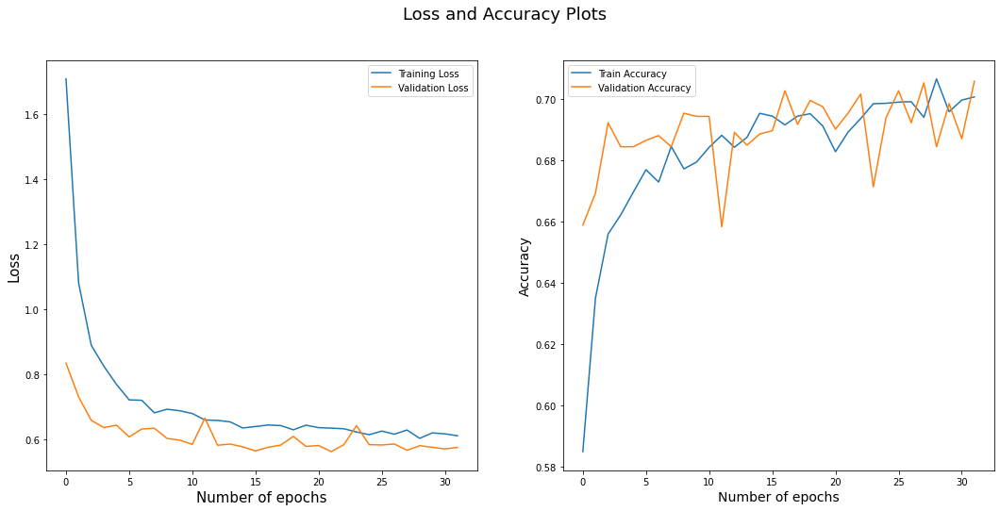

63/63 [==============================] - 3s 26ms/step
0.7095


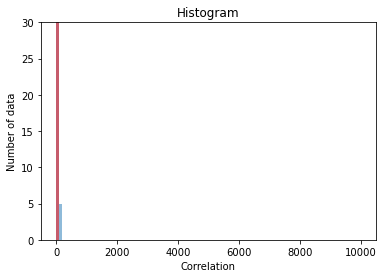

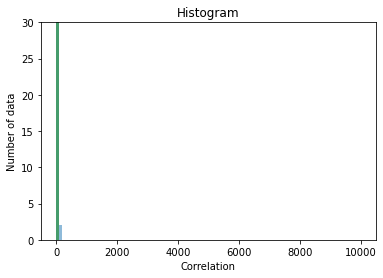

Model: "sequential_21"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_21 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


240/240 [==============================] - 16s 46ms/step - loss: 1.6019 - acc: 0.5988 - val_loss: 0.9071 - val_acc: 0.6623
Epoch 2/32
240/240 [==============================] - 9s 38ms/step - loss: 1.0548 - acc: 0.6404 - val_loss: 0.7803 - val_acc: 0.6675
Epoch 3/32
240/240 [==============================] - 9s 39ms/step - loss: 0.8938 - acc: 0.6557 - val_loss: 0.6687 - val_acc: 0.6806
Epoch 4/32
240/240 [==============================] - 9s 39ms/step - loss: 0.8248 - acc: 0.6614 - val_loss: 0.6381 - val_acc: 0.6759
Epoch 5/32
240/240 [==============================] - 9s 38ms/step - loss: 0.7737 - acc: 0.6682 - val_loss: 0.6401 - val_acc: 0.6743
Epoch 6/32
240/240 [==============================] - 9s 38ms/step - loss: 0.7341 - acc: 0.6705 - val_loss: 0.6185 - val_acc: 0.6827
Epoch 7/32
240/240 [==============================] - 9s 38ms/step - loss: 0.7136 - acc: 0.6763 - val_loss: 0.6282 - val_acc: 0.6889
Epoch 8/32
240/240 [==============================] - 9s 39ms/step - loss: 0.69

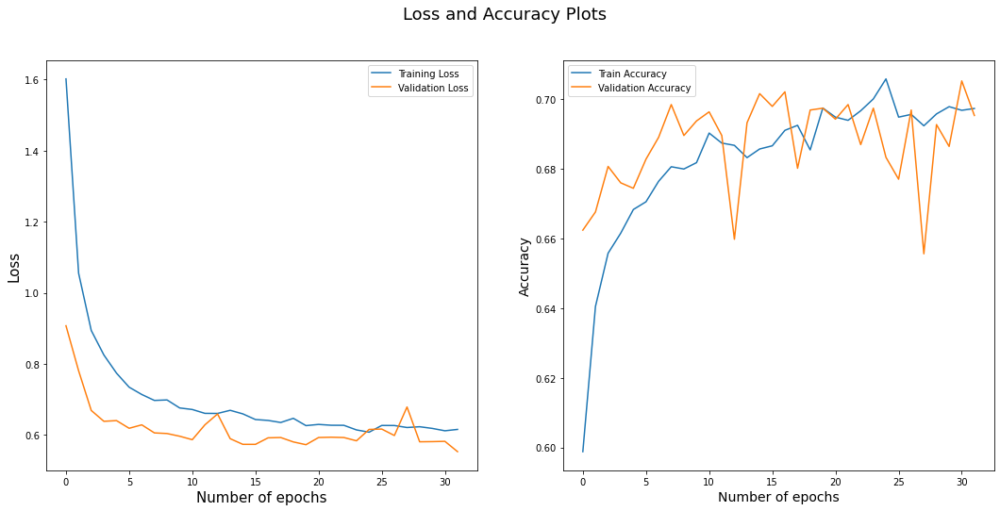

300/300 [==============================] - 9s 30ms/step
Round:  10
Test Accuracy:  0.712
Label Accuracy:  0.9845575959933222
Number of catagory 1:  4663.0
Number of catagory 2:  4921.0


In [7]:
noise_label = torch.load('./data/CIFAR-10_human.pt')
clean_label = noise_label['clean_label']
worst_label = noise_label['worse_label']
aggre_label = noise_label['aggre_label']
random_label1 = noise_label['random_label1']
random_label2 = noise_label['random_label2']
random_label3 = noise_label['random_label3']

train_dataset,test_dataset,num_classes,num_training_samples = input_dataset('cifar10', 'clean', './data/CIFAR-10_human.pt', True)
X_c = train_dataset.train_data
y_c = aggre_label
X_test_c = test_dataset.test_data
y_test_c = test_dataset.test_labels

fine_label_list = ['airplane', 'automobile', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck']

def label_shiftting(y, p = 0.2):
    L0 = np.where(y == 0)[0]
    L1 = np.where(y == 1)[0]
    A0 = np.random.choice(500, size=int(500*p), replace=False)
    A1 = np.random.choice(500, size=int(500*p), replace=False)
    y[L0[A0]] = 1
    y[L1[A1]] = 0
    return y, L0[A0], L1[A1]
 
X = []
y = []
for i,x in enumerate(X_c):
    if fine_label_list[y_c[i]] == 'cat':
        X.append(x)
        y.append(0)
    elif fine_label_list[y_c[i]] == 'dog':
        X.append(x)
        y.append(1)
        
X_test = []
y_test = []
for i,x in enumerate(X_test_c):
    if fine_label_list[y_test_c[i]] == 'cat':
        X_test.append(x)
        y_test.append(0)
    elif fine_label_list[y_test_c[i]] == 'dog':
        X_test.append(x)
        y_test.append(1)

X = np.array(X)
y = np.array(y)
# y_shifted, L01, L10 = label_shiftting(y.copy(), p = 0.2)
y_shifted = to_categorical(y.copy(), 2)

X_test = np.array(X_test)
y_test = np.array(y_test)

#---Train---
from tensorflow.compat.v1.keras.applications import ResNet101

res = ResNet101(weights='imagenet', include_top = False, classes = 2, input_shape=(32,32,3))

Label_Accuracy = []
Test_Accuracy = []
Test_Accurracy_0 = []

Rounds = 11


for Round in range(Rounds):
    model = Sequential()
    
    model.add(res)
    # model.add(GlobalAveragePooling2D(name='penultimate'))
    model.add(Flatten(name='penultimate'))
    
    model.add(Dropout(0.5))
    model.add(Dense(2, activation = 'softmax', name='dense'))
    res.trainable = False
    model.summary()
    
    lr = 1e-4
    sgd = SGD(lr = lr, momentum = 0.9, nesterov = True)
    model.compile(loss = 'categorical_crossentropy', optimizer = sgd, metrics = ['acc'])
    
    hist = model.fit(x=X, y=y_shifted, batch_size=32, epochs=32, verbose=1, callbacks=None, validation_split=0.2, validation_data=None, shuffle=True, class_weight=None, sample_weight=None, initial_epoch=0, steps_per_epoch=None, validation_steps=None)
    
    
    
    plt.figure(figsize=(18,8))
    
    plt.suptitle('Loss and Accuracy Plots', fontsize=18)
    
    plt.subplot(1,2,1)
    plt.plot(hist.history['loss'], label='Training Loss')
    plt.plot(hist.history['val_loss'], label='Validation Loss')
    plt.legend()
    plt.xlabel('Number of epochs', fontsize=15)
    plt.ylabel('Loss', fontsize=15)
    
    plt.subplot(1,2,2)
    plt.plot(hist.history['acc'], label='Train Accuracy')
    plt.plot(hist.history['val_acc'], label='Validation Accuracy')
    plt.legend()
    plt.xlabel('Number of epochs', fontsize=14)
    plt.ylabel('Accuracy', fontsize=14)
    plt.show()
    
    
    y_pred = model.predict(X_test, verbose=1)
    y_pred = np.argmax(y_pred, axis = 1)
    print(accuracy_score(y_test, y_pred))
    Test_Accurracy_0.append(accuracy_score(y_test, y_pred))
    
    sub_model = tf.keras.Model(inputs = model.input, outputs = model.get_layer('penultimate').output)
    R = sub_model.predict(X)
    
    preserved_index = []
    relabel_index = []
    
    T_index = [-1 for i in range(len(R))]
    for catagory in [0, 1]:
        R_c = R[y_shifted[:,catagory] == 1]
        R_hat = np.average(R_c, axis=0)
        M = R_c.copy()
        for i in range(len(M)):
            M[i] -= R_hat
        u, s, vh = np.linalg.svd(M, full_matrices=True)
        v = vh[0]
        
        T = []
        T00 = []
        T01 = []
        T10 = []
        for i, r in enumerate(R):
            if y_shifted[i, catagory] == 1:
                T.append((np.dot((r-R_hat), v)**2))
                T_index[i] = len(T)-1
                
                if (y_shifted[i] == to_categorical(y, 2)[i]).all():
                    T00.append((np.dot((r-R_hat), v)**2))
                elif y_shifted[i][0] == 1:
                    T01.append((np.dot((r-R_hat), v)**2))
                elif y_shifted[i][0] == 0:
                    T10.append((np.dot((r-R_hat), v)**2))
        
        bins = np.linspace(0, 10000, 100)
        n, bins, patches=plt.hist(T00,alpha = 0.5,bins=bins)
        n, bins, patches=plt.hist(T01,bins=bins,alpha = 0.5,color='red')
        n, bins, patches=plt.hist(T10,bins=bins,alpha = 0.5,color='green')
        plt.ylim(0, 30)
        plt.xlabel("Correlation")
        plt.ylabel("Number of data")
        plt.title("Histogram")
        plt.show()
    
        S = sorted(range(len(T)), key=lambda k: T[k])
        # d = T[S[int(len(M) * (1 - 0.25 * (1 - (Round / Rounds))))]]
        d = T[S[int(len(M) * (1 - 0.25 * 0.5**Round))-1]]
        # rl = T[S[int(len(M) * (1 - 0.5**Round))]]
        # d = T[S[int(len(M) * (1 - 0.25))]]
        # rl = T[S[int(500*(1-0.1))]]
        for i, r in enumerate(R):
            if y_shifted[i, catagory] == 1 and T[T_index[i]] < d:
                preserved_index.append(i)
            # if y_shifted[i, catagory] == 1 and T[T_index[i]] >= rl:
            #     relabel_index.append(i)
                
    
    preserved_index.sort()
    relabel_index.sort()
    X_p = X[preserved_index]
    y_p = y_shifted.copy()
    y_p = y_p[preserved_index]
    
    
    
    model = Sequential()
    model.add(res)
    # model.add(GlobalAveragePooling2D(name='GAP'))
    model.add(Flatten(name='FC'))
    
    model.add(Dropout(0.5))
    model.add(Dense(2, activation = 'softmax', name='dense'))
    res.trainable = False
    model.summary()
    
    lr = 1e-4
    sgd = SGD(lr = lr, momentum = 0.9, nesterov = True)
    model.compile(loss = 'categorical_crossentropy', optimizer = sgd, metrics = ['acc'])
    
    hist = model.fit(x=X_p, y=y_p, batch_size=32, epochs=32, verbose=1, callbacks=None, validation_split=0.2, validation_data=None, shuffle=True, class_weight=None, sample_weight=None, initial_epoch=0, steps_per_epoch=None, validation_steps=None)
    
    plt.figure(figsize=(18,8))
    
    plt.suptitle('Loss and Accuracy Plots', fontsize=18)
    
    plt.subplot(1,2,1)
    plt.plot(hist.history['loss'], label='Training Loss')
    plt.plot(hist.history['val_loss'], label='Validation Loss')
    plt.legend()
    plt.xlabel('Number of epochs', fontsize=15)
    plt.ylabel('Loss', fontsize=15)
    
    plt.subplot(1,2,2)
    plt.plot(hist.history['acc'], label='Train Accuracy')
    plt.plot(hist.history['val_acc'], label='Validation Accuracy')
    plt.legend()
    plt.xlabel('Number of epochs', fontsize=14)
    plt.ylabel('Accuracy', fontsize=14)
    plt.show()
    
    y_pred = model.predict(X_test, verbose=1)
    y_pred = np.argmax(y_pred, axis = 1)
    
    y_new_pred = model.predict(X, verbose=1)
    y_new = np.argmax(y_new_pred, axis = 1)
    
    # for i in relabel_index:
    for i in range(len(X)):
        if max(y_new_pred[i]) > 0.99: 
            y_shifted[i] = to_categorical(y_new, 2)[i]
    
    print('Round: ', Round)
    print('Test Accuracy: ', accuracy_score(y_test, y_pred))
    print('Label Accuracy: ', accuracy_score(y, y_shifted[:,1]))
    print('Number of catagory 1: ', np.sum(y_shifted[:,0]))
    print('Number of catagory 2: ', np.sum(y_shifted[:,1]))
    Label_Accuracy.append(accuracy_score(y, y_shifted[:,1]))
    Test_Accuracy.append(accuracy_score(y_test, y_pred))

Files already downloaded and verified
Model: "sequential_22"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_22 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


259/259 [==============================] - 17s 46ms/step - loss: 1.7441 - acc: 0.5376 - val_loss: 1.0091 - val_acc: 0.5462
Epoch 2/32
259/259 [==============================] - 10s 39ms/step - loss: 1.1994 - acc: 0.5487 - val_loss: 0.8658 - val_acc: 0.5645
Epoch 3/32
259/259 [==============================] - 10s 38ms/step - loss: 1.0677 - acc: 0.5623 - val_loss: 0.8241 - val_acc: 0.5636
Epoch 4/32
259/259 [==============================] - 10s 39ms/step - loss: 0.9821 - acc: 0.5548 - val_loss: 0.8863 - val_acc: 0.5408
Epoch 5/32
259/259 [==============================] - 10s 38ms/step - loss: 0.8987 - acc: 0.5690 - val_loss: 0.7331 - val_acc: 0.5863
Epoch 6/32
259/259 [==============================] - 10s 39ms/step - loss: 0.8850 - acc: 0.5707 - val_loss: 0.7365 - val_acc: 0.5882
Epoch 7/32
259/259 [==============================] - 10s 39ms/step - loss: 0.8652 - acc: 0.5817 - val_loss: 0.7505 - val_acc: 0.5877
Epoch 8/32
259/259 [==============================] - 10s 39ms/step - los

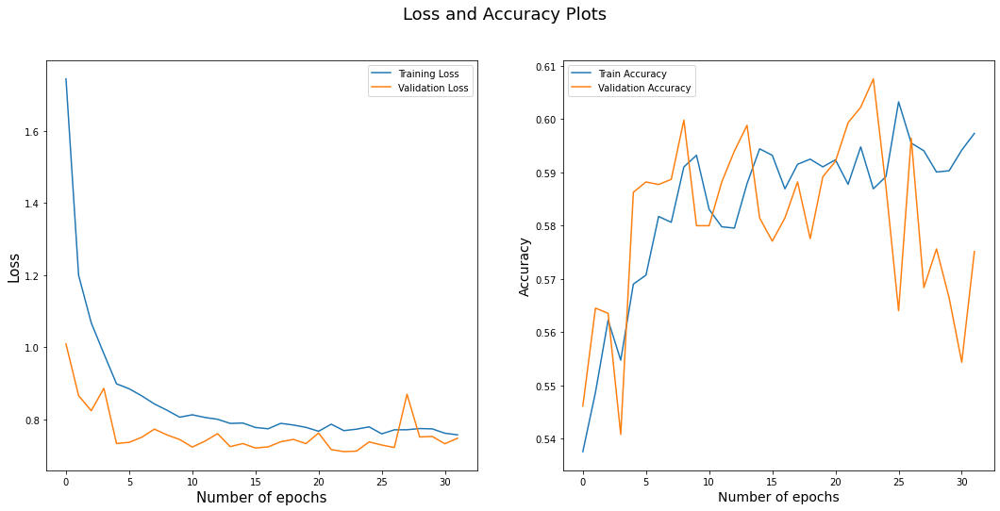

63/63 [==============================] - 4s 30ms/step
0.666


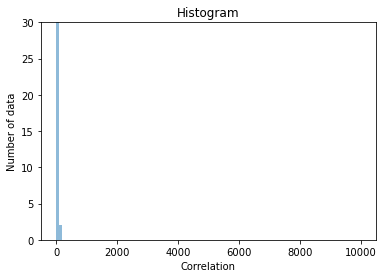

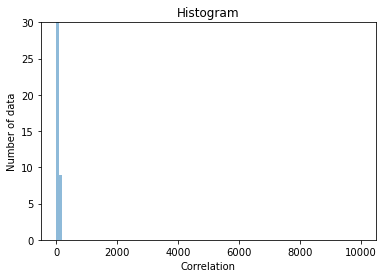

Model: "sequential_23"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_23 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


194/194 [==============================] - 16s 51ms/step - loss: 1.8675 - acc: 0.5432 - val_loss: 0.9785 - val_acc: 0.5893
Epoch 2/32
194/194 [==============================] - 8s 39ms/step - loss: 1.2555 - acc: 0.5729 - val_loss: 0.8881 - val_acc: 0.5887
Epoch 3/32
194/194 [==============================] - 8s 39ms/step - loss: 1.0833 - acc: 0.5743 - val_loss: 0.8462 - val_acc: 0.6228
Epoch 4/32
194/194 [==============================] - 7s 39ms/step - loss: 0.9833 - acc: 0.5858 - val_loss: 0.8314 - val_acc: 0.6080
Epoch 5/32
194/194 [==============================] - 8s 39ms/step - loss: 0.8965 - acc: 0.6045 - val_loss: 0.7481 - val_acc: 0.6228
Epoch 6/32
194/194 [==============================] - 8s 40ms/step - loss: 0.8838 - acc: 0.5990 - val_loss: 0.7382 - val_acc: 0.6273
Epoch 7/32
194/194 [==============================] - 8s 39ms/step - loss: 0.8453 - acc: 0.6101 - val_loss: 0.7501 - val_acc: 0.6190
Epoch 8/32
194/194 [==============================] - 7s 39ms/step - loss: 0.81

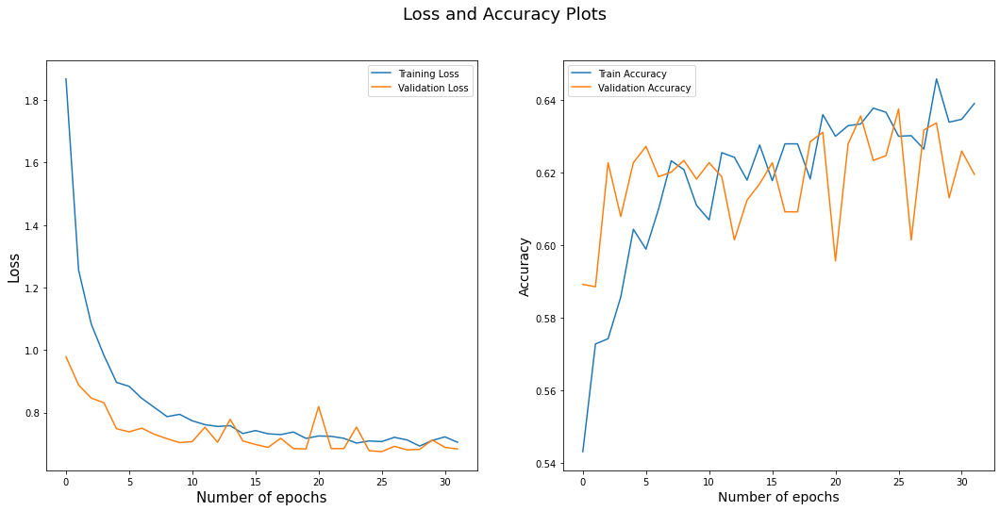

324/324 [==============================] - 10s 30ms/step
Round:  0
Test Accuracy:  0.6015
Label Accuracy:  0.9977758437288463
Number of catagory 1:  4664.0
Number of catagory 2:  5677.0
Model: "sequential_24"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_24 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________

/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


259/259 [==============================] - 18s 48ms/step - loss: 1.8640 - acc: 0.5355 - val_loss: 0.9590 - val_acc: 0.5495
Epoch 2/32
259/259 [==============================] - 10s 39ms/step - loss: 1.2462 - acc: 0.5492 - val_loss: 0.8345 - val_acc: 0.5660
Epoch 3/32
259/259 [==============================] - 10s 38ms/step - loss: 1.0399 - acc: 0.5626 - val_loss: 0.9137 - val_acc: 0.5674
Epoch 4/32
259/259 [==============================] - 10s 40ms/step - loss: 1.0039 - acc: 0.5589 - val_loss: 0.7872 - val_acc: 0.5723
Epoch 5/32
259/259 [==============================] - 10s 40ms/step - loss: 0.9160 - acc: 0.5789 - val_loss: 0.7508 - val_acc: 0.5916
Epoch 6/32
259/259 [==============================] - 10s 40ms/step - loss: 0.8837 - acc: 0.5768 - val_loss: 0.8273 - val_acc: 0.5452
Epoch 7/32
259/259 [==============================] - 10s 39ms/step - loss: 0.8489 - acc: 0.5823 - val_loss: 0.7410 - val_acc: 0.5781
Epoch 8/32
259/259 [==============================] - 10s 39ms/step - los

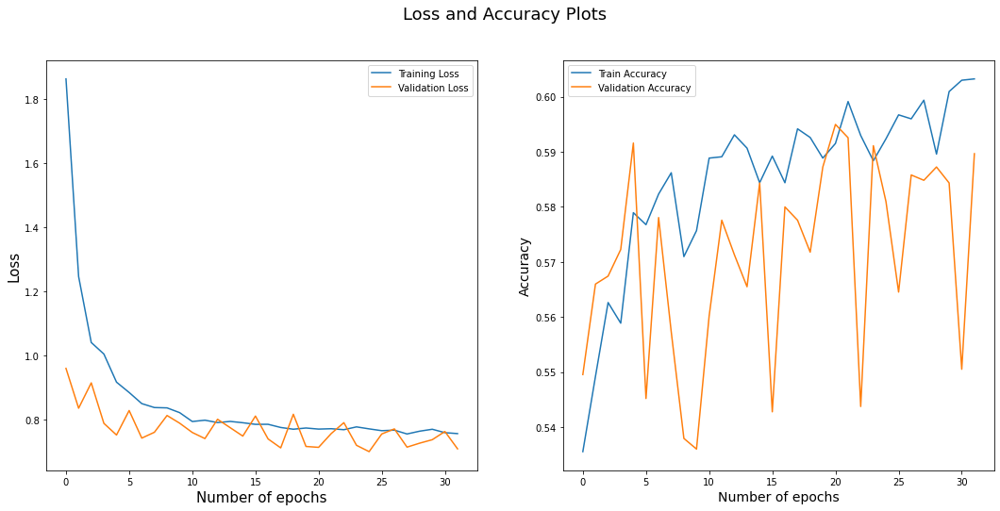

63/63 [==============================] - 3s 27ms/step
0.651


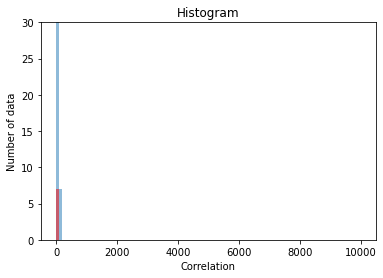

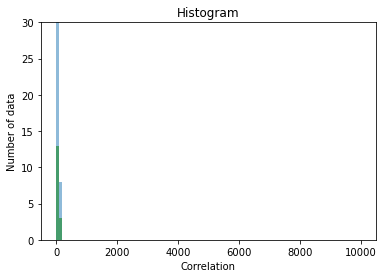

Model: "sequential_25"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_25 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


227/227 [==============================] - 16s 50ms/step - loss: 1.8858 - acc: 0.5247 - val_loss: 0.9553 - val_acc: 0.5702
Epoch 2/32
227/227 [==============================] - 9s 39ms/step - loss: 1.2214 - acc: 0.5645 - val_loss: 0.8462 - val_acc: 0.5829
Epoch 3/32
227/227 [==============================] - 9s 38ms/step - loss: 1.0614 - acc: 0.5684 - val_loss: 0.8002 - val_acc: 0.5912
Epoch 4/32
227/227 [==============================] - 9s 38ms/step - loss: 0.9583 - acc: 0.5771 - val_loss: 0.8684 - val_acc: 0.5696
Epoch 5/32
227/227 [==============================] - 9s 39ms/step - loss: 0.9326 - acc: 0.5763 - val_loss: 0.7816 - val_acc: 0.5845
Epoch 6/32
227/227 [==============================] - 9s 39ms/step - loss: 0.8780 - acc: 0.5799 - val_loss: 0.7462 - val_acc: 0.5994
Epoch 7/32
227/227 [==============================] - 9s 38ms/step - loss: 0.8312 - acc: 0.5923 - val_loss: 0.8136 - val_acc: 0.5873
Epoch 8/32
227/227 [==============================] - 9s 39ms/step - loss: 0.83

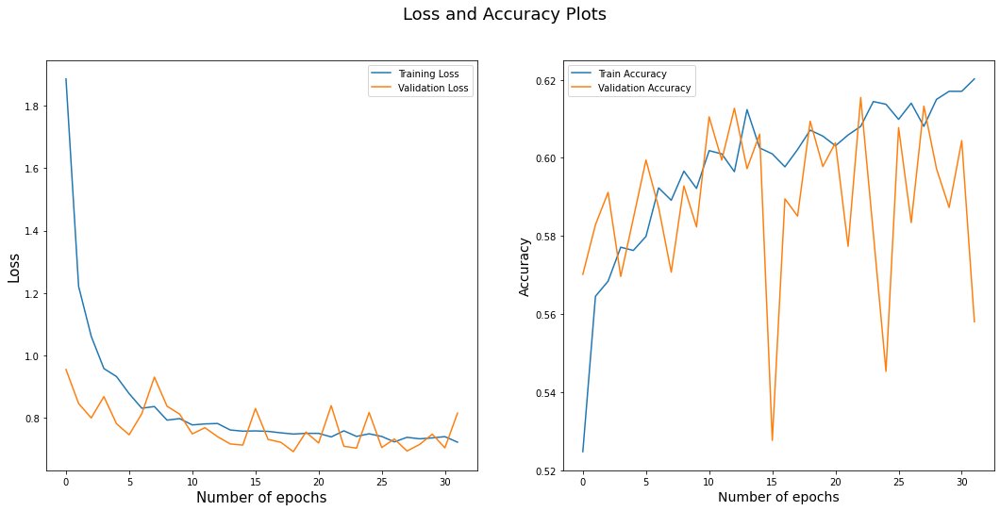

324/324 [==============================] - 10s 30ms/step
Round:  1
Test Accuracy:  0.5905
Label Accuracy:  0.9949714727782613
Number of catagory 1:  4693.0
Number of catagory 2:  5648.0
Model: "sequential_26"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_26 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________

/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


259/259 [==============================] - 16s 46ms/step - loss: 1.7909 - acc: 0.5427 - val_loss: 0.9693 - val_acc: 0.5747
Epoch 2/32
259/259 [==============================] - 10s 40ms/step - loss: 1.2076 - acc: 0.5607 - val_loss: 0.8706 - val_acc: 0.5631
Epoch 3/32
259/259 [==============================] - 10s 40ms/step - loss: 1.0543 - acc: 0.5607 - val_loss: 0.8048 - val_acc: 0.5689
Epoch 4/32
259/259 [==============================] - 10s 40ms/step - loss: 0.9555 - acc: 0.5693 - val_loss: 0.8535 - val_acc: 0.5578
Epoch 5/32
259/259 [==============================] - 10s 40ms/step - loss: 0.9093 - acc: 0.5788 - val_loss: 0.8083 - val_acc: 0.5520
Epoch 6/32
259/259 [==============================] - 10s 40ms/step - loss: 0.8953 - acc: 0.5682 - val_loss: 0.7597 - val_acc: 0.5761
Epoch 7/32
259/259 [==============================] - 10s 39ms/step - loss: 0.8444 - acc: 0.5774 - val_loss: 0.8938 - val_acc: 0.5616
Epoch 8/32
259/259 [==============================] - 10s 40ms/step - los

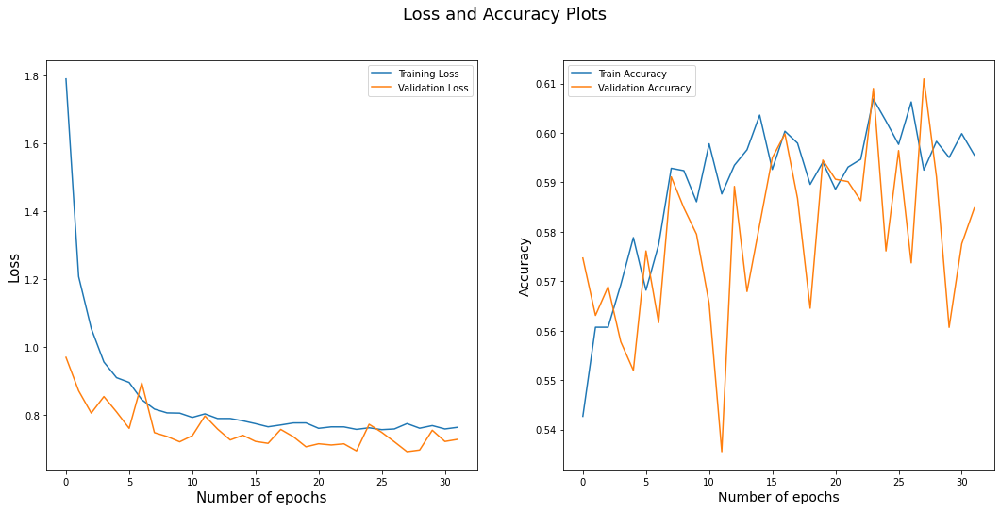

63/63 [==============================] - 5s 30ms/step
0.6645


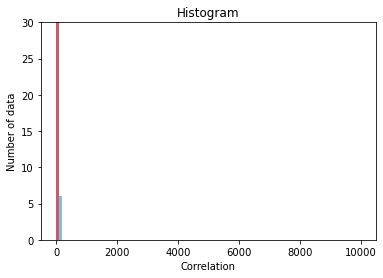

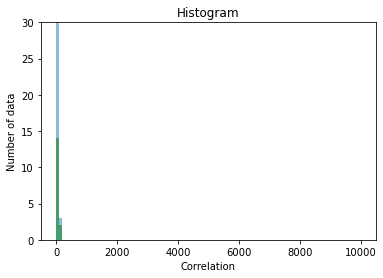

Model: "sequential_27"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_27 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


243/243 [==============================] - 17s 47ms/step - loss: 1.8286 - acc: 0.5295 - val_loss: 0.9186 - val_acc: 0.5431
Epoch 2/32
243/243 [==============================] - 10s 40ms/step - loss: 1.2373 - acc: 0.5550 - val_loss: 1.1017 - val_acc: 0.5235
Epoch 3/32
243/243 [==============================] - 9s 39ms/step - loss: 1.0846 - acc: 0.5644 - val_loss: 0.9174 - val_acc: 0.5395
Epoch 4/32
243/243 [==============================] - 10s 40ms/step - loss: 0.9696 - acc: 0.5713 - val_loss: 0.8028 - val_acc: 0.5802
Epoch 5/32
243/243 [==============================] - 10s 40ms/step - loss: 0.9237 - acc: 0.5737 - val_loss: 0.8460 - val_acc: 0.5591
Epoch 6/32
243/243 [==============================] - 10s 40ms/step - loss: 0.8954 - acc: 0.5728 - val_loss: 0.7466 - val_acc: 0.5895
Epoch 7/32
243/243 [==============================] - 10s 39ms/step - loss: 0.8693 - acc: 0.5795 - val_loss: 0.7212 - val_acc: 0.6060
Epoch 8/32
243/243 [==============================] - 10s 40ms/step - loss

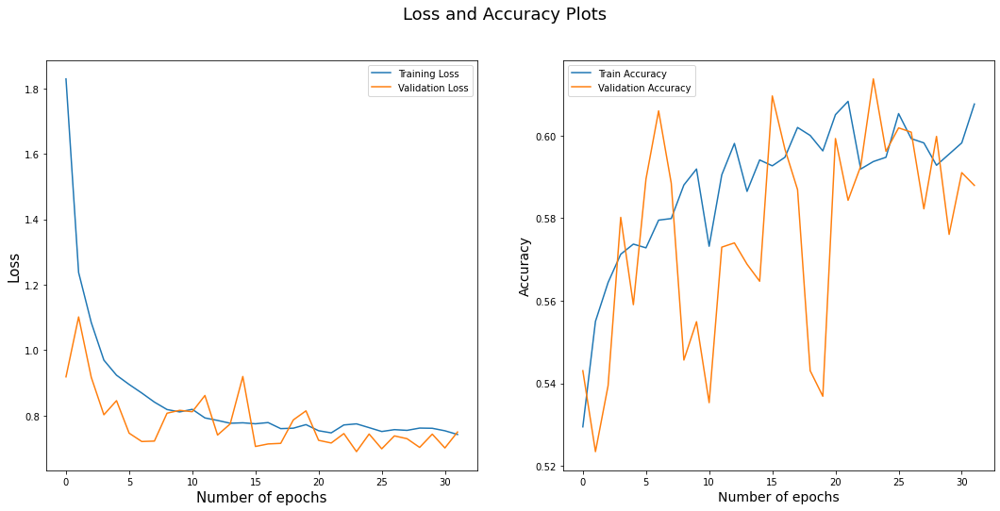

324/324 [==============================] - 10s 31ms/step
Round:  2
Test Accuracy:  0.616
Label Accuracy:  0.9947780678851175
Number of catagory 1:  4693.0
Number of catagory 2:  5648.0
Model: "sequential_28"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_28 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
__________________________________________________

/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


259/259 [==============================] - 17s 46ms/step - loss: 1.8076 - acc: 0.5354 - val_loss: 1.0306 - val_acc: 0.5694
Epoch 2/32
259/259 [==============================] - 10s 38ms/step - loss: 1.2482 - acc: 0.5589 - val_loss: 0.8397 - val_acc: 0.5800
Epoch 3/32
259/259 [==============================] - 10s 38ms/step - loss: 1.0457 - acc: 0.5678 - val_loss: 0.8118 - val_acc: 0.5848
Epoch 4/32
259/259 [==============================] - 10s 40ms/step - loss: 0.9701 - acc: 0.5666 - val_loss: 0.8014 - val_acc: 0.5882
Epoch 5/32
259/259 [==============================] - 11s 41ms/step - loss: 0.9058 - acc: 0.5765 - val_loss: 0.8417 - val_acc: 0.5790
Epoch 6/32
259/259 [==============================] - 11s 41ms/step - loss: 0.8760 - acc: 0.5794 - val_loss: 0.7672 - val_acc: 0.5993
Epoch 7/32
259/259 [==============================] - 11s 42ms/step - loss: 0.8426 - acc: 0.5872 - val_loss: 0.7797 - val_acc: 0.5771
Epoch 8/32
259/259 [==============================] - 10s 41ms/step - los

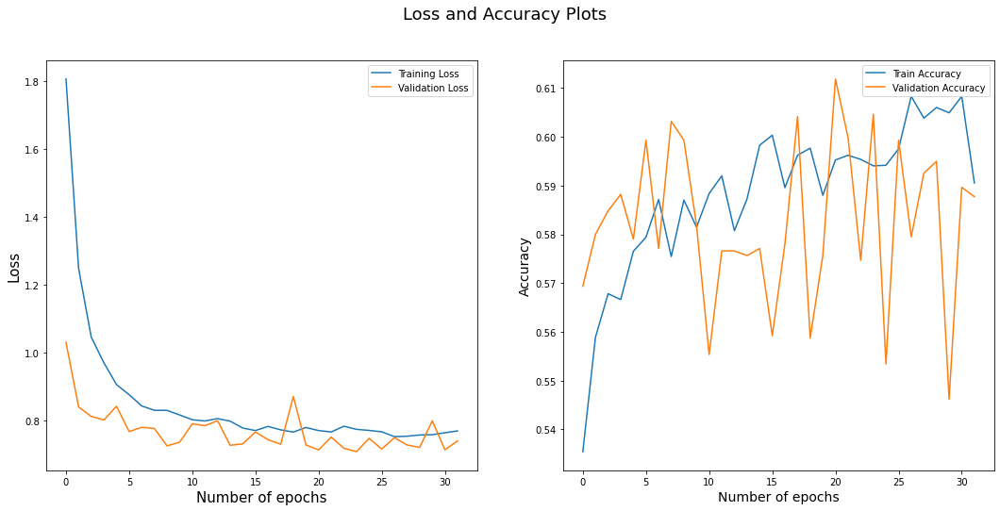

63/63 [==============================] - 4s 31ms/step
0.6035


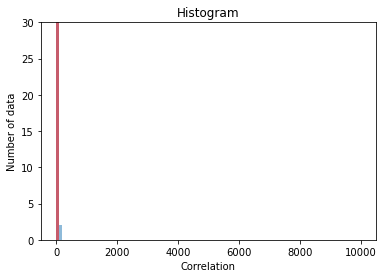

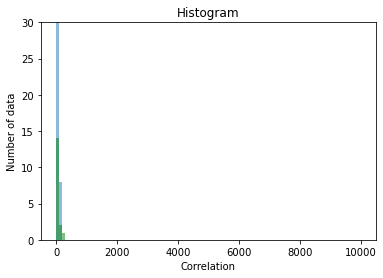

Model: "sequential_29"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_29 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


251/251 [==============================] - 17s 46ms/step - loss: 1.8769 - acc: 0.5273 - val_loss: 1.0320 - val_acc: 0.5921
Epoch 2/32
251/251 [==============================] - 10s 38ms/step - loss: 1.2383 - acc: 0.5584 - val_loss: 0.8690 - val_acc: 0.5976
Epoch 3/32
251/251 [==============================] - 10s 39ms/step - loss: 1.0660 - acc: 0.5623 - val_loss: 0.8096 - val_acc: 0.5432
Epoch 4/32
251/251 [==============================] - 10s 38ms/step - loss: 0.9705 - acc: 0.5686 - val_loss: 0.7756 - val_acc: 0.5652
Epoch 5/32
251/251 [==============================] - 10s 39ms/step - loss: 0.9338 - acc: 0.5720 - val_loss: 0.8030 - val_acc: 0.5846
Epoch 6/32
251/251 [==============================] - 10s 39ms/step - loss: 0.8812 - acc: 0.5824 - val_loss: 0.7424 - val_acc: 0.5921
Epoch 7/32
251/251 [==============================] - 10s 39ms/step - loss: 0.8591 - acc: 0.5793 - val_loss: 0.8236 - val_acc: 0.5382
Epoch 8/32
251/251 [==============================] - 10s 39ms/step - los

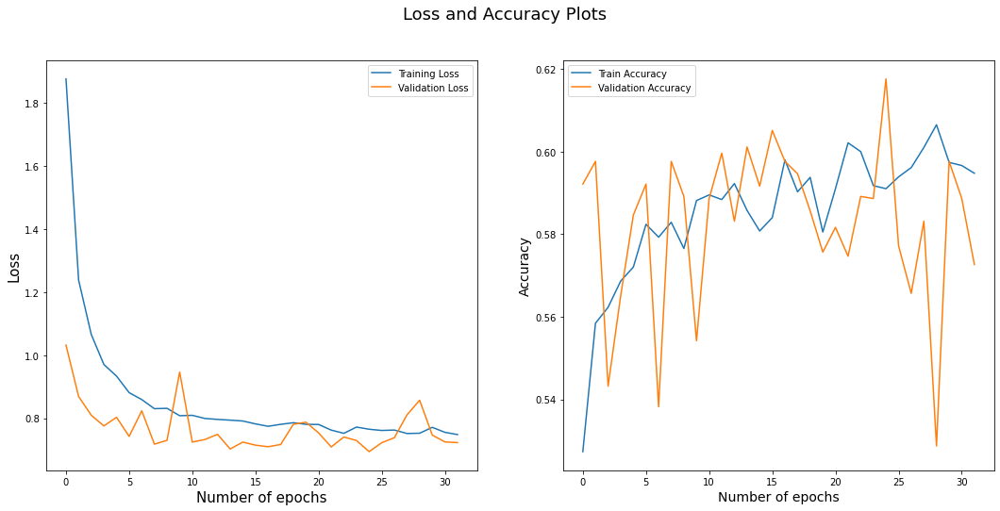

324/324 [==============================] - 10s 30ms/step
Round:  3
Test Accuracy:  0.6525
Label Accuracy:  0.9943912580988299
Number of catagory 1:  4689.0
Number of catagory 2:  5652.0
Model: "sequential_30"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_30 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________

/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


259/259 [==============================] - 17s 45ms/step - loss: 1.7807 - acc: 0.5363 - val_loss: 0.8970 - val_acc: 0.5766
Epoch 2/32
259/259 [==============================] - 10s 39ms/step - loss: 1.2363 - acc: 0.5499 - val_loss: 0.8536 - val_acc: 0.5674
Epoch 3/32
259/259 [==============================] - 10s 37ms/step - loss: 1.0278 - acc: 0.5743 - val_loss: 0.7866 - val_acc: 0.5834
Epoch 4/32
259/259 [==============================] - 10s 38ms/step - loss: 0.9599 - acc: 0.5740 - val_loss: 0.7529 - val_acc: 0.5766
Epoch 5/32
259/259 [==============================] - 10s 39ms/step - loss: 0.8971 - acc: 0.5771 - val_loss: 0.8172 - val_acc: 0.5500
Epoch 6/32
259/259 [==============================] - 10s 39ms/step - loss: 0.8654 - acc: 0.5811 - val_loss: 0.8491 - val_acc: 0.5752
Epoch 7/32
259/259 [==============================] - 10s 38ms/step - loss: 0.8508 - acc: 0.5890 - val_loss: 0.7552 - val_acc: 0.5829
Epoch 8/32
259/259 [==============================] - 10s 38ms/step - los

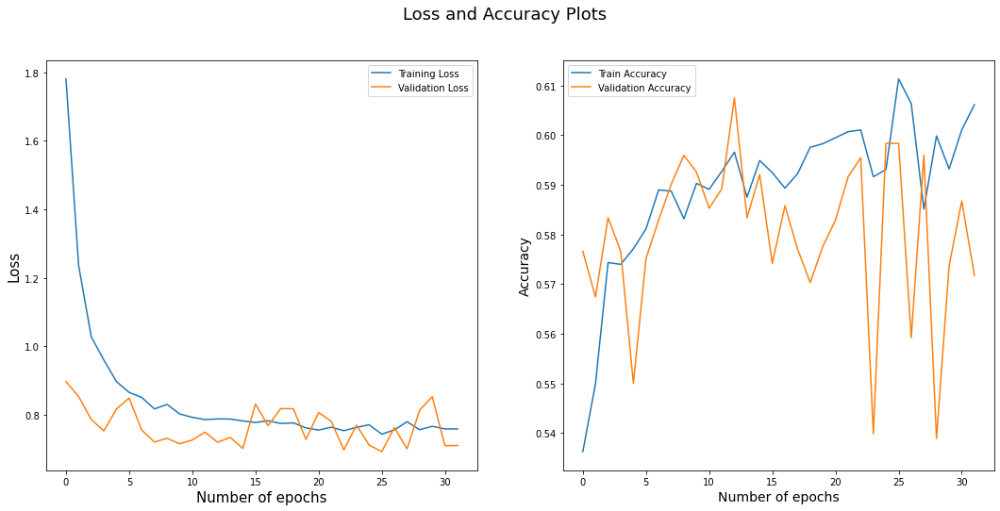

63/63 [==============================] - 4s 32ms/step
0.6455


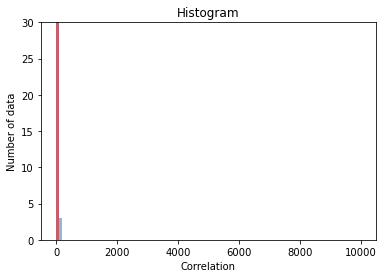

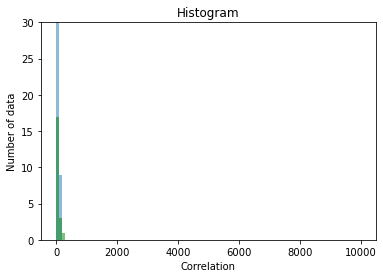

Model: "sequential_31"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_31 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


255/255 [==============================] - 17s 47ms/step - loss: 1.7345 - acc: 0.5418 - val_loss: 0.9594 - val_acc: 0.5614
Epoch 2/32
255/255 [==============================] - 10s 38ms/step - loss: 1.2144 - acc: 0.5466 - val_loss: 0.9217 - val_acc: 0.5668
Epoch 3/32
255/255 [==============================] - 10s 38ms/step - loss: 1.0306 - acc: 0.5582 - val_loss: 0.8696 - val_acc: 0.5697
Epoch 4/32
255/255 [==============================] - 10s 40ms/step - loss: 0.9405 - acc: 0.5684 - val_loss: 0.9156 - val_acc: 0.5658
Epoch 5/32
255/255 [==============================] - 10s 40ms/step - loss: 0.9089 - acc: 0.5758 - val_loss: 0.7806 - val_acc: 0.5845
Epoch 6/32
255/255 [==============================] - 10s 41ms/step - loss: 0.8489 - acc: 0.5817 - val_loss: 0.7518 - val_acc: 0.5742
Epoch 7/32
255/255 [==============================] - 10s 40ms/step - loss: 0.8299 - acc: 0.5903 - val_loss: 0.7470 - val_acc: 0.5663
Epoch 8/32
255/255 [==============================] - 10s 37ms/step - los

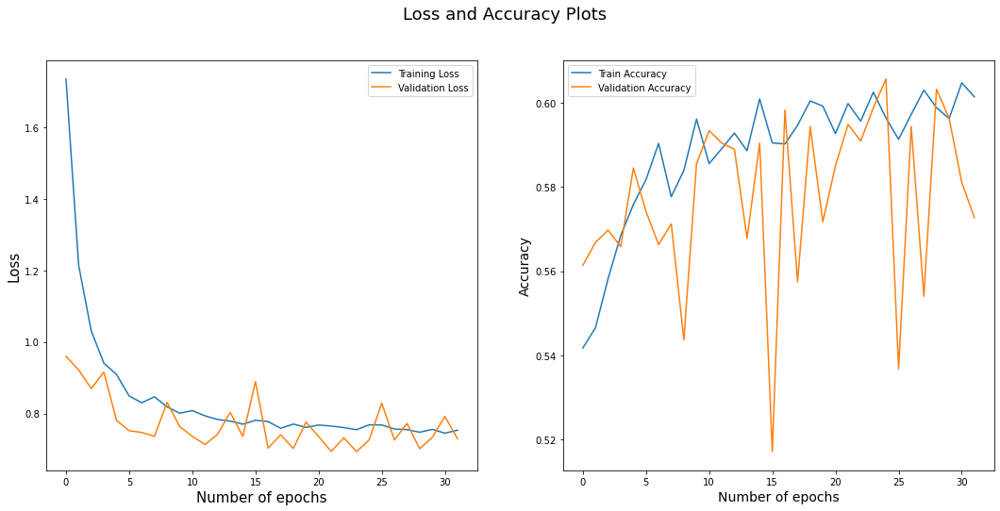

324/324 [==============================] - 10s 30ms/step
Round:  4
Test Accuracy:  0.671
Label Accuracy:  0.9934242336331109
Number of catagory 1:  4683.0
Number of catagory 2:  5658.0
Model: "sequential_32"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_32 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
__________________________________________________

/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


259/259 [==============================] - 16s 44ms/step - loss: 1.8068 - acc: 0.5316 - val_loss: 0.9625 - val_acc: 0.5703
Epoch 2/32
259/259 [==============================] - 10s 38ms/step - loss: 1.1984 - acc: 0.5678 - val_loss: 0.8725 - val_acc: 0.5887
Epoch 3/32
259/259 [==============================] - 10s 37ms/step - loss: 1.0557 - acc: 0.5711 - val_loss: 0.7938 - val_acc: 0.5892
Epoch 4/32
259/259 [==============================] - 10s 37ms/step - loss: 0.9759 - acc: 0.5681 - val_loss: 0.7477 - val_acc: 0.5853
Epoch 5/32
259/259 [==============================] - 10s 38ms/step - loss: 0.9095 - acc: 0.5711 - val_loss: 0.7664 - val_acc: 0.5979
Epoch 6/32
259/259 [==============================] - 10s 37ms/step - loss: 0.8760 - acc: 0.5798 - val_loss: 0.7311 - val_acc: 0.5930
Epoch 7/32
259/259 [==============================] - 9s 36ms/step - loss: 0.8461 - acc: 0.5814 - val_loss: 0.9448 - val_acc: 0.5621
Epoch 8/32
259/259 [==============================] - 10s 38ms/step - loss

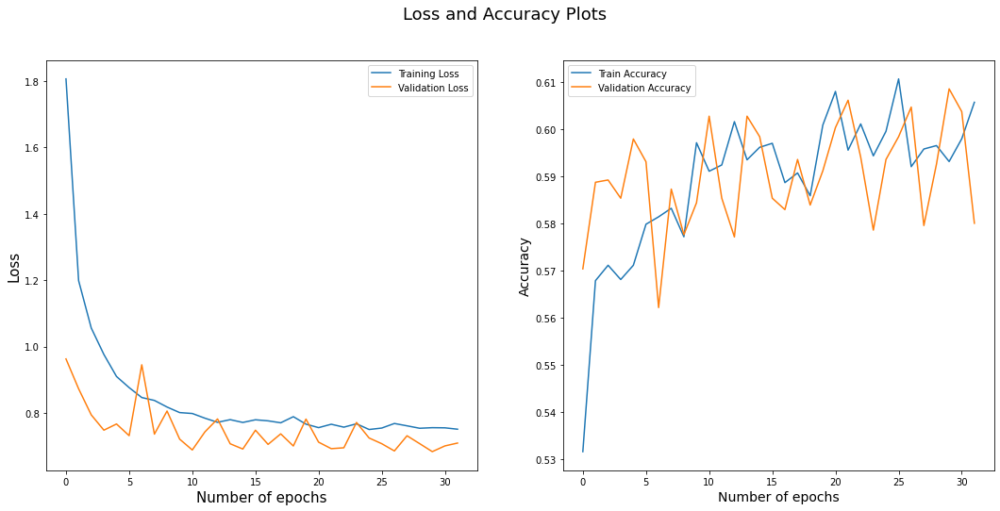

63/63 [==============================] - 6s 32ms/step
0.6535


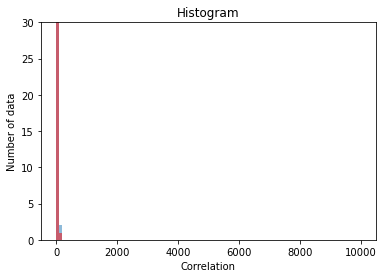

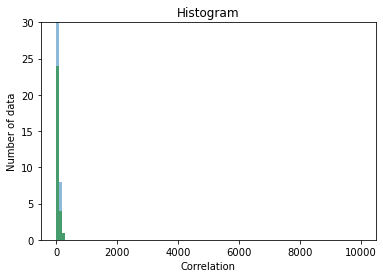

Model: "sequential_33"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_33 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


257/257 [==============================] - 18s 48ms/step - loss: 1.7575 - acc: 0.5405 - val_loss: 1.0375 - val_acc: 0.5473
Epoch 2/32
257/257 [==============================] - 10s 39ms/step - loss: 1.2105 - acc: 0.5609 - val_loss: 0.8131 - val_acc: 0.5799
Epoch 3/32
257/257 [==============================] - 10s 39ms/step - loss: 1.0375 - acc: 0.5671 - val_loss: 1.0033 - val_acc: 0.5638
Epoch 4/32
257/257 [==============================] - 10s 40ms/step - loss: 0.9620 - acc: 0.5714 - val_loss: 0.7630 - val_acc: 0.5906
Epoch 5/32
257/257 [==============================] - 10s 40ms/step - loss: 0.9129 - acc: 0.5716 - val_loss: 0.7479 - val_acc: 0.5760
Epoch 6/32
257/257 [==============================] - 10s 40ms/step - loss: 0.8786 - acc: 0.5799 - val_loss: 0.7233 - val_acc: 0.5902
Epoch 7/32
257/257 [==============================] - 10s 40ms/step - loss: 0.8437 - acc: 0.5792 - val_loss: 0.7538 - val_acc: 0.5643
Epoch 8/32
257/257 [==============================] - 10s 39ms/step - los

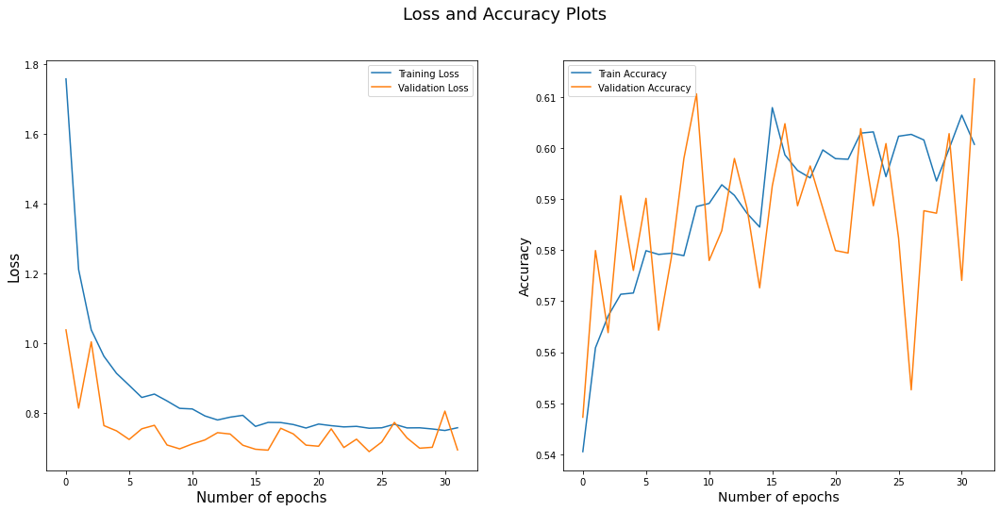

324/324 [==============================] - 10s 31ms/step
Round:  5
Test Accuracy:  0.64
Label Accuracy:  0.9934242336331109
Number of catagory 1:  4683.0
Number of catagory 2:  5658.0
Model: "sequential_34"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_34 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
___________________________________________________

/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


259/259 [==============================] - 17s 43ms/step - loss: 1.7935 - acc: 0.5312 - val_loss: 0.9439 - val_acc: 0.5858
Epoch 2/32
259/259 [==============================] - 10s 38ms/step - loss: 1.2087 - acc: 0.5601 - val_loss: 0.8445 - val_acc: 0.5747
Epoch 3/32
259/259 [==============================] - 10s 37ms/step - loss: 1.0659 - acc: 0.5625 - val_loss: 0.7815 - val_acc: 0.5959
Epoch 4/32
259/259 [==============================] - 10s 37ms/step - loss: 0.9515 - acc: 0.5731 - val_loss: 0.7535 - val_acc: 0.5955
Epoch 5/32
259/259 [==============================] - 10s 39ms/step - loss: 0.8917 - acc: 0.5864 - val_loss: 0.7426 - val_acc: 0.5945
Epoch 6/32
259/259 [==============================] - 10s 38ms/step - loss: 0.8729 - acc: 0.5764 - val_loss: 0.7285 - val_acc: 0.5940
Epoch 7/32
259/259 [==============================] - 10s 39ms/step - loss: 0.8365 - acc: 0.5783 - val_loss: 0.7261 - val_acc: 0.5863
Epoch 8/32
259/259 [==============================] - 10s 39ms/step - los

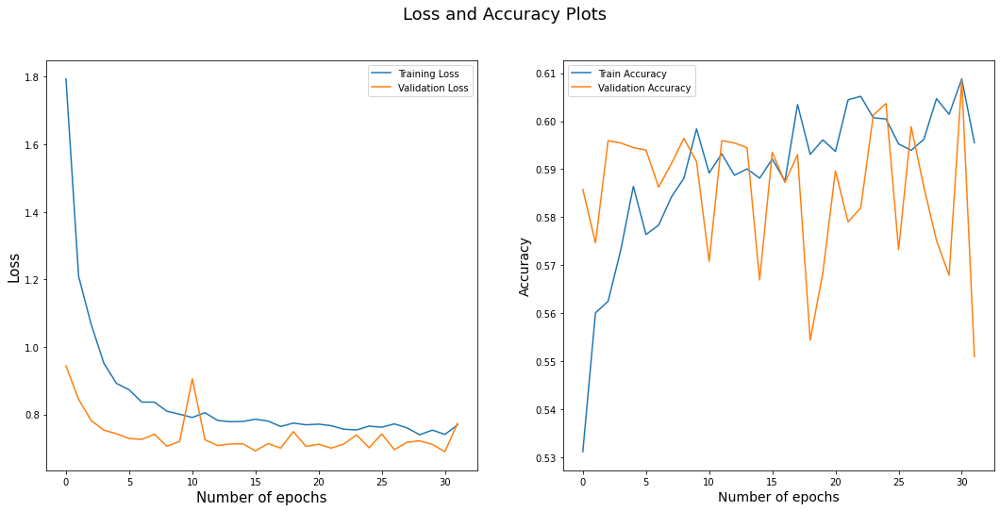

63/63 [==============================] - 4s 30ms/step
0.618


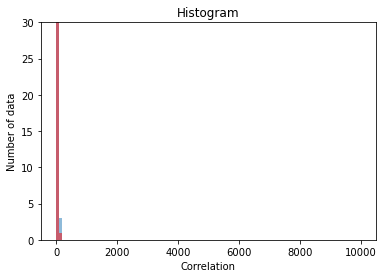

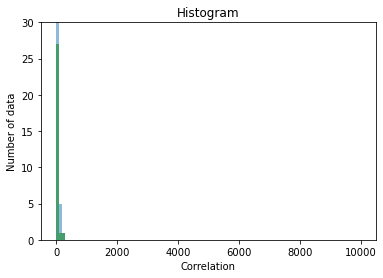

Model: "sequential_35"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_35 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


258/258 [==============================] - 18s 47ms/step - loss: 1.7754 - acc: 0.5406 - val_loss: 0.9817 - val_acc: 0.5675
Epoch 2/32
258/258 [==============================] - 10s 39ms/step - loss: 1.2049 - acc: 0.5609 - val_loss: 0.8461 - val_acc: 0.5816
Epoch 3/32
258/258 [==============================] - 10s 37ms/step - loss: 1.0429 - acc: 0.5697 - val_loss: 0.7849 - val_acc: 0.5854
Epoch 4/32
258/258 [==============================] - 10s 39ms/step - loss: 0.9642 - acc: 0.5679 - val_loss: 0.7819 - val_acc: 0.5840
Epoch 5/32
258/258 [==============================] - 10s 38ms/step - loss: 0.8984 - acc: 0.5807 - val_loss: 0.7372 - val_acc: 0.5908
Epoch 6/32
258/258 [==============================] - 10s 38ms/step - loss: 0.8754 - acc: 0.5831 - val_loss: 0.7721 - val_acc: 0.5825
Epoch 7/32
258/258 [==============================] - 10s 37ms/step - loss: 0.8353 - acc: 0.5731 - val_loss: 0.7672 - val_acc: 0.5568
Epoch 8/32
258/258 [==============================] - 10s 38ms/step - los

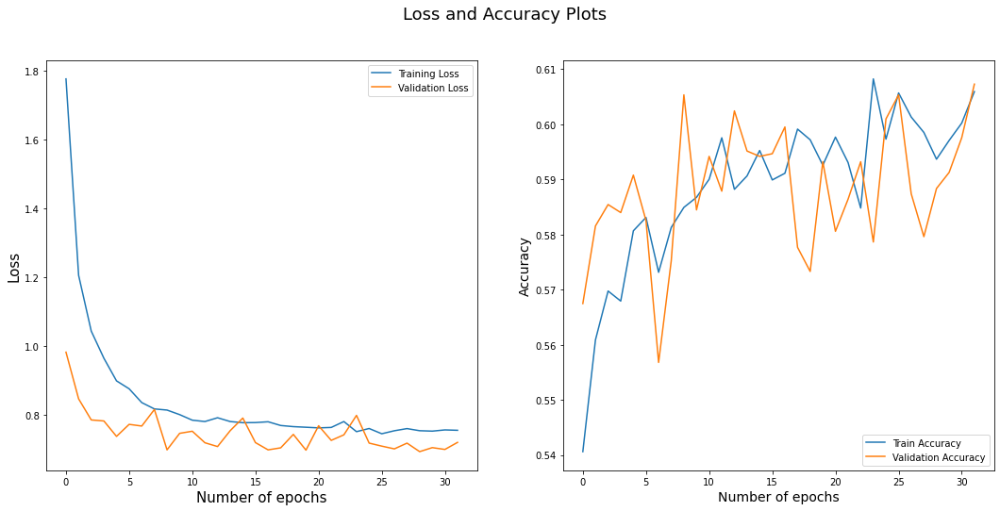

324/324 [==============================] - 10s 30ms/step
Round:  6
Test Accuracy:  0.6295
Label Accuracy:  0.9932308287399672
Number of catagory 1:  4683.0
Number of catagory 2:  5658.0
Model: "sequential_36"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_36 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________

/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


259/259 [==============================] - 17s 46ms/step - loss: 1.7801 - acc: 0.5412 - val_loss: 0.9844 - val_acc: 0.5790
Epoch 2/32
259/259 [==============================] - 10s 39ms/step - loss: 1.2520 - acc: 0.5598 - val_loss: 0.8253 - val_acc: 0.5853
Epoch 3/32
259/259 [==============================] - 10s 38ms/step - loss: 1.0550 - acc: 0.5667 - val_loss: 0.7859 - val_acc: 0.5950
Epoch 4/32
259/259 [==============================] - 10s 39ms/step - loss: 0.9847 - acc: 0.5659 - val_loss: 0.7645 - val_acc: 0.5790
Epoch 5/32
259/259 [==============================] - 11s 41ms/step - loss: 0.9128 - acc: 0.5775 - val_loss: 0.7272 - val_acc: 0.5872
Epoch 6/32
259/259 [==============================] - 10s 39ms/step - loss: 0.9003 - acc: 0.5722 - val_loss: 0.7697 - val_acc: 0.5597
Epoch 7/32
259/259 [==============================] - 10s 40ms/step - loss: 0.8395 - acc: 0.5868 - val_loss: 0.8510 - val_acc: 0.5761
Epoch 8/32
259/259 [==============================] - 10s 38ms/step - los

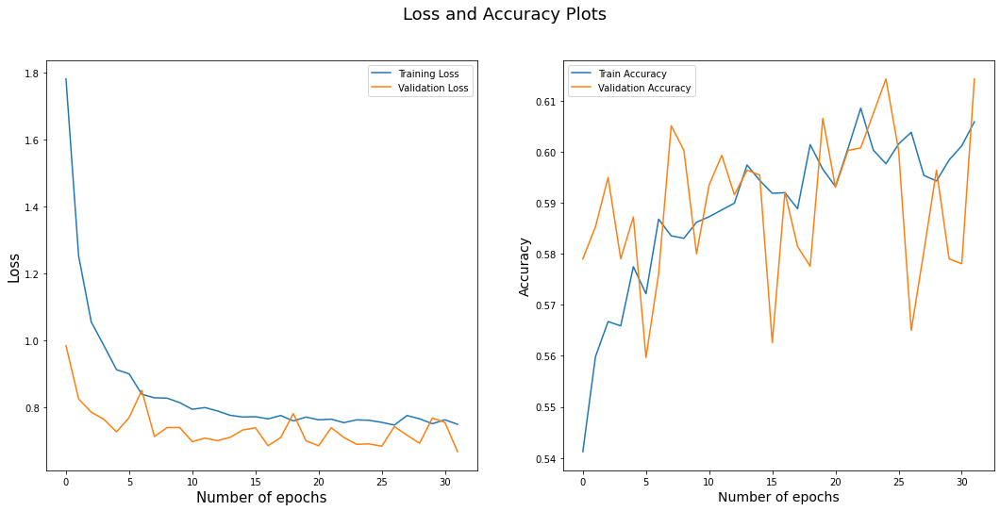

63/63 [==============================] - 4s 30ms/step
0.6525


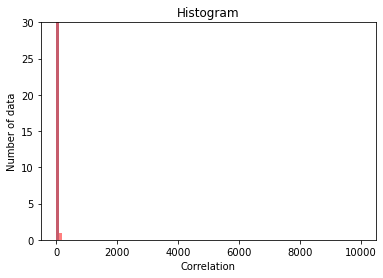

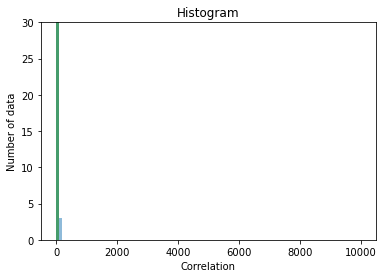

Model: "sequential_37"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_37 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


258/258 [==============================] - 18s 48ms/step - loss: 1.8416 - acc: 0.5353 - val_loss: 0.9526 - val_acc: 0.5552
Epoch 2/32
258/258 [==============================] - 10s 39ms/step - loss: 1.2460 - acc: 0.5490 - val_loss: 0.8568 - val_acc: 0.5451
Epoch 3/32
258/258 [==============================] - 10s 38ms/step - loss: 1.0462 - acc: 0.5629 - val_loss: 0.7846 - val_acc: 0.5799
Epoch 4/32
258/258 [==============================] - 10s 38ms/step - loss: 0.9437 - acc: 0.5737 - val_loss: 0.8331 - val_acc: 0.5654
Epoch 5/32
258/258 [==============================] - 10s 40ms/step - loss: 0.9017 - acc: 0.5729 - val_loss: 0.7776 - val_acc: 0.5586
Epoch 6/32
258/258 [==============================] - 10s 38ms/step - loss: 0.8700 - acc: 0.5711 - val_loss: 0.7553 - val_acc: 0.5664
Epoch 7/32
258/258 [==============================] - 10s 39ms/step - loss: 0.8416 - acc: 0.5816 - val_loss: 0.7498 - val_acc: 0.5620
Epoch 8/32
258/258 [==============================] - 10s 38ms/step - los

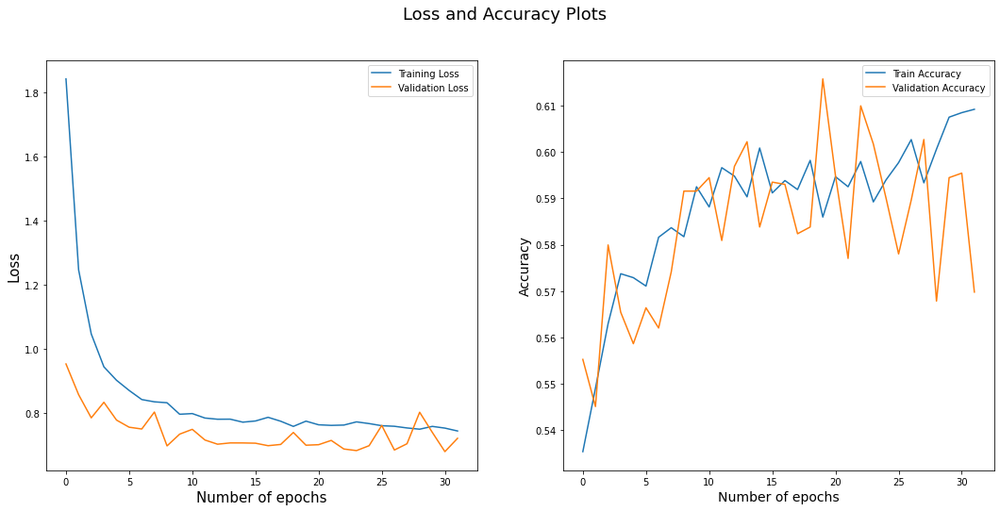

324/324 [==============================] - 10s 30ms/step
Round:  7
Test Accuracy:  0.662
Label Accuracy:  0.9932308287399672
Number of catagory 1:  4683.0
Number of catagory 2:  5658.0
Model: "sequential_38"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_38 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
__________________________________________________

/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


259/259 [==============================] - 16s 44ms/step - loss: 1.7458 - acc: 0.5478 - val_loss: 0.9229 - val_acc: 0.5824
Epoch 2/32
259/259 [==============================] - 10s 38ms/step - loss: 1.1657 - acc: 0.5718 - val_loss: 0.8225 - val_acc: 0.5810
Epoch 3/32
259/259 [==============================] - 10s 39ms/step - loss: 1.0212 - acc: 0.5679 - val_loss: 0.8023 - val_acc: 0.5810
Epoch 4/32
259/259 [==============================] - 10s 39ms/step - loss: 0.9481 - acc: 0.5731 - val_loss: 0.7169 - val_acc: 0.6013
Epoch 5/32
259/259 [==============================] - 10s 39ms/step - loss: 0.8898 - acc: 0.5867 - val_loss: 0.8066 - val_acc: 0.5761
Epoch 6/32
259/259 [==============================] - 10s 39ms/step - loss: 0.8518 - acc: 0.5858 - val_loss: 0.7175 - val_acc: 0.5926
Epoch 7/32
259/259 [==============================] - 10s 39ms/step - loss: 0.8445 - acc: 0.5826 - val_loss: 0.7457 - val_acc: 0.5761
Epoch 8/32
259/259 [==============================] - 10s 40ms/step - los

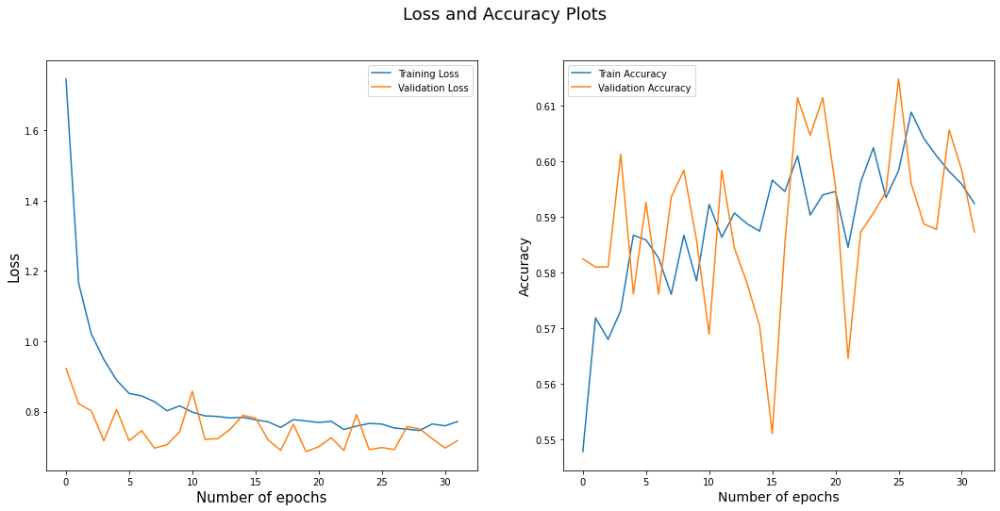

63/63 [==============================] - 5s 30ms/step
0.6195


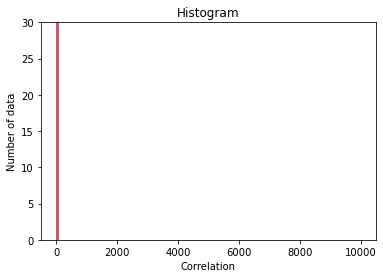

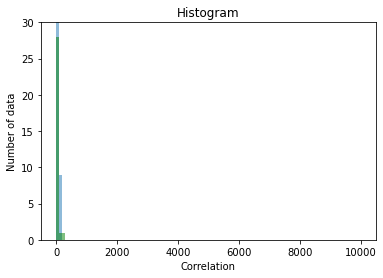

Model: "sequential_39"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_39 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


259/259 [==============================] - 17s 46ms/step - loss: 1.7996 - acc: 0.5318 - val_loss: 0.8858 - val_acc: 0.5736
Epoch 2/32
259/259 [==============================] - 10s 39ms/step - loss: 1.2080 - acc: 0.5575 - val_loss: 0.8197 - val_acc: 0.5866
Epoch 3/32
259/259 [==============================] - 10s 40ms/step - loss: 1.0258 - acc: 0.5678 - val_loss: 0.8878 - val_acc: 0.5726
Epoch 4/32
259/259 [==============================] - 10s 39ms/step - loss: 0.9339 - acc: 0.5786 - val_loss: 0.7709 - val_acc: 0.5639
Epoch 5/32
259/259 [==============================] - 10s 38ms/step - loss: 0.8910 - acc: 0.5721 - val_loss: 0.7279 - val_acc: 0.5905
Epoch 6/32
259/259 [==============================] - 10s 38ms/step - loss: 0.8578 - acc: 0.5779 - val_loss: 0.7105 - val_acc: 0.5852
Epoch 7/32
259/259 [==============================] - 10s 38ms/step - loss: 0.8368 - acc: 0.5755 - val_loss: 0.7467 - val_acc: 0.5954
Epoch 8/32
259/259 [==============================] - 10s 39ms/step - los

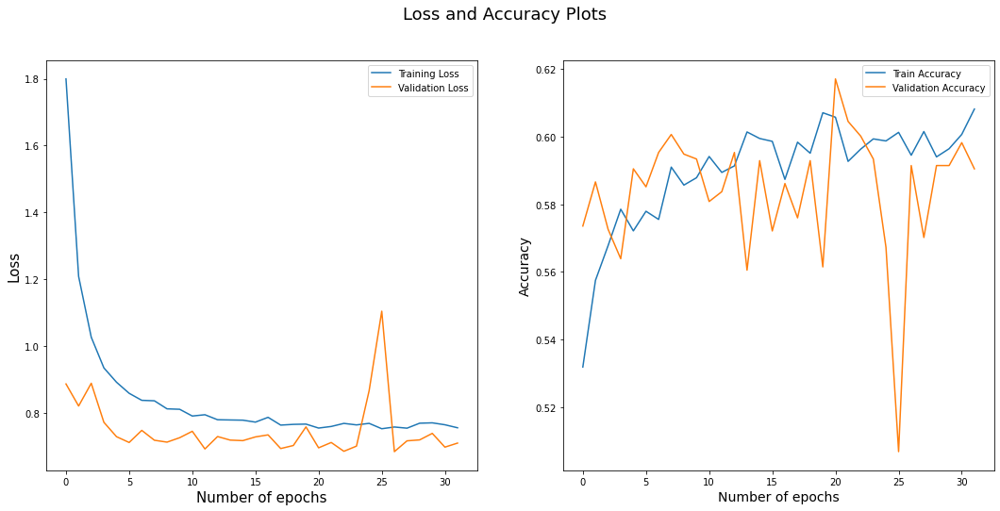

324/324 [==============================] - 9s 29ms/step
Round:  8
Test Accuracy:  0.607
Label Accuracy:  0.9931341262933953
Number of catagory 1:  4684.0
Number of catagory 2:  5657.0
Model: "sequential_40"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_40 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
___________________________________________________

/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


259/259 [==============================] - 17s 45ms/step - loss: 1.7392 - acc: 0.5447 - val_loss: 0.9513 - val_acc: 0.5520
Epoch 2/32
259/259 [==============================] - 10s 38ms/step - loss: 1.2268 - acc: 0.5503 - val_loss: 0.8587 - val_acc: 0.5684
Epoch 3/32
259/259 [==============================] - 9s 37ms/step - loss: 1.0456 - acc: 0.5701 - val_loss: 0.8041 - val_acc: 0.5781
Epoch 4/32
259/259 [==============================] - 10s 38ms/step - loss: 0.9447 - acc: 0.5702 - val_loss: 0.7782 - val_acc: 0.5616
Epoch 5/32
259/259 [==============================] - 10s 38ms/step - loss: 0.8938 - acc: 0.5822 - val_loss: 0.7747 - val_acc: 0.5621
Epoch 6/32
259/259 [==============================] - 10s 39ms/step - loss: 0.8561 - acc: 0.5887 - val_loss: 0.8099 - val_acc: 0.5674
Epoch 7/32
259/259 [==============================] - 10s 38ms/step - loss: 0.8342 - acc: 0.5788 - val_loss: 0.7333 - val_acc: 0.5848
Epoch 8/32
259/259 [==============================] - 10s 39ms/step - loss

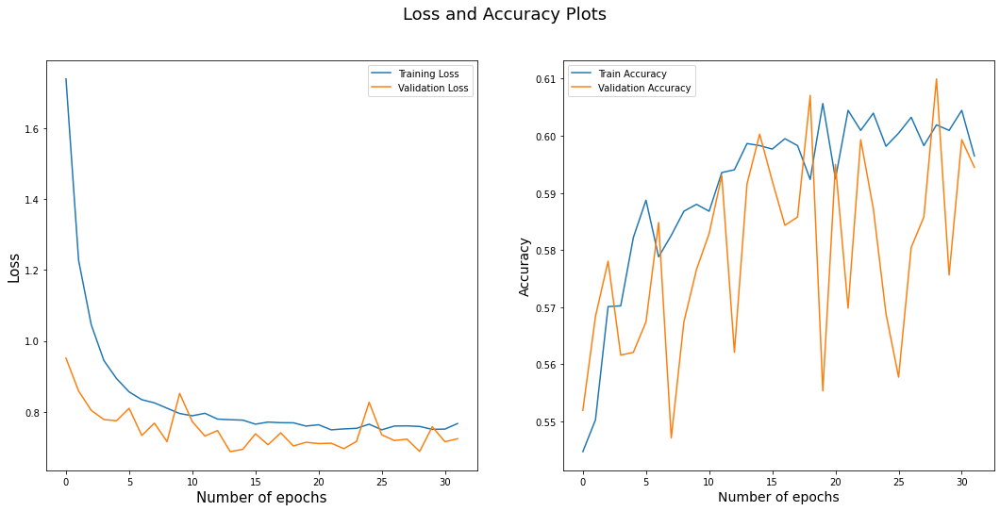

63/63 [==============================] - 3s 29ms/step
0.6235


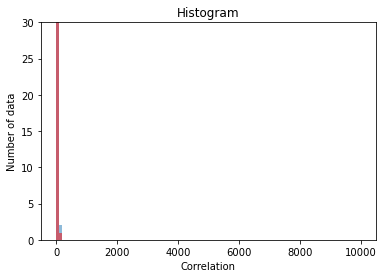

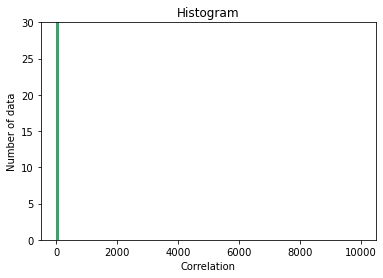

Model: "sequential_41"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_41 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


259/259 [==============================] - 17s 44ms/step - loss: 1.8427 - acc: 0.5242 - val_loss: 0.9789 - val_acc: 0.5549
Epoch 2/32
259/259 [==============================] - 10s 38ms/step - loss: 1.2193 - acc: 0.5517 - val_loss: 0.8839 - val_acc: 0.5535
Epoch 3/32
259/259 [==============================] - 10s 38ms/step - loss: 1.0594 - acc: 0.5583 - val_loss: 0.8551 - val_acc: 0.5675
Epoch 4/32
259/259 [==============================] - 9s 36ms/step - loss: 0.9679 - acc: 0.5705 - val_loss: 0.7519 - val_acc: 0.5859
Epoch 5/32
259/259 [==============================] - 10s 38ms/step - loss: 0.9170 - acc: 0.5727 - val_loss: 0.7916 - val_acc: 0.5776
Epoch 6/32
259/259 [==============================] - 10s 38ms/step - loss: 0.8636 - acc: 0.5811 - val_loss: 0.7585 - val_acc: 0.5907
Epoch 7/32
259/259 [==============================] - 10s 38ms/step - loss: 0.8488 - acc: 0.5830 - val_loss: 0.8327 - val_acc: 0.5878
Epoch 8/32
259/259 [==============================] - 10s 38ms/step - loss

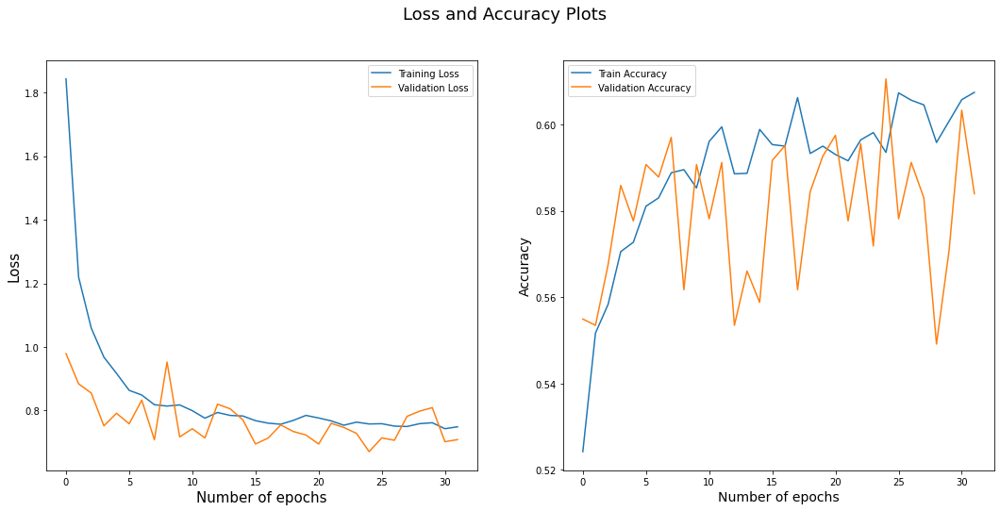

324/324 [==============================] - 9s 28ms/step
Round:  9
Test Accuracy:  0.6595
Label Accuracy:  0.9930374238468234
Number of catagory 1:  4685.0
Number of catagory 2:  5656.0
Model: "sequential_42"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 penultimate (Flatten)       (None, 2048)              0         
                                                                 
 dropout_42 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
__________________________________________________

/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


259/259 [==============================] - 17s 44ms/step - loss: 1.7476 - acc: 0.5456 - val_loss: 0.9482 - val_acc: 0.5665
Epoch 2/32
259/259 [==============================] - 10s 37ms/step - loss: 1.2156 - acc: 0.5689 - val_loss: 0.8340 - val_acc: 0.5882
Epoch 3/32
259/259 [==============================] - 10s 39ms/step - loss: 1.0476 - acc: 0.5615 - val_loss: 0.8313 - val_acc: 0.5669
Epoch 4/32
259/259 [==============================] - 10s 38ms/step - loss: 0.9384 - acc: 0.5762 - val_loss: 0.8517 - val_acc: 0.5423
Epoch 5/32
259/259 [==============================] - 10s 37ms/step - loss: 0.8884 - acc: 0.5798 - val_loss: 0.8113 - val_acc: 0.5568
Epoch 6/32
259/259 [==============================] - 10s 38ms/step - loss: 0.8576 - acc: 0.5818 - val_loss: 0.7920 - val_acc: 0.5877
Epoch 7/32
259/259 [==============================] - 10s 38ms/step - loss: 0.8327 - acc: 0.5890 - val_loss: 0.7274 - val_acc: 0.5901
Epoch 8/32
259/259 [==============================] - 10s 38ms/step - los

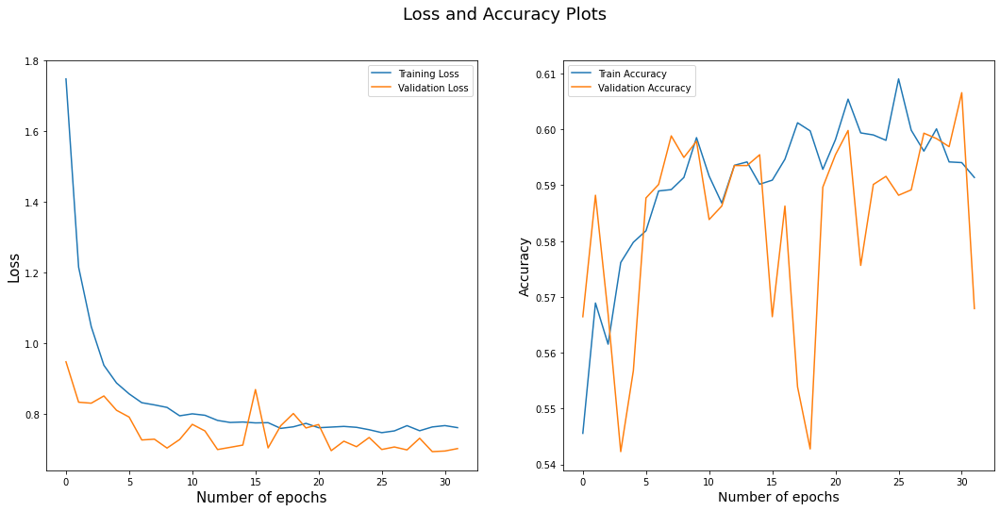

63/63 [==============================] - 3s 27ms/step
0.6265


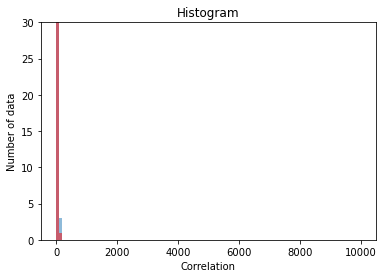

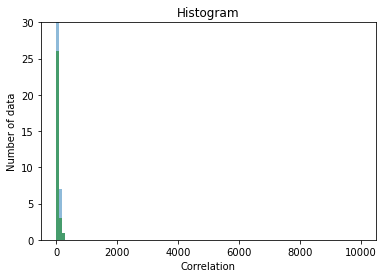

Model: "sequential_43"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 1, 1, 2048)        42658176  
                                                                 
 FC (Flatten)                (None, 2048)              0         
                                                                 
 dropout_43 (Dropout)        (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 2)                 4098      
                                                                 
Total params: 42,662,274
Trainable params: 4,098
Non-trainable params: 42,658,176
_________________________________________________________________
Epoch 1/32


/home/student/07/b07902066/.local/lib/python3.10/site-packages/keras/optimizer_v2/gradient_descent.py:102: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(SGD, self).__init__(name, **kwargs)


259/259 [==============================] - 17s 48ms/step - loss: 1.7200 - acc: 0.5405 - val_loss: 0.9511 - val_acc: 0.5854
Epoch 2/32
259/259 [==============================] - 10s 40ms/step - loss: 1.2100 - acc: 0.5571 - val_loss: 0.8084 - val_acc: 0.5955
Epoch 3/32
259/259 [==============================] - 10s 38ms/step - loss: 1.0148 - acc: 0.5721 - val_loss: 0.8213 - val_acc: 0.5747
Epoch 4/32
259/259 [==============================] - 10s 38ms/step - loss: 0.9377 - acc: 0.5752 - val_loss: 0.7645 - val_acc: 0.5733
Epoch 5/32
259/259 [==============================] - 10s 38ms/step - loss: 0.8805 - acc: 0.5778 - val_loss: 0.7715 - val_acc: 0.5825
Epoch 6/32
259/259 [==============================] - 10s 38ms/step - loss: 0.8709 - acc: 0.5816 - val_loss: 0.6986 - val_acc: 0.6033
Epoch 7/32
259/259 [==============================] - 10s 39ms/step - loss: 0.8404 - acc: 0.5878 - val_loss: 0.8908 - val_acc: 0.5694
Epoch 8/32
259/259 [==============================] - 10s 39ms/step - los

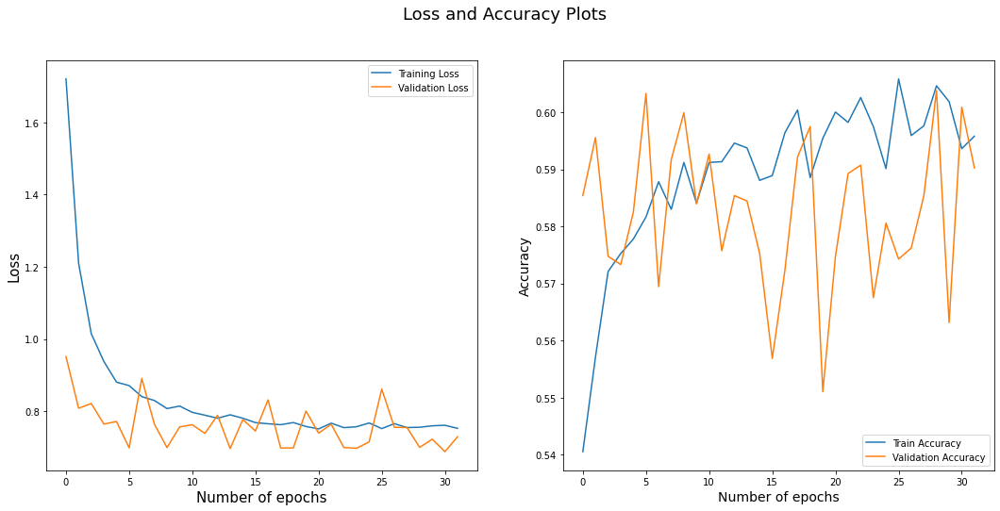

270/324 [========================>.....] - ETA: 1s

In [ ]:
noise_label = torch.load('./data/CIFAR-10_human.pt')
clean_label = noise_label['clean_label']
worst_label = noise_label['worse_label']
aggre_label = noise_label['aggre_label']
random_label1 = noise_label['random_label1']
random_label2 = noise_label['random_label2']
random_label3 = noise_label['random_label3']

train_dataset,test_dataset,num_classes,num_training_samples = input_dataset('cifar10', 'clean', './data/CIFAR-10_human.pt', True)
X_c = train_dataset.train_data
y_c = worst_label
X_test_c = test_dataset.test_data
y_test_c = test_dataset.test_labels

fine_label_list = ['airplane', 'automobile', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck']

def label_shiftting(y, p = 0.2):
    L0 = np.where(y == 0)[0]
    L1 = np.where(y == 1)[0]
    A0 = np.random.choice(500, size=int(500*p), replace=False)
    A1 = np.random.choice(500, size=int(500*p), replace=False)
    y[L0[A0]] = 1
    y[L1[A1]] = 0
    return y, L0[A0], L1[A1]
 
X = []
y = []
for i,x in enumerate(X_c):
    if fine_label_list[y_c[i]] == 'cat':
        X.append(x)
        y.append(0)
    elif fine_label_list[y_c[i]] == 'dog':
        X.append(x)
        y.append(1)
        
X_test = []
y_test = []
for i,x in enumerate(X_test_c):
    if fine_label_list[y_test_c[i]] == 'cat':
        X_test.append(x)
        y_test.append(0)
    elif fine_label_list[y_test_c[i]] == 'dog':
        X_test.append(x)
        y_test.append(1)

X = np.array(X)
y = np.array(y)
# y_shifted, L01, L10 = label_shiftting(y.copy(), p = 0.2)
y_shifted = to_categorical(y.copy(), 2)

X_test = np.array(X_test)
y_test = np.array(y_test)

#---Train---
from tensorflow.compat.v1.keras.applications import ResNet101

res = ResNet101(weights='imagenet', include_top = False, classes = 2, input_shape=(32,32,3))

Label_Accuracy = []
Test_Accuracy = []
Test_Accurracy_0 = []

Rounds = 11


for Round in range(Rounds):
    model = Sequential()
    
    model.add(res)
    # model.add(GlobalAveragePooling2D(name='penultimate'))
    model.add(Flatten(name='penultimate'))
    
    model.add(Dropout(0.5))
    model.add(Dense(2, activation = 'softmax', name='dense'))
    res.trainable = False
    model.summary()
    
    lr = 1e-4
    sgd = SGD(lr = lr, momentum = 0.9, nesterov = True)
    model.compile(loss = 'categorical_crossentropy', optimizer = sgd, metrics = ['acc'])
    
    hist = model.fit(x=X, y=y_shifted, batch_size=32, epochs=32, verbose=1, callbacks=None, validation_split=0.2, validation_data=None, shuffle=True, class_weight=None, sample_weight=None, initial_epoch=0, steps_per_epoch=None, validation_steps=None)
    
    
    
    plt.figure(figsize=(18,8))
    
    plt.suptitle('Loss and Accuracy Plots', fontsize=18)
    
    plt.subplot(1,2,1)
    plt.plot(hist.history['loss'], label='Training Loss')
    plt.plot(hist.history['val_loss'], label='Validation Loss')
    plt.legend()
    plt.xlabel('Number of epochs', fontsize=15)
    plt.ylabel('Loss', fontsize=15)
    
    plt.subplot(1,2,2)
    plt.plot(hist.history['acc'], label='Train Accuracy')
    plt.plot(hist.history['val_acc'], label='Validation Accuracy')
    plt.legend()
    plt.xlabel('Number of epochs', fontsize=14)
    plt.ylabel('Accuracy', fontsize=14)
    plt.show()
    
    
    y_pred = model.predict(X_test, verbose=1)
    y_pred = np.argmax(y_pred, axis = 1)
    print(accuracy_score(y_test, y_pred))
    Test_Accurracy_0.append(accuracy_score(y_test, y_pred))
    
    sub_model = tf.keras.Model(inputs = model.input, outputs = model.get_layer('penultimate').output)
    R = sub_model.predict(X)
    
    preserved_index = []
    relabel_index = []
    
    T_index = [-1 for i in range(len(R))]
    for catagory in [0, 1]:
        R_c = R[y_shifted[:,catagory] == 1]
        R_hat = np.average(R_c, axis=0)
        M = R_c.copy()
        for i in range(len(M)):
            M[i] -= R_hat
        u, s, vh = np.linalg.svd(M, full_matrices=True)
        v = vh[0]
        
        T = []
        T00 = []
        T01 = []
        T10 = []
        for i, r in enumerate(R):
            if y_shifted[i, catagory] == 1:
                T.append((np.dot((r-R_hat), v)**2))
                T_index[i] = len(T)-1
                
                if (y_shifted[i] == to_categorical(y, 2)[i]).all():
                    T00.append((np.dot((r-R_hat), v)**2))
                elif y_shifted[i][0] == 1:
                    T01.append((np.dot((r-R_hat), v)**2))
                elif y_shifted[i][0] == 0:
                    T10.append((np.dot((r-R_hat), v)**2))
        
        bins = np.linspace(0, 10000, 100)
        n, bins, patches=plt.hist(T00,alpha = 0.5,bins=bins)
        n, bins, patches=plt.hist(T01,bins=bins,alpha = 0.5,color='red')
        n, bins, patches=plt.hist(T10,bins=bins,alpha = 0.5,color='green')
        plt.ylim(0, 30)
        plt.xlabel("Correlation")
        plt.ylabel("Number of data")
        plt.title("Histogram")
        plt.show()
    
        S = sorted(range(len(T)), key=lambda k: T[k])
        # d = T[S[int(len(M) * (1 - 0.25 * (1 - (Round / Rounds))))]]
        d = T[S[int(len(M) * (1 - 0.25 * 0.5**Round))-1]]
        # rl = T[S[int(len(M) * (1 - 0.5**Round))]]
        # d = T[S[int(len(M) * (1 - 0.25))]]
        # rl = T[S[int(500*(1-0.1))]]
        for i, r in enumerate(R):
            if y_shifted[i, catagory] == 1 and T[T_index[i]] < d:
                preserved_index.append(i)
            # if y_shifted[i, catagory] == 1 and T[T_index[i]] >= rl:
            #     relabel_index.append(i)
                
    
    preserved_index.sort()
    relabel_index.sort()
    X_p = X[preserved_index]
    y_p = y_shifted.copy()
    y_p = y_p[preserved_index]
    
    
    
    model = Sequential()
    model.add(res)
    # model.add(GlobalAveragePooling2D(name='GAP'))
    model.add(Flatten(name='FC'))
    
    model.add(Dropout(0.5))
    model.add(Dense(2, activation = 'softmax', name='dense'))
    res.trainable = False
    model.summary()
    
    lr = 1e-4
    sgd = SGD(lr = lr, momentum = 0.9, nesterov = True)
    model.compile(loss = 'categorical_crossentropy', optimizer = sgd, metrics = ['acc'])
    
    hist = model.fit(x=X_p, y=y_p, batch_size=32, epochs=32, verbose=1, callbacks=None, validation_split=0.2, validation_data=None, shuffle=True, class_weight=None, sample_weight=None, initial_epoch=0, steps_per_epoch=None, validation_steps=None)
    
    plt.figure(figsize=(18,8))
    
    plt.suptitle('Loss and Accuracy Plots', fontsize=18)
    
    plt.subplot(1,2,1)
    plt.plot(hist.history['loss'], label='Training Loss')
    plt.plot(hist.history['val_loss'], label='Validation Loss')
    plt.legend()
    plt.xlabel('Number of epochs', fontsize=15)
    plt.ylabel('Loss', fontsize=15)
    
    plt.subplot(1,2,2)
    plt.plot(hist.history['acc'], label='Train Accuracy')
    plt.plot(hist.history['val_acc'], label='Validation Accuracy')
    plt.legend()
    plt.xlabel('Number of epochs', fontsize=14)
    plt.ylabel('Accuracy', fontsize=14)
    plt.show()
    
    y_pred = model.predict(X_test, verbose=1)
    y_pred = np.argmax(y_pred, axis = 1)
    
    y_new_pred = model.predict(X, verbose=1)
    y_new = np.argmax(y_new_pred, axis = 1)
    
    # for i in relabel_index:
    for i in range(len(X)):
        if max(y_new_pred[i]) > 0.99: 
            y_shifted[i] = to_categorical(y_new, 2)[i]
    
    print('Round: ', Round)
    print('Test Accuracy: ', accuracy_score(y_test, y_pred))
    print('Label Accuracy: ', accuracy_score(y, y_shifted[:,1]))
    print('Number of catagory 1: ', np.sum(y_shifted[:,0]))
    print('Number of catagory 2: ', np.sum(y_shifted[:,1]))
    Label_Accuracy.append(accuracy_score(y, y_shifted[:,1]))
    Test_Accuracy.append(accuracy_score(y_test, y_pred))